In [75]:
###########################################################################
# Copyright 2022-2023 Jean-Luc CHARLES
# Created: 2022-07-29
# version: 1.1 -- date: 2023-11-20 
# License: GNU GPL-3.0-or-later
###########################################################################

# Use the _Deep Reinforcement Lerning_ (DRL) to train a Nneural Network (NN) to the control robot position.algorithm

In this activity you will learn how to use the DRL approach to train a ___PPO___  neural network to control the robot position.

# Outline <a name="top"></a>
- [$1 -$ The class RoboticArm_2DOF](#1)
    - [$1.1 -$ Instancite the robot](#1.1)
    - [$1.2 -$ Run a simple test](#1.2)
- [$2 -$ Train the PPO neural network](#2)
    - [$2.1 -$ The configuration files <a name="2.1"></a>](#2.1)
    - [ 2.2 - ](#2.2)
- [ 3 - ](#3)
    - [ 3.1 - ](#3.1)
    - [ 3.2 - ](#3.2)
- [ 4 - ](#4)
    - [ 4.1 ](#4.1)
    - [ 4.2 ](#4.2)

Recommended links:
- Pybullet online documentation: [PyBullet Quickstart Guide](https://docs.google.com/document/d/10sXEhzFRSnvFcl3XxNGhnD4N2SedqwdAvK3dsihxVUA/edit#heading=h.2ye70wns7io3)

# Import the required modules

In [1]:
import os, sys, time, shutil, yaml, pathlib, shutil
import pybullet as p
import pybullet_data
import numpy as np
import matplotlib.pyplot as plt
from math import pi

from utils.perf import perf_trajectoire, perf_nbSubStep_trajectoire
from utils.tools import is_close_to, move_to, display_joint_properties
from utils.tools import welcome, plot_test, moving_average
from utils.RoboticArm_2DOF import RoboticArm_2DOF_PyBullet
pc = None

pybullet build time: Oct 14 2023 15:43:53


# 1. The class RoboticArm_2DOF<a name="1"></a>
## 1.1 - Instanciate the robot<a name="1.1"></a>

In [2]:
URDF   = "./urdf/RoboticArm_2DOF_2.urdf"
TARGET = "./urdf/target.urdf"

env    = RoboticArm_2DOF_PyBullet(robot_urdf = URDF, 
                                  target_urdf = TARGET, 
                                  dt = 0.002,
                                  headless = None, 
                                  verbose=0)


################################################################################
# Welcome to this practical session with Pybullet & URDF.
# Pybullet windows shortcuts:
#    G: close/open the tabs
#    W: switch between solid/wireframe rendering
#    J: show/hide links & joints frames as RGB lines (with wireframe rendering activated)
#    K: show/hide joint axes as a black line         (with wireframe rendering activated)
#    A: show/hide collision boxes                    (with wireframe rendering activated)
#    CTRL+left_clic  : rotate the robot
#    CRTL+midlle_clic: translate the robot
#    Mouse_wheel: zoom/unzoom
################################################################################



## 1.2 $-$ Run a simple test<a name="1.2"></a>

In this test, the two DOFs of the robot $q_1$ and $q_2$ arre controlled by position to make the robot move around its start position.

In [3]:
data = env.testAngleControl(0.075)
input("press ENTER to end....")
env.close()    

[testAngleControl] Ready to run the test with timestep=7.50e-02 s
sub_steps: 2


press ENTER to end.... 


#### Plot the data:

We can verify that tha actual values of $q_1$ and $q_2$ are close to the target values (dashed black lines).

Also we can draw the velocities $\dot{q}_1$ and $\dot{q}_2$, as well as the trajectory of the robot end effector:

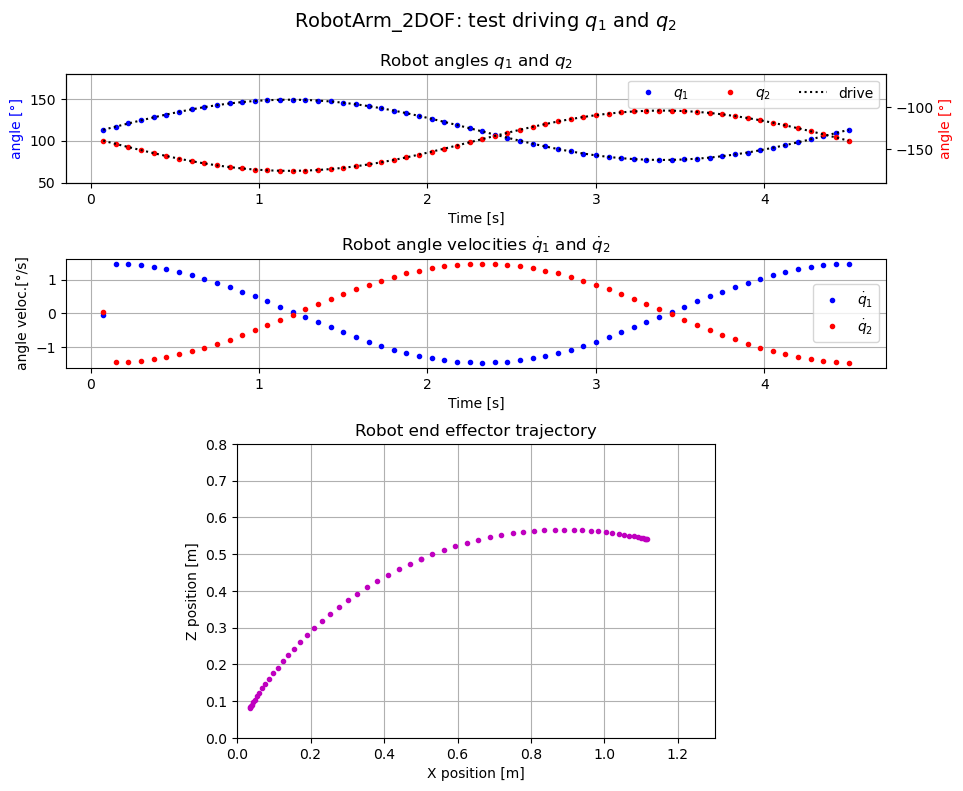

In [4]:
data = data.astype(float)
plot_test(data)

[top](#top)

# 2 $-$ Train the PPO neural network<a name="2"></a>

#### Training Strategy

The training of the robot involves a loop on the target position:
- A target is choosen at a random position in the space reachable by the robot.
- During the training, the reward function encourages the robot to move its end effector as close as possible to the target position.
- When done (the end effector is close to the target), a new target position is randomly choosen, and so on...

The whole training process is driven by __hyperparameters__. For example :
- `N_target_pos`: the total number of random positions learned before we decide that the network is trained.
- `epsilon_target`: the distance between the end effector position and the target position below which the effector is considered close enough to the target.
- `n_epoch`: the (classical) number of training runs with the same data set


## 2.1 $-$ The configuration files <a name="2.1"></a>

We use different configuration files to store:

- the parameters that define the robot
- the parameters that configure the neural network 
- hyperparameters used for the training itsefl.

## 2.2 $-$ Instanciate the robot <a name="2.2"></a>

The class `RoboticArm_2DOF_PyBullet` inherits from the class `env` of the frmawork _Gym_.

In [2]:
import os, sys, time, shutil, yaml, pathlib, shutil
import pybullet as p
import pybullet_data
import numpy as np
from numpy.linalg import norm
import matplotlib.pyplot as plt
from math import pi

from utils.perf import perf_trajectoire, perf_nbSubStep_trajectoire
from utils.tools import is_close_to, move_to, display_joint_properties, test_training, sample_line, sample_traj4pts
from utils.tools import welcome, plot_test, moving_average
from utils.RoboticArm_2DOF import RoboticArm_2DOF_PyBullet

In [3]:
DT = 0.002
SEED = 1234567
T1_T2 = (2000, 1000)

In [3]:
DT = 0.002
SEED = 1234567
T1_T2 = (1000, 500)

In [3]:
DT = 0.002
SEED = 1234567
T1_T2 = (600, 300)

In [5]:
DT = 1/240   # ~4 ms
SEED = 1234567
T1_T2 = (800, 400)

In [6]:
URDF   = "./urdf/RoboticArm_2DOF_2.urdf"
TARGET = "./urdf/target.urdf"

env    = RoboticArm_2DOF_PyBullet(robot_urdf  = URDF, 
                                  target_urdf = TARGET, 
                                  dt = DT,
                                  init_robot_angles = (113, -140),
                                  init_target_pos = (0.5, 0, 0.5),
                                  t1_t2_conv = T1_T2,
                                  reward = 'reward_1',
                                  seed = SEED,
                                  epsilon= 1e-3,
                                  headless = True, 
                                  max_episode_steps = 256,
                                  verbose=1)

env.action_space.seed(SEED)
env.observation_space.seed(SEED)

[RoboticArm_2DOF_PyBullet.__init__] _max_episode_steps:256


[1234567]

In [7]:
obs = env.reset(options={"target_initial_pos":(0.50, 0, 0.50), 'randomize':True})
obs

[RoboticArm_2DOF_PyBullet.reset] last #steps : 0


(array([ 2.2991273 ,  0.        , -2.6819162 ,  0.        ,  1.0035251 ,
         0.23244807,  0.26200184,  0.3927782 ], dtype=float32),
 {})

In [8]:
obs = env.reset(options={"target_initial_pos":(0.50, 0, 0.50), 'randomize':True})
obs

[RoboticArm_2DOF_PyBullet.reset] last #steps : 0


(array([ 1.4970531 ,  0.        , -2.5391238 ,  0.        ,  0.83687365,
         0.6502507 ,  0.57813346,  0.15384547], dtype=float32),
 {})

In [93]:
env.close()

numActiveThreads = 0
stopping threads
Thread with taskId 0 exiting
Thread TERMINATED
destroy semaphore
semaphore destroyed
destroy main semaphore
main semaphore destroyed
finished
numActiveThreads = 0
btShutDownExampleBrowser stopping threads
Thread with taskId 0 exiting
Thread TERMINATED
destroy semaphore
semaphore destroyed
destroy main semaphore
main semaphore destroyed


## 2.3 $-$ Instanciate the PPO network <a name="2.3"></a>

#### PPO hyperparameters:

In [9]:
policy = 'MlpPolicy'
tot_steps  = 5000000
save_freq  = 100000
nb_steps   = 2048        # The number of steps to run per update (the size of the rollout buffer)
nb_epochs  = 20
batch_size = 256
seed       = SEED
headless   = True

#### Other parameters:

In [10]:
environment = '2DOF_RobotArm_PyBullet'
agent_type  = 'PPO'

#### Directories:

In [11]:
experiment_time = time.localtime()
experiment_id = "_".join([environment, agent_type,
                         time.strftime("%y-%m-%d_%H-%M-%S", experiment_time)])
training_dir = pathlib.Path('models')/experiment_id
training_dir.mkdir(parents=True, exist_ok=True)

print(f"{training_dir=}")

training_dir=PosixPath('models/2DOF_RobotArm_PyBullet_PPO_23-12-05_15-23-48')


## 2.4 Run the full training <a name="2.5"></a>

In [10]:
from stable_baselines3 import PPO as agent
from stable_baselines3.common.callbacks import CheckpointCallback

model = agent(policy, 
              env, 
              n_epochs=nb_epochs,
              n_steps=nb_steps,
              batch_size=batch_size,
              use_sde=False,
              seed=seed,
              tensorboard_log=training_dir,
              verbose=1)

checkpoint_callback = CheckpointCallback(save_freq=save_freq, 
                                         save_path=training_dir/'ZIP')

# train agent
t0 = time.time()

model.learn(total_timesteps=tot_steps, 
            callback=checkpoint_callback)
    
t = int(time.time()-t0)
h = int(t//3600)
m = int((t - h*3600)//60)
print(f"Training elapsed time: {h:02d}h {m:02d}m")
  
# save trained agent
target_zip = os.path.join(training_dir, 'ZIP', 'model.zip')
print(f"saving trained model in <{target_zip}>")
model.save(target_zip)

Using cuda device
Wrapping the env with a `Monitor` wrapper
Wrapping the env in a DummyVecEnv.
[RoboticArm_2DOF_PyBullet.reset] last #steps : 0
Logging to models/2DOF_RobotArm_PyBullet_PPO_23-12-05_10-26-40/PPO_1
 step: 500 done by max_step
[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step
[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step
[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step
[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 500      |
|    ep_rew_mean     | 0.673    |
| time/              |          |
|    fps             | 1224     |
|    iterations      | 1        |
|    time_elapsed    | 1        |
|    total_timesteps | 2048     |
---------------------------------
 step: 500 done by max_step
[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step
[RoboticArm_2DOF_PyBulle

 step: 461 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 461
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 146 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 146
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 447         |
|    ep_rew_mean          | 15.8        |
| time/                   |             |
|    fps                  | 352         |
|    iterations           | 309         |
|    time_elapsed         | 1797        |
|    total_timesteps      | 632832      |
| train/                  |             |
|    approx_kl            | 0.008998729 |
|    clip_fraction        | 0.141       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.26       |
|    explained

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 449         |
|    ep_rew_mean          | 14.9        |
| time/                   |             |
|    fps                  | 351         |
|    iterations           | 316         |
|    time_elapsed         | 1839        |
|    total_timesteps      | 647168      |
| train/                  |             |
|    approx_kl            | 0.015626427 |
|    clip_fraction        | 0.166       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.24       |
|    explained_variance   | 0.416       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 441 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 441
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 457        |
|    ep_rew_mean          | 15         |
| time/                   |            |
|    fps                  | 351        |
|    iterations           | 323        |
|    time_elapsed         | 1880       |
|    total_timesteps      | 661504     |
| train/                  |            |
|    approx_kl            | 0.01374137 |
|    clip_fraction        | 0.177      |
|    clip_range           | 0.2        |
|    entropy_loss         | -1.19      |
|    explained_variance   |

 step: 324 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 324
 step: 122 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 122
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 465          |
|    ep_rew_mean          | 15           |
| time/                   |              |
|    fps                  | 351          |
|    iterations           | 330          |
|    time_elapsed         | 1920         |
|    total_timesteps      | 675840       |
| train/                  |              |
|    approx_kl            | 0.0095852725 |
|    clip_fraction        | 0.14         |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.15        |


 step: 325 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 325
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 473         |
|    ep_rew_mean          | 16.1        |
| time/                   |             |
|    fps                  | 352         |
|    iterations           | 337         |
|    time_elapsed         | 1958        |
|    total_timesteps      | 690176      |
| train/                  |             |
|    approx_kl            | 0.011158256 |
|    clip_fraction        | 0.144       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.12       |
|    explained_variance   | -0.0263     |
|    learning_rate        | 0.0003      |
|    loss

 step: 482 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 482
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 156 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 156
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 464         |
|    ep_rew_mean          | 16.2        |
| time/                   |             |
|    fps                  | 352         |
|    iterations           | 344         |
|    time_elapsed         | 1999        |
|    total_timesteps      | 704512      |
| train/                  |             |
|    approx_kl            | 0.010993226 |
|    clip_fraction        | 0.204       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.13       |
|    explained

 step: 428 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 428
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 114 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 114
 step: 234 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 234
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 267 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 267
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 449         |
|    ep_rew_mean          | 16          |
| time/                   |             |
|    fps                  | 352         |
|    iterations           | 351         |
|    time_elapsed         | 2042        |
|    total_timesteps      | 718848      |
| train/                  |             |
|    approx_kl            | 0.015224721 |
|    clip_fraction        | 0.126       |
|    clip_range     

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 348 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 348
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 445         |
|    ep_rew_mean          | 15.7        |
| time/                   |             |
|    fps                  | 351         |
|    iterations           | 358         |
|    time_elapsed         | 2088        |
|    total_timesteps      | 733184      |
| train/                  |             |
|    approx_kl            | 0.013270434 |
|    clip_fraction        | 0.161       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.13       |
|    explained_variance   | 0.624       |
|    learning_rate        | 0.0003      |
|    loss

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 307 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 307
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 445         |
|    ep_rew_mean          | 15          |
| time/                   |             |
|    fps                  | 350         |
|    iterations           | 365         |
|    time_elapsed         | 2130        |
|    total_timesteps      | 747520      |
| train/                  |             |
|    approx_kl            | 0.012304034 |
|    clip_fraction        | 0.127       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.07       |
|    explained_variance   | 0.689       |
|    learning_rate        | 0.0003      |
|    loss

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 209 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 209
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 205 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 205
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 448         |
|    ep_rew_mean          | 15.7        |
| time/                   |             |
|    fps                  | 350         |
|    iterations           | 372         |
|    time_elapsed         | 2175        |
|    total_timesteps      | 761856      |
| train/                  |             |
|    approx_kl            | 0.014782526 |
|    clip_fraction        | 0.162       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.07       |
|    explained

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 82 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 82
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 460         |
|    ep_rew_mean          | 15.7        |
| time/                   |             |
|    fps                  | 350         |
|    iterations           | 379         |
|    time_elapsed         | 2215        |
|    total_timesteps      | 776192      |
| train/                  |             |
|    approx_kl            | 0.013272053 |
|    clip_fraction        | 0.149       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.994      |
|    explained_

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 454         |
|    ep_rew_mean          | 16.5        |
| time/                   |             |
|    fps                  | 351         |
|    iterations           | 386         |
|    time_elapsed         | 2250        |
|    total_timesteps      | 790528      |
| train/                  |             |
|    approx_kl            | 0.020894684 |
|    clip_fraction        | 0.174       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.942      |
|    explained_variance   | 0.676       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 443         |
|    ep_rew_mean          | 16.4        |
| time/                   |             |
|    fps                  | 350         |
|    iterations           | 393         |
|    time_elapsed         | 2297        |
|    total_timesteps      | 804864      |
| train/                  |             |
|    approx_kl            | 0.013184316 |
|    clip_fraction        | 0.133       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.898      |
|    explained_variance   | 0.605       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 299 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 299
 step: 417 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 417
 step: 251 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 251
 step: 246 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 246
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 441         |
|    ep_rew_mean          | 17.8        |
| time/                   |             |
|    fps                  | 350         |
|    iterations           | 400         |
|    time_elapsed         | 2334        |
|    total_timesteps      | 819200      |
| train/                  |             |
|    approx_kl            | 0.015482317 |
|    clip_fraction        | 0.147       |
|    clip_range     

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 177 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 177
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 449         |
|    ep_rew_mean          | 17.7        |
| time/                   |             |
|    fps                  | 351         |
|    iterations           | 407         |
|    time_elapsed         | 2372        |
|    total_timesteps      | 833536      |
| train/                  |             |
|    approx_kl            | 0.015705898 |
|    clip_fraction        | 0.189       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.844      |
|    explained_variance   | 0.818       |
|    learning_rate        | 0.0003      |
|    loss

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 449         |
|    ep_rew_mean          | 17.4        |
| time/                   |             |
|    fps                  | 351         |
|    iterations           | 414         |
|    time_elapsed         | 2409        |
|    total_timesteps      | 847872      |
| train/                  |             |
|    approx_kl            | 0.016203579 |
|    clip_fraction        | 0.163       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.837      |
|    explained_variance   | 0.661       |
|    learning_rate        | 0.0003      |
|    los

 step: 120 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 120
 step: 386 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 386
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 212 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 212
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 281 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 281
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 432         |
|    ep_rew_mean          | 16.8        |
| time/                   |             |
|    fps                  | 351         |
|    iterations           | 421         |
|    time_elapsed         | 2451        |
|    total_timesteps      | 862208      |
| train/                  |             |
|    approx_kl            | 0.016376533 |
|    clip_fraction        | 0.173       |
|    clip_range     

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 244 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 244
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 320 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 320
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 428         |
|    ep_rew_mean          | 17.1        |
| time/                   |             |
|    fps                  | 352         |
|    iterations           | 428         |
|    time_elapsed         | 2485        |
|    total_timesteps      | 876544      |
| train/                  |             |
|    approx_kl            | 0.015495779 |
|    clip_fraction        | 0.157       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.828      |
|    explained

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 431         |
|    ep_rew_mean          | 19.1        |
| time/                   |             |
|    fps                  | 352         |
|    iterations           | 435         |
|    time_elapsed         | 2528        |
|    total_timesteps      | 890880      |
| train/                  |             |
|    approx_kl            | 0.015698604 |
|    clip_fraction        | 0.154       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.81       |
|    explain

 step: 295 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 295
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 422         |
|    ep_rew_mean          | 19.2        |
| time/                   |             |
|    fps                  | 351         |
|    iterations           | 441         |
|    time_elapsed         | 2566        |
|    total_timesteps      | 903168      |
| train/                  |             |
|    approx_kl            | 0.015566688 |
|    clip_fraction        | 0.168       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.791      |
|    explained_variance   | 0.765       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.23        |
|    n_updates            | 4400        |
|    

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 213 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 213
 step: 350 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 350
 step: 312 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 312
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 409         |
|    ep_rew_mean          | 20.3        |
| time/                   |             |
|    fps                  | 352         |
|    iterations           | 448         |
|    time_elapsed         | 2603        |
|    total_timesteps      | 917504      |
| train/                  |             |
|    approx_kl            | 0.020005569 |
|    clip_fraction        | 0.202       |
|    clip_range    

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 395 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 395
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 393         |
|    ep_rew_mean          | 20          |
| time/                   |             |
|    fps                  | 351         |
|    iterations           | 454         |
|    time_elapsed         | 2642        |
|    total_timesteps      | 929792      |
| train/                  |             |
|    approx_kl            | 0.012148567 |
|    clip_fraction        | 0.141       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.714      |
|    explained_variance   | 0.524       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.322       |
|    n_updates            | 4530        |
|    policy_gradient_loss | -0.00238    |
|    std                  | 0.349       |
|

 step: 230 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 230
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 414         |
|    ep_rew_mean          | 22.1        |
| time/                   |             |
|    fps                  | 352         |
|    iterations           | 461         |
|    time_elapsed         | 2681        |
|    total_timesteps      | 944128      |
| train/                  |             |
|    approx_kl            | 0.009773091 |
|    clip_fraction        | 0.142       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.667      |
|    explained_variance   | 0.571       |
|    learning_rate        | 0.0003      |
|    loss

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 412         |
|    ep_rew_mean          | 22.3        |
| time/                   |             |
|    fps                  | 352         |
|    iterations           | 467         |
|    time_elapsed         | 2711        |
|    total_timesteps      | 956416      |
| train/                  |             |
|    approx_kl            | 0.015583214 |
|    clip_fraction        | 0.148       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.626      |
|    explained_variance   | 0.69        |
|    learning_rate        | 0.0003      |
|    loss                 | 0.43        |
|    n_updates            | 4660        |
|    policy_gradient_loss | -0.0026     |
|    std                  | 0.333       |
|    value_loss           | 0.621       |
--------------------------------------

 step: 130 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 130
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 172 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 172
 step: 428 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 428
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 428          |
|    ep_rew_mean          | 22.6         |
| time/                   |              |
|    fps                  | 353          |
|    iterations           | 474          |
|    time_elapsed         | 2745         |
|    total_timesteps      | 970752       |
| train/                  |              |
|    approx_kl            | 0.0075306855 |
|    clip_fraction        | 0.149        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.638       |
|

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 204 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 204
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 414         |
|    ep_rew_mean          | 22.5        |
| time/                   |             |
|    fps                  | 353         |
|    iterations           | 480         |
|    time_elapsed         | 2782        |
|    total_timesteps      | 983040      |
| train/                  |             |
|    approx_kl            | 0.014513522 |
|    clip_fraction        | 0.195       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.61       |
|    explained_variance   | 0.43        |
|    learning_rate        | 0.0003      |
|    loss                 | 0.188       |
|    n_updates            | 4790        |
|    policy_gradient_loss | -0.00349    |
|    std                  | 0.329       |
|

 step: 444 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 444
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 132 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 132
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 216 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 216
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 412         |
|    ep_rew_mean          | 22.4        |
| time/                   |             |
|    fps                  | 352         |
|    iterations           | 487         |
|    time_elapsed         | 2826        |
|    total_timesteps      | 997376      |
| train/                  |             |
|    approx_kl            | 0.012820165 |
|    clip_fraction        | 0.176       |
|    clip_range    

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 403        |
|    ep_rew_mean          | 22.4       |
| time/                   |            |
|    fps                  | 353        |
|    iterations           | 493        |
|    time_elapsed         | 2858       |
|    total_timesteps      | 1009664    |
| train/                  |            |
|    approx_kl            | 0.00892929 |
|    clip_fraction        | 0.147      |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.595     |
|    explained_variance   | 0.468      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.237      |
|    n_updates            | 4920       |
|    policy_gradient_loss | -0.0047    |
|    std                  | 0.328      |
|    value_loss           | 0.642      |
----------------------------------------
 step: 343 done by

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 389         |
|    ep_rew_mean          | 22.4        |
| time/                   |             |
|    fps                  | 353         |
|    iterations           | 499         |
|    time_elapsed         | 2889        |
|    total_timesteps      | 1021952     |
| train/                  |             |
|    approx_kl            | 0.012559122 |
|    clip_fraction        | 0.143       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.561      |
|    explained_variance   | 0.368       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.378       |
|    n_updates            | 4980        |
|    policy_gradient_loss | -0.00383    |
|    std                  | 0.322       |
|    value_loss           | 0.835       |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 318 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 318
 step: 143 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 143
 step: 162 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 162
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 390         |
|    ep_rew_mean          | 22.8        |
| time/                   |             |
|    fps                  | 353         |
|    iterations           | 506         |
|    time_elapsed         | 2932        |
|    total_timesteps      | 1036288     |
| train/                  |             |
|    approx_kl            | 0.024214165 |
|    clip_fraction        | 0.217       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.522      |
|    explained_

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 391        |
|    ep_rew_mean          | 22.6       |
| time/                   |            |
|    fps                  | 353        |
|    iterations           | 512        |
|    time_elapsed         | 2970       |
|    total_timesteps      | 1048576    |
| train/                  |            |
|    approx_kl            | 0.01966488 |
|    clip_fraction        | 0.18       |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.499     |
|    explained_variance   | 0.43       |
|    learning_rate        | 0.0003     |
|    loss                 | 0.13       |
|    n_updates            | 5110       |
|    policy_gradient_loss | -0.00571   |
|    std                  | 0.312      |
|    value_loss           | 0.465      |
----------------------------------------
 step: 426 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 426
 step: 176 done by 

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 386         |
|    ep_rew_mean          | 22.5        |
| time/                   |             |
|    fps                  | 353         |
|    iterations           | 518         |
|    time_elapsed         | 3003        |
|    total_timesteps      | 1060864     |
| train/                  |             |
|    approx_kl            | 0.026506633 |
|    clip_fraction        | 0.229       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.46       |
|    explained_variance   | 0.551       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.502       |
|    n_updates            | 5170        |
|    policy_gradient_loss | -0.00247    |
|    std                  | 0.308       |
|    value_loss           | 1.05        |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 493 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 493
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 371 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 371
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 399          |
|    ep_rew_mean          | 22.7         |
| time/                   |              |
|    fps                  | 353          |
|    iterations           | 525          |
|    time_elapsed         | 3038         |
|    total_timesteps      | 1075200      |
| train/                  |              |
|    approx_kl            | 0.0088943355 |
|    clip_fraction        | 0.171        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.47        |


 step: 312 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 312
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 388         |
|    ep_rew_mean          | 22.8        |
| time/                   |             |
|    fps                  | 352         |
|    iterations           | 531         |
|    time_elapsed         | 3082        |
|    total_timesteps      | 1087488     |
| train/                  |             |
|    approx_kl            | 0.011201927 |
|    clip_fraction        | 0.159       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.422      |
|    explained_variance   | 0.339       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.419       |
|    n_updates            | 5300        |
|    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 395         |
|    ep_rew_mean          | 22.1        |
| time/                   |             |
|    fps                  | 352         |
|    iterations           | 537         |
|    time_elapsed         | 3116        |
|    total_timesteps      | 1099776     |
| train/                  |             |
|    approx_kl            | 0.010827174 |
|    clip_fraction        | 0.167       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.398      |
|    explained_variance   | 0.499       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.228       |
|    n_updates            | 5360        |
|    policy_gradient_loss | -0.00205    |
|    std                  | 0.299       |
|    value_loss           | 0.663       |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 250 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 250
 step: 398 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 398
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 98 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 98
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 383         |
|    ep_rew_mean          | 21.6        |
| time/                   |             |
|    fps                  | 353         |
|    iterations           | 544         |
|    time_elapsed         | 3149        |
|    total_timesteps      | 1114112     |
| train/                  |             |
|    approx_kl            | 0.016884372 |
|    clip_fraction        | 0.194       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.364      |
|    explained_va

 step: 179 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 179
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 164 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 164
 step: 228 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 228
 step: 356 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 356
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 392         |
|    ep_rew_mean          | 22.1        |
| time/                   |             |
|    fps                  | 354         |
|    iterations           | 551         |
|    time_elapsed         | 3187        |
|    total_timesteps      | 1128448     |
| train/                  |             |
|    approx_kl            | 0.017233241 |
|    clip_fraction        | 0.191       |
|    clip_range     

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 127 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 127
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 371 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 371
 step: 390 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 390
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 377         |
|    ep_rew_mean          | 22          |
| time/                   |             |
|    fps                  | 353         |
|    iterations           | 557         |
|    time_elapsed         | 3224        |
|    total_timesteps      | 1140736     |
| train/                  |             |
|    approx_kl            | 0.018336719 |
|    clip_fraction        | 0.213       |
|    clip_range    

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 206 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 206
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 368         |
|    ep_rew_mean          | 22.7        |
| time/                   |             |
|    fps                  | 353         |
|    iterations           | 563         |
|    time_elapsed         | 3258        |
|    total_timesteps      | 1153024     |
| train/                  |             |
|    approx_kl            | 0.016799357 |
|    clip_fraction        | 0.258       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.279      |
|    explained_variance   | 0.411       |
|    learning_rate        | 0.0003      |
|    loss

 step: 208 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 208
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 355         |
|    ep_rew_mean          | 21.6        |
| time/                   |             |
|    fps                  | 353         |
|    iterations           | 569         |
|    time_elapsed         | 3297        |
|    total_timesteps      | 1165312     |
| train/                  |             |
|    approx_kl            | 0.012843895 |
|    clip_fraction        | 0.167       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.281      |
|    explained_variance   | 0.496       |
|    learning_rate        | 0.0003      |
|    loss

 step: 384 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 384
 step: 50 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 50
 step: 226 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 226
 step: 144 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 144
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 369         |
|    ep_rew_mean          | 22.4        |
| time/                   |             |
|    fps                  | 353         |
|    iterations           | 575         |
|    time_elapsed         | 3327        |
|    total_timesteps      | 1177600     |
| train/                  |             |
|    approx_kl            | 0.020685427 |
|    clip_fraction        | 0.184       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.243      |
|    explained_variance   | 0.365       |
|    learning_rate        | 0.0003      |
|    loss     

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 376         |
|    ep_rew_mean          | 22.6        |
| time/                   |             |
|    fps                  | 354         |
|    iterations           | 581         |
|    time_elapsed         | 3360        |
|    total_timesteps      | 1189888     |
| train/                  |             |
|    approx_kl            | 0.017325822 |
|    clip_fraction        | 0.168       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.206      |
|    explained_variance   | 0.607       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.177       |
|    n_updates            | 5800        |
|    policy_gradient_loss | -0.00231    |
|    std                  | 0.272       |
|    value_loss           | 0.529       |
--------------------------------------

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 378         |
|    ep_rew_mean          | 23.1        |
| time/                   |             |
|    fps                  | 353         |
|    iterations           | 587         |
|    time_elapsed         | 3400        |
|    total_timesteps      | 1202176     |
| train/                  |             |
|    approx_kl            | 0.012316593 |
|    clip_fraction        | 0.203       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.186      |
|    explained_variance   | 0.669       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.354       |
|    n_updates            | 5860        |
|    policy_gradient_loss | -0.00155    |
|    std                  | 0.269       |
|    value_loss           | 0.579       |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 496 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 496
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 200 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 200
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 388         |
|    ep_rew_mean          | 24.6        |
| time/                   |             |
|    fps                  | 353         |
|    iterations           | 594         |
|    time_elapsed         | 3437        |
|    total_timesteps      | 1216512     |
| train/                  |             |
|    approx_kl            | 0.015204383 |
|    clip_fraction        | 0.161       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.142      |
|    explained_variance   | 0.28        |
|    learning_rate        | 0.0003      |
|    loss 

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 393         |
|    ep_rew_mean          | 26.1        |
| time/                   |             |
|    fps                  | 353         |
|    iterations           | 600         |
|    time_elapsed         | 3477        |
|    total_timesteps      | 1228800     |
| train/                  |             |
|    approx_kl            | 0.015418656 |
|    clip_fraction        | 0.225       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.127      |
|    explained_variance   | 0.486       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.562       |
|    n_updates            | 5990        |
|    policy_gradient_loss | -0.00348    |
|    std                  | 0.261       |
|    value_loss           | 0.969       |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 51 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 51
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 397         |
|    ep_rew_mean          | 28          |
| time/                   |             |
|    fps                  | 353         |
|    iterations           | 607         |
|    time_elapsed         | 3518        |
|    total_timesteps      | 1243136     |
| train/                  |             |
|    approx_kl            | 0.012813899 |
|    clip_fraction        | 0.186       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.0942     |
|    explained_

 step: 327 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 327
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 211 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 211
 step: 149 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 149
 step: 152 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 152
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 342         |
|    ep_rew_mean          | 23.5        |
| time/                   |             |
|    fps                  | 353         |
|    iterations           | 613         |
|    time_elapsed         | 3554        |
|    total_timesteps      | 1255424     |
| train/                  |             |
|    approx_kl            | 0.014615243 |
|    clip_fraction        | 0.194       |
|    clip_range     

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 287 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 287
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 322         |
|    ep_rew_mean          | 23.5        |
| time/                   |             |
|    fps                  | 353         |
|    iterations           | 619         |
|    time_elapsed         | 3586        |
|    total_timesteps      | 1267712     |
| train/                  |             |
|    approx_kl            | 0.014991241 |
|    clip_fraction        | 0.205       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.0447     |
|    explaine

 step: 259 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 259
 step: 122 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 122
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 340         |
|    ep_rew_mean          | 24.3        |
| time/                   |             |
|    fps                  | 354         |
|    iterations           | 625         |
|    time_elapsed         | 3614        |
|    total_timesteps      | 1280000     |
| train/                  |             |
|    approx_kl            | 0.017336182 |
|    clip_fraction        | 0.185       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.00835    |
|    explained_variance   | 0.724       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.371       |
|    n_updates            | 6240        |
|    policy_gradient_loss | -0.000185   |
|    std                  | 0.247       |
| 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 224 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 224
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 365        |
|    ep_rew_mean          | 26.7       |
| time/                   |            |
|    fps                  | 353        |
|    iterations           | 631        |
|    time_elapsed         | 3650       |
|    total_timesteps      | 1292288    |
| train/                  |            |
|    approx_kl            | 0.01277172 |
|    clip_fraction        | 0.2        |
|    clip_range           | 0.2        |
|    entropy_loss         | 0.0522     |
|    explained_variance   | 0.485      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.404      |
|    n_updates            | 6300       |
|    policy_gradient_loss | 0.000915   |
|    std                  | 0.24       |
|    value_loss      

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 442 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 442
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 378         |
|    ep_rew_mean          | 25.6        |
| time/                   |             |
|    fps                  | 354         |
|    iterations           | 638         |
|    time_elapsed         | 3689        |
|    total_timesteps      | 1306624     |
| train/                  |             |
|    approx_kl            | 0.016247245 |
|    clip_fraction        | 0.16        |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.0384      |
|    explained_variance   | 0.391       |
|    learning_rate        | 0.0003      |
|    loss

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 406         |
|    ep_rew_mean          | 23.7        |
| time/                   |             |
|    fps                  | 354         |
|    iterations           | 645         |
|    time_elapsed         | 3728        |
|    total_timesteps      | 1320960     |
| train/                  |             |
|    approx_kl            | 0.020731527 |
|    clip_fraction        | 0.218       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.0159      |
|    explain

 step: 315 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 315
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 359 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 359
 step: 102 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 102
 step: 483 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 483
 step: 223 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 223
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 398         |
|    ep_rew_mean          | 23.7        |
| time/                   |             |
|    fps                  | 354         |
|    iterations           | 651         |
|    time_elapsed         | 3757        |
|    total_timesteps      | 1333248     |
| train/                  |             |
|    approx_kl            | 0.018546306 |
|    clip_fraction        | 0.221       |
|    clip_range      

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 286 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 286
 step: 455 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 455
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 360         |
|    ep_rew_mean          | 25.1        |
| time/                   |             |
|    fps                  | 355         |
|    iterations           | 657         |
|    time_elapsed         | 3785        |
|    total_timesteps      | 1345536     |
| train/                  |             |
|    approx_kl            | 0.019519132 |
|    clip_fraction        | 0.212       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.0173      |
|    explained

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 342         |
|    ep_rew_mean          | 27.9        |
| time/                   |             |
|    fps                  | 355         |
|    iterations           | 663         |
|    time_elapsed         | 3822        |
|    total_timesteps      | 1357824     |
| train/                  |             |
|    approx_kl            | 0.015605343 |
|    clip_fraction        | 0.181       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.0495      |
|    explained_variance   | 0.424       |
|    learning_rate        | 0.0003      |
|    los

 step: 392 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 392
 step: 137 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 137
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 316         |
|    ep_rew_mean          | 25.7        |
| time/                   |             |
|    fps                  | 355         |
|    iterations           | 669         |
|    time_elapsed         | 3854        |
|    total_timesteps      | 1370112     |
| train/                  |             |
|    approx_kl            | 0.015366584 |
|    clip_fraction        | 0.187       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.0406      |
|    explained

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 348         |
|    ep_rew_mean          | 27.5        |
| time/                   |             |
|    fps                  | 355         |
|    iterations           | 675         |
|    time_elapsed         | 3890        |
|    total_timesteps      | 1382400     |
| train/                  |             |
|    approx_kl            | 0.022327345 |
|    clip_fraction        | 0.217       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.0398      |
|    explained_variance   | 0.363       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.24        |
|    n_updates            | 6740        |
|    policy_gradient_loss | -0.0037     |
|    std                  | 0.241       |
|    value_loss           | 0.776       |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 466 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 466
 step: 82 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 82
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 186 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 186
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 359         |
|    ep_rew_mean          | 25.6        |
| time/                   |             |
|    fps                  | 355         |
|    iterations           | 682         |
|    time_elapsed         | 3929        |
|    total_timesteps      | 1396736     |
| train/                  |             |
|    approx_kl            | 0.031975847 |
|    clip_fraction        | 0.25        |
|    clip_range      

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 134 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 134
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 390         |
|    ep_rew_mean          | 26.3        |
| time/                   |             |
|    fps                  | 355         |
|    iterations           | 688         |
|    time_elapsed         | 3960        |
|    total_timesteps      | 1409024     |
| train/                  |             |
|    approx_kl            | 0.017504703 |
|    clip_fraction        | 0.207       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.0446      |
|    explaine

 step: 439 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 439
 step: 247 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 247
 step: 441 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 441
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 228 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 228
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 369         |
|    ep_rew_mean          | 25.4        |
| time/                   |             |
|    fps                  | 355         |
|    iterations           | 694         |
|    time_elapsed         | 3995        |
|    total_timesteps      | 1421312     |
| train/                  |             |
|    approx_kl            | 0.016782925 |
|    clip_fraction        | 0.198       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.0503      |
|    explained_v

 step: 354 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 354
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 371         |
|    ep_rew_mean          | 25.5        |
| time/                   |             |
|    fps                  | 355         |
|    iterations           | 700         |
|    time_elapsed         | 4027        |
|    total_timesteps      | 1433600     |
| train/                  |             |
|    approx_kl            | 0.016523233 |
|    clip_fraction        | 0.21        |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.0313      |
|    explained_variance   | 0.0629      |
|    learning_rate        | 0.0003      |
|    loss                 | 0.316       |
|    n_updates            | 6990        |
|    policy_gradient_loss | -0.00237    |
|    std                  | 0.243       |
|    value_loss           | 1.01        |
---------------------------------------

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 363         |
|    ep_rew_mean          | 26.4        |
| time/                   |             |
|    fps                  | 356         |
|    iterations           | 706         |
|    time_elapsed         | 4051        |
|    total_timesteps      | 1445888     |
| train/                  |             |
|    approx_kl            | 0.021475926 |
|    clip_fraction        | 0.156       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.0337      |
|    explained_variance   | 0.347       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.664       |
|    n_updates            | 7050        |
|    policy_gradient_loss | 0.000445    |
|    std                  | 0.241       |
|    value_loss           | 1.3         |
--------------------------------------

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 111 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 111
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 361         |
|    ep_rew_mean          | 26.5        |
| time/                   |             |
|    fps                  | 357         |
|    iterations           | 712         |
|    time_elapsed         | 4079        |
|    total_timesteps      | 1458176     |
| train/                  |             |
|    approx_kl            | 0.019602522 |
|    clip_fraction        | 0.19        |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.0452      |
|    explained_variance   | 0.335       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.66        |
|    n_updates            | 7110        |
|    

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 336         |
|    ep_rew_mean          | 26.5        |
| time/                   |             |
|    fps                  | 357         |
|    iterations           | 718         |
|    time_elapsed         | 4108        |
|    total_timesteps      | 1470464     |
| train/                  |             |
|    approx_kl            | 0.011741991 |
|    clip_fraction        | 0.195       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.0612      |
|    explained_variance   | 0.315       |
|    learning_rate        | 0.0003      |
|    los

 step: 167 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 167
 step: 206 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 206
 step: 125 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 125
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 436 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 436
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 331         |
|    ep_rew_mean          | 24.8        |
| time/                   |             |
|    fps                  | 358         |
|    iterations           | 724         |
|    time_elapsed         | 4140        |
|    total_timesteps      | 1482752     |
| train/                  |             |
|    approx_kl            | 0.025704559 |
|    clip_fraction        | 0.256       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.102       |
|    explained_v

 step: 498 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 498
 step: 115 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 115
 step: 50 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 50
 step: 188 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 188
 step: 419 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 419
 step: 230 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 230
 step: 317 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 317
 step: 442 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 442
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 313         |
|    ep_rew_mean          | 24.5        |
| time/                   |             |
|    fps                  | 358         |
|    iterations           | 730         |
|    time_elapsed         | 4171        |
|    total_timesteps      | 149504

 step: 270 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 270
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 492 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 492
 step: 453 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 453
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 303         |
|    ep_rew_mean          | 24.6        |
| time/                   |             |
|    fps                  | 358         |
|    iterations           | 736         |
|    time_elapsed         | 4203        |
|    total_timesteps      | 1507328     |
| train/                  |             |
|    approx_kl            | 0.014429642 |
|    clip_fraction        | 0.183       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.17        |
|    explained_variance   | 0.28        |
|    learning_rate        | 0.0003      |
|    loss  

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 333 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 333
 step: 297 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 297
 step: 407 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 407
 step: 128 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 128
 step: 176 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 176
 step: 75 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 75
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 292         |
|    ep_rew_mean          | 25.5        |
| time/                   |             |
|    fps                  | 359         |
|    iterations           | 742         |
|    time_elapsed         | 4232        |
|    total_timesteps      | 1519616     |
| train/                  |             |
|    approx_kl            | 

 step: 265 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 265
 step: 183 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 183
 step: 288 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 288
 step: 426 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 426
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 86 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 86
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 296         |
|    ep_rew_mean          | 26.3        |
| time/                   |             |
|    fps                  | 359         |
|    iterations           | 748         |
|    time_elapsed         | 4263        |
|    total_timesteps      | 1531904     |
| train/                  |             |
|    approx_kl            | 0.018127037 |
|    clip_fraction        | 0.185       |
|    clip_range        

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 50 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 50
 step: 100 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 100
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 395 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 395
 step: 414 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 414
 step: 100 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 100
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 283         |
|    ep_rew_mean          | 25          |
| time/                   |             |
|    fps                  | 359         |
|    iterations           | 754         |
|    time_elapsed         | 4291        |
|    total_timesteps      | 1544192     |
| train/                  |             |
|    approx_kl            |

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 136 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 136
 step: 330 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 330
 step: 134 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 134
 step: 158 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 158
 step: 124 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 124
 step: 70 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 70
 step: 71 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 71
 step: 61 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 61
 step: 427 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 427
 step: 110 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 110
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 290         |
|    ep_re

 step: 285 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 285
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 355 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 355
 step: 72 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 72
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 324         |
|    ep_rew_mean          | 27.7        |
| time/                   |             |
|    fps                  | 359         |
|    iterations           | 766         |
|    time_elapsed         | 4369        |
|    total_timesteps      | 1568768     |
| train/                  |             |
|    approx_kl            | 0.010092773 |
|    clip_fraction        | 0.131       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.341       |
|    explained_va

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 368         |
|    ep_rew_mean          | 29.5        |
| time/                   |             |
|    fps                  | 358         |
|    iterations           | 772         |
|    time_elapsed         | 4415        |
|    total_timesteps      | 1581056     |
| train/                  |             |
|    approx_kl            | 0.015180979 |
|    clip_fraction        | 0.164       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.422       |
|    explained_variance   | 0.686       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.824       |
|    n_updates            | 7710        |
|    policy_gradient_loss | -0.000451   |
|    std                  | 0.2         |
|    value_loss           | 1.34        |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 378 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 378
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 205 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 205
 step: 328 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 328
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 393         |
|    ep_rew_mean          | 28.8        |
| time/                   |             |
|    fps                  | 357         |
|    iterations           | 779         |
|    time_elapsed         | 4460        |
|    total_timesteps      | 1595392     |
| train/                  |             |
|    approx_kl            | 0.026243271 |
|    clip_fraction        | 0.219       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.416       |
|    explained_

 step: 79 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 79
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 129 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 129
 step: 74 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 74
 step: 218 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 218
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 383         |
|    ep_rew_mean          | 28.4        |
| time/                   |             |
|    fps                  | 357         |
|    iterations           | 785         |
|    time_elapsed         | 4494        |
|    total_timesteps      | 1607680     |
| train/                  |             |
|    approx_kl            | 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 112 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 112
 step: 71 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 71
 step: 68 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 68
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 382         |
|    ep_rew_mean          | 28.6        |
| time/                   |             |
|    fps                  | 357         |
|    iterations           | 792         |
|    time_elapsed         | 4536        |
|    total_timesteps      | 1622016     |
| train/                  |             |
|    approx_kl            | 0.028188273 |
|    clip_fraction        | 0.21        |
|    clip_range        

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 409         |
|    ep_rew_mean          | 26.5        |
| time/                   |             |
|    fps                  | 357         |
|    iterations           | 799         |
|    time_elapsed         | 4577        |
|    total_timesteps      | 1636352     |
| train/                  |             |
|    approx_kl            | 0.020061199 |
|    clip_fraction        | 0.215       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.54        |
|    explained_variance   | 0.352       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 478 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 478
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 451         |
|    ep_rew_mean          | 26.6        |
| time/                   |             |
|    fps                  | 357         |
|    iterations           | 806         |
|    time_elapsed         | 4622        |
|    total_timesteps      | 1650688     |
| train/                  |             |
|    approx_kl            | 0.017396864 |
|    clip_fraction        | 0.274       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.568       |
|    explaine

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 111 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 111
 step: 386 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 386
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 393 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 393
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 453         |
|    ep_rew_mean          | 26.2        |
| time/                   |             |
|    fps                  | 356         |
|    iterations           | 813         |
|    time_elapsed         | 4670        |
|    total_timesteps      | 1665024     |
| train/                  |             |
|    approx_kl            | 0.018735409 |
|    clip_fraction        | 0.196       |
|    clip_range    

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 117 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 117
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 36 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 36
 step: 126 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 126
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 423         |
|    ep_rew_mean          | 27.8        |
| time/                   |             |
|    fps                  | 356         |
|    iterations           | 819         |
|    time_elapsed         | 4704        |
|    total_timesteps      | 1677312     |
| train/                  |             |
|    approx_kl            | 0.024808738 |
|    clip_fraction        | 0.292       |
|    clip_range      

--------------------------------------
| rollout/                |          |
|    ep_len_mean          | 405      |
|    ep_rew_mean          | 28.7     |
| time/                   |          |
|    fps                  | 356      |
|    iterations           | 825      |
|    time_elapsed         | 4733     |
|    total_timesteps      | 1689600  |
| train/                  |          |
|    approx_kl            | 0.057268 |
|    clip_fraction        | 0.215    |
|    clip_range           | 0.2      |
|    entropy_loss         | 0.608    |
|    explained_variance   | 0.738    |
|    learning_rate        | 0.0003   |
|    loss                 | 0.204    |
|    n_updates            | 8240     |
|    policy_gradient_loss | 0.00513  |
|    std                  | 0.182    |
|    value_loss           | 0.6      |
--------------------------------------
 step: 463 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 463
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] l

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 407         |
|    ep_rew_mean          | 30.2        |
| time/                   |             |
|    fps                  | 356         |
|    iterations           | 832         |
|    time_elapsed         | 4774        |
|    total_timesteps      | 1703936     |
| train/                  |             |
|    approx_kl            | 0.019772984 |
|    clip_fraction        | 0.22        |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.613       |
|    explained_variance   | 0.799       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 294 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 294
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 420         |
|    ep_rew_mean          | 31          |
| time/                   |             |
|    fps                  | 356         |
|    iterations           | 839         |
|    time_elapsed         | 4817        |
|    total_timesteps      | 1718272     |
| train/                  |             |
|    approx_kl            | 0.024701301 |
|    clip_fraction        | 0.207       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.617       |
|    explained_variance   | 0.649       |
|    learning_rate        | 0.0003      |
|    loss

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 190 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 190
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 398         |
|    ep_rew_mean          | 30.7        |
| time/                   |             |
|    fps                  | 356         |
|    iterations           | 845         |
|    time_elapsed         | 4847        |
|    total_timesteps      | 1730560     |
| train/                  |             |
|    approx_kl            | 0.017534696 |
|    clip_fraction        | 0.166       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.636       |
|    explaine

 step: 401 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 401
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 188 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 188
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 372         |
|    ep_rew_mean          | 30.7        |
| time/                   |             |
|    fps                  | 356         |
|    iterations           | 851         |
|    time_elapsed         | 4882        |
|    total_timesteps      | 1742848     |
| train/                  |             |
|    approx_kl            | 0.018694315 |
|    clip_fraction        | 0.186       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.618       |
|    explained_variance   | 0.51        |
|    learning_rate        | 0.0003      |
|    loss 

 step: 278 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 278
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 358         |
|    ep_rew_mean          | 31.5        |
| time/                   |             |
|    fps                  | 356         |
|    iterations           | 857         |
|    time_elapsed         | 4917        |
|    total_timesteps      | 1755136     |
| train/                  |             |
|    approx_kl            | 0.014972094 |
|    clip_fraction        | 0.268       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.647       |
|    explained_variance   | 0.577       |
|    learning_rate        | 0.0003      |
|    loss

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 75 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 75
 step: 155 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 155
 step: 399 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 399
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 347 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 347
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 348         |
|    ep_rew_mean          | 31.3        |
| time/                   |             |
|    fps                  | 357         |
|    iterations           | 863         |
|    time_elapsed         | 4949        |
|    total_timesteps      | 1767424     |
| train/                  |             |
|    approx_kl            | 0.014934838 |
|    clip_fraction        | 0.233       |
|    clip_range       

 step: 320 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 320
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 142 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 142
 step: 167 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 167
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 329         |
|    ep_rew_mean          | 30.7        |
| time/                   |             |
|    fps                  | 357         |
|    iterations           | 869         |
|    time_elapsed         | 4979        |
|    total_timesteps      | 1779712     |
| train/                  |             |
|    approx_kl            | 0.020029942 |
|    clip_fraction        | 0.271       |
|    clip_range    

 step: 228 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 228
 step: 190 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 190
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 284 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 284
 step: 183 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 183
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 330         |
|    ep_rew_mean          | 33.3        |
| time/                   |             |
|    fps                  | 357         |
|    iterations           | 875         |
|    time_elapsed         | 5007        |
|    total_timesteps      | 1792000     |
| train/                  |             |
|    approx_kl            | 0.011877658 |
|    clip_fraction        | 0.174       |
|    clip_range     

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 362        |
|    ep_rew_mean          | 33.5       |
| time/                   |            |
|    fps                  | 357        |
|    iterations           | 881        |
|    time_elapsed         | 5045       |
|    total_timesteps      | 1804288    |
| train/                  |            |
|    approx_kl            | 0.01719215 |
|    clip_fraction        | 0.255      |
|    clip_range           | 0.2        |
|    entropy_loss         | 0.765      |
|    explained_variance   | 0.595      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.19       |
|    n_updates            | 8800       |
|    policy_gradient_loss | -0.000588  |
|    std                  | 0.169      |
|    value_loss           | 0.778      |
----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 98 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 98
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 391         |
|    ep_rew_mean          | 33.3        |
| time/                   |             |
|    fps                  | 357         |
|    iterations           | 888         |
|    time_elapsed         | 5086        |
|    total_timesteps      | 1818624     |
| train/                  |             |
|    approx_kl            | 0.020943046 |
|    clip_fraction        | 0.26        |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.798       |
|    explained_

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 414         |
|    ep_rew_mean          | 29.3        |
| time/                   |             |
|    fps                  | 357         |
|    iterations           | 894         |
|    time_elapsed         | 5118        |
|    total_timesteps      | 1830912     |
| train/                  |             |
|    approx_kl            | 0.015725762 |
|    clip_fraction        | 0.245       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.786       |
|    explained_variance   | 0.717       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.529       |
|    n_updates            | 8930        |
|    policy_gradient_loss | 0.000811    |
|    std                  | 0.166       |
|    value_loss           | 0.896       |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 437         |
|    ep_rew_mean          | 26.8        |
| time/                   |             |
|    fps                  | 357         |
|    iterations           | 901         |
|    time_elapsed         | 5155        |
|    total_timesteps      | 1845248     |
| train/                  |             |
|    approx_kl            | 0.029463157 |
|    clip_fraction        | 0.208       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.772       |
|    explained_variance   | 0.756       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 450        |
|    ep_rew_mean          | 22.7       |
| time/                   |            |
|    fps                  | 357        |
|    iterations           | 908        |
|    time_elapsed         | 5202       |
|    total_timesteps      | 1859584    |
| train/                  |            |
|    approx_kl            | 0.03429584 |
|    clip_fraction        | 0.301      |
|    clip_range           | 0.2        |
|    entropy_loss         | 0.774      |
|    explained_variance   | 0.38       |
|    learning_rate        | 0.0003     |
|    loss               

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 470         |
|    ep_rew_mean          | 19.6        |
| time/                   |             |
|    fps                  | 357         |
|    iterations           | 915         |
|    time_elapsed         | 5238        |
|    total_timesteps      | 1873920     |
| train/                  |             |
|    approx_kl            | 0.032742202 |
|    clip_fraction        | 0.238       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.738       |
|    explain

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 307 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 307
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 472         |
|    ep_rew_mean          | 18.6        |
| time/                   |             |
|    fps                  | 358         |
|    iterations           | 922         |
|    time_elapsed         | 5268        |
|    total_timesteps      | 1888256     |
| train/                  |             |
|    approx_kl            | 0.019094506 |
|    clip_fraction        | 0.192       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.725       |
|    explaine

 step: 340 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 340
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 465        |
|    ep_rew_mean          | 18.8       |
| time/                   |            |
|    fps                  | 358        |
|    iterations           | 929        |
|    time_elapsed         | 5306       |
|    total_timesteps      | 1902592    |
| train/                  |            |
|    approx_kl            | 0.02198748 |
|    clip_fraction        | 0.219      |
|    clip_range           | 0.2        |
|    entropy_loss         | 0.741      |
|    explained_variance   | 0.492      |
|    learning_rate        | 0.0003     |
|    loss                

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 145 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 145
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 391 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 391
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 461        |
|    ep_rew_mean          | 21.5       |
| time/                   |            |
|    fps                  | 358        |
|    iterations           | 936        |
|    time_elapsed         | 5351       |
|    total_timesteps      | 1916928    |
| train/                  |            |
|    approx_kl            | 0.02051473 |
|    clip_fraction        | 0.243      |
|    clip_range           | 0.2        |
|    entropy_loss         | 0.726      |
|    explained_variance   | 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 461         |
|    ep_rew_mean          | 21.4        |
| time/                   |             |
|    fps                  | 358         |
|    iterations           | 943         |
|    time_elapsed         | 5389        |
|    total_timesteps      | 1931264     |
| train/                  |             |
|    approx_kl            | 0.017821793 |
|    clip_fraction        | 0.192       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.758       |
|    explained_variance   | 0.832       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 150 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 150
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 455         |
|    ep_rew_mean          | 21          |
| time/                   |             |
|    fps                  | 358         |
|    iterations           | 950         |
|    time_elapsed         | 5424        |
|    total_timesteps      | 1945600     |
| train/                  |             |
|    approx_kl            | 0.049517624 |
|    clip_fraction        | 0.218       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.775       |
|    explaine

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 454        |
|    ep_rew_mean          | 19.6       |
| time/                   |            |
|    fps                  | 358        |
|    iterations           | 957        |
|    time_elapsed         | 5461       |
|    total_timesteps      | 1959936    |
| train/                  |            |
|    approx_kl            | 0.04606142 |
|    clip_fraction        | 0.255      |
|    clip_range           | 0.2        |
|    entropy_loss         | 0.781      |
|    explained_variance   

 step: 323 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 323
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 460 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 460
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 455         |
|    ep_rew_mean          | 20          |
| time/                   |             |
|    fps                  | 359         |
|    iterations           | 964         |
|    time_elapsed         | 5493        |
|    total_timesteps      | 1974272     |
| train/                  |             |
|    approx_kl            | 0.026392594 |
|    clip_fraction        | 0.214       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.771       |
|    explained_variance   | 0.869       |
|    learning_rate        | 0.0003      |
|    loss 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 116 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 116
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 444         |
|    ep_rew_mean          | 21          |
| time/                   |             |
|    fps                  | 359         |
|    iterations           | 971         |
|    time_elapsed         | 5532        |
|    total_timesteps      | 1988608     |
| train/                  |             |
|    approx_kl            | 0.025226941 |
|    clip_fraction        | 0.225       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.752       |
|    explaine

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 431         |
|    ep_rew_mean          | 22.5        |
| time/                   |             |
|    fps                  | 359         |
|    iterations           | 977         |
|    time_elapsed         | 5564        |
|    total_timesteps      | 2000896     |
| train/                  |             |
|    approx_kl            | 0.020210015 |
|    clip_fraction        | 0.246       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.798       |
|    explained_variance   | 0.744       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.353       |
|    n_updates            | 9760        |
|    policy_gradient_loss | -0.00154    |
|    std                  | 0.164       |
|    value_loss           | 0.61        |
--------------------------------------

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 117 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 117
 step: 183 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 183
 step: 460 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 460
 step: 216 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 216
 step: 351 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 351
 step: 241 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 241
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 407         |
|    ep_rew_mean          | 25          |
| time/                   |             |
|    fps                  | 359         |
|    iterations           | 984         |
|    time_elapsed         | 5599        |
|    total_timesteps      | 2015232     |
| train/                  |             |
|    approx_kl            

 step: 407 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 407
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 400         |
|    ep_rew_mean          | 28.7        |
| time/                   |             |
|    fps                  | 359         |
|    iterations           | 990         |
|    time_elapsed         | 5632        |
|    total_timesteps      | 2027520     |
| train/                  |             |
|    approx_kl            | 0.013034369 |
|    clip_fraction        | 0.195       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.788       |
|    explained_variance   | 0.502       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.42        |
|    n_updates            | 9890        |
|    

 step: 114 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 114
 step: 178 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 178
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 323 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 323
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 400         |
|    ep_rew_mean          | 31.9        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 997         |
|    time_elapsed         | 5670        |
|    total_timesteps      | 2041856     |
| train/                  |             |
|    approx_kl            | 0.019793691 |
|    clip_fraction        | 0.243       |
|    clip_range    

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 402         |
|    ep_rew_mean          | 31.4        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1003        |
|    time_elapsed         | 5696        |
|    total_timesteps      | 2054144     |
| train/                  |             |
|    approx_kl            | 0.018710699 |
|    clip_fraction        | 0.209       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.842       |
|    explained_variance   | 0.159       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.492       |
|    n_updates            | 10020       |
|    policy_gradient_loss | 0.00277     |
|    std                  | 0.16        |
|    value_loss           | 1.04        |
--------------------------------------

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 191 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 191
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 239 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 239
 step: 491 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 491
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 419         |
|    ep_rew_mean          | 28.6        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1010        |
|    time_elapsed         | 5731        |
|    total_timesteps      | 2068480     |
| train/                  |             |
|    approx_kl            | 0.021654528 |
|    clip_fraction        | 0.209       |
|    clip_range    

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 437         |
|    ep_rew_mean          | 27.8        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1017        |
|    time_elapsed         | 5773        |
|    total_timesteps      | 2082816     |
| train/                  |             |
|    approx_kl            | 0.024718165 |
|    clip_fraction        | 0.277       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.929       |
|    explained_variance   | 0.787       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 204 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 204
 step: 217 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 217
 step: 415 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 415
 step: 190 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 190
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 436         |
|    ep_rew_mean          | 30.3        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1024        |
|    time_elapsed         | 5813        |
|    total_timesteps      | 2097152     |
| train/                  |             |
|    approx_kl            | 0.014480769 |
|    clip_fraction        | 0.203       |
|    clip_range     

 step: 434 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 434
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 432        |
|    ep_rew_mean          | 33.4       |
| time/                   |            |
|    fps                  | 360        |
|    iterations           | 1030       |
|    time_elapsed         | 5849       |
|    total_timesteps      | 2109440    |
| train/                  |            |
|    approx_kl            | 0.02240418 |
|    clip_fraction        | 0.196      |
|    clip_range           | 0.2        |
|    entropy_loss         | 0.997      |
|    explained_variance   | 0.212      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.505      |
|    n_updates            | 10290      |
|    policy_gradient_loss | 0.000918   |
|    std                  | 0.148      |
|    value_loss      

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 89 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 89
 step: 232 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 232
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 413         |
|    ep_rew_mean          | 32.9        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1037        |
|    time_elapsed         | 5888        |
|    total_timesteps      | 2123776     |
| train/                  |             |
|    approx_kl            | 0.014638613 |
|    clip_fraction        | 0.236       |
|    clip_range     

 step: 451 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 451
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 423         |
|    ep_rew_mean          | 30.8        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1044        |
|    time_elapsed         | 5931        |
|    total_timesteps      | 2138112     |
| train/                  |             |
|    approx_kl            | 0.009607041 |
|    clip_fraction        | 0.175       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.02        |
|    explaine

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 432        |
|    ep_rew_mean          | 26.6       |
| time/                   |            |
|    fps                  | 360        |
|    iterations           | 1051       |
|    time_elapsed         | 5973       |
|    total_timesteps      | 2152448    |
| train/                  |            |
|    approx_kl            | 0.02657468 |
|    clip_fraction        | 0.219      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.01       |
|    explained_variance   

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 499 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 499
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 440         |
|    ep_rew_mean          | 26.2        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1058        |
|    time_elapsed         | 6014        |
|    total_timesteps      | 2166784     |
| train/                  |             |
|    approx_kl            | 0.018488307 |
|    clip_fraction        | 0.226       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.97        |
|    explained_variance   | 0.739       |
|    learning_rate        | 0.0003      |
|    loss

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 407 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 407
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 183 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 183
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 433         |
|    ep_rew_mean          | 28.1        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1065        |
|    time_elapsed         | 6050        |
|    total_timesteps      | 2181120     |
| train/                  |             |
|    approx_kl            | 0.022064205 |
|    clip_fraction        | 0.205       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.01        |
|    explained

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 310 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 310
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 210 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 210
 step: 205 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 205
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 440        |
|    ep_rew_mean          | 31.9       |
| time/                   |            |
|    fps                  | 360        |
|    iterations           | 1072       |
|    time_elapsed         | 6089       |
|    total_timesteps      | 2195456    |
| train/                  |            |
|    approx_kl            | 0.01840698 |
|    clip_fraction        | 0.288      |
|    clip_range           | 0.2

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 448         |
|    ep_rew_mean          | 35.1        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1079        |
|    time_elapsed         | 6130        |
|    total_timesteps      | 2209792     |
| train/                  |             |
|    approx_kl            | 0.014615343 |
|    clip_fraction        | 0.196       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.03        |
|    explained_variance   | 0.745       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 465 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 465
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 457        |
|    ep_rew_mean          | 33.6       |
| time/                   |            |
|    fps                  | 360        |
|    iterations           | 1086       |
|    time_elapsed         | 6165       |
|    total_timesteps      | 2224128    |
| train/                  |            |
|    approx_kl            | 0.01215675 |
|    clip_fraction        | 0.173      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.02       |
|    explained_variance   | 0.822      |
|    learning_rate        | 0.0003     |
|    loss                

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 431         |
|    ep_rew_mean          | 32.3        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1092        |
|    time_elapsed         | 6203        |
|    total_timesteps      | 2236416     |
| train/                  |             |
|    approx_kl            | 0.020996967 |
|    clip_fraction        | 0.197       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.02        |
|    explained_variance   | 0.553       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.924       |
|    n_updates            | 10910       |
|    policy_gradient_loss | 0.00408     |
|    std                  | 0.146       |


 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 118 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 118
 step: 212 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 212
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 192 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 192
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 409         |
|    ep_rew_mean          | 29          |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1099        |
|    time_elapsed         | 6244        |
|    total_timesteps      | 2250752     |
| train/                  |             |
|    approx_kl         

---------------------------------------
| rollout/                |           |
|    ep_len_mean          | 405       |
|    ep_rew_mean          | 29.2      |
| time/                   |           |
|    fps                  | 360       |
|    iterations           | 1105      |
|    time_elapsed         | 6277      |
|    total_timesteps      | 2263040   |
| train/                  |           |
|    approx_kl            | 0.0286081 |
|    clip_fraction        | 0.267     |
|    clip_range           | 0.2       |
|    entropy_loss         | 1.06      |
|    explained_variance   | 0.572     |
|    learning_rate        | 0.0003    |
|    loss                 | 0.424     |
|    n_updates            | 11040     |
|    policy_gradient_loss | -0.00187  |
|    std                  | 0.143     |
|    value_loss           | 0.768     |
---------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 413         |
|    ep_rew_mean          | 29.1        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1112        |
|    time_elapsed         | 6316        |
|    total_timesteps      | 2277376     |
| train/                  |             |
|    approx_kl            | 0.034274176 |
|    clip_fraction        | 0.206       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.09        |
|    explained_variance   | 0.606       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 429         |
|    ep_rew_mean          | 30.1        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1119        |
|    time_elapsed         | 6354        |
|    total_timesteps      | 2291712     |
| train/                  |             |
|    approx_kl            | 0.024634358 |
|    clip_fraction        | 0.271       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.07        |
|    explained_variance   | 0.309       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 343 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 343
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 430          |
|    ep_rew_mean          | 30.6         |
| time/                   |              |
|    fps                  | 360          |
|    iterations           | 1126         |
|    time_elapsed         | 6389         |
|    total_timesteps      | 2306048      |
| train/                  |              |
|    approx_kl            | 0.0145459855 |
|    clip_fraction        | 0.185        |
|    clip_range           | 0.2          |
|    entropy_loss         | 1.05         |
|    explained_variance   | 0.4          |
|    learning_rate        | 0.0003  

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 229 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 229
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 431         |
|    ep_rew_mean          | 30.9        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1132        |
|    time_elapsed         | 6424        |
|    total_timesteps      | 2318336     |
| train/                  |             |
|    approx_kl            | 0.021558886 |
|    clip_fraction        | 0.21        |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.08        |
|    explained_variance   | 0.32        |
|    learning_rate        | 0.0003      |
|    loss                 | 0.576       |
|    n_updates            | 11310       |
|    policy_gradient_loss | -8.06e-05   |
|    std                  | 0.142       |
|

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 214 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 214
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 412 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 412
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 410         |
|    ep_rew_mean          | 31          |
| time/                   |             |
|    fps                  | 361         |
|    iterations           | 1139        |
|    time_elapsed         | 6459        |
|    total_timesteps      | 2332672     |
| train/                  |             |
|    approx_kl            | 0.030157784 |
|    clip_fraction        | 0.257       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.07        |
|    explained_variance   | 0.603       |
|    learning_rate        | 0.0003      |
|    loss 

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 404        |
|    ep_rew_mean          | 29.4       |
| time/                   |            |
|    fps                  | 360        |
|    iterations           | 1145       |
|    time_elapsed         | 6499       |
|    total_timesteps      | 2344960    |
| train/                  |            |
|    approx_kl            | 0.02350518 |
|    clip_fraction        | 0.244      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.05       |
|    explained_variance   | 0.139      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.514      |
|    n_updates            | 11440      |
|    policy_gradient_loss | 0.00314    |
|    std                  | 0.144      |
|    value_loss           | 1.08       |
----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by

 step: 467 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 467
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 243 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 243
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 473 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 473
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 412         |
|    ep_rew_mean          | 29.4        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1152        |
|    time_elapsed         | 6538        |
|    total_timesteps      | 2359296     |
| train/                  |             |
|    approx_kl            | 0.021944528 |
|    clip_fraction        | 0.235       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.05        |
|    explained_

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 278 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 278
 step: 419 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 419
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 427          |
|    ep_rew_mean          | 32.1         |
| time/                   |              |
|    fps                  | 360          |
|    iterations           | 1159         |
|    time_elapsed         | 6580         |
|    total_timesteps      | 2373632      |
| train/                  |              |
|    approx_kl            | 0.0137675535 |
|    clip_fraction        | 0.256        |
|    clip_range           | 0.2          |
|    entropy_loss         | 1.06         |


 step: 449 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 449
 step: 289 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 289
 step: 390 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 390
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 113 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 113
 step: 239 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 239
 step: 314 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 314
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 438         |
|    ep_rew_mean          | 34.5        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1166        |
|    time_elapsed         | 6620        |
|    total_timesteps      | 2387968     |
| train/                  |             |
|    approx_kl            

 step: 445 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 445
 step: 337 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 337
 step: 201 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 201
 step: 417 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 417
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 445         |
|    ep_rew_mean          | 35.1        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1173        |
|    time_elapsed         | 6658        |
|    total_timesteps      | 2402304     |
| train/                  |             |
|    approx_kl            | 0.023236614 |
|    clip_fraction        | 0.249       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.07        |
|    explained_v

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 438         |
|    ep_rew_mean          | 33.6        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1179        |
|    time_elapsed         | 6688        |
|    total_timesteps      | 2414592     |
| train/                  |             |
|    approx_kl            | 0.018827207 |
|    clip_fraction        | 0.217       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.09        |
|    explained_variance   | 0.204       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.845       |
|    n_updates            | 11780       |
|    policy_gradient_loss | 0.00282     |
|    std                  | 0.141       |
|    value_loss           | 1.6         |
--------------------------------------

 step: 325 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 325
 step: 189 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 189
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 331 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 331
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 424         |
|    ep_rew_mean          | 32.8        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1186        |
|    time_elapsed         | 6729        |
|    total_timesteps      | 2428928     |
| train/                  |             |
|    approx_kl            | 0.021264054 |
|    clip_fraction        | 0.201       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.11        |
|    explained_

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 416         |
|    ep_rew_mean          | 32.4        |
| time/                   |             |
|    fps                  | 361         |
|    iterations           | 1192        |
|    time_elapsed         | 6760        |
|    total_timesteps      | 2441216     |
| train/                  |             |
|    approx_kl            | 0.010006497 |
|    clip_fraction        | 0.169       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.12        |
|    explained_variance   | 0.701       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.564       |
|    n_updates            | 11910       |
|    policy_gradient_loss | -0.00116    |
|    std                  | 0.14        |
|    value_loss           | 1.18        |
--------------------------------------

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 426         |
|    ep_rew_mean          | 31.9        |
| time/                   |             |
|    fps                  | 361         |
|    iterations           | 1199        |
|    time_elapsed         | 6798        |
|    total_timesteps      | 2455552     |
| train/                  |             |
|    approx_kl            | 0.014043323 |
|    clip_fraction        | 0.196       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.11        |
|    explained_variance   | 0.366       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 436        |
|    ep_rew_mean          | 31.7       |
| time/                   |            |
|    fps                  | 361        |
|    iterations           | 1206       |
|    time_elapsed         | 6838       |
|    total_timesteps      | 2469888    |
| train/                  |            |
|    approx_kl            | 0.02810916 |
|    clip_fraction        | 0.206      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.13       |
|    explained_variance   | 0.628      |
|    learning_rate        | 0.0003     |
|    loss               

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 458         |
|    ep_rew_mean          | 27.8        |
| time/                   |             |
|    fps                  | 361         |
|    iterations           | 1213        |
|    time_elapsed         | 6872        |
|    total_timesteps      | 2484224     |
| train/                  |             |
|    approx_kl            | 0.018957341 |
|    clip_fraction        | 0.254       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.12        |
|    explained_variance   | 0.644       |
|    learning_rate        | 0.0003      |
|    los

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 464        |
|    ep_rew_mean          | 25.4       |
| time/                   |            |
|    fps                  | 361        |
|    iterations           | 1219       |
|    time_elapsed         | 6904       |
|    total_timesteps      | 2496512    |
| train/                  |            |
|    approx_kl            | 0.03422832 |
|    clip_fraction        | 0.218      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.12       |
|    explained_variance   | 0.706      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.371      |
|    n_updates            | 12180      |
|    policy_gradient_loss | 0.000473   |
|    std                  | 0.138      |
|    value_loss           | 0.635      |
----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 142 done by

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 244 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 244
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 333 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 333
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 39 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 39
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 450         |
|    ep_rew_mean          | 23.1        |
| time/                   |             |
|    fps                  | 361         |
|    iterations           | 1226        |
|    time_elapsed         | 6937        |
|    total_timesteps      | 2510848     |
| train/                  |             |
|    approx_kl            | 0.023085741 |
|    clip_fraction        | 0.255       |
|    clip_range      

 step: 158 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 158
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 107 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 107
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 136 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 136
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 402         |
|    ep_rew_mean          | 26          |
| time/                   |             |
|    fps                  | 361         |
|    iterations           | 1232        |
|    time_elapsed         | 6971        |
|    total_timesteps      | 2523136     |
| train/                  |             |
|    approx_kl            | 0.020368915 |
|    clip_fraction        | 0.208       |
|    clip_range    

 step: 201 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 201
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 394        |
|    ep_rew_mean          | 26.2       |
| time/                   |            |
|    fps                  | 362        |
|    iterations           | 1238       |
|    time_elapsed         | 7001       |
|    total_timesteps      | 2535424    |
| train/                  |            |
|    approx_kl            | 0.02423434 |
|    clip_fraction        | 0.208      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.3        |
|    explained_variance   | 0.778      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.343      |
|    n_updates            | 12370      |
|    policy_gradient_loss | 0.000648   |
|    std                  | 0.127      |
|    value_loss      

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 403         |
|    ep_rew_mean          | 25          |
| time/                   |             |
|    fps                  | 361         |
|    iterations           | 1245        |
|    time_elapsed         | 7045        |
|    total_timesteps      | 2549760     |
| train/                  |             |
|    approx_kl            | 0.029369595 |
|    clip_fraction        | 0.27        |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.31        |
|    explained_variance   | 0.87        |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 240 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 240
 step: 201 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 201
 step: 273 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 273
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 420        |
|    ep_rew_mean          | 24.1       |
| time/                   |            |
|    fps                  | 361        |
|    iterations           | 1252       |
|    time_elapsed         | 7083       |
|    total_timesteps      | 2564096    |
| train/                  |            |
|    approx_kl            | 0.03401924 |
|    clip_fraction        | 0.223      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.3        |
|    explained_variance   | 0

 step: 324 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 324
 step: 121 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 121
 step: 479 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 479
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 415         |
|    ep_rew_mean          | 24.1        |
| time/                   |             |
|    fps                  | 361         |
|    iterations           | 1258        |
|    time_elapsed         | 7117        |
|    total_timesteps      | 2576384     |
| train/                  |             |
|    approx_kl            | 0.031505626 |
|    clip_fraction        | 0.276       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.31        |
|    explained_variance   | 0.699       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.326       |
|    n_updates            | 12570       |
|    po

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 185 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 185
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 406         |
|    ep_rew_mean          | 27.4        |
| time/                   |             |
|    fps                  | 361         |
|    iterations           | 1265        |
|    time_elapsed         | 7162        |
|    total_timesteps      | 2590720     |
| train/                  |             |
|    approx_kl            | 0.027643401 |
|    clip_fraction        | 0.214       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.3         |
|    explaine

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 285 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 285
 step: 272 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 272
 step: 269 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 269
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 392         |
|    ep_rew_mean          | 27.6        |
| time/                   |             |
|    fps                  | 361         |
|    iterations           | 1271        |
|    time_elapsed         | 7193        |
|    total_timesteps      | 2603008     |
| train/                  |             |
|    approx_kl            | 0.015649403 |
|    clip_fraction        | 0.19        |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.28        |
|    explained_variance   | 0.609       |
|    learning_rate        | 0.0003      |
|    loss  

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 67 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 67
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 408         |
|    ep_rew_mean          | 27.7        |
| time/                   |             |
|    fps                  | 362         |
|    iterations           | 1278        |
|    time_elapsed         | 7224        |
|    total_timesteps      | 2617344     |
| train/                  |             |
|    approx_kl            | 0.021052826 |
|    clip_fraction        | 0.219       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.29        |
|    explained_

 step: 286 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 286
 step: 334 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 334
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 391        |
|    ep_rew_mean          | 25.3       |
| time/                   |            |
|    fps                  | 362        |
|    iterations           | 1284       |
|    time_elapsed         | 7255       |
|    total_timesteps      | 2629632    |
| train/                  |            |
|    approx_kl            | 0.01823549 |
|    clip_fraction        | 0.219      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.31       |
|    explained_variance   | 0.598      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.545      |
|    n_updates            | 12830      |
|    policy_gradient_los

 step: 122 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 122
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 130 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 130
 step: 430 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 430
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 406        |
|    ep_rew_mean          | 26.6       |
| time/                   |            |
|    fps                  | 362        |
|    iterations           | 1291       |
|    time_elapsed         | 7293       |
|    total_timesteps      | 2643968    |
| train/                  |            |
|    approx_kl            | 0.02953114 |
|    clip_fraction        | 0.245      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.33       |
|    explained_variance   | 0

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 390         |
|    ep_rew_mean          | 29.4        |
| time/                   |             |
|    fps                  | 362         |
|    iterations           | 1297        |
|    time_elapsed         | 7330        |
|    total_timesteps      | 2656256     |
| train/                  |             |
|    approx_kl            | 0.021935511 |
|    clip_fraction        | 0.258       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.32        |
|    explained_variance   | 0.298       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 215 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 215
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 288 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 288
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 400         |
|    ep_rew_mean          | 31.8        |
| time/                   |             |
|    fps                  | 362         |
|    iterations           | 1304        |
|    time_elapsed         | 7368        |
|    total_timesteps      | 2670592     |
| train/                  |             |
|    approx_kl            | 0.022932589 |
|    clip_fraction        | 0.224       |
|    clip_range   

 step: 289 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 289
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 249 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 249
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 412         |
|    ep_rew_mean          | 31.8        |
| time/                   |             |
|    fps                  | 362         |
|    iterations           | 1311        |
|    time_elapsed         | 7402        |
|    total_timesteps      | 2684928     |
| train/                  |             |
|    approx_kl            | 0.033344842 |
|    clip_fraction        | 0.29        |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.34        |
|    explained

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 354 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 354
 step: 304 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 304
 step: 160 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 160
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 105 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 105
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 423         |
|    ep_rew_mean          | 31.2        |
| time/                   |             |
|    fps                  | 362         |
|    iterations           | 1318        |
|    time_elapsed         | 7441        |
|    total_timesteps      | 2699264     |
| train/                  |             |
|    approx_kl          

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 270 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 270
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 416         |
|    ep_rew_mean          | 30.1        |
| time/                   |             |
|    fps                  | 362         |
|    iterations           | 1324        |
|    time_elapsed         | 7475        |
|    total_timesteps      | 2711552     |
| train/                  |             |
|    approx_kl            | 0.015604311 |
|    clip_fraction        | 0.234       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.35        |
|    explained_variance   | 0.483       |
|    learning_rate        | 0.0003      |
|    loss

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 382 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 382
 step: 53 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 53
 step: 162 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 162
 step: 341 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 341
 step: 262 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 262
 step: 216 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 216
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 372         |
|    ep_rew_mean          | 26          |
| time/                   |             |
|    fps                  | 362         |
|    iterations           | 1330        |
|    time_elapsed         | 7504        |
|    total_timesteps      | 2723840     |
| train/                  |             |
|    approx_kl            | 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 182 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 182
 step: 327 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 327
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 149 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 149
 step: 315 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 315
 step: 157 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 157
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 357         |
|    ep_rew_mean          | 24.6        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1336        |
|    time_elapsed         | 7535        |
|    total_timesteps      | 2736128     |
| train/                  |             |
|    approx_kl           

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 83 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 83
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 247 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 247
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 347         |
|    ep_rew_mean          | 23.8        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1342        |
|    time_elapsed         | 7568        |
|    total_timesteps      | 2748416     |
| train/                  |             |
|    approx_kl            | 0.025226336 |
|    clip_fraction        | 0.241       |
|    clip_range     

 step: 278 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 278
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 371         |
|    ep_rew_mean          | 24.8        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1348        |
|    time_elapsed         | 7594        |
|    total_timesteps      | 2760704     |
| train/                  |             |
|    approx_kl            | 0.021547236 |
|    clip_fraction        | 0.273       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.35        |
|    explained_variance   | 0.033       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.753       |
|    n_updates            | 13470       |
|    policy_gradient_loss | 0.00174     |
|    std                  | 0.124       |
|    value_loss           | 0.983       |
---------------------------------------

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 402         |
|    ep_rew_mean          | 23.7        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1355        |
|    time_elapsed         | 7629        |
|    total_timesteps      | 2775040     |
| train/                  |             |
|    approx_kl            | 0.015329569 |
|    clip_fraction        | 0.229       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.33        |
|    explained_variance   | 0.802       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 442         |
|    ep_rew_mean          | 24          |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1362        |
|    time_elapsed         | 7673        |
|    total_timesteps      | 2789376     |
| train/                  |             |
|    approx_kl            | 0.021963922 |
|    clip_fraction        | 0.269       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.32        |
|    explained_variance   | 0.342       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 256 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 256
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 451         |
|    ep_rew_mean          | 25.3        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1369        |
|    time_elapsed         | 7708        |
|    total_timesteps      | 2803712     |
| train/                  |             |
|    approx_kl            | 0.022108242 |
|    clip_fraction        | 0.244       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.32        |
|    explained_variance   | 0.486       |
|    learning_rate        | 0.0003      |
|    loss

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 440        |
|    ep_rew_mean          | 27.1       |
| time/                   |            |
|    fps                  | 363        |
|    iterations           | 1375       |
|    time_elapsed         | 7744       |
|    total_timesteps      | 2816000    |
| train/                  |            |
|    approx_kl            | 0.03144729 |
|    clip_fraction        | 0.253      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.32       |
|    explained_variance   | 0.47       |
|    learning_rate        | 0.0003     |
|    loss                 | 0.679      |
|    n_updates            | 13740      |
|    policy_gradient_loss | 0.00192    |
|    std                  | 0.126      |
|    value_loss           | 1.54       |
----------------------------------------
 step: 500 done by

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 430         |
|    ep_rew_mean          | 28.6        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1382        |
|    time_elapsed         | 7786        |
|    total_timesteps      | 2830336     |
| train/                  |             |
|    approx_kl            | 0.014259958 |
|    clip_fraction        | 0.187       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.34        |
|    explained_variance   | 0.489       |
|    learning_rate        | 0.0003      |
|    los

 step: 469 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 469
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 412         |
|    ep_rew_mean          | 27.8        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1388        |
|    time_elapsed         | 7824        |
|    total_timesteps      | 2842624     |
| train/                  |             |
|    approx_kl            | 0.012379341 |
|    clip_fraction        | 0.181       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.35        |
|    explained_variance   | 0.522       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.374       |
|    n_updates            | 13870       |
|    policy_gradient_loss | 0.001       |
|    std                  | 0.123       |
|    value_loss           | 0.863       |
---------------------------------------

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 405         |
|    ep_rew_mean          | 25.1        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1394        |
|    time_elapsed         | 7853        |
|    total_timesteps      | 2854912     |
| train/                  |             |
|    approx_kl            | 0.023528073 |
|    clip_fraction        | 0.274       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.39        |
|    explained_variance   | 0.843       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.251       |
|    n_updates            | 13930       |
|    policy_gradient_loss | -0.00215    |
|    std                  | 0.121       |
|    value_loss           | 0.601       |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 416         |
|    ep_rew_mean          | 22.1        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1401        |
|    time_elapsed         | 7896        |
|    total_timesteps      | 2869248     |
| train/                  |             |
|    approx_kl            | 0.014420219 |
|    clip_fraction        | 0.175       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.44        |
|    explained_variance   | 0.907       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 424         |
|    ep_rew_mean          | 22.6        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1408        |
|    time_elapsed         | 7930        |
|    total_timesteps      | 2883584     |
| train/                  |             |
|    approx_kl            | 0.018209968 |
|    clip_fraction        | 0.235       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.45        |
|    explained_variance   | 0.629       |
|    learning_rate        | 0.0003      |
|    los

 step: 407 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 407
 step: 168 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 168
 step: 156 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 156
 step: 262 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 262
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 431         |
|    ep_rew_mean          | 24          |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1415        |
|    time_elapsed         | 7971        |
|    total_timesteps      | 2897920     |
| train/                  |             |
|    approx_kl            | 0.027409557 |
|    clip_fraction        | 0.225       |
|    clip_range     

 step: 186 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 186
 step: 385 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 385
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 411         |
|    ep_rew_mean          | 27          |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1421        |
|    time_elapsed         | 8002        |
|    total_timesteps      | 2910208     |
| train/                  |             |
|    approx_kl            | 0.038226314 |
|    clip_fraction        | 0.25        |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.47        |
|    explained_variance   | 0.539       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.798       |
|    n_updates            | 14200       |
|    policy_gradient_loss | 0.00139     |
|    std                  | 0.116       |
| 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 94 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 94
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 201 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 201
 step: 295 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 295
 step: 419 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 419
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 402         |
|    ep_rew_mean          | 27.7        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1428        |
|    time_elapsed         | 8033        |
|    total_timesteps      | 2924544     |
| train/                  |             |
|    approx_kl            | 0.018781608 |
|    clip_fraction        | 0.235       |
|    clip_range       

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 154 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 154
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 292 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 292
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 394         |
|    ep_rew_mean          | 26.9        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1434        |
|    time_elapsed         | 8069        |
|    total_timesteps      | 2936832     |
| train/                  |             |
|    approx_kl            | 0.024656333 |
|    clip_fraction        | 0.216       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.48        |
|    explained

 step: 333 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 333
 step: 325 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 325
 step: 46 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 46
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 376         |
|    ep_rew_mean          | 27.7        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1440        |
|    time_elapsed         | 8096        |
|    total_timesteps      | 2949120     |
| train/                  |             |
|    approx_kl            | 0.021297496 |
|    clip_fraction        | 0.259       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.46        |
|    explained_variance   | 0.78        |
|    learning_rate        | 0.0003      |
|    loss    

 step: 251 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 251
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 377         |
|    ep_rew_mean          | 26.9        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1446        |
|    time_elapsed         | 8126        |
|    total_timesteps      | 2961408     |
| train/                  |             |
|    approx_kl            | 0.028746422 |
|    clip_fraction        | 0.267       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.47        |
|    explained_variance   | 0.881       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.337       |
|    n_updates            | 14450       |
|    policy_gradient_loss | 0.00338     |
|    std                  | 0.116       |
|    value_loss           | 1.12        |
---------------------------------------

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 376         |
|    ep_rew_mean          | 27.2        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1452        |
|    time_elapsed         | 8162        |
|    total_timesteps      | 2973696     |
| train/                  |             |
|    approx_kl            | 0.020807348 |
|    clip_fraction        | 0.21        |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.47        |
|    explained_variance   | 0.809       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.259       |
|    n_updates            | 14510       |
|    policy_gradient_loss | -0.000745   |
|    std                  | 0.116       |
|    value_loss           | 0.726       |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 132 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 132
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 394         |
|    ep_rew_mean          | 26.7        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1459        |
|    time_elapsed         | 8202        |
|    total_timesteps      | 2988032     |
| train/                  |             |
|    approx_kl            | 0.025406886 |
|    clip_fraction        | 0.212       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.43        |
|    explaine

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 398         |
|    ep_rew_mean          | 27          |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1465        |
|    time_elapsed         | 8232        |
|    total_timesteps      | 3000320     |
| train/                  |             |
|    approx_kl            | 0.015886486 |
|    clip_fraction        | 0.208       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.41        |
|    explained_variance   | 0.0242      |
|    learning_rate        | 0.0003      |
|    loss                 | 0.26        |
|    n_updates            | 14640       |
|    policy_gradient_loss | -0.00241    |
|    std                  | 0.12        |
|    value_loss           | 0.754       |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 310 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 310
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 391         |
|    ep_rew_mean          | 27.4        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1471        |
|    time_elapsed         | 8264        |
|    total_timesteps      | 3012608     |
| train/                  |             |
|    approx_kl            | 0.018898822 |
|    clip_fraction        | 0.271       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.41        |
|    explained_variance   | 0.658       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.658       |
|    n_updates            | 14700       |
|    policy_gradient_loss | 0.00549     |
|    std                  | 0.12        |
|

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 318 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 318
 step: 200 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 200
 step: 139 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 139
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 360        |
|    ep_rew_mean          | 27.4       |
| time/                   |            |
|    fps                  | 364        |
|    iterations           | 1477       |
|    time_elapsed         | 8297       |
|    total_timesteps      | 3024896    |
| train/                  |            |
|    approx_kl            | 0.03423665 |
|    clip_fraction        | 0.227      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.4        |
|    explained_variance   | 0

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 360         |
|    ep_rew_mean          | 28.2        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1483        |
|    time_elapsed         | 8329        |
|    total_timesteps      | 3037184     |
| train/                  |             |
|    approx_kl            | 0.011763573 |
|    clip_fraction        | 0.252       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.4         |
|    explained_variance   | 0.671       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.867       |
|    n_updates            | 14820       |
|    policy_gradient_loss | 0.00439     |
|    std                  | 0.12        |
|    value_loss           | 1.71        |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 496 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 496
 step: 290 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 290
 step: 71 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 71
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 366        |
|    ep_rew_mean          | 26.2       |
| time/                   |            |
|    fps                  | 364        |
|    iterations           | 1490       |
|    time_elapsed         | 8372       |
|    total_timesteps      | 3051520    |
| train/                  |            |
|    approx_kl            | 0.03205618 |
|    clip_fraction        | 0.188      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.42       |
|    explained_variance   | 0.7

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 394         |
|    ep_rew_mean          | 27.4        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1496        |
|    time_elapsed         | 8406        |
|    total_timesteps      | 3063808     |
| train/                  |             |
|    approx_kl            | 0.010504729 |
|    clip_fraction        | 0.17        |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.41        |
|    explained_variance   | 0.297       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.836       |
|    n_updates            | 14950       |
|    policy_gradient_loss | 0.00336     |
|    std                  | 0.12        |
|    value_loss           | 1.51        |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 206 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 206
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 370 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 370
 step: 226 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 226
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 398         |
|    ep_rew_mean          | 29.4        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1503        |
|    time_elapsed         | 8444        |
|    total_timesteps      | 3078144     |
| train/                  |             |
|    approx_kl            | 0.025519159 |
|    clip_fraction        | 0.241       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.4         |
|    explained_

 step: 370 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 370
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 413         |
|    ep_rew_mean          | 33.8        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1509        |
|    time_elapsed         | 8478        |
|    total_timesteps      | 3090432     |
| train/                  |             |
|    approx_kl            | 0.021386303 |
|    clip_fraction        | 0.2         |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.42        |
|    explained_variance   | 0.758       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.383       |
|    n_updates            | 15080       |
|    policy_gradient_loss | -0.000272   |
|    std                  | 0.119       |
|    value_loss           | 1.19        |
---------------------------------------

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 189 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 189
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 401         |
|    ep_rew_mean          | 31.8        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1516        |
|    time_elapsed         | 8525        |
|    total_timesteps      | 3104768     |
| train/                  |             |
|    approx_kl            | 0.020627724 |
|    clip_fraction        | 0.217       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.43        |
|    explaine

 step: 346 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 346
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 464 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 464
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 415         |
|    ep_rew_mean          | 30.7        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1523        |
|    time_elapsed         | 8562        |
|    total_timesteps      | 3119104     |
| train/                  |             |
|    approx_kl            | 0.017220305 |
|    clip_fraction        | 0.157       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.4         |
|    explained_variance   | 0.828       |
|    learning_rate        | 0.0003      |
|    loss 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 406         |
|    ep_rew_mean          | 30.1        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1529        |
|    time_elapsed         | 8597        |
|    total_timesteps      | 3131392     |
| train/                  |             |
|    approx_kl            | 0.030738942 |
|    clip_fraction        | 0.217       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.43        |
|    explained_variance   | 0.449       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.755       |
|    n_updates            | 15280       |
|    policy_gradient_loss | -0.000849   |
|    std                  | 0.118       |


 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 405 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 405
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 416         |
|    ep_rew_mean          | 30.5        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1536        |
|    time_elapsed         | 8641        |
|    total_timesteps      | 3145728     |
| train/                  |             |
|    approx_kl            | 0.026605036 |
|    clip_fraction        | 0.271       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.43        |
|    explaine

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 330 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 330
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 114 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 114
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 238 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 238
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 403         |
|    ep_rew_mean          | 29          |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1543        |
|    time_elapsed         | 8685        |
|    total_timesteps      | 3160064     |
| train/                  |             |
|    approx_kl            | 0.018868733 |
|    clip_fraction        | 0.206       |
|    clip_range    

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 310 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 310
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 148 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 148
 step: 417 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 417
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 418         |
|    ep_rew_mean          | 27.4        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1550        |
|    time_elapsed         | 8724        |
|    total_timesteps      | 3174400     |
| train/                  |             |
|    approx_kl            | 0.020385848 |
|    clip_fraction        | 0.246       |
|    clip_range    

 step: 362 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 362
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 397         |
|    ep_rew_mean          | 26.8        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1556        |
|    time_elapsed         | 8748        |
|    total_timesteps      | 3186688     |
| train/                  |             |
|    approx_kl            | 0.017557522 |
|    clip_fraction        | 0.232       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.46        |
|    explained_variance   | 0.575       |
|    learning_rate        | 0.0003      |
|    loss

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 159 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 159
 step: 279 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 279
 step: 206 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 206
 step: 105 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 105
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 377         |
|    ep_rew_mean          | 27          |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1562        |
|    time_elapsed         | 8780        |
|    total_timesteps      | 3198976     |
| train/                  |             |
|    approx_kl            | 0.022364894 |
|    clip_fraction        | 0.199       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.47        |
|    explained_v

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 224 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 224
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 201 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 201
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 357        |
|    ep_rew_mean          | 28.1       |
| time/                   |            |
|    fps                  | 364        |
|    iterations           | 1568       |
|    time_elapsed         | 8820       |
|    total_timesteps      | 3211264    |
| train/                  |            |
|    approx_kl            | 0.01862226 |
|    clip_fraction        | 0.229      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.47       |
|    explained_variance   | 

 step: 267 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 267
 step: 467 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 467
 step: 284 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 284
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 198 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 198
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 356        |
|    ep_rew_mean          | 29.9       |
| time/                   |            |
|    fps                  | 363        |
|    iterations           | 1574       |
|    time_elapsed         | 8856       |
|    total_timesteps      | 3223552    |
| train/                  |            |
|    approx_kl            | 0.01161611 |
|    clip_fraction        | 0.226      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.46       |
|    explained_variance   | 0.

 step: 444 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 444
 step: 444 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 444
 step: 262 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 262
 step: 335 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 335
 step: 260 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 260
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 351         |
|    ep_rew_mean          | 29.2        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1580        |
|    time_elapsed         | 8894        |
|    total_timesteps      | 3235840     |
| train/                  |             |
|    approx_kl            | 0.021728396 |
|    clip_fraction        | 0.227       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.47        |
|    explained_va

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 30 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 30
 step: 109 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 109
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 361         |
|    ep_rew_mean          | 28.5        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1586        |
|    time_elapsed         | 8923        |
|    total_timesteps      | 3248128     |
| train/                  |             |
|    approx_kl            | 0.023258846 |
|    clip_fraction        | 0.245       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.47        |
|    explained_v

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 330 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 330
 step: 148 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 148
 step: 250 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 250
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 339         |
|    ep_rew_mean          | 26          |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1592        |
|    time_elapsed         | 8959        |
|    total_timesteps      | 3260416     |
| train/                  |             |
|    approx_kl            | 0.016005542 |
|    clip_fraction        | 0.187       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.48        |
|    explained_

 step: 437 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 437
 step: 87 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 87
 step: 70 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 70
 step: 75 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 75
 step: 100 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 100
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 416 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 416
 step: 496 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 496
 step: 150 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 150
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 325        |
|    ep_rew_mean          | 25.5       |
| time/                   |            |
|    fps                  | 363        |
|    iterations           | 1598       |
|    ti

 step: 432 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 432
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 334 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 334
 step: 196 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 196
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 311 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 311
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 306         |
|    ep_rew_mean          | 25.2        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1604        |
|    time_elapsed         | 9030        |
|    total_timesteps      | 3284992     |
| train/                  |             |
|    approx_kl            | 0.028397035 |
|    clip_fraction        | 0.244       |
|    clip_range     

 step: 321 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 321
 step: 186 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 186
 step: 71 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 71
 step: 146 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 146
 step: 384 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 384
 step: 259 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 259
 step: 294 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 294
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 301         |
|    ep_rew_mean          | 25          |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1610        |
|    time_elapsed         | 9059        |
|    total_timesteps      | 32972

 step: 187 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 187
 step: 32 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 32
 step: 138 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 138
 step: 111 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 111
 step: 459 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 459
 step: 359 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 359
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 286         |
|    ep_rew_mean          | 24.1        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1616        |
|    time_elapsed         | 9094        |
|    total_timesteps      | 3309568     |
| train/                  |             |
|    approx_kl            | 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 314        |
|    ep_rew_mean          | 24.3       |
| time/                   |            |
|    fps                  | 363        |
|    iterations           | 1622       |
|    time_elapsed         | 9127       |
|    total_timesteps      | 3321856    |
| train/                  |            |
|    approx_kl            | 0.02423541 |
|    clip_fraction        | 0.203      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.55       |
|    explained_variance   | 0.431      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.574      |
|    n_updates            | 16210      |
|    policy_gradient_loss | -0.00281   |
|    std                  | 0.111      |
|    value_loss     

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 182 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 182
 step: 167 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 167
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 337         |
|    ep_rew_mean          | 25.8        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1628        |
|    time_elapsed         | 9160        |
|    total_timesteps      | 3334144     |
| train/                  |             |
|    approx_kl            | 0.024782985 |
|    clip_fraction        | 0.241       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.59        |
|    explained_variance   | 0.538       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.373       |
|    n_updates            | 16270       |
|    p

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 212 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 212
 step: 78 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 78
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 365         |
|    ep_rew_mean          | 26.2        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1634        |
|    time_elapsed         | 9194        |
|    total_timesteps      | 3346432     |
| train/                  |             |
|    approx_kl            | 0.030372184 |
|    clip_fraction        | 0.255       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.6         |
|    explained_variance   | 0.644       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.295       |
|    n_updates            | 16330       |
|    pol

 step: 464 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 464
 step: 477 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 477
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 332 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 332
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 344         |
|    ep_rew_mean          | 26.8        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1640        |
|    time_elapsed         | 9231        |
|    total_timesteps      | 3358720     |
| train/                  |             |
|    approx_kl            | 0.021293156 |
|    clip_fraction        | 0.227       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.6         |
|    explained_

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 149 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 149
 step: 125 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 125
 step: 146 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 146
 step: 426 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 426
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 72 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 72
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 328         |
|    ep_rew_mean          | 27.1        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1646        |
|    time_elapsed         | 9265        |
|    total_timesteps      | 337

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 162 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 162
 step: 354 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 354
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 163 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 163
 step: 153 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 153
 step: 120 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 120
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 321        |
|    ep_rew_mean          | 26.2       |
| time/                   |            |
|    fps                  | 364        |
|    iterations           | 1652       |
|    time_elapsed         | 9292       |
|    total_timesteps      | 3383296  

 step: 398 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 398
 step: 390 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 390
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 168 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 168
 step: 182 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 182
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 332         |
|    ep_rew_mean          | 24.5        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1658        |
|    time_elapsed         | 9322        |
|    total_timesteps      | 3395584     |
| train/                  |             |
|    approx_kl            | 0.026101282 |
|    clip_fraction        | 0.231       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.57        |
|    explained_v

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 355         |
|    ep_rew_mean          | 25.4        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1664        |
|    time_elapsed         | 9356        |
|    total_timesteps      | 3407872     |
| train/                  |             |
|    approx_kl            | 0.023554433 |
|    clip_fraction        | 0.285       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.57        |
|    explained_variance   | 0.489       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.38        |
|    n_updates            | 16630       |
|   

 step: 428 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 428
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 148 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 148
 step: 107 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 107
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 368         |
|    ep_rew_mean          | 26.2        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1670        |
|    time_elapsed         | 9394        |
|    total_timesteps      | 3420160     |
| train/                  |             |
|    approx_kl            | 0.033358738 |
|    clip_fraction        | 0.239       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.55        |
|    explained_variance   | 0.511       |
|    learning_rate        | 0.0003      |
|    loss  

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 89 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 89
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 379         |
|    ep_rew_mean          | 26          |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1677        |
|    time_elapsed         | 9434        |
|    total_timesteps      | 3434496     |
| train/                  |             |
|    approx_kl            | 0.027154095 |
|    clip_fraction        | 0.228       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.56        |
|    explained_

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 381         |
|    ep_rew_mean          | 25.8        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1683        |
|    time_elapsed         | 9468        |
|    total_timesteps      | 3446784     |
| train/                  |             |
|    approx_kl            | 0.019672077 |
|    clip_fraction        | 0.215       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.55        |
|    explained_variance   | 0.696       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.519       |
|    n_updates            | 16820       |
|   

 step: 115 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 115
 step: 142 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 142
 step: 302 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 302
 step: 401 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 401
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 377         |
|    ep_rew_mean          | 25.5        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1689        |
|    time_elapsed         | 9496        |
|    total_timesteps      | 3459072     |
| train/                  |             |
|    approx_kl            | 0.054369025 |
|    clip_fraction        | 0.186       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.55        |
|    explained_v

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 236 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 236
 step: 90 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 90
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 358         |
|    ep_rew_mean          | 26          |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1695        |
|    time_elapsed         | 9530        |
|    total_timesteps      | 3471360     |
| train/                  |             |
|    approx_kl            | 0.033445977 |
|    clip_fraction        | 0.248       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.54        |
|    explained_variance   | 0.276       |
|    learning_rate        | 0.0003      |
|    loss   

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 218 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 218
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 266 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 266
 step: 96 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 96
 step: 298 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 298
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 337         |
|    ep_rew_mean          | 25.9        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1701        |
|    time_elapsed         | 9561        |
|    total_timesteps      | 3483648     |
| train/                  |             |
|    approx_kl            

 step: 161 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 161
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 324 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 324
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 195 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 195
 step: 379 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 379
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 333        |
|    ep_rew_mean          | 26.2       |
| time/                   |            |
|    fps                  | 364        |
|    iterations           | 1707       |
|    time_elapsed         | 9596       |
|    total_timesteps      | 3495936    |
| train/                  |            |
|    approx_kl            | 0.01738841 |
|    clip_fraction        | 0.198      |
|    clip_range           | 0.2 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 198 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 198
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 349         |
|    ep_rew_mean          | 25.4        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1713        |
|    time_elapsed         | 9628        |
|    total_timesteps      | 3508224     |
| train/                  |             |
|    approx_kl            | 0.022965277 |
|    clip_fraction        | 0.268       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.57        |
|    explained_variance   | 0.14        |
|    learning_rate        | 0.0003      |
|    loss                 | 0.171       |
|    n_updates            | 17120       |
|    policy_gradient_loss | -0.00207    |
|    std                  | 0.111       |
|

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 369         |
|    ep_rew_mean          | 25.3        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1719        |
|    time_elapsed         | 9651        |
|    total_timesteps      | 3520512     |
| train/                  |             |
|    approx_kl            | 0.022865172 |
|    clip_fraction        | 0.278       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.55        |
|    explained_variance   | 0.215       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.352       |
|    n_updates            | 17180       |
|    policy_gradient_loss | -0.00089    |
|    std                  | 0.112       |
|    value_loss           | 0.678       |
-----------------------------------------
 step: 333 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 3

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 83 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 83
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 369         |
|    ep_rew_mean          | 24.6        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1725        |
|    time_elapsed         | 9689        |
|    total_timesteps      | 3532800     |
| train/                  |             |
|    approx_kl            | 0.015798848 |
|    clip_fraction        | 0.163       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.54        |
|    explained_variance   | 0.767       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.879       |
|    n_updates            | 17240       |
|    policy_gradient_loss | -0.00132    |
|    std                  | 0.112       |
|  

 step: 346 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 346
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 251 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 251
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 326         |
|    ep_rew_mean          | 24.7        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1731        |
|    time_elapsed         | 9713        |
|    total_timesteps      | 3545088     |
| train/                  |             |
|    approx_kl            | 0.025436055 |
|    clip_fraction        | 0.28        |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.55        |
|    explained

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 277 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 277
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 103 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 103
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 320         |
|    ep_rew_mean          | 27.9        |
| time/                   |             |
|    fps                  | 365         |
|    iterations           | 1737        |
|    time_elapsed         | 9745        |
|    total_timesteps      | 3557376     |
| train/                  |             |
|    approx_kl            | 0.026880419 |
|    clip_fraction        | 0.245       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.53        |
|    explained

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 292 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 292
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 193 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 193
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 323 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 323
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 333         |
|    ep_rew_mean          | 29.6        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1743        |
|    time_elapsed         | 9782        |
|    total_timesteps      | 3569664     |
| train/                  |             |
|    approx_kl            | 0.015286238 |
|    clip_fraction        | 0.225       |
|    clip_range    

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 493 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 493
 step: 260 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 260
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 364         |
|    ep_rew_mean          | 31          |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1750        |
|    time_elapsed         | 9819        |
|    total_timesteps      | 3584000     |
| train/                  |             |
|    approx_kl            | 0.015057499 |
|    clip_fraction        | 0.222       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.54        |
|    explained_variance   | 0.442       |
|    learning_rate        | 0.0003      |
|    loss 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 383         |
|    ep_rew_mean          | 30.9        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1756        |
|    time_elapsed         | 9857        |
|    total_timesteps      | 3596288     |
| train/                  |             |
|    approx_kl            | 0.010790218 |
|    clip_fraction        | 0.182       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.57        |
|    explained_variance   | 0.345       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.808       |
|    n_updates            | 17550       |
|    policy_gradient_loss | -0.00234    |
|    std                  | 0.11        |


 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 224 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 224
 step: 444 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 444
 step: 254 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 254
 step: 197 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 197
 step: 224 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 224
 step: 219 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 219
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 405         |
|    ep_rew_mean          | 31.8        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1763        |
|    time_elapsed         | 9896        |
|    total_timesteps      | 3610624     |
| train/                  |             |
|    approx_kl            

 step: 306 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 306
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 34 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 34
 step: 217 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 217
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 179 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 179
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 363         |
|    ep_rew_mean          | 29.3        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1769        |
|    time_elapsed         | 9928        |
|    total_timesteps      | 3622912     |
| train/                  |             |
|    approx_kl            

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 307 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 307
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 231 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 231
---------------------------------------
| rollout/                |           |
|    ep_len_mean          | 345       |
|    ep_rew_mean          | 29.1      |
| time/                   |           |
|    fps                  | 364       |
|    iterations           | 1775      |
|    time_elapsed         | 9960      |
|    total_timesteps      | 3635200   |
| train/                  |           |
|    approx_kl            | 0.0246424 |
|    clip_fraction        | 0.242     |
|    clip_range           | 0.2       |
|    entropy_loss         | 1.59      |
|    explained_variance   | 0.306     |
| 

 step: 255 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 255
 step: 225 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 225
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 481 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 481
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 339        |
|    ep_rew_mean          | 29.2       |
| time/                   |            |
|    fps                  | 364        |
|    iterations           | 1781       |
|    time_elapsed         | 9997       |
|    total_timesteps      | 3647488    |
| train/                  |            |
|    approx_kl            | 0.02756337 |
|    clip_fraction        | 0.253      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.6        |
|    explained_variance   | 0.834      |
|    learning_rate        | 0.0003     |
|    loss                 |

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 135 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 135
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 351         |
|    ep_rew_mean          | 29.7        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1787        |
|    time_elapsed         | 10032       |
|    total_timesteps      | 3659776     |
| train/                  |             |
|    approx_kl            | 0.026787471 |
|    clip_fraction        | 0.205       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.58        |
|    explained_variance   | 0.522       |
|    learning_rate        | 0.0003      |
|    loss

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 98 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 98
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 354 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 354
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 348         |
|    ep_rew_mean          | 27.6        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1793        |
|    time_elapsed         | 10060       |
|    total_timesteps      | 3672064     |
| train/                  |             |
|    approx_kl            | 0.015776496 |
|    clip_fraction        | 0.177       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.59        |
|    explained_v

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 154 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 154
 step: 221 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 221
 step: 456 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 456
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 353         |
|    ep_rew_mean          | 28.2        |
| time/                   |             |
|    fps                  | 365         |
|    iterations           | 1799        |
|    time_elapsed         | 10087       |
|    total_timesteps      | 3684352     |
| train/                  |             |
|    approx_kl            | 0.024774736 |
|    clip_fraction        | 0.233       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.61        |
|    explained_

 step: 407 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 407
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 461 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 461
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 358         |
|    ep_rew_mean          | 29.9        |
| time/                   |             |
|    fps                  | 365         |
|    iterations           | 1805        |
|    time_elapsed         | 10118       |
|    total_timesteps      | 3696640     |
| train/                  |             |
|    approx_kl            | 0.015315619 |
|    clip_fraction        | 0.228       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.63        |
|    explained_variance   | 0.257       |
|    learning_rate        | 0.0003      |
|    loss 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 211 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 211
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 366         |
|    ep_rew_mean          | 31.3        |
| time/                   |             |
|    fps                  | 365         |
|    iterations           | 1811        |
|    time_elapsed         | 10152       |
|    total_timesteps      | 3708928     |
| train/                  |             |
|    approx_kl            | 0.018828843 |
|    clip_fraction        | 0.23        |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.63        |
|    explained_variance   | 0.17        |
|    learning_rate        | 0.0003      |
|    loss                 | 1.11        |
|    n_updates            | 18100       |
|    

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 345 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 345
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 387        |
|    ep_rew_mean          | 31.1       |
| time/                   |            |
|    fps                  | 365        |
|    iterations           | 1818       |
|    time_elapsed         | 10185      |
|    total_timesteps      | 3723264    |
| train/                  |            |
|    approx_kl            | 0.02881217 |
|    clip_fraction        | 0.213      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.58       |
|    explained_variance   |

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 411         |
|    ep_rew_mean          | 29.7        |
| time/                   |             |
|    fps                  | 365         |
|    iterations           | 1825        |
|    time_elapsed         | 10230       |
|    total_timesteps      | 3737600     |
| train/                  |             |
|    approx_kl            | 0.025009612 |
|    clip_fraction        | 0.171       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.59        |
|    explained_variance   | 0.684       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 99 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 99
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 137 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 137
 step: 411 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 411
 step: 169 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 169
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 426        |
|    ep_rew_mean          | 29.5       |
| time/                   |            |
|    fps                  | 365        |
|    iterations           | 1832       |
|    time_elapsed         | 10268      |
|    total_timesteps      | 3751936    |
| train/                  |            |
|    approx_kl            | 0.015916

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 72 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 72
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 421         |
|    ep_rew_mean          | 29.1        |
| time/                   |             |
|    fps                  | 365         |
|    iterations           | 1838        |
|    time_elapsed         | 10298       |
|    total_timesteps      | 3764224     |
| train/                  |             |
|    approx_kl            | 0.016490337 |
|    clip_fraction        | 0.223       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.61        |
|    explained_variance   | 0.547       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.665       |
|    n_updates            | 18370       |
|    po

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 405         |
|    ep_rew_mean          | 29.6        |
| time/                   |             |
|    fps                  | 365         |
|    iterations           | 1844        |
|    time_elapsed         | 10325       |
|    total_timesteps      | 3776512     |
| train/                  |             |
|    approx_kl            | 0.029447831 |
|    clip_fraction        | 0.22        |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.62        |
|    explained_variance   | 0.377       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.577       |
|    n_updates            | 18430       |
|    policy_gradient_loss | -0.00593    |
|    std                  | 0.108       |
|    value_loss           | 1.14        |
-----------------------------------------
 step: 341 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 3

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 263 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 263
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 404         |
|    ep_rew_mean          | 28.6        |
| time/                   |             |
|    fps                  | 365         |
|    iterations           | 1851        |
|    time_elapsed         | 10364       |
|    total_timesteps      | 3790848     |
| train/                  |             |
|    approx_kl            | 0.018473666 |
|    clip_fraction        | 0.202       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.6         |
|    explained_variance   | 0.405       |
|    learning_rate        | 0.0003      |
|    loss

 step: 182 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 182
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 420         |
|    ep_rew_mean          | 28.1        |
| time/                   |             |
|    fps                  | 365         |
|    iterations           | 1858        |
|    time_elapsed         | 10402       |
|    total_timesteps      | 3805184     |
| train/                  |             |
|    approx_kl            | 0.020990402 |
|    clip_fraction        | 0.216       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.61        |
|    explained_variance   | 0.838       |
|    learning_rate        | 0.0003      |
|    loss

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 423        |
|    ep_rew_mean          | 26.7       |
| time/                   |            |
|    fps                  | 365        |
|    iterations           | 1864       |
|    time_elapsed         | 10434      |
|    total_timesteps      | 3817472    |
| train/                  |            |
|    approx_kl            | 0.04496766 |
|    clip_fraction        | 0.257      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.63       |
|    explained_variance   | 0.577      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.208      |
|    n_updates            | 18630      |
|    policy_gradient_loss | -0.0017    |
|    std                  | 0.107      |
|    value_loss           | 0.496      |
----------------------------------------
 step: 500 done by

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 145 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 145
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 406         |
|    ep_rew_mean          | 26.7        |
| time/                   |             |
|    fps                  | 365         |
|    iterations           | 1871        |
|    time_elapsed         | 10476       |
|    total_timesteps      | 3831808     |
| train/                  |             |
|    approx_kl            | 0.021792397 |
|    clip_fraction        | 0.292       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.64        |
|    explaine

 step: 301 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 301
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 394         |
|    ep_rew_mean          | 27.2        |
| time/                   |             |
|    fps                  | 365         |
|    iterations           | 1877        |
|    time_elapsed         | 10506       |
|    total_timesteps      | 3844096     |
| train/                  |             |
|    approx_kl            | 0.028598817 |
|    clip_fraction        | 0.228       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.64        |
|    explained_variance   | 0.806       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.254       |
|    n_updates            | 18760       |
|    policy_gradient_loss | -0.00106    |
|    std                  | 0.107       |
|

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 453 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 453
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 382         |
|    ep_rew_mean          | 26.9        |
| time/                   |             |
|    fps                  | 366         |
|    iterations           | 1883        |
|    time_elapsed         | 10533       |
|    total_timesteps      | 3856384     |
| train/                  |             |
|    approx_kl            | 0.022792684 |
|    clip_fraction        | 0.181       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.62        |
|    explained_variance   | 0.7         |
|    learning_rate        | 0.0003      |
|    loss                 | 0.35        |
|    n_updates            | 18820       |
|    policy_gradient_loss | -0.000933   |
|    std                  | 0.108       |
|

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 373 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 373
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 155 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 155
 step: 76 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 76
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 377         |
|    ep_rew_mean          | 28.2        |
| time/                   |             |
|    fps                  | 366         |
|    iterations           | 1890        |
|    time_elapsed         | 10570       |
|    total_timesteps      | 3870720     |
| train/                  |             |
|    approx_kl            | 0.026134407 |
|    clip_fraction        | 0.237       |
|    clip_range      

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 128 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 128
 step: 266 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 266
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 366 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 366
 step: 136 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 136
 step: 167 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 167
 step: 131 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 131
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 351         |
|    ep_rew_mean          | 27.5        |
| time/                   |             |
|    fps                  | 366         |
|    iterations           | 1896        |
|    time_elapsed         | 10604       |
|    total_timesteps      | 38

 step: 137 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 137
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 371         |
|    ep_rew_mean          | 29.3        |
| time/                   |             |
|    fps                  | 366         |
|    iterations           | 1902        |
|    time_elapsed         | 10631       |
|    total_timesteps      | 3895296     |
| train/                  |             |
|    approx_kl            | 0.016959418 |
|    clip_fraction        | 0.185       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.63        |
|    explained_variance   | 0.747       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.63        |
|    n_updates            | 19010       |
|    policy_gradient_loss | -0.00236    |
|    std                  | 0.107       |
|    value_loss           | 0.993       |
---------------------------------------

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 382         |
|    ep_rew_mean          | 30.7        |
| time/                   |             |
|    fps                  | 366         |
|    iterations           | 1909        |
|    time_elapsed         | 10673       |
|    total_timesteps      | 3909632     |
| train/                  |             |
|    approx_kl            | 0.015758757 |
|    clip_fraction        | 0.196       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.64        |
|    explained_variance   | 0.635       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 226 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 226
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 409         |
|    ep_rew_mean          | 32.1        |
| time/                   |             |
|    fps                  | 366         |
|    iterations           | 1916        |
|    time_elapsed         | 10708       |
|    total_timesteps      | 3923968     |
| train/                  |             |
|    approx_kl            | 0.029402375 |
|    clip_fraction        | 0.214       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.69        |
|    explaine

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 407         |
|    ep_rew_mean          | 30.2        |
| time/                   |             |
|    fps                  | 366         |
|    iterations           | 1922        |
|    time_elapsed         | 10735       |
|    total_timesteps      | 3936256     |
| train/                  |             |
|    approx_kl            | 0.019703748 |
|    clip_fraction        | 0.227       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.65        |
|    explained_variance   | 0.537       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.494       |
|    n_updates            | 19210       |
|    policy_gradient_loss | -0.00464    |
|    std                  | 0.106       |
|    value_loss           | 0.97        |
--------------------------------------

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 399         |
|    ep_rew_mean          | 30.9        |
| time/                   |             |
|    fps                  | 366         |
|    iterations           | 1928        |
|    time_elapsed         | 10764       |
|    total_timesteps      | 3948544     |
| train/                  |             |
|    approx_kl            | 0.014837412 |
|    clip_fraction        | 0.198       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.62        |
|    explained_variance   | 0.424       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.488       |
|    n_updates            | 19270       |
|    policy_gradient_loss | -0.00112    |
|    std                  | 0.108       |
|    value_loss           | 0.98        |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 76 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 76
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 403 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 403
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 387         |
|    ep_rew_mean          | 32.3        |
| time/                   |             |
|    fps                  | 366         |
|    iterations           | 1935        |
|    time_elapsed         | 10803       |
|    total_timesteps      | 3962880     |
| train/                  |             |
|    approx_kl            | 0.026493033 |
|    clip_fraction        | 0.26        |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.63        |
|    explained_v

 step: 129 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 129
 step: 223 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 223
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 255 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 255
 step: 304 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 304
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 363         |
|    ep_rew_mean          | 33.3        |
| time/                   |             |
|    fps                  | 366         |
|    iterations           | 1941        |
|    time_elapsed         | 10834       |
|    total_timesteps      | 3975168     |
| train/                  |             |
|    approx_kl            | 0.026585367 |
|    clip_fraction        | 0.186       |
|    clip_range     

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 306 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 306
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 358         |
|    ep_rew_mean          | 28.8        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 1947        |
|    time_elapsed         | 10864       |
|    total_timesteps      | 3987456     |
| train/                  |             |
|    approx_kl            | 0.027303938 |
|    clip_fraction        | 0.203       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.61        |
|    explaine

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 375        |
|    ep_rew_mean          | 28.2       |
| time/                   |            |
|    fps                  | 366        |
|    iterations           | 1953       |
|    time_elapsed         | 10899      |
|    total_timesteps      | 3999744    |
| train/                  |            |
|    approx_kl            | 0.02425873 |
|    clip_fraction        | 0.203      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.62       |
|    explained_variance   | 0.56       |
|    learning_rate        | 0.0003     |
|    loss                 | 0.451      |
|    n_updates            | 19520      |
|    policy_gradient_loss | -0.00147   |
|    std                  | 0.108      |
|    value_loss           | 0.97       |
----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 302 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 302
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 406         |
|    ep_rew_mean          | 26.5        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 1960        |
|    time_elapsed         | 10936       |
|    total_timesteps      | 4014080     |
| train/                  |             |
|    approx_kl            | 0.041574106 |
|    clip_fraction        | 0.281       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.62        |
|    explained_variance   | 0.231       |
|    learning_rate        | 0.0003      |
|    loss

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 433         |
|    ep_rew_mean          | 28          |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 1967        |
|    time_elapsed         | 10976       |
|    total_timesteps      | 4028416     |
| train/                  |             |
|    approx_kl            | 0.028229706 |
|    clip_fraction        | 0.225       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.66        |
|    explained_variance   | 0.535       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 443         |
|    ep_rew_mean          | 27.1        |
| time/                   |             |
|    fps                  | 366         |
|    iterations           | 1974        |
|    time_elapsed         | 11020       |
|    total_timesteps      | 4042752     |
| train/                  |             |
|    approx_kl            | 0.028781338 |
|    clip_fraction        | 0.229       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.65        |
|    explain

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 442         |
|    ep_rew_mean          | 28.5        |
| time/                   |             |
|    fps                  | 366         |
|    iterations           | 1980        |
|    time_elapsed         | 11051       |
|    total_timesteps      | 4055040     |
| train/                  |             |
|    approx_kl            | 0.018151365 |
|    clip_fraction        | 0.189       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.65        |
|    explained_variance   | 0.561       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.444       |
|    n_updates            | 19790       |
|    policy_gradient_loss | -0.00282    |
|    std                  | 0.106       |
|    value_loss           | 0.822       |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 143 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 143
 step: 322 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 322
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 439         |
|    ep_rew_mean          | 28.3        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 1987        |
|    time_elapsed         | 11082       |
|    total_timesteps      | 4069376     |
| train/                  |             |
|    approx_kl            | 0.014384203 |
|    clip_fraction        | 0.219       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.65        |
|    explained

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 138 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 138
---------------------------------------
| rollout/                |           |
|    ep_len_mean          | 433       |
|    ep_rew_mean          | 27.5      |
| time/                   |           |
|    fps                  | 367       |
|    iterations           | 1994      |
|    time_elapsed         | 11125     |
|    total_timesteps      | 4083712   |
| train/                  |           |
|    approx_kl            | 0.0291779 |
|    clip_fraction        | 0.252     |
|    clip_range           | 0.2       |
|    entropy_loss         | 1.65      |
|    explained_variance   | 0.579     |
|

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 164 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 164
 step: 261 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 261
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 152 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 152
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 425         |
|    ep_rew_mean          | 27.9        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2001        |
|    time_elapsed         | 11165       |
|    total_timesteps      | 4098048     |
| train/                  |             |
|    approx_kl            | 0.023500256 |
|    clip_fraction        | 0.189       |
|    clip_range    

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 376 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 376
 step: 288 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 288
 step: 377 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 377
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 410         |
|    ep_rew_mean          | 27.1        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2007        |
|    time_elapsed         | 11197       |
|    total_timesteps      | 4110336     |
| train/                  |             |
|    approx_kl            | 0.018081594 |
|    clip_fraction        | 0.249       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.72        |
|    explained_variance   | 0.487       |
|    learning_rate        | 0.0003      |
|    loss  

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 307 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 307
 step: 171 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 171
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 401         |
|    ep_rew_mean          | 27.4        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2014        |
|    time_elapsed         | 11237       |
|    total_timesteps      | 4124672     |
| train/                  |             |
|    approx_kl            | 0.025384266 |
|    clip_fraction        | 0.191       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.69        |
|    explained

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 360 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 360
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 378        |
|    ep_rew_mean          | 24.7       |
| time/                   |            |
|    fps                  | 366        |
|    iterations           | 2020       |
|    time_elapsed         | 11274      |
|    total_timesteps      | 4136960    |
| train/                  |            |
|    approx_kl            | 0.01360109 |
|    clip_fraction        | 0.205      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.65       |
|    explained_variance   |

 step: 361 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 361
 step: 294 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 294
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 381         |
|    ep_rew_mean          | 26.2        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2026        |
|    time_elapsed         | 11301       |
|    total_timesteps      | 4149248     |
| train/                  |             |
|    approx_kl            | 0.018020988 |
|    clip_fraction        | 0.185       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.64        |
|    explained_variance   | 0.35        |
|    learning_rate        | 0.0003      |
|    loss 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 302 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 302
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 231 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 231
 step: 160 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 160
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 356         |
|    ep_rew_mean          | 26.2        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2032        |
|    time_elapsed         | 11332       |
|    total_timesteps      | 4161536     |
| train/                  |             |
|    approx_kl            | 0.013436043 |
|    clip_fraction        | 0.18        |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.61        |
|    explained_

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 81 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 81
 step: 151 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 151
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 367         |
|    ep_rew_mean          | 28          |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2038        |
|    time_elapsed         | 11370       |
|    total_timesteps      | 4173824     |
| train/                  |             |
|    approx_kl            | 0.030629108 |
|    clip_fraction        | 0.236       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.63        |
|    explained_variance   | 0.735       |
|    learning_rate        | 0.0003      |
|    loss   

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 376         |
|    ep_rew_mean          | 27.1        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2044        |
|    time_elapsed         | 11399       |
|    total_timesteps      | 4186112     |
| train/                  |             |
|    approx_kl            | 0.032703392 |
|    clip_fraction        | 0.288       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.63        |
|    explained_variance   | 0.61        |
|    learning_rate        | 0.0003      |
|    loss                 | 0.336       |
|    n_updates            | 20430       |
|    policy_gradient_loss | -0.00238    |
|    std                  | 0.109       |
|    value_loss           | 0.862       |
--------------------------------------

 step: 472 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 472
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 180 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 180
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 182 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 182
 step: 385 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 385
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 389         |
|    ep_rew_mean          | 26.6        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2051        |
|    time_elapsed         | 11440       |
|    total_timesteps      | 4200448     |
| train/                  |             |
|    approx_kl            | 0.028960636 |
|    clip_fraction        | 0.214       |
|    clip_range     

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 487 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 487
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 388         |
|    ep_rew_mean          | 27.1        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2057        |
|    time_elapsed         | 11470       |
|    total_timesteps      | 4212736     |
| train/                  |             |
|    approx_kl            | 0.018670343 |
|    clip_fraction        | 0.232       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.62        |
|    explained_variance   | 0.829       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.729       |
|    n_updates            | 20560       |
|    policy_gradient_loss | 0.00154     |
|    std                  | 0.109       |
|

 step: 137 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 137
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 328 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 328
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 130 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 130
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 397         |
|    ep_rew_mean          | 27          |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2064        |
|    time_elapsed         | 11507       |
|    total_timesteps      | 4227072     |
| train/                  |             |
|    approx_kl            | 0.019471744 |
|    clip_fraction        | 0.21        |
|    clip_range    

 step: 299 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 299
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 272 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 272
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 394         |
|    ep_rew_mean          | 26.8        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2070        |
|    time_elapsed         | 11539       |
|    total_timesteps      | 4239360     |
| train/                  |             |
|    approx_kl            | 0.021045726 |
|    clip_fraction        | 0.257       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.65        |
|    explained_variance   | 0.75        |
|    learning_rate        | 0.0003      |
|    loss 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 227 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 227
 step: 270 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 270
 step: 90 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 90
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 382         |
|    ep_rew_mean          | 25.2        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2076        |
|    time_elapsed         | 11568       |
|    total_timesteps      | 4251648     |
| train/                  |             |
|    approx_kl            | 0.026088884 |
|    clip_fraction        | 0.266       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.63        |
|    explained_va

 step: 221 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 221
 step: 227 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 227
 step: 234 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 234
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 172 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 172
 step: 207 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 207
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 350         |
|    ep_rew_mean          | 24.6        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2082        |
|    time_elapsed         | 11600       |
|    total_timesteps      | 4263936     |
| train/                  |             |
|    approx_kl            | 0.027950194 |
|    clip_fraction        | 0.267       |
|    clip_range      

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 199 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 199
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 329         |
|    ep_rew_mean          | 25.5        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2088        |
|    time_elapsed         | 11634       |
|    total_timesteps      | 4276224     |
| train/                  |             |
|    approx_kl            | 0.020445509 |
|    clip_fraction        | 0.251       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.6         |
|    explaine

 step: 155 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 155
 step: 65 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 65
 step: 352 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 352
 step: 134 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 134
 step: 301 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 301
 step: 133 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 133
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 105 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 105
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 296         |
|    ep_rew_mean          | 23.6        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2094        |
|    time_elapsed         | 11667       |
|    total_timesteps      | 42885

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 326         |
|    ep_rew_mean          | 24.9        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2100        |
|    time_elapsed         | 11695       |
|    total_timesteps      | 4300800     |
| train/                  |             |
|    approx_kl            | 0.026392875 |
|    clip_fraction        | 0.288       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.58        |
|    explained_variance   | 0.708       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 352         |
|    ep_rew_mean          | 26.6        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2106        |
|    time_elapsed         | 11727       |
|    total_timesteps      | 4313088     |
| train/                  |             |
|    approx_kl            | 0.018477423 |
|    clip_fraction        | 0.252       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.62        |
|    explained_variance   | 0.172       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.305       |
|    n_updates            | 21050       |
|    policy_gradient_loss | -0.00174    |
|    std                  | 0.108       |
|    value_loss           | 0.641       |
--------------------------------------

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 198 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 198
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 392         |
|    ep_rew_mean          | 28.4        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2113        |
|    time_elapsed         | 11768       |
|    total_timesteps      | 4327424     |
| train/                  |             |
|    approx_kl            | 0.032565806 |
|    clip_fraction        | 0.259       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.68        |
|    explaine

 step: 152 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 152
 step: 113 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 113
 step: 361 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 361
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 374         |
|    ep_rew_mean          | 26.5        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2119        |
|    time_elapsed         | 11795       |
|    total_timesteps      | 4339712     |
| train/                  |             |
|    approx_kl            | 0.024076067 |
|    clip_fraction        | 0.234       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.64        |
|    explained_

 step: 187 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 187
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 203 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 203
 step: 156 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 156
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 358        |
|    ep_rew_mean          | 25.2       |
| time/                   |            |
|    fps                  | 367        |
|    iterations           | 2125       |
|    time_elapsed         | 11827      |
|    total_timesteps      | 4352000    |
| train/                  |            |
|    approx_kl            | 0.02850805 |
|    clip_fraction        | 0.234      |
|    clip_range           | 0.2

 step: 347 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 347
 step: 248 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 248
 step: 480 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 480
 step: 376 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 376
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 353         |
|    ep_rew_mean          | 27          |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2131        |
|    time_elapsed         | 11858       |
|    total_timesteps      | 4364288     |
| train/                  |             |
|    approx_kl            | 0.031610303 |
|    clip_fraction        | 0.222       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.71        |
|    explained_variance   | 0.671       |
|    learning_rate        | 0.0003      |
|    loss   

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 121 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 121
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 350         |
|    ep_rew_mean          | 26.4        |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2137        |
|    time_elapsed         | 11890       |
|    total_timesteps      | 4376576     |
| train/                  |             |
|    approx_kl            | 0.027081747 |
|    clip_fraction        | 0.251       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.73        |
|    explaine

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 374         |
|    ep_rew_mean          | 26.6        |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2143        |
|    time_elapsed         | 11923       |
|    total_timesteps      | 4388864     |
| train/                  |             |
|    approx_kl            | 0.023938471 |
|    clip_fraction        | 0.263       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.69        |
|    explained_variance   | 0.457       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.299       |
|    n_updates            | 21420       |
|    policy_gradient_loss | -0.000255   |
|    std                  | 0.104       |
|    value_loss           | 0.806       |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 368         |
|    ep_rew_mean          | 25.5        |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2149        |
|    time_elapsed         | 11956       |
|    total_timesteps      | 4401152     |
| train/                  |             |
|    approx_kl            | 0.019886177 |
|    clip_fraction        | 0.18        |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.67        |
|    explained_variance   | 0.528       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.324       |
|    n_updates            | 21480       |
|    policy_gradient_loss | -0.00218    |
|    std                  | 0.105       |
|    value_loss           | 0.935       |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 46 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 46
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 375         |
|    ep_rew_mean          | 25.8        |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2155        |
|    time_elapsed         | 11991       |
|    total_timesteps      | 4413440     |
| train/                  |             |
|    approx_kl            | 0.037235778 |
|    clip_fraction        | 0.237       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.7         |
|    explained_variance   | 0.479       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.705       |
|    n_updates            | 21540       |
|    policy_gradient_loss | -0.00194    |
|    std                  | 0.104       |
|  

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 243 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 243
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 215 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 215
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 382         |
|    ep_rew_mean          | 24.7        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2162        |
|    time_elapsed         | 12033       |
|    total_timesteps      | 4427776     |
| train/                  |             |
|    approx_kl            | 0.035810973 |
|    clip_fraction        | 0.256       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.68        |
|    explained

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 67 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 67
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 409        |
|    ep_rew_mean          | 24.6       |
| time/                   |            |
|    fps                  | 368        |
|    iterations           | 2169       |
|    time_elapsed         | 12067      |
|    total_timesteps      | 4442112    |
| train/                  |            |
|    approx_kl            | 0.01376874 |
|    clip_fraction        | 0.2        |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.68       |
|    explained_variance   | 0

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 428         |
|    ep_rew_mean          | 25.4        |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2175        |
|    time_elapsed         | 12098       |
|    total_timesteps      | 4454400     |
| train/                  |             |
|    approx_kl            | 0.026347807 |
|    clip_fraction        | 0.253       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.71        |
|    explained_variance   | 0.561       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.618       |
|    n_updates            | 21740       |
|    policy_gradient_loss | -0.0041     |
|    std                  | 0.103       |
|    value_loss           | 0.851       |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 413         |
|    ep_rew_mean          | 29.2        |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2182        |
|    time_elapsed         | 12132       |
|    total_timesteps      | 4468736     |
| train/                  |             |
|    approx_kl            | 0.017266545 |
|    clip_fraction        | 0.189       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.73        |
|    explained_variance   | 0.431       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 395        |
|    ep_rew_mean          | 30.3       |
| time/                   |            |
|    fps                  | 368        |
|    iterations           | 2188       |
|    time_elapsed         | 12160      |
|    total_timesteps      | 4481024    |
| train/                  |            |
|    approx_kl            | 0.02298623 |
|    clip_fraction        | 0.227      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.76       |
|    explained_variance   | 0.247      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.433      |
|    n_updates            | 21870      |
|    policy_gradient_loss | -0.00486   |
|    std                  | 0.101      |
|    value_loss           | 1.17       |
----------------------------------------
 step: 500 done by

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 395         |
|    ep_rew_mean          | 31.3        |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2195        |
|    time_elapsed         | 12191       |
|    total_timesteps      | 4495360     |
| train/                  |             |
|    approx_kl            | 0.041483536 |
|    clip_fraction        | 0.21        |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.78        |
|    explain

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 176 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 176
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 142 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 142
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 418         |
|    ep_rew_mean          | 27.7        |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2202        |
|    time_elapsed         | 12229       |
|    total_timesteps      | 4509696     |
| train/                  |             |
|    approx_kl            | 0.034113683 |
|    clip_fraction        | 0.258       |
|    clip_range   

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 439         |
|    ep_rew_mean          | 24.9        |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2209        |
|    time_elapsed         | 12262       |
|    total_timesteps      | 4524032     |
| train/                  |             |
|    approx_kl            | 0.023153532 |
|    clip_fraction        | 0.304       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.82        |
|    explained_variance   | 0.484       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 456 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 456
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 174 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 174
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 463         |
|    ep_rew_mean          | 22.8        |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2216        |
|    time_elapsed         | 12303       |
|    total_timesteps      | 4538368     |
| train/                  |             |
|    approx_kl            | 0.044448704 |
|    clip_fraction        | 0.328       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.84        |
|    explained

 step: 480 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 480
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 319 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 319
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 140 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 140
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 454         |
|    ep_rew_mean          | 23          |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2223        |
|    time_elapsed         | 12344       |
|    total_timesteps      | 4552704     |
| train/                  |             |
|    approx_kl            | 0.014621414 |
|    clip_fraction        | 0.194       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.84        |
|    explained_

 step: 351 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 351
 step: 191 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 191
 step: 369 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 369
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 223 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 223
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 441         |
|    ep_rew_mean          | 25.1        |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2230        |
|    time_elapsed         | 12384       |
|    total_timesteps      | 4567040     |
| train/                  |             |
|    approx_kl            | 0.030040193 |
|    clip_fraction        | 0.281       |
|    clip_range     

 step: 167 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 167
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 257 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 257
 step: 316 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 316
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 402         |
|    ep_rew_mean          | 25.6        |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2236        |
|    time_elapsed         | 12417       |
|    total_timesteps      | 4579328     |
| train/                  |             |
|    approx_kl            | 0.022358654 |
|    clip_fraction        | 0.229       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.86        |
|    explained_

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 135 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 135
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 383         |
|    ep_rew_mean          | 25.8        |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2242        |
|    time_elapsed         | 12448       |
|    total_timesteps      | 4591616     |
| train/                  |             |
|    approx_kl            | 0.017662754 |
|    clip_fraction        | 0.236       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.9         |
|    explained_variance   | 0.512       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.659       |
|    n_updates            | 22410       |
|    

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 374        |
|    ep_rew_mean          | 25.2       |
| time/                   |            |
|    fps                  | 368        |
|    iterations           | 2248       |
|    time_elapsed         | 12481      |
|    total_timesteps      | 4603904    |
| train/                  |            |
|    approx_kl            | 0.02374155 |
|    clip_fraction        | 0.255      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.92       |
|    explained_variance   | 0.473      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.397      |
|    n_updates            | 22470      |
|    policy_gradient_loss | -0.00152   |
|    std                  | 0.0924     |
|    value_loss           | 0.889      |
----------------------------------------
 step: 500 done by

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 135 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 135
 step: 90 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 90
 step: 84 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 84
 step: 277 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 277
 step: 216 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 216
 step: 224 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 224
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 385         |
|    ep_rew_mean          | 28.1        |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2255        |
|    time_elapsed         | 12513       |
|    total_timesteps      | 461824

 step: 310 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 310
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 155 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 155
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 371         |
|    ep_rew_mean          | 29.3        |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2261        |
|    time_elapsed         | 12549       |
|    total_timesteps      | 4630528     |
| train/                  |             |
|    approx_kl            | 0.038361907 |
|    clip_fraction        | 0.233       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.98        |
|    explained

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 188 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 188
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 370         |
|    ep_rew_mean          | 30.1        |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2267        |
|    time_elapsed         | 12581       |
|    total_timesteps      | 4642816     |
| train/                  |             |
|    approx_kl            | 0.019375635 |
|    clip_fraction        | 0.193       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.99        |
|    explained_variance   | 0.717       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.273       |
|    n_updates            | 22660       |
|    policy_gradient_loss | 0.00147     |
|    std                  | 0.0892      |
|

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 156 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 156
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 373         |
|    ep_rew_mean          | 30          |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2274        |
|    time_elapsed         | 12621       |
|    total_timesteps      | 4657152     |
| train/                  |             |
|    approx_kl            | 0.031736873 |
|    clip_fraction        | 0.229       |
|    clip_range           | 0.2         |
|    entropy_loss         | 2.02        |
|    explaine

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 396         |
|    ep_rew_mean          | 30.5        |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2280        |
|    time_elapsed         | 12651       |
|    total_timesteps      | 4669440     |
| train/                  |             |
|    approx_kl            | 0.030725086 |
|    clip_fraction        | 0.238       |
|    clip_range           | 0.2         |
|    entropy_loss         | 2.07        |
|    explained_variance   | 0.552       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.688       |
|    n_updates            | 22790       |
|    policy_gradient_loss | 0.00386     |
|    std                  | 0.0858      |
|    value_loss           | 1.38        |
-----------------------------------------
 step: 297 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 2

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 418         |
|    ep_rew_mean          | 29.8        |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2287        |
|    time_elapsed         | 12692       |
|    total_timesteps      | 4683776     |
| train/                  |             |
|    approx_kl            | 0.012760421 |
|    clip_fraction        | 0.179       |
|    clip_range           | 0.2         |
|    entropy_loss         | 2.01        |
|    explained_variance   | 0.778       |
|    learning_rate        | 0.0003      |
|    los

 step: 375 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 375
 step: 253 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 253
 step: 167 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 167
 step: 357 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 357
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 258 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 258
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 423        |
|    ep_rew_mean          | 28.9       |
| time/                   |            |
|    fps                  | 369        |
|    iterations           | 2294       |
|    time_elapsed         | 12728      |
|    total_timesteps      | 4698112    |
| train/                  |            |
|    approx_kl            | 0.03244321 |
|    clip_fraction        | 0.237      |
|    clip_range           | 0.2  

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 196 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 196
 step: 126 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 126
 step: 200 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 200
 step: 458 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 458
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 407         |
|    ep_rew_mean          | 30          |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2300        |
|    time_elapsed         | 12765       |
|    total_timesteps      | 4710400     |
| train/                  |             |
|    approx_kl            | 0.017826026 |
|    clip_fraction        | 0.203       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.99        |
|    explained_v

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 386         |
|    ep_rew_mean          | 30.5        |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2306        |
|    time_elapsed         | 12798       |
|    total_timesteps      | 4722688     |
| train/                  |             |
|    approx_kl            | 0.022570323 |
|    clip_fraction        | 0.26        |
|    clip_range           | 0.2         |
|    entropy_loss         | 2           |
|    explained_variance   | 0.41        |
|    learning_rate        | 0.0003      |
|    loss                 | 0.55        |
|    n_updates            | 23050       |
|    policy_gradient_loss | 0.000637    |
|    std                  | 0.0889      |


 step: 151 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 151
 step: 177 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 177
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 383         |
|    ep_rew_mean          | 31          |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2313        |
|    time_elapsed         | 12835       |
|    total_timesteps      | 4737024     |
| train/                  |             |
|    approx_kl            | 0.017822787 |
|    clip_fraction        | 0.2         |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.99        |
|    explained

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 135 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 135
 step: 187 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 187
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
---------------------------------------
| rollout/                |           |
|    ep_len_mean          | 385       |
|    ep_rew_mean          | 28.4      |
| time/                   |           |
|    fps                  | 369       |
|    iterations           | 2319      |
|    time_elapsed         | 12868     |
|    total_timesteps      | 4749312   |
| train/                  |           |
|    approx_kl            | 0.0239898 |
|    clip_fraction        | 0.276     |
|    clip_range           | 0.2       |
|    entropy_loss         | 2         |
|    explained_variance   | 0.783     |
|    learning_rate        | 0.0003    |
|    loss                 | 0.281     |
| 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 162 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 162
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 381         |
|    ep_rew_mean          | 27.9        |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2325        |
|    time_elapsed         | 12905       |
|    total_timesteps      | 4761600     |
| train/                  |             |
|    approx_kl            | 0.029178858 |
|    clip_fraction        | 0.203       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.99        |
|    explained_variance   | 0.61        |
|    learning_rate        | 0.0003      |
|    loss                 | 0.709       |
|    n_updates            | 23240       |
|    policy_gradient_loss | 0.00102     |
|    std                  | 0.0893      |
|

 step: 297 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 297
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 363         |
|    ep_rew_mean          | 26          |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2331        |
|    time_elapsed         | 12940       |
|    total_timesteps      | 4773888     |
| train/                  |             |
|    approx_kl            | 0.021204503 |
|    clip_fraction        | 0.214       |
|    clip_range           | 0.2         |
|    entropy_loss         | 2           |
|    explained_variance   | 0.833       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.235       |
|    n_updates            | 23300       |
|    

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 362        |
|    ep_rew_mean          | 27         |
| time/                   |            |
|    fps                  | 369        |
|    iterations           | 2337       |
|    time_elapsed         | 12965      |
|    total_timesteps      | 4786176    |
| train/                  |            |
|    approx_kl            | 0.03089105 |
|    clip_fraction        | 0.221      |
|    clip_range           | 0.2        |
|    entropy_loss         | 2.02       |
|    explained_variance   | 0.822      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.504      |
|    n_updates            | 23360      |
|    policy_gradient_loss | -0.00312   |
|    std                  | 0.0879     |
|    value_loss           | 0.779      |
----------------------------------------
 step: 500 done by

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 337 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 337
 step: 397 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 397
 step: 319 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 319
 step: 114 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 114
 step: 101 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 101
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 371         |
|    ep_rew_mean          | 28.3        |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2344        |
|    time_elapsed         | 13003       |
|    total_timesteps      | 4800512     |
| train/                  |             |
|    approx_kl            | 0.015588313 |
|    clip_fraction        | 0.212       |
|    clip_range      

 step: 326 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 326
 step: 87 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 87
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 213 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 213
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 309 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 309
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 367         |
|    ep_rew_mean          | 28          |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2350        |
|    time_elapsed         | 13040       |
|    total_timesteps      | 4812800     |
| train/                  |             |
|    approx_kl            | 0.021622065 |
|    clip_fraction        | 0.238       |
|    clip_range       

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 377         |
|    ep_rew_mean          | 27.6        |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2356        |
|    time_elapsed         | 13067       |
|    total_timesteps      | 4825088     |
| train/                  |             |
|    approx_kl            | 0.025974697 |
|    clip_fraction        | 0.263       |
|    clip_range           | 0.2         |
|    entropy_loss         | 2.02        |
|    explained_variance   | 0.766       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.594       |
|    n_updates            | 23550       |
|    policy_gradient_loss | 0.00168     |
|    std                  | 0.0881      |


----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 375        |
|    ep_rew_mean          | 28.7       |
| time/                   |            |
|    fps                  | 369        |
|    iterations           | 2362       |
|    time_elapsed         | 13095      |
|    total_timesteps      | 4837376    |
| train/                  |            |
|    approx_kl            | 0.02067399 |
|    clip_fraction        | 0.212      |
|    clip_range           | 0.2        |
|    entropy_loss         | 2.05       |
|    explained_variance   | 0.602      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.539      |
|    n_updates            | 23610      |
|    policy_gradient_loss | 0.000161   |
|    std                  | 0.0866     |
|    value_loss           | 1.13       |
----------------------------------------
 step: 369 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 369
 step: 500 done by 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 371         |
|    ep_rew_mean          | 30.1        |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2368        |
|    time_elapsed         | 13133       |
|    total_timesteps      | 4849664     |
| train/                  |             |
|    approx_kl            | 0.019138427 |
|    clip_fraction        | 0.199       |
|    clip_range           | 0.2         |
|    entropy_loss         | 2.04        |
|    explained_variance   | 0.874       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.551       |
|    n_updates            | 23670       |
|    policy_gradient_loss | -0.000346   |
|    std                  | 0.0874      |
|    value_loss           | 1.81        |
--------------------------------------

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 354         |
|    ep_rew_mean          | 30.7        |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2374        |
|    time_elapsed         | 13165       |
|    total_timesteps      | 4861952     |
| train/                  |             |
|    approx_kl            | 0.023441311 |
|    clip_fraction        | 0.244       |
|    clip_range           | 0.2         |
|    entropy_loss         | 2.01        |
|    explained_variance   | 0.261       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.761       |
|    n_updates            | 23730       |
|    policy_gradient_loss | -0.004      |
|    std                  | 0.0889      |
|    value_loss           | 1.53        |
--------------------------------------

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 289 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 289
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
---------------------------------------
| rollout/                |           |
|    ep_len_mean          | 348       |
|    ep_rew_mean          | 28.3      |
| time/                   |           |
|    fps                  | 369       |
|    iterations           | 2381      |
|    time_elapsed         | 13201     |
|    total_timesteps      | 4876288   |
| train/                  |           |
|    approx_kl            | 0.0361101 |
|    clip_fraction        | 0.305     |
|    clip_range           | 0.2       |
|    entropy_loss         | 2         |
|    explained_variance   | 0.944     |
|    learning_rate        | 0.0003    |
|    loss                 | 0.175     |
|

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 376         |
|    ep_rew_mean          | 26.3        |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2387        |
|    time_elapsed         | 13237       |
|    total_timesteps      | 4888576     |
| train/                  |             |
|    approx_kl            | 0.027698077 |
|    clip_fraction        | 0.247       |
|    clip_range           | 0.2         |
|    entropy_loss         | 2.02        |
|    explained_variance   | 0.868       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.219       |
|    n_updates            | 23860       |
|    policy_gradient_loss | -0.00431    |
|    std                  | 0.088       |
|    value_loss           | 0.55        |
--------------------------------------

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 405         |
|    ep_rew_mean          | 27.8        |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2394        |
|    time_elapsed         | 13273       |
|    total_timesteps      | 4902912     |
| train/                  |             |
|    approx_kl            | 0.018429162 |
|    clip_fraction        | 0.213       |
|    clip_range           | 0.2         |
|    entropy_loss         | 2.03        |
|    explained_variance   | 0.704       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 165 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 165
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 62 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 62
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 394         |
|    ep_rew_mean          | 28.4        |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2400        |
|    time_elapsed         | 13311       |
|    total_timesteps      | 4915200     |
| train/                  |             |
|    approx_kl            | 0.026510091 |
|    clip_fraction        | 0.217       |
|    clip_range           | 0.2         |
|    entropy_loss         | 2.01        |
|    explained_v

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 402         |
|    ep_rew_mean          | 29.5        |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2406        |
|    time_elapsed         | 13342       |
|    total_timesteps      | 4927488     |
| train/                  |             |
|    approx_kl            | 0.032866076 |
|    clip_fraction        | 0.239       |
|    clip_range           | 0.2         |
|    entropy_loss         | 2.01        |
|    explained_variance   | 0.93        |
|    learning_rate        | 0.0003      |
|    loss                 | 0.329       |
|    n_updates            | 24050       |
|    policy_gradient_loss | -0.00188    |
|    std                  | 0.0885      |
|    value_loss           | 0.704       |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 124 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 124
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 395        |
|    ep_rew_mean          | 26.9       |
| time/                   |            |
|    fps                  | 369        |
|    iterations           | 2413       |
|    time_elapsed         | 13383      |
|    total_timesteps      | 4941824    |
| train/                  |            |
|    approx_kl            | 0.01899698 |
|    clip_fraction        | 0.226      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.99       |
|    explained_variance   |

 step: 479 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 479
 step: 110 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 110
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 410        |
|    ep_rew_mean          | 28.7       |
| time/                   |            |
|    fps                  | 369        |
|    iterations           | 2419       |
|    time_elapsed         | 13415      |
|    total_timesteps      | 4954112    |
| train/                  |            |
|    approx_kl            | 0.02331489 |
|    clip_fraction        | 0.207      |
|    clip_range           | 0.2        |
|    entropy_loss         | 2          |
|    explained_variance   | 0.587      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.51       |
|    n_updates            | 24180      |
|    policy_gradient_loss | -0.00447   |
|    std                  | 0.0891     |
|    value_loss       

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 48 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 48
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 419         |
|    ep_rew_mean          | 30.7        |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2426        |
|    time_elapsed         | 13449       |
|    total_timesteps      | 4968448     |
| train/                  |             |
|    approx_kl            | 0.012809579 |
|    clip_fraction        | 0.174       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.97        |
|    explained_

 step: 206 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 206
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 217 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 217
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 415         |
|    ep_rew_mean          | 30.4        |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2433        |
|    time_elapsed         | 13494       |
|    total_timesteps      | 4982784     |
| train/                  |             |
|    approx_kl            | 0.028108886 |
|    clip_fraction        | 0.188       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.94        |
|    explained

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 417         |
|    ep_rew_mean          | 29.7        |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2439        |
|    time_elapsed         | 13531       |
|    total_timesteps      | 4995072     |
| train/                  |             |
|    approx_kl            | 0.017188547 |
|    clip_fraction        | 0.221       |
|    clip_range           | 0.2         |
|    entropy_loss         | 2.01        |
|    explained_variance   | 0.411       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.545       |
|    n_updates            | 24380       |
|    policy_gradient_loss | -0.00086    |
|    std                  | 0.0884      |
|    value_loss           | 1.13        |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

In [9]:
from stable_baselines3 import PPO as agent
from stable_baselines3.common.callbacks import CheckpointCallback

model = agent(policy, 
              env, 
              n_epochs=nb_epochs,
              n_steps=nb_steps,
              batch_size=batch_size,
              use_sde=False,
              seed=seed,
              tensorboard_log=training_dir,
              verbose=1)

checkpoint_callback = CheckpointCallback(save_freq=save_freq, 
                                         save_path=training_dir/'ZIP')

# train agent
t0 = time.time()

model.learn(total_timesteps=tot_steps, 
            callback=checkpoint_callback)
    
t = int(time.time()-t0)
h = int(t//3600)
m = int((t - h*3600)//60)
print(f"Training elapsed time: {h:02d}h {m:02d}m")
  
# save trained agent
target_zip = os.path.join(training_dir, 'ZIP', 'model.zip')
print(f"saving trained model in <{target_zip}>")
model.save(target_zip)

Using cuda device
Wrapping the env with a `Monitor` wrapper
Wrapping the env in a DummyVecEnv.
[RoboticArm_2DOF_PyBullet.reset] last #steps : 0
Logging to models/2DOF_RobotArm_PyBullet_PPO_23-12-05_12-03-11/PPO_1
 step: 500 done by max_step
[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step
[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step
[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step
[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 500      |
|    ep_rew_mean     | 0.739    |
| time/              |          |
|    fps             | 1227     |
|    iterations      | 1        |
|    time_elapsed    | 1        |
|    total_timesteps | 2048     |
---------------------------------
 step: 500 done by max_step
[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step
[RoboticArm_2DOF_PyBulle

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 449         |
|    ep_rew_mean          | 14.9        |
| time/                   |             |
|    fps                  | 351         |
|    iterations           | 316         |
|    time_elapsed         | 1839        |
|    total_timesteps      | 647168      |
| train/                  |             |
|    approx_kl            | 0.015626427 |
|    clip_fraction        | 0.166       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.24       |
|    explained_variance   | 0.416       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 441 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 441
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 457        |
|    ep_rew_mean          | 15         |
| time/                   |            |
|    fps                  | 351        |
|    iterations           | 323        |
|    time_elapsed         | 1880       |
|    total_timesteps      | 661504     |
| train/                  |            |
|    approx_kl            | 0.01374137 |
|    clip_fraction        | 0.177      |
|    clip_range           | 0.2        |
|    entropy_loss         | -1.19      |
|    explained_variance   |

 step: 324 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 324
 step: 122 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 122
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 465          |
|    ep_rew_mean          | 15           |
| time/                   |              |
|    fps                  | 351          |
|    iterations           | 330          |
|    time_elapsed         | 1920         |
|    total_timesteps      | 675840       |
| train/                  |              |
|    approx_kl            | 0.0095852725 |
|    clip_fraction        | 0.14         |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.15        |


 step: 325 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 325
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 473         |
|    ep_rew_mean          | 16.1        |
| time/                   |             |
|    fps                  | 352         |
|    iterations           | 337         |
|    time_elapsed         | 1958        |
|    total_timesteps      | 690176      |
| train/                  |             |
|    approx_kl            | 0.011158256 |
|    clip_fraction        | 0.144       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.12       |
|    explained_variance   | -0.0263     |
|    learning_rate        | 0.0003      |
|    loss

 step: 482 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 482
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 156 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 156
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 464         |
|    ep_rew_mean          | 16.2        |
| time/                   |             |
|    fps                  | 352         |
|    iterations           | 344         |
|    time_elapsed         | 1999        |
|    total_timesteps      | 704512      |
| train/                  |             |
|    approx_kl            | 0.010993226 |
|    clip_fraction        | 0.204       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.13       |
|    explained

 step: 428 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 428
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 114 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 114
 step: 234 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 234
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 267 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 267
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 449         |
|    ep_rew_mean          | 16          |
| time/                   |             |
|    fps                  | 352         |
|    iterations           | 351         |
|    time_elapsed         | 2042        |
|    total_timesteps      | 718848      |
| train/                  |             |
|    approx_kl            | 0.015224721 |
|    clip_fraction        | 0.126       |
|    clip_range     

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 348 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 348
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 445         |
|    ep_rew_mean          | 15.7        |
| time/                   |             |
|    fps                  | 351         |
|    iterations           | 358         |
|    time_elapsed         | 2088        |
|    total_timesteps      | 733184      |
| train/                  |             |
|    approx_kl            | 0.013270434 |
|    clip_fraction        | 0.161       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.13       |
|    explained_variance   | 0.624       |
|    learning_rate        | 0.0003      |
|    loss

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 307 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 307
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 445         |
|    ep_rew_mean          | 15          |
| time/                   |             |
|    fps                  | 350         |
|    iterations           | 365         |
|    time_elapsed         | 2130        |
|    total_timesteps      | 747520      |
| train/                  |             |
|    approx_kl            | 0.012304034 |
|    clip_fraction        | 0.127       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.07       |
|    explained_variance   | 0.689       |
|    learning_rate        | 0.0003      |
|    loss

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 209 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 209
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 205 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 205
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 448         |
|    ep_rew_mean          | 15.7        |
| time/                   |             |
|    fps                  | 350         |
|    iterations           | 372         |
|    time_elapsed         | 2175        |
|    total_timesteps      | 761856      |
| train/                  |             |
|    approx_kl            | 0.014782526 |
|    clip_fraction        | 0.162       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.07       |
|    explained

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 82 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 82
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 460         |
|    ep_rew_mean          | 15.7        |
| time/                   |             |
|    fps                  | 350         |
|    iterations           | 379         |
|    time_elapsed         | 2215        |
|    total_timesteps      | 776192      |
| train/                  |             |
|    approx_kl            | 0.013272053 |
|    clip_fraction        | 0.149       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.994      |
|    explained_

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 454         |
|    ep_rew_mean          | 16.5        |
| time/                   |             |
|    fps                  | 351         |
|    iterations           | 386         |
|    time_elapsed         | 2250        |
|    total_timesteps      | 790528      |
| train/                  |             |
|    approx_kl            | 0.020894684 |
|    clip_fraction        | 0.174       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.942      |
|    explained_variance   | 0.676       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 443         |
|    ep_rew_mean          | 16.4        |
| time/                   |             |
|    fps                  | 350         |
|    iterations           | 393         |
|    time_elapsed         | 2297        |
|    total_timesteps      | 804864      |
| train/                  |             |
|    approx_kl            | 0.013184316 |
|    clip_fraction        | 0.133       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.898      |
|    explained_variance   | 0.605       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 299 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 299
 step: 417 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 417
 step: 251 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 251
 step: 246 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 246
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 441         |
|    ep_rew_mean          | 17.8        |
| time/                   |             |
|    fps                  | 350         |
|    iterations           | 400         |
|    time_elapsed         | 2334        |
|    total_timesteps      | 819200      |
| train/                  |             |
|    approx_kl            | 0.015482317 |
|    clip_fraction        | 0.147       |
|    clip_range     

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 177 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 177
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 449         |
|    ep_rew_mean          | 17.7        |
| time/                   |             |
|    fps                  | 351         |
|    iterations           | 407         |
|    time_elapsed         | 2372        |
|    total_timesteps      | 833536      |
| train/                  |             |
|    approx_kl            | 0.015705898 |
|    clip_fraction        | 0.189       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.844      |
|    explained_variance   | 0.818       |
|    learning_rate        | 0.0003      |
|    loss

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 449         |
|    ep_rew_mean          | 17.4        |
| time/                   |             |
|    fps                  | 351         |
|    iterations           | 414         |
|    time_elapsed         | 2409        |
|    total_timesteps      | 847872      |
| train/                  |             |
|    approx_kl            | 0.016203579 |
|    clip_fraction        | 0.163       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.837      |
|    explained_variance   | 0.661       |
|    learning_rate        | 0.0003      |
|    los

 step: 120 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 120
 step: 386 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 386
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 212 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 212
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 281 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 281
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 432         |
|    ep_rew_mean          | 16.8        |
| time/                   |             |
|    fps                  | 351         |
|    iterations           | 421         |
|    time_elapsed         | 2451        |
|    total_timesteps      | 862208      |
| train/                  |             |
|    approx_kl            | 0.016376533 |
|    clip_fraction        | 0.173       |
|    clip_range     

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 244 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 244
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 320 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 320
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 428         |
|    ep_rew_mean          | 17.1        |
| time/                   |             |
|    fps                  | 352         |
|    iterations           | 428         |
|    time_elapsed         | 2485        |
|    total_timesteps      | 876544      |
| train/                  |             |
|    approx_kl            | 0.015495779 |
|    clip_fraction        | 0.157       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.828      |
|    explained

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 431         |
|    ep_rew_mean          | 19.1        |
| time/                   |             |
|    fps                  | 352         |
|    iterations           | 435         |
|    time_elapsed         | 2528        |
|    total_timesteps      | 890880      |
| train/                  |             |
|    approx_kl            | 0.015698604 |
|    clip_fraction        | 0.154       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.81       |
|    explain

 step: 295 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 295
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 422         |
|    ep_rew_mean          | 19.2        |
| time/                   |             |
|    fps                  | 351         |
|    iterations           | 441         |
|    time_elapsed         | 2566        |
|    total_timesteps      | 903168      |
| train/                  |             |
|    approx_kl            | 0.015566688 |
|    clip_fraction        | 0.168       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.791      |
|    explained_variance   | 0.765       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.23        |
|    n_updates            | 4400        |
|    

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 213 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 213
 step: 350 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 350
 step: 312 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 312
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 409         |
|    ep_rew_mean          | 20.3        |
| time/                   |             |
|    fps                  | 352         |
|    iterations           | 448         |
|    time_elapsed         | 2603        |
|    total_timesteps      | 917504      |
| train/                  |             |
|    approx_kl            | 0.020005569 |
|    clip_fraction        | 0.202       |
|    clip_range    

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 395 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 395
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 393         |
|    ep_rew_mean          | 20          |
| time/                   |             |
|    fps                  | 351         |
|    iterations           | 454         |
|    time_elapsed         | 2642        |
|    total_timesteps      | 929792      |
| train/                  |             |
|    approx_kl            | 0.012148567 |
|    clip_fraction        | 0.141       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.714      |
|    explained_variance   | 0.524       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.322       |
|    n_updates            | 4530        |
|    policy_gradient_loss | -0.00238    |
|    std                  | 0.349       |
|

 step: 230 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 230
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 414         |
|    ep_rew_mean          | 22.1        |
| time/                   |             |
|    fps                  | 352         |
|    iterations           | 461         |
|    time_elapsed         | 2681        |
|    total_timesteps      | 944128      |
| train/                  |             |
|    approx_kl            | 0.009773091 |
|    clip_fraction        | 0.142       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.667      |
|    explained_variance   | 0.571       |
|    learning_rate        | 0.0003      |
|    loss

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 412         |
|    ep_rew_mean          | 22.3        |
| time/                   |             |
|    fps                  | 352         |
|    iterations           | 467         |
|    time_elapsed         | 2711        |
|    total_timesteps      | 956416      |
| train/                  |             |
|    approx_kl            | 0.015583214 |
|    clip_fraction        | 0.148       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.626      |
|    explained_variance   | 0.69        |
|    learning_rate        | 0.0003      |
|    loss                 | 0.43        |
|    n_updates            | 4660        |
|    policy_gradient_loss | -0.0026     |
|    std                  | 0.333       |
|    value_loss           | 0.621       |
--------------------------------------

 step: 130 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 130
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 172 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 172
 step: 428 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 428
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 428          |
|    ep_rew_mean          | 22.6         |
| time/                   |              |
|    fps                  | 353          |
|    iterations           | 474          |
|    time_elapsed         | 2745         |
|    total_timesteps      | 970752       |
| train/                  |              |
|    approx_kl            | 0.0075306855 |
|    clip_fraction        | 0.149        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.638       |
|

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 204 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 204
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 414         |
|    ep_rew_mean          | 22.5        |
| time/                   |             |
|    fps                  | 353         |
|    iterations           | 480         |
|    time_elapsed         | 2782        |
|    total_timesteps      | 983040      |
| train/                  |             |
|    approx_kl            | 0.014513522 |
|    clip_fraction        | 0.195       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.61       |
|    explained_variance   | 0.43        |
|    learning_rate        | 0.0003      |
|    loss                 | 0.188       |
|    n_updates            | 4790        |
|    policy_gradient_loss | -0.00349    |
|    std                  | 0.329       |
|

 step: 444 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 444
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 132 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 132
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 216 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 216
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 412         |
|    ep_rew_mean          | 22.4        |
| time/                   |             |
|    fps                  | 352         |
|    iterations           | 487         |
|    time_elapsed         | 2826        |
|    total_timesteps      | 997376      |
| train/                  |             |
|    approx_kl            | 0.012820165 |
|    clip_fraction        | 0.176       |
|    clip_range    

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 403        |
|    ep_rew_mean          | 22.4       |
| time/                   |            |
|    fps                  | 353        |
|    iterations           | 493        |
|    time_elapsed         | 2858       |
|    total_timesteps      | 1009664    |
| train/                  |            |
|    approx_kl            | 0.00892929 |
|    clip_fraction        | 0.147      |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.595     |
|    explained_variance   | 0.468      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.237      |
|    n_updates            | 4920       |
|    policy_gradient_loss | -0.0047    |
|    std                  | 0.328      |
|    value_loss           | 0.642      |
----------------------------------------
 step: 343 done by

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 389         |
|    ep_rew_mean          | 22.4        |
| time/                   |             |
|    fps                  | 353         |
|    iterations           | 499         |
|    time_elapsed         | 2889        |
|    total_timesteps      | 1021952     |
| train/                  |             |
|    approx_kl            | 0.012559122 |
|    clip_fraction        | 0.143       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.561      |
|    explained_variance   | 0.368       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.378       |
|    n_updates            | 4980        |
|    policy_gradient_loss | -0.00383    |
|    std                  | 0.322       |
|    value_loss           | 0.835       |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 318 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 318
 step: 143 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 143
 step: 162 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 162
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 390         |
|    ep_rew_mean          | 22.8        |
| time/                   |             |
|    fps                  | 353         |
|    iterations           | 506         |
|    time_elapsed         | 2932        |
|    total_timesteps      | 1036288     |
| train/                  |             |
|    approx_kl            | 0.024214165 |
|    clip_fraction        | 0.217       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.522      |
|    explained_

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 391        |
|    ep_rew_mean          | 22.6       |
| time/                   |            |
|    fps                  | 353        |
|    iterations           | 512        |
|    time_elapsed         | 2970       |
|    total_timesteps      | 1048576    |
| train/                  |            |
|    approx_kl            | 0.01966488 |
|    clip_fraction        | 0.18       |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.499     |
|    explained_variance   | 0.43       |
|    learning_rate        | 0.0003     |
|    loss                 | 0.13       |
|    n_updates            | 5110       |
|    policy_gradient_loss | -0.00571   |
|    std                  | 0.312      |
|    value_loss           | 0.465      |
----------------------------------------
 step: 426 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 426
 step: 176 done by 

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 386         |
|    ep_rew_mean          | 22.5        |
| time/                   |             |
|    fps                  | 353         |
|    iterations           | 518         |
|    time_elapsed         | 3003        |
|    total_timesteps      | 1060864     |
| train/                  |             |
|    approx_kl            | 0.026506633 |
|    clip_fraction        | 0.229       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.46       |
|    explained_variance   | 0.551       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.502       |
|    n_updates            | 5170        |
|    policy_gradient_loss | -0.00247    |
|    std                  | 0.308       |
|    value_loss           | 1.05        |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 493 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 493
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 371 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 371
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 399          |
|    ep_rew_mean          | 22.7         |
| time/                   |              |
|    fps                  | 353          |
|    iterations           | 525          |
|    time_elapsed         | 3038         |
|    total_timesteps      | 1075200      |
| train/                  |              |
|    approx_kl            | 0.0088943355 |
|    clip_fraction        | 0.171        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.47        |


 step: 312 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 312
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 388         |
|    ep_rew_mean          | 22.8        |
| time/                   |             |
|    fps                  | 352         |
|    iterations           | 531         |
|    time_elapsed         | 3082        |
|    total_timesteps      | 1087488     |
| train/                  |             |
|    approx_kl            | 0.011201927 |
|    clip_fraction        | 0.159       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.422      |
|    explained_variance   | 0.339       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.419       |
|    n_updates            | 5300        |
|    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 395         |
|    ep_rew_mean          | 22.1        |
| time/                   |             |
|    fps                  | 352         |
|    iterations           | 537         |
|    time_elapsed         | 3116        |
|    total_timesteps      | 1099776     |
| train/                  |             |
|    approx_kl            | 0.010827174 |
|    clip_fraction        | 0.167       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.398      |
|    explained_variance   | 0.499       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.228       |
|    n_updates            | 5360        |
|    policy_gradient_loss | -0.00205    |
|    std                  | 0.299       |
|    value_loss           | 0.663       |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 250 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 250
 step: 398 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 398
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 98 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 98
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 383         |
|    ep_rew_mean          | 21.6        |
| time/                   |             |
|    fps                  | 353         |
|    iterations           | 544         |
|    time_elapsed         | 3149        |
|    total_timesteps      | 1114112     |
| train/                  |             |
|    approx_kl            | 0.016884372 |
|    clip_fraction        | 0.194       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.364      |
|    explained_va

 step: 179 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 179
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 164 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 164
 step: 228 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 228
 step: 356 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 356
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 392         |
|    ep_rew_mean          | 22.1        |
| time/                   |             |
|    fps                  | 354         |
|    iterations           | 551         |
|    time_elapsed         | 3187        |
|    total_timesteps      | 1128448     |
| train/                  |             |
|    approx_kl            | 0.017233241 |
|    clip_fraction        | 0.191       |
|    clip_range     

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 127 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 127
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 371 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 371
 step: 390 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 390
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 377         |
|    ep_rew_mean          | 22          |
| time/                   |             |
|    fps                  | 353         |
|    iterations           | 557         |
|    time_elapsed         | 3224        |
|    total_timesteps      | 1140736     |
| train/                  |             |
|    approx_kl            | 0.018336719 |
|    clip_fraction        | 0.213       |
|    clip_range    

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 206 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 206
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 368         |
|    ep_rew_mean          | 22.7        |
| time/                   |             |
|    fps                  | 353         |
|    iterations           | 563         |
|    time_elapsed         | 3258        |
|    total_timesteps      | 1153024     |
| train/                  |             |
|    approx_kl            | 0.016799357 |
|    clip_fraction        | 0.258       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.279      |
|    explained_variance   | 0.411       |
|    learning_rate        | 0.0003      |
|    loss

 step: 208 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 208
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 355         |
|    ep_rew_mean          | 21.6        |
| time/                   |             |
|    fps                  | 353         |
|    iterations           | 569         |
|    time_elapsed         | 3297        |
|    total_timesteps      | 1165312     |
| train/                  |             |
|    approx_kl            | 0.012843895 |
|    clip_fraction        | 0.167       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.281      |
|    explained_variance   | 0.496       |
|    learning_rate        | 0.0003      |
|    loss

 step: 384 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 384
 step: 50 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 50
 step: 226 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 226
 step: 144 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 144
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 369         |
|    ep_rew_mean          | 22.4        |
| time/                   |             |
|    fps                  | 353         |
|    iterations           | 575         |
|    time_elapsed         | 3327        |
|    total_timesteps      | 1177600     |
| train/                  |             |
|    approx_kl            | 0.020685427 |
|    clip_fraction        | 0.184       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.243      |
|    explained_variance   | 0.365       |
|    learning_rate        | 0.0003      |
|    loss     

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 376         |
|    ep_rew_mean          | 22.6        |
| time/                   |             |
|    fps                  | 354         |
|    iterations           | 581         |
|    time_elapsed         | 3360        |
|    total_timesteps      | 1189888     |
| train/                  |             |
|    approx_kl            | 0.017325822 |
|    clip_fraction        | 0.168       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.206      |
|    explained_variance   | 0.607       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.177       |
|    n_updates            | 5800        |
|    policy_gradient_loss | -0.00231    |
|    std                  | 0.272       |
|    value_loss           | 0.529       |
--------------------------------------

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 378         |
|    ep_rew_mean          | 23.1        |
| time/                   |             |
|    fps                  | 353         |
|    iterations           | 587         |
|    time_elapsed         | 3400        |
|    total_timesteps      | 1202176     |
| train/                  |             |
|    approx_kl            | 0.012316593 |
|    clip_fraction        | 0.203       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.186      |
|    explained_variance   | 0.669       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.354       |
|    n_updates            | 5860        |
|    policy_gradient_loss | -0.00155    |
|    std                  | 0.269       |
|    value_loss           | 0.579       |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 496 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 496
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 200 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 200
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 388         |
|    ep_rew_mean          | 24.6        |
| time/                   |             |
|    fps                  | 353         |
|    iterations           | 594         |
|    time_elapsed         | 3437        |
|    total_timesteps      | 1216512     |
| train/                  |             |
|    approx_kl            | 0.015204383 |
|    clip_fraction        | 0.161       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.142      |
|    explained_variance   | 0.28        |
|    learning_rate        | 0.0003      |
|    loss 

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 393         |
|    ep_rew_mean          | 26.1        |
| time/                   |             |
|    fps                  | 353         |
|    iterations           | 600         |
|    time_elapsed         | 3477        |
|    total_timesteps      | 1228800     |
| train/                  |             |
|    approx_kl            | 0.015418656 |
|    clip_fraction        | 0.225       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.127      |
|    explained_variance   | 0.486       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.562       |
|    n_updates            | 5990        |
|    policy_gradient_loss | -0.00348    |
|    std                  | 0.261       |
|    value_loss           | 0.969       |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 51 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 51
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 397         |
|    ep_rew_mean          | 28          |
| time/                   |             |
|    fps                  | 353         |
|    iterations           | 607         |
|    time_elapsed         | 3518        |
|    total_timesteps      | 1243136     |
| train/                  |             |
|    approx_kl            | 0.012813899 |
|    clip_fraction        | 0.186       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.0942     |
|    explained_

 step: 327 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 327
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 211 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 211
 step: 149 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 149
 step: 152 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 152
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 342         |
|    ep_rew_mean          | 23.5        |
| time/                   |             |
|    fps                  | 353         |
|    iterations           | 613         |
|    time_elapsed         | 3554        |
|    total_timesteps      | 1255424     |
| train/                  |             |
|    approx_kl            | 0.014615243 |
|    clip_fraction        | 0.194       |
|    clip_range     

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 287 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 287
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 322         |
|    ep_rew_mean          | 23.5        |
| time/                   |             |
|    fps                  | 353         |
|    iterations           | 619         |
|    time_elapsed         | 3586        |
|    total_timesteps      | 1267712     |
| train/                  |             |
|    approx_kl            | 0.014991241 |
|    clip_fraction        | 0.205       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.0447     |
|    explaine

 step: 259 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 259
 step: 122 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 122
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 340         |
|    ep_rew_mean          | 24.3        |
| time/                   |             |
|    fps                  | 354         |
|    iterations           | 625         |
|    time_elapsed         | 3614        |
|    total_timesteps      | 1280000     |
| train/                  |             |
|    approx_kl            | 0.017336182 |
|    clip_fraction        | 0.185       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.00835    |
|    explained_variance   | 0.724       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.371       |
|    n_updates            | 6240        |
|    policy_gradient_loss | -0.000185   |
|    std                  | 0.247       |
| 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 224 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 224
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 365        |
|    ep_rew_mean          | 26.7       |
| time/                   |            |
|    fps                  | 353        |
|    iterations           | 631        |
|    time_elapsed         | 3650       |
|    total_timesteps      | 1292288    |
| train/                  |            |
|    approx_kl            | 0.01277172 |
|    clip_fraction        | 0.2        |
|    clip_range           | 0.2        |
|    entropy_loss         | 0.0522     |
|    explained_variance   | 0.485      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.404      |
|    n_updates            | 6300       |
|    policy_gradient_loss | 0.000915   |
|    std                  | 0.24       |
|    value_loss      

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 442 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 442
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 378         |
|    ep_rew_mean          | 25.6        |
| time/                   |             |
|    fps                  | 354         |
|    iterations           | 638         |
|    time_elapsed         | 3689        |
|    total_timesteps      | 1306624     |
| train/                  |             |
|    approx_kl            | 0.016247245 |
|    clip_fraction        | 0.16        |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.0384      |
|    explained_variance   | 0.391       |
|    learning_rate        | 0.0003      |
|    loss

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 406         |
|    ep_rew_mean          | 23.7        |
| time/                   |             |
|    fps                  | 354         |
|    iterations           | 645         |
|    time_elapsed         | 3728        |
|    total_timesteps      | 1320960     |
| train/                  |             |
|    approx_kl            | 0.020731527 |
|    clip_fraction        | 0.218       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.0159      |
|    explain

 step: 315 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 315
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 359 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 359
 step: 102 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 102
 step: 483 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 483
 step: 223 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 223
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 398         |
|    ep_rew_mean          | 23.7        |
| time/                   |             |
|    fps                  | 354         |
|    iterations           | 651         |
|    time_elapsed         | 3757        |
|    total_timesteps      | 1333248     |
| train/                  |             |
|    approx_kl            | 0.018546306 |
|    clip_fraction        | 0.221       |
|    clip_range      

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 286 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 286
 step: 455 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 455
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 360         |
|    ep_rew_mean          | 25.1        |
| time/                   |             |
|    fps                  | 355         |
|    iterations           | 657         |
|    time_elapsed         | 3785        |
|    total_timesteps      | 1345536     |
| train/                  |             |
|    approx_kl            | 0.019519132 |
|    clip_fraction        | 0.212       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.0173      |
|    explained

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 342         |
|    ep_rew_mean          | 27.9        |
| time/                   |             |
|    fps                  | 355         |
|    iterations           | 663         |
|    time_elapsed         | 3822        |
|    total_timesteps      | 1357824     |
| train/                  |             |
|    approx_kl            | 0.015605343 |
|    clip_fraction        | 0.181       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.0495      |
|    explained_variance   | 0.424       |
|    learning_rate        | 0.0003      |
|    los

 step: 392 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 392
 step: 137 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 137
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 316         |
|    ep_rew_mean          | 25.7        |
| time/                   |             |
|    fps                  | 355         |
|    iterations           | 669         |
|    time_elapsed         | 3854        |
|    total_timesteps      | 1370112     |
| train/                  |             |
|    approx_kl            | 0.015366584 |
|    clip_fraction        | 0.187       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.0406      |
|    explained

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 348         |
|    ep_rew_mean          | 27.5        |
| time/                   |             |
|    fps                  | 355         |
|    iterations           | 675         |
|    time_elapsed         | 3890        |
|    total_timesteps      | 1382400     |
| train/                  |             |
|    approx_kl            | 0.022327345 |
|    clip_fraction        | 0.217       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.0398      |
|    explained_variance   | 0.363       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.24        |
|    n_updates            | 6740        |
|    policy_gradient_loss | -0.0037     |
|    std                  | 0.241       |
|    value_loss           | 0.776       |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 466 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 466
 step: 82 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 82
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 186 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 186
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 359         |
|    ep_rew_mean          | 25.6        |
| time/                   |             |
|    fps                  | 355         |
|    iterations           | 682         |
|    time_elapsed         | 3929        |
|    total_timesteps      | 1396736     |
| train/                  |             |
|    approx_kl            | 0.031975847 |
|    clip_fraction        | 0.25        |
|    clip_range      

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 134 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 134
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 390         |
|    ep_rew_mean          | 26.3        |
| time/                   |             |
|    fps                  | 355         |
|    iterations           | 688         |
|    time_elapsed         | 3960        |
|    total_timesteps      | 1409024     |
| train/                  |             |
|    approx_kl            | 0.017504703 |
|    clip_fraction        | 0.207       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.0446      |
|    explaine

 step: 439 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 439
 step: 247 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 247
 step: 441 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 441
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 228 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 228
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 369         |
|    ep_rew_mean          | 25.4        |
| time/                   |             |
|    fps                  | 355         |
|    iterations           | 694         |
|    time_elapsed         | 3995        |
|    total_timesteps      | 1421312     |
| train/                  |             |
|    approx_kl            | 0.016782925 |
|    clip_fraction        | 0.198       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.0503      |
|    explained_v

 step: 354 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 354
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 371         |
|    ep_rew_mean          | 25.5        |
| time/                   |             |
|    fps                  | 355         |
|    iterations           | 700         |
|    time_elapsed         | 4027        |
|    total_timesteps      | 1433600     |
| train/                  |             |
|    approx_kl            | 0.016523233 |
|    clip_fraction        | 0.21        |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.0313      |
|    explained_variance   | 0.0629      |
|    learning_rate        | 0.0003      |
|    loss                 | 0.316       |
|    n_updates            | 6990        |
|    policy_gradient_loss | -0.00237    |
|    std                  | 0.243       |
|    value_loss           | 1.01        |
---------------------------------------

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 363         |
|    ep_rew_mean          | 26.4        |
| time/                   |             |
|    fps                  | 356         |
|    iterations           | 706         |
|    time_elapsed         | 4051        |
|    total_timesteps      | 1445888     |
| train/                  |             |
|    approx_kl            | 0.021475926 |
|    clip_fraction        | 0.156       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.0337      |
|    explained_variance   | 0.347       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.664       |
|    n_updates            | 7050        |
|    policy_gradient_loss | 0.000445    |
|    std                  | 0.241       |
|    value_loss           | 1.3         |
--------------------------------------

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 111 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 111
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 361         |
|    ep_rew_mean          | 26.5        |
| time/                   |             |
|    fps                  | 357         |
|    iterations           | 712         |
|    time_elapsed         | 4079        |
|    total_timesteps      | 1458176     |
| train/                  |             |
|    approx_kl            | 0.019602522 |
|    clip_fraction        | 0.19        |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.0452      |
|    explained_variance   | 0.335       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.66        |
|    n_updates            | 7110        |
|    

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 336         |
|    ep_rew_mean          | 26.5        |
| time/                   |             |
|    fps                  | 357         |
|    iterations           | 718         |
|    time_elapsed         | 4108        |
|    total_timesteps      | 1470464     |
| train/                  |             |
|    approx_kl            | 0.011741991 |
|    clip_fraction        | 0.195       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.0612      |
|    explained_variance   | 0.315       |
|    learning_rate        | 0.0003      |
|    los

 step: 167 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 167
 step: 206 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 206
 step: 125 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 125
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 436 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 436
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 331         |
|    ep_rew_mean          | 24.8        |
| time/                   |             |
|    fps                  | 358         |
|    iterations           | 724         |
|    time_elapsed         | 4140        |
|    total_timesteps      | 1482752     |
| train/                  |             |
|    approx_kl            | 0.025704559 |
|    clip_fraction        | 0.256       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.102       |
|    explained_v

 step: 498 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 498
 step: 115 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 115
 step: 50 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 50
 step: 188 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 188
 step: 419 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 419
 step: 230 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 230
 step: 317 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 317
 step: 442 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 442
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 313         |
|    ep_rew_mean          | 24.5        |
| time/                   |             |
|    fps                  | 358         |
|    iterations           | 730         |
|    time_elapsed         | 4171        |
|    total_timesteps      | 149504

 step: 270 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 270
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 492 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 492
 step: 453 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 453
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 303         |
|    ep_rew_mean          | 24.6        |
| time/                   |             |
|    fps                  | 358         |
|    iterations           | 736         |
|    time_elapsed         | 4203        |
|    total_timesteps      | 1507328     |
| train/                  |             |
|    approx_kl            | 0.014429642 |
|    clip_fraction        | 0.183       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.17        |
|    explained_variance   | 0.28        |
|    learning_rate        | 0.0003      |
|    loss  

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 333 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 333
 step: 297 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 297
 step: 407 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 407
 step: 128 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 128
 step: 176 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 176
 step: 75 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 75
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 292         |
|    ep_rew_mean          | 25.5        |
| time/                   |             |
|    fps                  | 359         |
|    iterations           | 742         |
|    time_elapsed         | 4232        |
|    total_timesteps      | 1519616     |
| train/                  |             |
|    approx_kl            | 

 step: 265 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 265
 step: 183 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 183
 step: 288 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 288
 step: 426 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 426
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 86 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 86
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 296         |
|    ep_rew_mean          | 26.3        |
| time/                   |             |
|    fps                  | 359         |
|    iterations           | 748         |
|    time_elapsed         | 4263        |
|    total_timesteps      | 1531904     |
| train/                  |             |
|    approx_kl            | 0.018127037 |
|    clip_fraction        | 0.185       |
|    clip_range        

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 50 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 50
 step: 100 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 100
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 395 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 395
 step: 414 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 414
 step: 100 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 100
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 283         |
|    ep_rew_mean          | 25          |
| time/                   |             |
|    fps                  | 359         |
|    iterations           | 754         |
|    time_elapsed         | 4291        |
|    total_timesteps      | 1544192     |
| train/                  |             |
|    approx_kl            |

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 136 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 136
 step: 330 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 330
 step: 134 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 134
 step: 158 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 158
 step: 124 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 124
 step: 70 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 70
 step: 71 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 71
 step: 61 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 61
 step: 427 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 427
 step: 110 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 110
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 290         |
|    ep_re

 step: 285 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 285
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 355 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 355
 step: 72 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 72
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 324         |
|    ep_rew_mean          | 27.7        |
| time/                   |             |
|    fps                  | 359         |
|    iterations           | 766         |
|    time_elapsed         | 4369        |
|    total_timesteps      | 1568768     |
| train/                  |             |
|    approx_kl            | 0.010092773 |
|    clip_fraction        | 0.131       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.341       |
|    explained_va

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 368         |
|    ep_rew_mean          | 29.5        |
| time/                   |             |
|    fps                  | 358         |
|    iterations           | 772         |
|    time_elapsed         | 4415        |
|    total_timesteps      | 1581056     |
| train/                  |             |
|    approx_kl            | 0.015180979 |
|    clip_fraction        | 0.164       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.422       |
|    explained_variance   | 0.686       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.824       |
|    n_updates            | 7710        |
|    policy_gradient_loss | -0.000451   |
|    std                  | 0.2         |
|    value_loss           | 1.34        |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 378 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 378
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 205 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 205
 step: 328 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 328
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 393         |
|    ep_rew_mean          | 28.8        |
| time/                   |             |
|    fps                  | 357         |
|    iterations           | 779         |
|    time_elapsed         | 4460        |
|    total_timesteps      | 1595392     |
| train/                  |             |
|    approx_kl            | 0.026243271 |
|    clip_fraction        | 0.219       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.416       |
|    explained_

 step: 79 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 79
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 129 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 129
 step: 74 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 74
 step: 218 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 218
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 383         |
|    ep_rew_mean          | 28.4        |
| time/                   |             |
|    fps                  | 357         |
|    iterations           | 785         |
|    time_elapsed         | 4494        |
|    total_timesteps      | 1607680     |
| train/                  |             |
|    approx_kl            | 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 112 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 112
 step: 71 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 71
 step: 68 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 68
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 382         |
|    ep_rew_mean          | 28.6        |
| time/                   |             |
|    fps                  | 357         |
|    iterations           | 792         |
|    time_elapsed         | 4536        |
|    total_timesteps      | 1622016     |
| train/                  |             |
|    approx_kl            | 0.028188273 |
|    clip_fraction        | 0.21        |
|    clip_range        

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 409         |
|    ep_rew_mean          | 26.5        |
| time/                   |             |
|    fps                  | 357         |
|    iterations           | 799         |
|    time_elapsed         | 4577        |
|    total_timesteps      | 1636352     |
| train/                  |             |
|    approx_kl            | 0.020061199 |
|    clip_fraction        | 0.215       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.54        |
|    explained_variance   | 0.352       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 478 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 478
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 451         |
|    ep_rew_mean          | 26.6        |
| time/                   |             |
|    fps                  | 357         |
|    iterations           | 806         |
|    time_elapsed         | 4622        |
|    total_timesteps      | 1650688     |
| train/                  |             |
|    approx_kl            | 0.017396864 |
|    clip_fraction        | 0.274       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.568       |
|    explaine

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 111 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 111
 step: 386 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 386
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 393 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 393
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 453         |
|    ep_rew_mean          | 26.2        |
| time/                   |             |
|    fps                  | 356         |
|    iterations           | 813         |
|    time_elapsed         | 4670        |
|    total_timesteps      | 1665024     |
| train/                  |             |
|    approx_kl            | 0.018735409 |
|    clip_fraction        | 0.196       |
|    clip_range    

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 117 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 117
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 36 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 36
 step: 126 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 126
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 423         |
|    ep_rew_mean          | 27.8        |
| time/                   |             |
|    fps                  | 356         |
|    iterations           | 819         |
|    time_elapsed         | 4704        |
|    total_timesteps      | 1677312     |
| train/                  |             |
|    approx_kl            | 0.024808738 |
|    clip_fraction        | 0.292       |
|    clip_range      

--------------------------------------
| rollout/                |          |
|    ep_len_mean          | 405      |
|    ep_rew_mean          | 28.7     |
| time/                   |          |
|    fps                  | 356      |
|    iterations           | 825      |
|    time_elapsed         | 4733     |
|    total_timesteps      | 1689600  |
| train/                  |          |
|    approx_kl            | 0.057268 |
|    clip_fraction        | 0.215    |
|    clip_range           | 0.2      |
|    entropy_loss         | 0.608    |
|    explained_variance   | 0.738    |
|    learning_rate        | 0.0003   |
|    loss                 | 0.204    |
|    n_updates            | 8240     |
|    policy_gradient_loss | 0.00513  |
|    std                  | 0.182    |
|    value_loss           | 0.6      |
--------------------------------------
 step: 463 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 463
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] l

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 407         |
|    ep_rew_mean          | 30.2        |
| time/                   |             |
|    fps                  | 356         |
|    iterations           | 832         |
|    time_elapsed         | 4774        |
|    total_timesteps      | 1703936     |
| train/                  |             |
|    approx_kl            | 0.019772984 |
|    clip_fraction        | 0.22        |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.613       |
|    explained_variance   | 0.799       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 294 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 294
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 420         |
|    ep_rew_mean          | 31          |
| time/                   |             |
|    fps                  | 356         |
|    iterations           | 839         |
|    time_elapsed         | 4817        |
|    total_timesteps      | 1718272     |
| train/                  |             |
|    approx_kl            | 0.024701301 |
|    clip_fraction        | 0.207       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.617       |
|    explained_variance   | 0.649       |
|    learning_rate        | 0.0003      |
|    loss

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 190 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 190
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 398         |
|    ep_rew_mean          | 30.7        |
| time/                   |             |
|    fps                  | 356         |
|    iterations           | 845         |
|    time_elapsed         | 4847        |
|    total_timesteps      | 1730560     |
| train/                  |             |
|    approx_kl            | 0.017534696 |
|    clip_fraction        | 0.166       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.636       |
|    explaine

 step: 401 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 401
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 188 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 188
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 372         |
|    ep_rew_mean          | 30.7        |
| time/                   |             |
|    fps                  | 356         |
|    iterations           | 851         |
|    time_elapsed         | 4882        |
|    total_timesteps      | 1742848     |
| train/                  |             |
|    approx_kl            | 0.018694315 |
|    clip_fraction        | 0.186       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.618       |
|    explained_variance   | 0.51        |
|    learning_rate        | 0.0003      |
|    loss 

 step: 278 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 278
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 358         |
|    ep_rew_mean          | 31.5        |
| time/                   |             |
|    fps                  | 356         |
|    iterations           | 857         |
|    time_elapsed         | 4917        |
|    total_timesteps      | 1755136     |
| train/                  |             |
|    approx_kl            | 0.014972094 |
|    clip_fraction        | 0.268       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.647       |
|    explained_variance   | 0.577       |
|    learning_rate        | 0.0003      |
|    loss

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 75 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 75
 step: 155 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 155
 step: 399 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 399
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 347 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 347
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 348         |
|    ep_rew_mean          | 31.3        |
| time/                   |             |
|    fps                  | 357         |
|    iterations           | 863         |
|    time_elapsed         | 4949        |
|    total_timesteps      | 1767424     |
| train/                  |             |
|    approx_kl            | 0.014934838 |
|    clip_fraction        | 0.233       |
|    clip_range       

 step: 320 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 320
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 142 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 142
 step: 167 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 167
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 329         |
|    ep_rew_mean          | 30.7        |
| time/                   |             |
|    fps                  | 357         |
|    iterations           | 869         |
|    time_elapsed         | 4979        |
|    total_timesteps      | 1779712     |
| train/                  |             |
|    approx_kl            | 0.020029942 |
|    clip_fraction        | 0.271       |
|    clip_range    

 step: 228 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 228
 step: 190 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 190
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 284 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 284
 step: 183 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 183
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 330         |
|    ep_rew_mean          | 33.3        |
| time/                   |             |
|    fps                  | 357         |
|    iterations           | 875         |
|    time_elapsed         | 5007        |
|    total_timesteps      | 1792000     |
| train/                  |             |
|    approx_kl            | 0.011877658 |
|    clip_fraction        | 0.174       |
|    clip_range     

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 362        |
|    ep_rew_mean          | 33.5       |
| time/                   |            |
|    fps                  | 357        |
|    iterations           | 881        |
|    time_elapsed         | 5045       |
|    total_timesteps      | 1804288    |
| train/                  |            |
|    approx_kl            | 0.01719215 |
|    clip_fraction        | 0.255      |
|    clip_range           | 0.2        |
|    entropy_loss         | 0.765      |
|    explained_variance   | 0.595      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.19       |
|    n_updates            | 8800       |
|    policy_gradient_loss | -0.000588  |
|    std                  | 0.169      |
|    value_loss           | 0.778      |
----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 98 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 98
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 391         |
|    ep_rew_mean          | 33.3        |
| time/                   |             |
|    fps                  | 357         |
|    iterations           | 888         |
|    time_elapsed         | 5086        |
|    total_timesteps      | 1818624     |
| train/                  |             |
|    approx_kl            | 0.020943046 |
|    clip_fraction        | 0.26        |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.798       |
|    explained_

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 414         |
|    ep_rew_mean          | 29.3        |
| time/                   |             |
|    fps                  | 357         |
|    iterations           | 894         |
|    time_elapsed         | 5118        |
|    total_timesteps      | 1830912     |
| train/                  |             |
|    approx_kl            | 0.015725762 |
|    clip_fraction        | 0.245       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.786       |
|    explained_variance   | 0.717       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.529       |
|    n_updates            | 8930        |
|    policy_gradient_loss | 0.000811    |
|    std                  | 0.166       |
|    value_loss           | 0.896       |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 437         |
|    ep_rew_mean          | 26.8        |
| time/                   |             |
|    fps                  | 357         |
|    iterations           | 901         |
|    time_elapsed         | 5155        |
|    total_timesteps      | 1845248     |
| train/                  |             |
|    approx_kl            | 0.029463157 |
|    clip_fraction        | 0.208       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.772       |
|    explained_variance   | 0.756       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 450        |
|    ep_rew_mean          | 22.7       |
| time/                   |            |
|    fps                  | 357        |
|    iterations           | 908        |
|    time_elapsed         | 5202       |
|    total_timesteps      | 1859584    |
| train/                  |            |
|    approx_kl            | 0.03429584 |
|    clip_fraction        | 0.301      |
|    clip_range           | 0.2        |
|    entropy_loss         | 0.774      |
|    explained_variance   | 0.38       |
|    learning_rate        | 0.0003     |
|    loss               

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 470         |
|    ep_rew_mean          | 19.6        |
| time/                   |             |
|    fps                  | 357         |
|    iterations           | 915         |
|    time_elapsed         | 5238        |
|    total_timesteps      | 1873920     |
| train/                  |             |
|    approx_kl            | 0.032742202 |
|    clip_fraction        | 0.238       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.738       |
|    explain

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 307 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 307
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 472         |
|    ep_rew_mean          | 18.6        |
| time/                   |             |
|    fps                  | 358         |
|    iterations           | 922         |
|    time_elapsed         | 5268        |
|    total_timesteps      | 1888256     |
| train/                  |             |
|    approx_kl            | 0.019094506 |
|    clip_fraction        | 0.192       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.725       |
|    explaine

 step: 340 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 340
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 465        |
|    ep_rew_mean          | 18.8       |
| time/                   |            |
|    fps                  | 358        |
|    iterations           | 929        |
|    time_elapsed         | 5306       |
|    total_timesteps      | 1902592    |
| train/                  |            |
|    approx_kl            | 0.02198748 |
|    clip_fraction        | 0.219      |
|    clip_range           | 0.2        |
|    entropy_loss         | 0.741      |
|    explained_variance   | 0.492      |
|    learning_rate        | 0.0003     |
|    loss                

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 145 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 145
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 391 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 391
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 461        |
|    ep_rew_mean          | 21.5       |
| time/                   |            |
|    fps                  | 358        |
|    iterations           | 936        |
|    time_elapsed         | 5351       |
|    total_timesteps      | 1916928    |
| train/                  |            |
|    approx_kl            | 0.02051473 |
|    clip_fraction        | 0.243      |
|    clip_range           | 0.2        |
|    entropy_loss         | 0.726      |
|    explained_variance   | 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 461         |
|    ep_rew_mean          | 21.4        |
| time/                   |             |
|    fps                  | 358         |
|    iterations           | 943         |
|    time_elapsed         | 5389        |
|    total_timesteps      | 1931264     |
| train/                  |             |
|    approx_kl            | 0.017821793 |
|    clip_fraction        | 0.192       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.758       |
|    explained_variance   | 0.832       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 150 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 150
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 455         |
|    ep_rew_mean          | 21          |
| time/                   |             |
|    fps                  | 358         |
|    iterations           | 950         |
|    time_elapsed         | 5424        |
|    total_timesteps      | 1945600     |
| train/                  |             |
|    approx_kl            | 0.049517624 |
|    clip_fraction        | 0.218       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.775       |
|    explaine

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 454        |
|    ep_rew_mean          | 19.6       |
| time/                   |            |
|    fps                  | 358        |
|    iterations           | 957        |
|    time_elapsed         | 5461       |
|    total_timesteps      | 1959936    |
| train/                  |            |
|    approx_kl            | 0.04606142 |
|    clip_fraction        | 0.255      |
|    clip_range           | 0.2        |
|    entropy_loss         | 0.781      |
|    explained_variance   

 step: 323 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 323
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 460 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 460
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 455         |
|    ep_rew_mean          | 20          |
| time/                   |             |
|    fps                  | 359         |
|    iterations           | 964         |
|    time_elapsed         | 5493        |
|    total_timesteps      | 1974272     |
| train/                  |             |
|    approx_kl            | 0.026392594 |
|    clip_fraction        | 0.214       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.771       |
|    explained_variance   | 0.869       |
|    learning_rate        | 0.0003      |
|    loss 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 116 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 116
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 444         |
|    ep_rew_mean          | 21          |
| time/                   |             |
|    fps                  | 359         |
|    iterations           | 971         |
|    time_elapsed         | 5532        |
|    total_timesteps      | 1988608     |
| train/                  |             |
|    approx_kl            | 0.025226941 |
|    clip_fraction        | 0.225       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.752       |
|    explaine

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 431         |
|    ep_rew_mean          | 22.5        |
| time/                   |             |
|    fps                  | 359         |
|    iterations           | 977         |
|    time_elapsed         | 5564        |
|    total_timesteps      | 2000896     |
| train/                  |             |
|    approx_kl            | 0.020210015 |
|    clip_fraction        | 0.246       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.798       |
|    explained_variance   | 0.744       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.353       |
|    n_updates            | 9760        |
|    policy_gradient_loss | -0.00154    |
|    std                  | 0.164       |
|    value_loss           | 0.61        |
--------------------------------------

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 117 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 117
 step: 183 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 183
 step: 460 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 460
 step: 216 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 216
 step: 351 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 351
 step: 241 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 241
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 407         |
|    ep_rew_mean          | 25          |
| time/                   |             |
|    fps                  | 359         |
|    iterations           | 984         |
|    time_elapsed         | 5599        |
|    total_timesteps      | 2015232     |
| train/                  |             |
|    approx_kl            

 step: 407 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 407
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 400         |
|    ep_rew_mean          | 28.7        |
| time/                   |             |
|    fps                  | 359         |
|    iterations           | 990         |
|    time_elapsed         | 5632        |
|    total_timesteps      | 2027520     |
| train/                  |             |
|    approx_kl            | 0.013034369 |
|    clip_fraction        | 0.195       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.788       |
|    explained_variance   | 0.502       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.42        |
|    n_updates            | 9890        |
|    

 step: 114 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 114
 step: 178 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 178
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 323 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 323
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 400         |
|    ep_rew_mean          | 31.9        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 997         |
|    time_elapsed         | 5670        |
|    total_timesteps      | 2041856     |
| train/                  |             |
|    approx_kl            | 0.019793691 |
|    clip_fraction        | 0.243       |
|    clip_range    

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 402         |
|    ep_rew_mean          | 31.4        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1003        |
|    time_elapsed         | 5696        |
|    total_timesteps      | 2054144     |
| train/                  |             |
|    approx_kl            | 0.018710699 |
|    clip_fraction        | 0.209       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.842       |
|    explained_variance   | 0.159       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.492       |
|    n_updates            | 10020       |
|    policy_gradient_loss | 0.00277     |
|    std                  | 0.16        |
|    value_loss           | 1.04        |
--------------------------------------

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 191 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 191
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 239 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 239
 step: 491 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 491
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 419         |
|    ep_rew_mean          | 28.6        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1010        |
|    time_elapsed         | 5731        |
|    total_timesteps      | 2068480     |
| train/                  |             |
|    approx_kl            | 0.021654528 |
|    clip_fraction        | 0.209       |
|    clip_range    

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 437         |
|    ep_rew_mean          | 27.8        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1017        |
|    time_elapsed         | 5773        |
|    total_timesteps      | 2082816     |
| train/                  |             |
|    approx_kl            | 0.024718165 |
|    clip_fraction        | 0.277       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.929       |
|    explained_variance   | 0.787       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 204 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 204
 step: 217 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 217
 step: 415 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 415
 step: 190 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 190
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 436         |
|    ep_rew_mean          | 30.3        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1024        |
|    time_elapsed         | 5813        |
|    total_timesteps      | 2097152     |
| train/                  |             |
|    approx_kl            | 0.014480769 |
|    clip_fraction        | 0.203       |
|    clip_range     

 step: 434 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 434
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 432        |
|    ep_rew_mean          | 33.4       |
| time/                   |            |
|    fps                  | 360        |
|    iterations           | 1030       |
|    time_elapsed         | 5849       |
|    total_timesteps      | 2109440    |
| train/                  |            |
|    approx_kl            | 0.02240418 |
|    clip_fraction        | 0.196      |
|    clip_range           | 0.2        |
|    entropy_loss         | 0.997      |
|    explained_variance   | 0.212      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.505      |
|    n_updates            | 10290      |
|    policy_gradient_loss | 0.000918   |
|    std                  | 0.148      |
|    value_loss      

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 89 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 89
 step: 232 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 232
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 413         |
|    ep_rew_mean          | 32.9        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1037        |
|    time_elapsed         | 5888        |
|    total_timesteps      | 2123776     |
| train/                  |             |
|    approx_kl            | 0.014638613 |
|    clip_fraction        | 0.236       |
|    clip_range     

 step: 451 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 451
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 423         |
|    ep_rew_mean          | 30.8        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1044        |
|    time_elapsed         | 5931        |
|    total_timesteps      | 2138112     |
| train/                  |             |
|    approx_kl            | 0.009607041 |
|    clip_fraction        | 0.175       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.02        |
|    explaine

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 432        |
|    ep_rew_mean          | 26.6       |
| time/                   |            |
|    fps                  | 360        |
|    iterations           | 1051       |
|    time_elapsed         | 5973       |
|    total_timesteps      | 2152448    |
| train/                  |            |
|    approx_kl            | 0.02657468 |
|    clip_fraction        | 0.219      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.01       |
|    explained_variance   

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 499 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 499
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 440         |
|    ep_rew_mean          | 26.2        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1058        |
|    time_elapsed         | 6014        |
|    total_timesteps      | 2166784     |
| train/                  |             |
|    approx_kl            | 0.018488307 |
|    clip_fraction        | 0.226       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.97        |
|    explained_variance   | 0.739       |
|    learning_rate        | 0.0003      |
|    loss

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 407 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 407
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 183 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 183
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 433         |
|    ep_rew_mean          | 28.1        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1065        |
|    time_elapsed         | 6050        |
|    total_timesteps      | 2181120     |
| train/                  |             |
|    approx_kl            | 0.022064205 |
|    clip_fraction        | 0.205       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.01        |
|    explained

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 310 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 310
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 210 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 210
 step: 205 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 205
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 440        |
|    ep_rew_mean          | 31.9       |
| time/                   |            |
|    fps                  | 360        |
|    iterations           | 1072       |
|    time_elapsed         | 6089       |
|    total_timesteps      | 2195456    |
| train/                  |            |
|    approx_kl            | 0.01840698 |
|    clip_fraction        | 0.288      |
|    clip_range           | 0.2

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 448         |
|    ep_rew_mean          | 35.1        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1079        |
|    time_elapsed         | 6130        |
|    total_timesteps      | 2209792     |
| train/                  |             |
|    approx_kl            | 0.014615343 |
|    clip_fraction        | 0.196       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.03        |
|    explained_variance   | 0.745       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 465 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 465
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 457        |
|    ep_rew_mean          | 33.6       |
| time/                   |            |
|    fps                  | 360        |
|    iterations           | 1086       |
|    time_elapsed         | 6165       |
|    total_timesteps      | 2224128    |
| train/                  |            |
|    approx_kl            | 0.01215675 |
|    clip_fraction        | 0.173      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.02       |
|    explained_variance   | 0.822      |
|    learning_rate        | 0.0003     |
|    loss                

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 431         |
|    ep_rew_mean          | 32.3        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1092        |
|    time_elapsed         | 6203        |
|    total_timesteps      | 2236416     |
| train/                  |             |
|    approx_kl            | 0.020996967 |
|    clip_fraction        | 0.197       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.02        |
|    explained_variance   | 0.553       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.924       |
|    n_updates            | 10910       |
|    policy_gradient_loss | 0.00408     |
|    std                  | 0.146       |


 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 118 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 118
 step: 212 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 212
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 192 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 192
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 409         |
|    ep_rew_mean          | 29          |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1099        |
|    time_elapsed         | 6244        |
|    total_timesteps      | 2250752     |
| train/                  |             |
|    approx_kl         

---------------------------------------
| rollout/                |           |
|    ep_len_mean          | 405       |
|    ep_rew_mean          | 29.2      |
| time/                   |           |
|    fps                  | 360       |
|    iterations           | 1105      |
|    time_elapsed         | 6277      |
|    total_timesteps      | 2263040   |
| train/                  |           |
|    approx_kl            | 0.0286081 |
|    clip_fraction        | 0.267     |
|    clip_range           | 0.2       |
|    entropy_loss         | 1.06      |
|    explained_variance   | 0.572     |
|    learning_rate        | 0.0003    |
|    loss                 | 0.424     |
|    n_updates            | 11040     |
|    policy_gradient_loss | -0.00187  |
|    std                  | 0.143     |
|    value_loss           | 0.768     |
---------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 413         |
|    ep_rew_mean          | 29.1        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1112        |
|    time_elapsed         | 6316        |
|    total_timesteps      | 2277376     |
| train/                  |             |
|    approx_kl            | 0.034274176 |
|    clip_fraction        | 0.206       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.09        |
|    explained_variance   | 0.606       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 429         |
|    ep_rew_mean          | 30.1        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1119        |
|    time_elapsed         | 6354        |
|    total_timesteps      | 2291712     |
| train/                  |             |
|    approx_kl            | 0.024634358 |
|    clip_fraction        | 0.271       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.07        |
|    explained_variance   | 0.309       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 343 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 343
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 430          |
|    ep_rew_mean          | 30.6         |
| time/                   |              |
|    fps                  | 360          |
|    iterations           | 1126         |
|    time_elapsed         | 6389         |
|    total_timesteps      | 2306048      |
| train/                  |              |
|    approx_kl            | 0.0145459855 |
|    clip_fraction        | 0.185        |
|    clip_range           | 0.2          |
|    entropy_loss         | 1.05         |
|    explained_variance   | 0.4          |
|    learning_rate        | 0.0003  

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 229 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 229
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 431         |
|    ep_rew_mean          | 30.9        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1132        |
|    time_elapsed         | 6424        |
|    total_timesteps      | 2318336     |
| train/                  |             |
|    approx_kl            | 0.021558886 |
|    clip_fraction        | 0.21        |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.08        |
|    explained_variance   | 0.32        |
|    learning_rate        | 0.0003      |
|    loss                 | 0.576       |
|    n_updates            | 11310       |
|    policy_gradient_loss | -8.06e-05   |
|    std                  | 0.142       |
|

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 214 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 214
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 412 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 412
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 410         |
|    ep_rew_mean          | 31          |
| time/                   |             |
|    fps                  | 361         |
|    iterations           | 1139        |
|    time_elapsed         | 6459        |
|    total_timesteps      | 2332672     |
| train/                  |             |
|    approx_kl            | 0.030157784 |
|    clip_fraction        | 0.257       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.07        |
|    explained_variance   | 0.603       |
|    learning_rate        | 0.0003      |
|    loss 

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 404        |
|    ep_rew_mean          | 29.4       |
| time/                   |            |
|    fps                  | 360        |
|    iterations           | 1145       |
|    time_elapsed         | 6499       |
|    total_timesteps      | 2344960    |
| train/                  |            |
|    approx_kl            | 0.02350518 |
|    clip_fraction        | 0.244      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.05       |
|    explained_variance   | 0.139      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.514      |
|    n_updates            | 11440      |
|    policy_gradient_loss | 0.00314    |
|    std                  | 0.144      |
|    value_loss           | 1.08       |
----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by

 step: 467 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 467
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 243 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 243
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 473 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 473
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 412         |
|    ep_rew_mean          | 29.4        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1152        |
|    time_elapsed         | 6538        |
|    total_timesteps      | 2359296     |
| train/                  |             |
|    approx_kl            | 0.021944528 |
|    clip_fraction        | 0.235       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.05        |
|    explained_

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 278 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 278
 step: 419 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 419
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 427          |
|    ep_rew_mean          | 32.1         |
| time/                   |              |
|    fps                  | 360          |
|    iterations           | 1159         |
|    time_elapsed         | 6580         |
|    total_timesteps      | 2373632      |
| train/                  |              |
|    approx_kl            | 0.0137675535 |
|    clip_fraction        | 0.256        |
|    clip_range           | 0.2          |
|    entropy_loss         | 1.06         |


 step: 449 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 449
 step: 289 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 289
 step: 390 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 390
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 113 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 113
 step: 239 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 239
 step: 314 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 314
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 438         |
|    ep_rew_mean          | 34.5        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1166        |
|    time_elapsed         | 6620        |
|    total_timesteps      | 2387968     |
| train/                  |             |
|    approx_kl            

 step: 445 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 445
 step: 337 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 337
 step: 201 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 201
 step: 417 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 417
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 445         |
|    ep_rew_mean          | 35.1        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1173        |
|    time_elapsed         | 6658        |
|    total_timesteps      | 2402304     |
| train/                  |             |
|    approx_kl            | 0.023236614 |
|    clip_fraction        | 0.249       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.07        |
|    explained_v

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 438         |
|    ep_rew_mean          | 33.6        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1179        |
|    time_elapsed         | 6688        |
|    total_timesteps      | 2414592     |
| train/                  |             |
|    approx_kl            | 0.018827207 |
|    clip_fraction        | 0.217       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.09        |
|    explained_variance   | 0.204       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.845       |
|    n_updates            | 11780       |
|    policy_gradient_loss | 0.00282     |
|    std                  | 0.141       |
|    value_loss           | 1.6         |
--------------------------------------

 step: 325 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 325
 step: 189 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 189
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 331 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 331
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 424         |
|    ep_rew_mean          | 32.8        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1186        |
|    time_elapsed         | 6729        |
|    total_timesteps      | 2428928     |
| train/                  |             |
|    approx_kl            | 0.021264054 |
|    clip_fraction        | 0.201       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.11        |
|    explained_

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 416         |
|    ep_rew_mean          | 32.4        |
| time/                   |             |
|    fps                  | 361         |
|    iterations           | 1192        |
|    time_elapsed         | 6760        |
|    total_timesteps      | 2441216     |
| train/                  |             |
|    approx_kl            | 0.010006497 |
|    clip_fraction        | 0.169       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.12        |
|    explained_variance   | 0.701       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.564       |
|    n_updates            | 11910       |
|    policy_gradient_loss | -0.00116    |
|    std                  | 0.14        |
|    value_loss           | 1.18        |
--------------------------------------

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 426         |
|    ep_rew_mean          | 31.9        |
| time/                   |             |
|    fps                  | 361         |
|    iterations           | 1199        |
|    time_elapsed         | 6798        |
|    total_timesteps      | 2455552     |
| train/                  |             |
|    approx_kl            | 0.014043323 |
|    clip_fraction        | 0.196       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.11        |
|    explained_variance   | 0.366       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 436        |
|    ep_rew_mean          | 31.7       |
| time/                   |            |
|    fps                  | 361        |
|    iterations           | 1206       |
|    time_elapsed         | 6838       |
|    total_timesteps      | 2469888    |
| train/                  |            |
|    approx_kl            | 0.02810916 |
|    clip_fraction        | 0.206      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.13       |
|    explained_variance   | 0.628      |
|    learning_rate        | 0.0003     |
|    loss               

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 458         |
|    ep_rew_mean          | 27.8        |
| time/                   |             |
|    fps                  | 361         |
|    iterations           | 1213        |
|    time_elapsed         | 6872        |
|    total_timesteps      | 2484224     |
| train/                  |             |
|    approx_kl            | 0.018957341 |
|    clip_fraction        | 0.254       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.12        |
|    explained_variance   | 0.644       |
|    learning_rate        | 0.0003      |
|    los

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 464        |
|    ep_rew_mean          | 25.4       |
| time/                   |            |
|    fps                  | 361        |
|    iterations           | 1219       |
|    time_elapsed         | 6904       |
|    total_timesteps      | 2496512    |
| train/                  |            |
|    approx_kl            | 0.03422832 |
|    clip_fraction        | 0.218      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.12       |
|    explained_variance   | 0.706      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.371      |
|    n_updates            | 12180      |
|    policy_gradient_loss | 0.000473   |
|    std                  | 0.138      |
|    value_loss           | 0.635      |
----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 142 done by

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 244 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 244
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 333 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 333
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 39 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 39
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 450         |
|    ep_rew_mean          | 23.1        |
| time/                   |             |
|    fps                  | 361         |
|    iterations           | 1226        |
|    time_elapsed         | 6937        |
|    total_timesteps      | 2510848     |
| train/                  |             |
|    approx_kl            | 0.023085741 |
|    clip_fraction        | 0.255       |
|    clip_range      

 step: 158 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 158
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 107 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 107
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 136 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 136
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 402         |
|    ep_rew_mean          | 26          |
| time/                   |             |
|    fps                  | 361         |
|    iterations           | 1232        |
|    time_elapsed         | 6971        |
|    total_timesteps      | 2523136     |
| train/                  |             |
|    approx_kl            | 0.020368915 |
|    clip_fraction        | 0.208       |
|    clip_range    

 step: 201 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 201
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 394        |
|    ep_rew_mean          | 26.2       |
| time/                   |            |
|    fps                  | 362        |
|    iterations           | 1238       |
|    time_elapsed         | 7001       |
|    total_timesteps      | 2535424    |
| train/                  |            |
|    approx_kl            | 0.02423434 |
|    clip_fraction        | 0.208      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.3        |
|    explained_variance   | 0.778      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.343      |
|    n_updates            | 12370      |
|    policy_gradient_loss | 0.000648   |
|    std                  | 0.127      |
|    value_loss      

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 403         |
|    ep_rew_mean          | 25          |
| time/                   |             |
|    fps                  | 361         |
|    iterations           | 1245        |
|    time_elapsed         | 7045        |
|    total_timesteps      | 2549760     |
| train/                  |             |
|    approx_kl            | 0.029369595 |
|    clip_fraction        | 0.27        |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.31        |
|    explained_variance   | 0.87        |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 240 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 240
 step: 201 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 201
 step: 273 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 273
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 420        |
|    ep_rew_mean          | 24.1       |
| time/                   |            |
|    fps                  | 361        |
|    iterations           | 1252       |
|    time_elapsed         | 7083       |
|    total_timesteps      | 2564096    |
| train/                  |            |
|    approx_kl            | 0.03401924 |
|    clip_fraction        | 0.223      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.3        |
|    explained_variance   | 0

 step: 324 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 324
 step: 121 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 121
 step: 479 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 479
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 415         |
|    ep_rew_mean          | 24.1        |
| time/                   |             |
|    fps                  | 361         |
|    iterations           | 1258        |
|    time_elapsed         | 7117        |
|    total_timesteps      | 2576384     |
| train/                  |             |
|    approx_kl            | 0.031505626 |
|    clip_fraction        | 0.276       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.31        |
|    explained_variance   | 0.699       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.326       |
|    n_updates            | 12570       |
|    po

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 185 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 185
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 406         |
|    ep_rew_mean          | 27.4        |
| time/                   |             |
|    fps                  | 361         |
|    iterations           | 1265        |
|    time_elapsed         | 7162        |
|    total_timesteps      | 2590720     |
| train/                  |             |
|    approx_kl            | 0.027643401 |
|    clip_fraction        | 0.214       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.3         |
|    explaine

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 285 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 285
 step: 272 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 272
 step: 269 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 269
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 392         |
|    ep_rew_mean          | 27.6        |
| time/                   |             |
|    fps                  | 361         |
|    iterations           | 1271        |
|    time_elapsed         | 7193        |
|    total_timesteps      | 2603008     |
| train/                  |             |
|    approx_kl            | 0.015649403 |
|    clip_fraction        | 0.19        |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.28        |
|    explained_variance   | 0.609       |
|    learning_rate        | 0.0003      |
|    loss  

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 67 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 67
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 408         |
|    ep_rew_mean          | 27.7        |
| time/                   |             |
|    fps                  | 362         |
|    iterations           | 1278        |
|    time_elapsed         | 7224        |
|    total_timesteps      | 2617344     |
| train/                  |             |
|    approx_kl            | 0.021052826 |
|    clip_fraction        | 0.219       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.29        |
|    explained_

 step: 286 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 286
 step: 334 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 334
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 391        |
|    ep_rew_mean          | 25.3       |
| time/                   |            |
|    fps                  | 362        |
|    iterations           | 1284       |
|    time_elapsed         | 7255       |
|    total_timesteps      | 2629632    |
| train/                  |            |
|    approx_kl            | 0.01823549 |
|    clip_fraction        | 0.219      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.31       |
|    explained_variance   | 0.598      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.545      |
|    n_updates            | 12830      |
|    policy_gradient_los

 step: 122 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 122
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 130 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 130
 step: 430 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 430
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 406        |
|    ep_rew_mean          | 26.6       |
| time/                   |            |
|    fps                  | 362        |
|    iterations           | 1291       |
|    time_elapsed         | 7293       |
|    total_timesteps      | 2643968    |
| train/                  |            |
|    approx_kl            | 0.02953114 |
|    clip_fraction        | 0.245      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.33       |
|    explained_variance   | 0

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 390         |
|    ep_rew_mean          | 29.4        |
| time/                   |             |
|    fps                  | 362         |
|    iterations           | 1297        |
|    time_elapsed         | 7330        |
|    total_timesteps      | 2656256     |
| train/                  |             |
|    approx_kl            | 0.021935511 |
|    clip_fraction        | 0.258       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.32        |
|    explained_variance   | 0.298       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 215 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 215
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 288 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 288
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 400         |
|    ep_rew_mean          | 31.8        |
| time/                   |             |
|    fps                  | 362         |
|    iterations           | 1304        |
|    time_elapsed         | 7368        |
|    total_timesteps      | 2670592     |
| train/                  |             |
|    approx_kl            | 0.022932589 |
|    clip_fraction        | 0.224       |
|    clip_range   

 step: 289 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 289
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 249 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 249
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 412         |
|    ep_rew_mean          | 31.8        |
| time/                   |             |
|    fps                  | 362         |
|    iterations           | 1311        |
|    time_elapsed         | 7402        |
|    total_timesteps      | 2684928     |
| train/                  |             |
|    approx_kl            | 0.033344842 |
|    clip_fraction        | 0.29        |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.34        |
|    explained

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 354 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 354
 step: 304 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 304
 step: 160 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 160
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 105 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 105
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 423         |
|    ep_rew_mean          | 31.2        |
| time/                   |             |
|    fps                  | 362         |
|    iterations           | 1318        |
|    time_elapsed         | 7441        |
|    total_timesteps      | 2699264     |
| train/                  |             |
|    approx_kl          

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 270 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 270
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 416         |
|    ep_rew_mean          | 30.1        |
| time/                   |             |
|    fps                  | 362         |
|    iterations           | 1324        |
|    time_elapsed         | 7475        |
|    total_timesteps      | 2711552     |
| train/                  |             |
|    approx_kl            | 0.015604311 |
|    clip_fraction        | 0.234       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.35        |
|    explained_variance   | 0.483       |
|    learning_rate        | 0.0003      |
|    loss

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 382 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 382
 step: 53 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 53
 step: 162 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 162
 step: 341 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 341
 step: 262 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 262
 step: 216 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 216
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 372         |
|    ep_rew_mean          | 26          |
| time/                   |             |
|    fps                  | 362         |
|    iterations           | 1330        |
|    time_elapsed         | 7504        |
|    total_timesteps      | 2723840     |
| train/                  |             |
|    approx_kl            | 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 182 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 182
 step: 327 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 327
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 149 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 149
 step: 315 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 315
 step: 157 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 157
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 357         |
|    ep_rew_mean          | 24.6        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1336        |
|    time_elapsed         | 7535        |
|    total_timesteps      | 2736128     |
| train/                  |             |
|    approx_kl           

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 83 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 83
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 247 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 247
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 347         |
|    ep_rew_mean          | 23.8        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1342        |
|    time_elapsed         | 7568        |
|    total_timesteps      | 2748416     |
| train/                  |             |
|    approx_kl            | 0.025226336 |
|    clip_fraction        | 0.241       |
|    clip_range     

 step: 278 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 278
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 371         |
|    ep_rew_mean          | 24.8        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1348        |
|    time_elapsed         | 7594        |
|    total_timesteps      | 2760704     |
| train/                  |             |
|    approx_kl            | 0.021547236 |
|    clip_fraction        | 0.273       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.35        |
|    explained_variance   | 0.033       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.753       |
|    n_updates            | 13470       |
|    policy_gradient_loss | 0.00174     |
|    std                  | 0.124       |
|    value_loss           | 0.983       |
---------------------------------------

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 402         |
|    ep_rew_mean          | 23.7        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1355        |
|    time_elapsed         | 7629        |
|    total_timesteps      | 2775040     |
| train/                  |             |
|    approx_kl            | 0.015329569 |
|    clip_fraction        | 0.229       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.33        |
|    explained_variance   | 0.802       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 442         |
|    ep_rew_mean          | 24          |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1362        |
|    time_elapsed         | 7673        |
|    total_timesteps      | 2789376     |
| train/                  |             |
|    approx_kl            | 0.021963922 |
|    clip_fraction        | 0.269       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.32        |
|    explained_variance   | 0.342       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 256 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 256
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 451         |
|    ep_rew_mean          | 25.3        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1369        |
|    time_elapsed         | 7708        |
|    total_timesteps      | 2803712     |
| train/                  |             |
|    approx_kl            | 0.022108242 |
|    clip_fraction        | 0.244       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.32        |
|    explained_variance   | 0.486       |
|    learning_rate        | 0.0003      |
|    loss

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 440        |
|    ep_rew_mean          | 27.1       |
| time/                   |            |
|    fps                  | 363        |
|    iterations           | 1375       |
|    time_elapsed         | 7744       |
|    total_timesteps      | 2816000    |
| train/                  |            |
|    approx_kl            | 0.03144729 |
|    clip_fraction        | 0.253      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.32       |
|    explained_variance   | 0.47       |
|    learning_rate        | 0.0003     |
|    loss                 | 0.679      |
|    n_updates            | 13740      |
|    policy_gradient_loss | 0.00192    |
|    std                  | 0.126      |
|    value_loss           | 1.54       |
----------------------------------------
 step: 500 done by

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 430         |
|    ep_rew_mean          | 28.6        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1382        |
|    time_elapsed         | 7786        |
|    total_timesteps      | 2830336     |
| train/                  |             |
|    approx_kl            | 0.014259958 |
|    clip_fraction        | 0.187       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.34        |
|    explained_variance   | 0.489       |
|    learning_rate        | 0.0003      |
|    los

 step: 469 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 469
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 412         |
|    ep_rew_mean          | 27.8        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1388        |
|    time_elapsed         | 7824        |
|    total_timesteps      | 2842624     |
| train/                  |             |
|    approx_kl            | 0.012379341 |
|    clip_fraction        | 0.181       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.35        |
|    explained_variance   | 0.522       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.374       |
|    n_updates            | 13870       |
|    policy_gradient_loss | 0.001       |
|    std                  | 0.123       |
|    value_loss           | 0.863       |
---------------------------------------

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 405         |
|    ep_rew_mean          | 25.1        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1394        |
|    time_elapsed         | 7853        |
|    total_timesteps      | 2854912     |
| train/                  |             |
|    approx_kl            | 0.023528073 |
|    clip_fraction        | 0.274       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.39        |
|    explained_variance   | 0.843       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.251       |
|    n_updates            | 13930       |
|    policy_gradient_loss | -0.00215    |
|    std                  | 0.121       |
|    value_loss           | 0.601       |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 416         |
|    ep_rew_mean          | 22.1        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1401        |
|    time_elapsed         | 7896        |
|    total_timesteps      | 2869248     |
| train/                  |             |
|    approx_kl            | 0.014420219 |
|    clip_fraction        | 0.175       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.44        |
|    explained_variance   | 0.907       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 424         |
|    ep_rew_mean          | 22.6        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1408        |
|    time_elapsed         | 7930        |
|    total_timesteps      | 2883584     |
| train/                  |             |
|    approx_kl            | 0.018209968 |
|    clip_fraction        | 0.235       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.45        |
|    explained_variance   | 0.629       |
|    learning_rate        | 0.0003      |
|    los

 step: 407 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 407
 step: 168 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 168
 step: 156 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 156
 step: 262 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 262
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 431         |
|    ep_rew_mean          | 24          |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1415        |
|    time_elapsed         | 7971        |
|    total_timesteps      | 2897920     |
| train/                  |             |
|    approx_kl            | 0.027409557 |
|    clip_fraction        | 0.225       |
|    clip_range     

 step: 186 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 186
 step: 385 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 385
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 411         |
|    ep_rew_mean          | 27          |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1421        |
|    time_elapsed         | 8002        |
|    total_timesteps      | 2910208     |
| train/                  |             |
|    approx_kl            | 0.038226314 |
|    clip_fraction        | 0.25        |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.47        |
|    explained_variance   | 0.539       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.798       |
|    n_updates            | 14200       |
|    policy_gradient_loss | 0.00139     |
|    std                  | 0.116       |
| 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 94 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 94
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 201 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 201
 step: 295 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 295
 step: 419 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 419
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 402         |
|    ep_rew_mean          | 27.7        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1428        |
|    time_elapsed         | 8033        |
|    total_timesteps      | 2924544     |
| train/                  |             |
|    approx_kl            | 0.018781608 |
|    clip_fraction        | 0.235       |
|    clip_range       

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 154 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 154
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 292 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 292
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 394         |
|    ep_rew_mean          | 26.9        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1434        |
|    time_elapsed         | 8069        |
|    total_timesteps      | 2936832     |
| train/                  |             |
|    approx_kl            | 0.024656333 |
|    clip_fraction        | 0.216       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.48        |
|    explained

 step: 333 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 333
 step: 325 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 325
 step: 46 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 46
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 376         |
|    ep_rew_mean          | 27.7        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1440        |
|    time_elapsed         | 8096        |
|    total_timesteps      | 2949120     |
| train/                  |             |
|    approx_kl            | 0.021297496 |
|    clip_fraction        | 0.259       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.46        |
|    explained_variance   | 0.78        |
|    learning_rate        | 0.0003      |
|    loss    

 step: 251 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 251
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 377         |
|    ep_rew_mean          | 26.9        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1446        |
|    time_elapsed         | 8126        |
|    total_timesteps      | 2961408     |
| train/                  |             |
|    approx_kl            | 0.028746422 |
|    clip_fraction        | 0.267       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.47        |
|    explained_variance   | 0.881       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.337       |
|    n_updates            | 14450       |
|    policy_gradient_loss | 0.00338     |
|    std                  | 0.116       |
|    value_loss           | 1.12        |
---------------------------------------

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 376         |
|    ep_rew_mean          | 27.2        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1452        |
|    time_elapsed         | 8162        |
|    total_timesteps      | 2973696     |
| train/                  |             |
|    approx_kl            | 0.020807348 |
|    clip_fraction        | 0.21        |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.47        |
|    explained_variance   | 0.809       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.259       |
|    n_updates            | 14510       |
|    policy_gradient_loss | -0.000745   |
|    std                  | 0.116       |
|    value_loss           | 0.726       |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 132 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 132
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 394         |
|    ep_rew_mean          | 26.7        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1459        |
|    time_elapsed         | 8202        |
|    total_timesteps      | 2988032     |
| train/                  |             |
|    approx_kl            | 0.025406886 |
|    clip_fraction        | 0.212       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.43        |
|    explaine

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 398         |
|    ep_rew_mean          | 27          |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1465        |
|    time_elapsed         | 8232        |
|    total_timesteps      | 3000320     |
| train/                  |             |
|    approx_kl            | 0.015886486 |
|    clip_fraction        | 0.208       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.41        |
|    explained_variance   | 0.0242      |
|    learning_rate        | 0.0003      |
|    loss                 | 0.26        |
|    n_updates            | 14640       |
|    policy_gradient_loss | -0.00241    |
|    std                  | 0.12        |
|    value_loss           | 0.754       |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 310 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 310
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 391         |
|    ep_rew_mean          | 27.4        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1471        |
|    time_elapsed         | 8264        |
|    total_timesteps      | 3012608     |
| train/                  |             |
|    approx_kl            | 0.018898822 |
|    clip_fraction        | 0.271       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.41        |
|    explained_variance   | 0.658       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.658       |
|    n_updates            | 14700       |
|    policy_gradient_loss | 0.00549     |
|    std                  | 0.12        |
|

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 318 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 318
 step: 200 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 200
 step: 139 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 139
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 360        |
|    ep_rew_mean          | 27.4       |
| time/                   |            |
|    fps                  | 364        |
|    iterations           | 1477       |
|    time_elapsed         | 8297       |
|    total_timesteps      | 3024896    |
| train/                  |            |
|    approx_kl            | 0.03423665 |
|    clip_fraction        | 0.227      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.4        |
|    explained_variance   | 0

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 360         |
|    ep_rew_mean          | 28.2        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1483        |
|    time_elapsed         | 8329        |
|    total_timesteps      | 3037184     |
| train/                  |             |
|    approx_kl            | 0.011763573 |
|    clip_fraction        | 0.252       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.4         |
|    explained_variance   | 0.671       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.867       |
|    n_updates            | 14820       |
|    policy_gradient_loss | 0.00439     |
|    std                  | 0.12        |
|    value_loss           | 1.71        |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 496 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 496
 step: 290 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 290
 step: 71 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 71
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 366        |
|    ep_rew_mean          | 26.2       |
| time/                   |            |
|    fps                  | 364        |
|    iterations           | 1490       |
|    time_elapsed         | 8372       |
|    total_timesteps      | 3051520    |
| train/                  |            |
|    approx_kl            | 0.03205618 |
|    clip_fraction        | 0.188      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.42       |
|    explained_variance   | 0.7

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 394         |
|    ep_rew_mean          | 27.4        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1496        |
|    time_elapsed         | 8406        |
|    total_timesteps      | 3063808     |
| train/                  |             |
|    approx_kl            | 0.010504729 |
|    clip_fraction        | 0.17        |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.41        |
|    explained_variance   | 0.297       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.836       |
|    n_updates            | 14950       |
|    policy_gradient_loss | 0.00336     |
|    std                  | 0.12        |
|    value_loss           | 1.51        |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 206 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 206
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 370 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 370
 step: 226 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 226
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 398         |
|    ep_rew_mean          | 29.4        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1503        |
|    time_elapsed         | 8444        |
|    total_timesteps      | 3078144     |
| train/                  |             |
|    approx_kl            | 0.025519159 |
|    clip_fraction        | 0.241       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.4         |
|    explained_

 step: 370 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 370
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 413         |
|    ep_rew_mean          | 33.8        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1509        |
|    time_elapsed         | 8478        |
|    total_timesteps      | 3090432     |
| train/                  |             |
|    approx_kl            | 0.021386303 |
|    clip_fraction        | 0.2         |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.42        |
|    explained_variance   | 0.758       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.383       |
|    n_updates            | 15080       |
|    policy_gradient_loss | -0.000272   |
|    std                  | 0.119       |
|    value_loss           | 1.19        |
---------------------------------------

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 189 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 189
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 401         |
|    ep_rew_mean          | 31.8        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1516        |
|    time_elapsed         | 8525        |
|    total_timesteps      | 3104768     |
| train/                  |             |
|    approx_kl            | 0.020627724 |
|    clip_fraction        | 0.217       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.43        |
|    explaine

 step: 346 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 346
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 464 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 464
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 415         |
|    ep_rew_mean          | 30.7        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1523        |
|    time_elapsed         | 8562        |
|    total_timesteps      | 3119104     |
| train/                  |             |
|    approx_kl            | 0.017220305 |
|    clip_fraction        | 0.157       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.4         |
|    explained_variance   | 0.828       |
|    learning_rate        | 0.0003      |
|    loss 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 406         |
|    ep_rew_mean          | 30.1        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1529        |
|    time_elapsed         | 8597        |
|    total_timesteps      | 3131392     |
| train/                  |             |
|    approx_kl            | 0.030738942 |
|    clip_fraction        | 0.217       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.43        |
|    explained_variance   | 0.449       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.755       |
|    n_updates            | 15280       |
|    policy_gradient_loss | -0.000849   |
|    std                  | 0.118       |


 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 405 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 405
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 416         |
|    ep_rew_mean          | 30.5        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1536        |
|    time_elapsed         | 8641        |
|    total_timesteps      | 3145728     |
| train/                  |             |
|    approx_kl            | 0.026605036 |
|    clip_fraction        | 0.271       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.43        |
|    explaine

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 330 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 330
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 114 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 114
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 238 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 238
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 403         |
|    ep_rew_mean          | 29          |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1543        |
|    time_elapsed         | 8685        |
|    total_timesteps      | 3160064     |
| train/                  |             |
|    approx_kl            | 0.018868733 |
|    clip_fraction        | 0.206       |
|    clip_range    

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 310 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 310
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 148 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 148
 step: 417 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 417
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 418         |
|    ep_rew_mean          | 27.4        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1550        |
|    time_elapsed         | 8724        |
|    total_timesteps      | 3174400     |
| train/                  |             |
|    approx_kl            | 0.020385848 |
|    clip_fraction        | 0.246       |
|    clip_range    

 step: 362 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 362
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 397         |
|    ep_rew_mean          | 26.8        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1556        |
|    time_elapsed         | 8748        |
|    total_timesteps      | 3186688     |
| train/                  |             |
|    approx_kl            | 0.017557522 |
|    clip_fraction        | 0.232       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.46        |
|    explained_variance   | 0.575       |
|    learning_rate        | 0.0003      |
|    loss

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 159 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 159
 step: 279 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 279
 step: 206 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 206
 step: 105 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 105
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 377         |
|    ep_rew_mean          | 27          |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1562        |
|    time_elapsed         | 8780        |
|    total_timesteps      | 3198976     |
| train/                  |             |
|    approx_kl            | 0.022364894 |
|    clip_fraction        | 0.199       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.47        |
|    explained_v

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 224 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 224
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 201 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 201
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 357        |
|    ep_rew_mean          | 28.1       |
| time/                   |            |
|    fps                  | 364        |
|    iterations           | 1568       |
|    time_elapsed         | 8820       |
|    total_timesteps      | 3211264    |
| train/                  |            |
|    approx_kl            | 0.01862226 |
|    clip_fraction        | 0.229      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.47       |
|    explained_variance   | 

 step: 267 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 267
 step: 467 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 467
 step: 284 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 284
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 198 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 198
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 356        |
|    ep_rew_mean          | 29.9       |
| time/                   |            |
|    fps                  | 363        |
|    iterations           | 1574       |
|    time_elapsed         | 8856       |
|    total_timesteps      | 3223552    |
| train/                  |            |
|    approx_kl            | 0.01161611 |
|    clip_fraction        | 0.226      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.46       |
|    explained_variance   | 0.

 step: 444 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 444
 step: 444 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 444
 step: 262 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 262
 step: 335 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 335
 step: 260 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 260
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 351         |
|    ep_rew_mean          | 29.2        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1580        |
|    time_elapsed         | 8894        |
|    total_timesteps      | 3235840     |
| train/                  |             |
|    approx_kl            | 0.021728396 |
|    clip_fraction        | 0.227       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.47        |
|    explained_va

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 30 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 30
 step: 109 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 109
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 361         |
|    ep_rew_mean          | 28.5        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1586        |
|    time_elapsed         | 8923        |
|    total_timesteps      | 3248128     |
| train/                  |             |
|    approx_kl            | 0.023258846 |
|    clip_fraction        | 0.245       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.47        |
|    explained_v

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 330 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 330
 step: 148 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 148
 step: 250 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 250
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 339         |
|    ep_rew_mean          | 26          |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1592        |
|    time_elapsed         | 8959        |
|    total_timesteps      | 3260416     |
| train/                  |             |
|    approx_kl            | 0.016005542 |
|    clip_fraction        | 0.187       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.48        |
|    explained_

 step: 437 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 437
 step: 87 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 87
 step: 70 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 70
 step: 75 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 75
 step: 100 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 100
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 416 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 416
 step: 496 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 496
 step: 150 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 150
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 325        |
|    ep_rew_mean          | 25.5       |
| time/                   |            |
|    fps                  | 363        |
|    iterations           | 1598       |
|    ti

 step: 432 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 432
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 334 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 334
 step: 196 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 196
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 311 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 311
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 306         |
|    ep_rew_mean          | 25.2        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1604        |
|    time_elapsed         | 9030        |
|    total_timesteps      | 3284992     |
| train/                  |             |
|    approx_kl            | 0.028397035 |
|    clip_fraction        | 0.244       |
|    clip_range     

 step: 321 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 321
 step: 186 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 186
 step: 71 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 71
 step: 146 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 146
 step: 384 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 384
 step: 259 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 259
 step: 294 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 294
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 301         |
|    ep_rew_mean          | 25          |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1610        |
|    time_elapsed         | 9059        |
|    total_timesteps      | 32972

 step: 187 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 187
 step: 32 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 32
 step: 138 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 138
 step: 111 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 111
 step: 459 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 459
 step: 359 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 359
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 286         |
|    ep_rew_mean          | 24.1        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1616        |
|    time_elapsed         | 9094        |
|    total_timesteps      | 3309568     |
| train/                  |             |
|    approx_kl            | 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 314        |
|    ep_rew_mean          | 24.3       |
| time/                   |            |
|    fps                  | 363        |
|    iterations           | 1622       |
|    time_elapsed         | 9127       |
|    total_timesteps      | 3321856    |
| train/                  |            |
|    approx_kl            | 0.02423541 |
|    clip_fraction        | 0.203      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.55       |
|    explained_variance   | 0.431      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.574      |
|    n_updates            | 16210      |
|    policy_gradient_loss | -0.00281   |
|    std                  | 0.111      |
|    value_loss     

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 182 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 182
 step: 167 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 167
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 337         |
|    ep_rew_mean          | 25.8        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1628        |
|    time_elapsed         | 9160        |
|    total_timesteps      | 3334144     |
| train/                  |             |
|    approx_kl            | 0.024782985 |
|    clip_fraction        | 0.241       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.59        |
|    explained_variance   | 0.538       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.373       |
|    n_updates            | 16270       |
|    p

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 212 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 212
 step: 78 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 78
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 365         |
|    ep_rew_mean          | 26.2        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1634        |
|    time_elapsed         | 9194        |
|    total_timesteps      | 3346432     |
| train/                  |             |
|    approx_kl            | 0.030372184 |
|    clip_fraction        | 0.255       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.6         |
|    explained_variance   | 0.644       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.295       |
|    n_updates            | 16330       |
|    pol

 step: 464 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 464
 step: 477 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 477
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 332 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 332
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 344         |
|    ep_rew_mean          | 26.8        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1640        |
|    time_elapsed         | 9231        |
|    total_timesteps      | 3358720     |
| train/                  |             |
|    approx_kl            | 0.021293156 |
|    clip_fraction        | 0.227       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.6         |
|    explained_

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 149 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 149
 step: 125 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 125
 step: 146 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 146
 step: 426 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 426
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 72 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 72
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 328         |
|    ep_rew_mean          | 27.1        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1646        |
|    time_elapsed         | 9265        |
|    total_timesteps      | 337

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 162 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 162
 step: 354 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 354
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 163 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 163
 step: 153 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 153
 step: 120 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 120
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 321        |
|    ep_rew_mean          | 26.2       |
| time/                   |            |
|    fps                  | 364        |
|    iterations           | 1652       |
|    time_elapsed         | 9292       |
|    total_timesteps      | 3383296  

 step: 398 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 398
 step: 390 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 390
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 168 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 168
 step: 182 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 182
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 332         |
|    ep_rew_mean          | 24.5        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1658        |
|    time_elapsed         | 9322        |
|    total_timesteps      | 3395584     |
| train/                  |             |
|    approx_kl            | 0.026101282 |
|    clip_fraction        | 0.231       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.57        |
|    explained_v

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 355         |
|    ep_rew_mean          | 25.4        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1664        |
|    time_elapsed         | 9356        |
|    total_timesteps      | 3407872     |
| train/                  |             |
|    approx_kl            | 0.023554433 |
|    clip_fraction        | 0.285       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.57        |
|    explained_variance   | 0.489       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.38        |
|    n_updates            | 16630       |
|   

 step: 428 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 428
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 148 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 148
 step: 107 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 107
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 368         |
|    ep_rew_mean          | 26.2        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1670        |
|    time_elapsed         | 9394        |
|    total_timesteps      | 3420160     |
| train/                  |             |
|    approx_kl            | 0.033358738 |
|    clip_fraction        | 0.239       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.55        |
|    explained_variance   | 0.511       |
|    learning_rate        | 0.0003      |
|    loss  

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 89 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 89
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 379         |
|    ep_rew_mean          | 26          |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1677        |
|    time_elapsed         | 9434        |
|    total_timesteps      | 3434496     |
| train/                  |             |
|    approx_kl            | 0.027154095 |
|    clip_fraction        | 0.228       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.56        |
|    explained_

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 381         |
|    ep_rew_mean          | 25.8        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1683        |
|    time_elapsed         | 9468        |
|    total_timesteps      | 3446784     |
| train/                  |             |
|    approx_kl            | 0.019672077 |
|    clip_fraction        | 0.215       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.55        |
|    explained_variance   | 0.696       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.519       |
|    n_updates            | 16820       |
|   

 step: 115 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 115
 step: 142 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 142
 step: 302 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 302
 step: 401 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 401
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 377         |
|    ep_rew_mean          | 25.5        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1689        |
|    time_elapsed         | 9496        |
|    total_timesteps      | 3459072     |
| train/                  |             |
|    approx_kl            | 0.054369025 |
|    clip_fraction        | 0.186       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.55        |
|    explained_v

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 236 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 236
 step: 90 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 90
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 358         |
|    ep_rew_mean          | 26          |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1695        |
|    time_elapsed         | 9530        |
|    total_timesteps      | 3471360     |
| train/                  |             |
|    approx_kl            | 0.033445977 |
|    clip_fraction        | 0.248       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.54        |
|    explained_variance   | 0.276       |
|    learning_rate        | 0.0003      |
|    loss   

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 218 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 218
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 266 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 266
 step: 96 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 96
 step: 298 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 298
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 337         |
|    ep_rew_mean          | 25.9        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1701        |
|    time_elapsed         | 9561        |
|    total_timesteps      | 3483648     |
| train/                  |             |
|    approx_kl            

 step: 161 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 161
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 324 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 324
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 195 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 195
 step: 379 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 379
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 333        |
|    ep_rew_mean          | 26.2       |
| time/                   |            |
|    fps                  | 364        |
|    iterations           | 1707       |
|    time_elapsed         | 9596       |
|    total_timesteps      | 3495936    |
| train/                  |            |
|    approx_kl            | 0.01738841 |
|    clip_fraction        | 0.198      |
|    clip_range           | 0.2 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 198 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 198
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 349         |
|    ep_rew_mean          | 25.4        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1713        |
|    time_elapsed         | 9628        |
|    total_timesteps      | 3508224     |
| train/                  |             |
|    approx_kl            | 0.022965277 |
|    clip_fraction        | 0.268       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.57        |
|    explained_variance   | 0.14        |
|    learning_rate        | 0.0003      |
|    loss                 | 0.171       |
|    n_updates            | 17120       |
|    policy_gradient_loss | -0.00207    |
|    std                  | 0.111       |
|

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 369         |
|    ep_rew_mean          | 25.3        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1719        |
|    time_elapsed         | 9651        |
|    total_timesteps      | 3520512     |
| train/                  |             |
|    approx_kl            | 0.022865172 |
|    clip_fraction        | 0.278       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.55        |
|    explained_variance   | 0.215       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.352       |
|    n_updates            | 17180       |
|    policy_gradient_loss | -0.00089    |
|    std                  | 0.112       |
|    value_loss           | 0.678       |
-----------------------------------------
 step: 333 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 3

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 83 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 83
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 369         |
|    ep_rew_mean          | 24.6        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1725        |
|    time_elapsed         | 9689        |
|    total_timesteps      | 3532800     |
| train/                  |             |
|    approx_kl            | 0.015798848 |
|    clip_fraction        | 0.163       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.54        |
|    explained_variance   | 0.767       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.879       |
|    n_updates            | 17240       |
|    policy_gradient_loss | -0.00132    |
|    std                  | 0.112       |
|  

 step: 346 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 346
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 251 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 251
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 326         |
|    ep_rew_mean          | 24.7        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1731        |
|    time_elapsed         | 9713        |
|    total_timesteps      | 3545088     |
| train/                  |             |
|    approx_kl            | 0.025436055 |
|    clip_fraction        | 0.28        |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.55        |
|    explained

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 277 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 277
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 103 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 103
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 320         |
|    ep_rew_mean          | 27.9        |
| time/                   |             |
|    fps                  | 365         |
|    iterations           | 1737        |
|    time_elapsed         | 9745        |
|    total_timesteps      | 3557376     |
| train/                  |             |
|    approx_kl            | 0.026880419 |
|    clip_fraction        | 0.245       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.53        |
|    explained

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 292 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 292
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 193 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 193
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 323 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 323
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 333         |
|    ep_rew_mean          | 29.6        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1743        |
|    time_elapsed         | 9782        |
|    total_timesteps      | 3569664     |
| train/                  |             |
|    approx_kl            | 0.015286238 |
|    clip_fraction        | 0.225       |
|    clip_range    

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 493 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 493
 step: 260 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 260
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 364         |
|    ep_rew_mean          | 31          |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1750        |
|    time_elapsed         | 9819        |
|    total_timesteps      | 3584000     |
| train/                  |             |
|    approx_kl            | 0.015057499 |
|    clip_fraction        | 0.222       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.54        |
|    explained_variance   | 0.442       |
|    learning_rate        | 0.0003      |
|    loss 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 383         |
|    ep_rew_mean          | 30.9        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1756        |
|    time_elapsed         | 9857        |
|    total_timesteps      | 3596288     |
| train/                  |             |
|    approx_kl            | 0.010790218 |
|    clip_fraction        | 0.182       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.57        |
|    explained_variance   | 0.345       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.808       |
|    n_updates            | 17550       |
|    policy_gradient_loss | -0.00234    |
|    std                  | 0.11        |


 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 224 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 224
 step: 444 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 444
 step: 254 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 254
 step: 197 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 197
 step: 224 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 224
 step: 219 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 219
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 405         |
|    ep_rew_mean          | 31.8        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1763        |
|    time_elapsed         | 9896        |
|    total_timesteps      | 3610624     |
| train/                  |             |
|    approx_kl            

 step: 306 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 306
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 34 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 34
 step: 217 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 217
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 179 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 179
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 363         |
|    ep_rew_mean          | 29.3        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1769        |
|    time_elapsed         | 9928        |
|    total_timesteps      | 3622912     |
| train/                  |             |
|    approx_kl            

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 307 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 307
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 231 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 231
---------------------------------------
| rollout/                |           |
|    ep_len_mean          | 345       |
|    ep_rew_mean          | 29.1      |
| time/                   |           |
|    fps                  | 364       |
|    iterations           | 1775      |
|    time_elapsed         | 9960      |
|    total_timesteps      | 3635200   |
| train/                  |           |
|    approx_kl            | 0.0246424 |
|    clip_fraction        | 0.242     |
|    clip_range           | 0.2       |
|    entropy_loss         | 1.59      |
|    explained_variance   | 0.306     |
| 

 step: 255 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 255
 step: 225 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 225
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 481 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 481
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 339        |
|    ep_rew_mean          | 29.2       |
| time/                   |            |
|    fps                  | 364        |
|    iterations           | 1781       |
|    time_elapsed         | 9997       |
|    total_timesteps      | 3647488    |
| train/                  |            |
|    approx_kl            | 0.02756337 |
|    clip_fraction        | 0.253      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.6        |
|    explained_variance   | 0.834      |
|    learning_rate        | 0.0003     |
|    loss                 |

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 135 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 135
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 351         |
|    ep_rew_mean          | 29.7        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1787        |
|    time_elapsed         | 10032       |
|    total_timesteps      | 3659776     |
| train/                  |             |
|    approx_kl            | 0.026787471 |
|    clip_fraction        | 0.205       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.58        |
|    explained_variance   | 0.522       |
|    learning_rate        | 0.0003      |
|    loss

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 98 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 98
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 354 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 354
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 348         |
|    ep_rew_mean          | 27.6        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1793        |
|    time_elapsed         | 10060       |
|    total_timesteps      | 3672064     |
| train/                  |             |
|    approx_kl            | 0.015776496 |
|    clip_fraction        | 0.177       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.59        |
|    explained_v

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 154 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 154
 step: 221 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 221
 step: 456 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 456
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 353         |
|    ep_rew_mean          | 28.2        |
| time/                   |             |
|    fps                  | 365         |
|    iterations           | 1799        |
|    time_elapsed         | 10087       |
|    total_timesteps      | 3684352     |
| train/                  |             |
|    approx_kl            | 0.024774736 |
|    clip_fraction        | 0.233       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.61        |
|    explained_

 step: 407 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 407
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 461 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 461
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 358         |
|    ep_rew_mean          | 29.9        |
| time/                   |             |
|    fps                  | 365         |
|    iterations           | 1805        |
|    time_elapsed         | 10118       |
|    total_timesteps      | 3696640     |
| train/                  |             |
|    approx_kl            | 0.015315619 |
|    clip_fraction        | 0.228       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.63        |
|    explained_variance   | 0.257       |
|    learning_rate        | 0.0003      |
|    loss 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 211 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 211
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 366         |
|    ep_rew_mean          | 31.3        |
| time/                   |             |
|    fps                  | 365         |
|    iterations           | 1811        |
|    time_elapsed         | 10152       |
|    total_timesteps      | 3708928     |
| train/                  |             |
|    approx_kl            | 0.018828843 |
|    clip_fraction        | 0.23        |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.63        |
|    explained_variance   | 0.17        |
|    learning_rate        | 0.0003      |
|    loss                 | 1.11        |
|    n_updates            | 18100       |
|    

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 345 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 345
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 387        |
|    ep_rew_mean          | 31.1       |
| time/                   |            |
|    fps                  | 365        |
|    iterations           | 1818       |
|    time_elapsed         | 10185      |
|    total_timesteps      | 3723264    |
| train/                  |            |
|    approx_kl            | 0.02881217 |
|    clip_fraction        | 0.213      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.58       |
|    explained_variance   |

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 411         |
|    ep_rew_mean          | 29.7        |
| time/                   |             |
|    fps                  | 365         |
|    iterations           | 1825        |
|    time_elapsed         | 10230       |
|    total_timesteps      | 3737600     |
| train/                  |             |
|    approx_kl            | 0.025009612 |
|    clip_fraction        | 0.171       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.59        |
|    explained_variance   | 0.684       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 99 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 99
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 137 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 137
 step: 411 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 411
 step: 169 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 169
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 426        |
|    ep_rew_mean          | 29.5       |
| time/                   |            |
|    fps                  | 365        |
|    iterations           | 1832       |
|    time_elapsed         | 10268      |
|    total_timesteps      | 3751936    |
| train/                  |            |
|    approx_kl            | 0.015916

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 72 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 72
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 421         |
|    ep_rew_mean          | 29.1        |
| time/                   |             |
|    fps                  | 365         |
|    iterations           | 1838        |
|    time_elapsed         | 10298       |
|    total_timesteps      | 3764224     |
| train/                  |             |
|    approx_kl            | 0.016490337 |
|    clip_fraction        | 0.223       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.61        |
|    explained_variance   | 0.547       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.665       |
|    n_updates            | 18370       |
|    po

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 405         |
|    ep_rew_mean          | 29.6        |
| time/                   |             |
|    fps                  | 365         |
|    iterations           | 1844        |
|    time_elapsed         | 10325       |
|    total_timesteps      | 3776512     |
| train/                  |             |
|    approx_kl            | 0.029447831 |
|    clip_fraction        | 0.22        |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.62        |
|    explained_variance   | 0.377       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.577       |
|    n_updates            | 18430       |
|    policy_gradient_loss | -0.00593    |
|    std                  | 0.108       |
|    value_loss           | 1.14        |
-----------------------------------------
 step: 341 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 3

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 263 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 263
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 404         |
|    ep_rew_mean          | 28.6        |
| time/                   |             |
|    fps                  | 365         |
|    iterations           | 1851        |
|    time_elapsed         | 10364       |
|    total_timesteps      | 3790848     |
| train/                  |             |
|    approx_kl            | 0.018473666 |
|    clip_fraction        | 0.202       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.6         |
|    explained_variance   | 0.405       |
|    learning_rate        | 0.0003      |
|    loss

 step: 182 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 182
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 420         |
|    ep_rew_mean          | 28.1        |
| time/                   |             |
|    fps                  | 365         |
|    iterations           | 1858        |
|    time_elapsed         | 10402       |
|    total_timesteps      | 3805184     |
| train/                  |             |
|    approx_kl            | 0.020990402 |
|    clip_fraction        | 0.216       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.61        |
|    explained_variance   | 0.838       |
|    learning_rate        | 0.0003      |
|    loss

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 423        |
|    ep_rew_mean          | 26.7       |
| time/                   |            |
|    fps                  | 365        |
|    iterations           | 1864       |
|    time_elapsed         | 10434      |
|    total_timesteps      | 3817472    |
| train/                  |            |
|    approx_kl            | 0.04496766 |
|    clip_fraction        | 0.257      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.63       |
|    explained_variance   | 0.577      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.208      |
|    n_updates            | 18630      |
|    policy_gradient_loss | -0.0017    |
|    std                  | 0.107      |
|    value_loss           | 0.496      |
----------------------------------------
 step: 500 done by

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 145 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 145
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 406         |
|    ep_rew_mean          | 26.7        |
| time/                   |             |
|    fps                  | 365         |
|    iterations           | 1871        |
|    time_elapsed         | 10476       |
|    total_timesteps      | 3831808     |
| train/                  |             |
|    approx_kl            | 0.021792397 |
|    clip_fraction        | 0.292       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.64        |
|    explaine

 step: 301 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 301
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 394         |
|    ep_rew_mean          | 27.2        |
| time/                   |             |
|    fps                  | 365         |
|    iterations           | 1877        |
|    time_elapsed         | 10506       |
|    total_timesteps      | 3844096     |
| train/                  |             |
|    approx_kl            | 0.028598817 |
|    clip_fraction        | 0.228       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.64        |
|    explained_variance   | 0.806       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.254       |
|    n_updates            | 18760       |
|    policy_gradient_loss | -0.00106    |
|    std                  | 0.107       |
|

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 453 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 453
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 382         |
|    ep_rew_mean          | 26.9        |
| time/                   |             |
|    fps                  | 366         |
|    iterations           | 1883        |
|    time_elapsed         | 10533       |
|    total_timesteps      | 3856384     |
| train/                  |             |
|    approx_kl            | 0.022792684 |
|    clip_fraction        | 0.181       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.62        |
|    explained_variance   | 0.7         |
|    learning_rate        | 0.0003      |
|    loss                 | 0.35        |
|    n_updates            | 18820       |
|    policy_gradient_loss | -0.000933   |
|    std                  | 0.108       |
|

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 373 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 373
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 155 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 155
 step: 76 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 76
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 377         |
|    ep_rew_mean          | 28.2        |
| time/                   |             |
|    fps                  | 366         |
|    iterations           | 1890        |
|    time_elapsed         | 10570       |
|    total_timesteps      | 3870720     |
| train/                  |             |
|    approx_kl            | 0.026134407 |
|    clip_fraction        | 0.237       |
|    clip_range      

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 128 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 128
 step: 266 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 266
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 366 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 366
 step: 136 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 136
 step: 167 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 167
 step: 131 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 131
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 351         |
|    ep_rew_mean          | 27.5        |
| time/                   |             |
|    fps                  | 366         |
|    iterations           | 1896        |
|    time_elapsed         | 10604       |
|    total_timesteps      | 38

 step: 137 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 137
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 371         |
|    ep_rew_mean          | 29.3        |
| time/                   |             |
|    fps                  | 366         |
|    iterations           | 1902        |
|    time_elapsed         | 10631       |
|    total_timesteps      | 3895296     |
| train/                  |             |
|    approx_kl            | 0.016959418 |
|    clip_fraction        | 0.185       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.63        |
|    explained_variance   | 0.747       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.63        |
|    n_updates            | 19010       |
|    policy_gradient_loss | -0.00236    |
|    std                  | 0.107       |
|    value_loss           | 0.993       |
---------------------------------------

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 382         |
|    ep_rew_mean          | 30.7        |
| time/                   |             |
|    fps                  | 366         |
|    iterations           | 1909        |
|    time_elapsed         | 10673       |
|    total_timesteps      | 3909632     |
| train/                  |             |
|    approx_kl            | 0.015758757 |
|    clip_fraction        | 0.196       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.64        |
|    explained_variance   | 0.635       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 226 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 226
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 409         |
|    ep_rew_mean          | 32.1        |
| time/                   |             |
|    fps                  | 366         |
|    iterations           | 1916        |
|    time_elapsed         | 10708       |
|    total_timesteps      | 3923968     |
| train/                  |             |
|    approx_kl            | 0.029402375 |
|    clip_fraction        | 0.214       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.69        |
|    explaine

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 407         |
|    ep_rew_mean          | 30.2        |
| time/                   |             |
|    fps                  | 366         |
|    iterations           | 1922        |
|    time_elapsed         | 10735       |
|    total_timesteps      | 3936256     |
| train/                  |             |
|    approx_kl            | 0.019703748 |
|    clip_fraction        | 0.227       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.65        |
|    explained_variance   | 0.537       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.494       |
|    n_updates            | 19210       |
|    policy_gradient_loss | -0.00464    |
|    std                  | 0.106       |
|    value_loss           | 0.97        |
--------------------------------------

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 399         |
|    ep_rew_mean          | 30.9        |
| time/                   |             |
|    fps                  | 366         |
|    iterations           | 1928        |
|    time_elapsed         | 10764       |
|    total_timesteps      | 3948544     |
| train/                  |             |
|    approx_kl            | 0.014837412 |
|    clip_fraction        | 0.198       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.62        |
|    explained_variance   | 0.424       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.488       |
|    n_updates            | 19270       |
|    policy_gradient_loss | -0.00112    |
|    std                  | 0.108       |
|    value_loss           | 0.98        |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 76 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 76
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 403 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 403
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 387         |
|    ep_rew_mean          | 32.3        |
| time/                   |             |
|    fps                  | 366         |
|    iterations           | 1935        |
|    time_elapsed         | 10803       |
|    total_timesteps      | 3962880     |
| train/                  |             |
|    approx_kl            | 0.026493033 |
|    clip_fraction        | 0.26        |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.63        |
|    explained_v

 step: 129 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 129
 step: 223 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 223
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 255 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 255
 step: 304 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 304
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 363         |
|    ep_rew_mean          | 33.3        |
| time/                   |             |
|    fps                  | 366         |
|    iterations           | 1941        |
|    time_elapsed         | 10834       |
|    total_timesteps      | 3975168     |
| train/                  |             |
|    approx_kl            | 0.026585367 |
|    clip_fraction        | 0.186       |
|    clip_range     

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 306 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 306
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 358         |
|    ep_rew_mean          | 28.8        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 1947        |
|    time_elapsed         | 10864       |
|    total_timesteps      | 3987456     |
| train/                  |             |
|    approx_kl            | 0.027303938 |
|    clip_fraction        | 0.203       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.61        |
|    explaine

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 375        |
|    ep_rew_mean          | 28.2       |
| time/                   |            |
|    fps                  | 366        |
|    iterations           | 1953       |
|    time_elapsed         | 10899      |
|    total_timesteps      | 3999744    |
| train/                  |            |
|    approx_kl            | 0.02425873 |
|    clip_fraction        | 0.203      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.62       |
|    explained_variance   | 0.56       |
|    learning_rate        | 0.0003     |
|    loss                 | 0.451      |
|    n_updates            | 19520      |
|    policy_gradient_loss | -0.00147   |
|    std                  | 0.108      |
|    value_loss           | 0.97       |
----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 302 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 302
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 406         |
|    ep_rew_mean          | 26.5        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 1960        |
|    time_elapsed         | 10936       |
|    total_timesteps      | 4014080     |
| train/                  |             |
|    approx_kl            | 0.041574106 |
|    clip_fraction        | 0.281       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.62        |
|    explained_variance   | 0.231       |
|    learning_rate        | 0.0003      |
|    loss

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 433         |
|    ep_rew_mean          | 28          |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 1967        |
|    time_elapsed         | 10976       |
|    total_timesteps      | 4028416     |
| train/                  |             |
|    approx_kl            | 0.028229706 |
|    clip_fraction        | 0.225       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.66        |
|    explained_variance   | 0.535       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 443         |
|    ep_rew_mean          | 27.1        |
| time/                   |             |
|    fps                  | 366         |
|    iterations           | 1974        |
|    time_elapsed         | 11020       |
|    total_timesteps      | 4042752     |
| train/                  |             |
|    approx_kl            | 0.028781338 |
|    clip_fraction        | 0.229       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.65        |
|    explain

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 442         |
|    ep_rew_mean          | 28.5        |
| time/                   |             |
|    fps                  | 366         |
|    iterations           | 1980        |
|    time_elapsed         | 11051       |
|    total_timesteps      | 4055040     |
| train/                  |             |
|    approx_kl            | 0.018151365 |
|    clip_fraction        | 0.189       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.65        |
|    explained_variance   | 0.561       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.444       |
|    n_updates            | 19790       |
|    policy_gradient_loss | -0.00282    |
|    std                  | 0.106       |
|    value_loss           | 0.822       |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 143 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 143
 step: 322 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 322
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 439         |
|    ep_rew_mean          | 28.3        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 1987        |
|    time_elapsed         | 11082       |
|    total_timesteps      | 4069376     |
| train/                  |             |
|    approx_kl            | 0.014384203 |
|    clip_fraction        | 0.219       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.65        |
|    explained

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 138 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 138
---------------------------------------
| rollout/                |           |
|    ep_len_mean          | 433       |
|    ep_rew_mean          | 27.5      |
| time/                   |           |
|    fps                  | 367       |
|    iterations           | 1994      |
|    time_elapsed         | 11125     |
|    total_timesteps      | 4083712   |
| train/                  |           |
|    approx_kl            | 0.0291779 |
|    clip_fraction        | 0.252     |
|    clip_range           | 0.2       |
|    entropy_loss         | 1.65      |
|    explained_variance   | 0.579     |
|

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 164 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 164
 step: 261 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 261
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 152 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 152
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 425         |
|    ep_rew_mean          | 27.9        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2001        |
|    time_elapsed         | 11165       |
|    total_timesteps      | 4098048     |
| train/                  |             |
|    approx_kl            | 0.023500256 |
|    clip_fraction        | 0.189       |
|    clip_range    

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 376 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 376
 step: 288 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 288
 step: 377 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 377
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 410         |
|    ep_rew_mean          | 27.1        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2007        |
|    time_elapsed         | 11197       |
|    total_timesteps      | 4110336     |
| train/                  |             |
|    approx_kl            | 0.018081594 |
|    clip_fraction        | 0.249       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.72        |
|    explained_variance   | 0.487       |
|    learning_rate        | 0.0003      |
|    loss  

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 307 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 307
 step: 171 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 171
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 401         |
|    ep_rew_mean          | 27.4        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2014        |
|    time_elapsed         | 11237       |
|    total_timesteps      | 4124672     |
| train/                  |             |
|    approx_kl            | 0.025384266 |
|    clip_fraction        | 0.191       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.69        |
|    explained

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 360 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 360
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 378        |
|    ep_rew_mean          | 24.7       |
| time/                   |            |
|    fps                  | 366        |
|    iterations           | 2020       |
|    time_elapsed         | 11274      |
|    total_timesteps      | 4136960    |
| train/                  |            |
|    approx_kl            | 0.01360109 |
|    clip_fraction        | 0.205      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.65       |
|    explained_variance   |

 step: 361 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 361
 step: 294 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 294
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 381         |
|    ep_rew_mean          | 26.2        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2026        |
|    time_elapsed         | 11301       |
|    total_timesteps      | 4149248     |
| train/                  |             |
|    approx_kl            | 0.018020988 |
|    clip_fraction        | 0.185       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.64        |
|    explained_variance   | 0.35        |
|    learning_rate        | 0.0003      |
|    loss 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 302 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 302
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 231 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 231
 step: 160 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 160
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 356         |
|    ep_rew_mean          | 26.2        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2032        |
|    time_elapsed         | 11332       |
|    total_timesteps      | 4161536     |
| train/                  |             |
|    approx_kl            | 0.013436043 |
|    clip_fraction        | 0.18        |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.61        |
|    explained_

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 81 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 81
 step: 151 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 151
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 367         |
|    ep_rew_mean          | 28          |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2038        |
|    time_elapsed         | 11370       |
|    total_timesteps      | 4173824     |
| train/                  |             |
|    approx_kl            | 0.030629108 |
|    clip_fraction        | 0.236       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.63        |
|    explained_variance   | 0.735       |
|    learning_rate        | 0.0003      |
|    loss   

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 376         |
|    ep_rew_mean          | 27.1        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2044        |
|    time_elapsed         | 11399       |
|    total_timesteps      | 4186112     |
| train/                  |             |
|    approx_kl            | 0.032703392 |
|    clip_fraction        | 0.288       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.63        |
|    explained_variance   | 0.61        |
|    learning_rate        | 0.0003      |
|    loss                 | 0.336       |
|    n_updates            | 20430       |
|    policy_gradient_loss | -0.00238    |
|    std                  | 0.109       |
|    value_loss           | 0.862       |
--------------------------------------

 step: 472 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 472
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 180 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 180
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 182 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 182
 step: 385 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 385
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 389         |
|    ep_rew_mean          | 26.6        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2051        |
|    time_elapsed         | 11440       |
|    total_timesteps      | 4200448     |
| train/                  |             |
|    approx_kl            | 0.028960636 |
|    clip_fraction        | 0.214       |
|    clip_range     

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 487 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 487
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 388         |
|    ep_rew_mean          | 27.1        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2057        |
|    time_elapsed         | 11470       |
|    total_timesteps      | 4212736     |
| train/                  |             |
|    approx_kl            | 0.018670343 |
|    clip_fraction        | 0.232       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.62        |
|    explained_variance   | 0.829       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.729       |
|    n_updates            | 20560       |
|    policy_gradient_loss | 0.00154     |
|    std                  | 0.109       |
|

 step: 137 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 137
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 328 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 328
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 130 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 130
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 397         |
|    ep_rew_mean          | 27          |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2064        |
|    time_elapsed         | 11507       |
|    total_timesteps      | 4227072     |
| train/                  |             |
|    approx_kl            | 0.019471744 |
|    clip_fraction        | 0.21        |
|    clip_range    

 step: 299 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 299
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 272 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 272
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 394         |
|    ep_rew_mean          | 26.8        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2070        |
|    time_elapsed         | 11539       |
|    total_timesteps      | 4239360     |
| train/                  |             |
|    approx_kl            | 0.021045726 |
|    clip_fraction        | 0.257       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.65        |
|    explained_variance   | 0.75        |
|    learning_rate        | 0.0003      |
|    loss 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 227 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 227
 step: 270 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 270
 step: 90 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 90
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 382         |
|    ep_rew_mean          | 25.2        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2076        |
|    time_elapsed         | 11568       |
|    total_timesteps      | 4251648     |
| train/                  |             |
|    approx_kl            | 0.026088884 |
|    clip_fraction        | 0.266       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.63        |
|    explained_va

 step: 221 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 221
 step: 227 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 227
 step: 234 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 234
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 172 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 172
 step: 207 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 207
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 350         |
|    ep_rew_mean          | 24.6        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2082        |
|    time_elapsed         | 11600       |
|    total_timesteps      | 4263936     |
| train/                  |             |
|    approx_kl            | 0.027950194 |
|    clip_fraction        | 0.267       |
|    clip_range      

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 199 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 199
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 329         |
|    ep_rew_mean          | 25.5        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2088        |
|    time_elapsed         | 11634       |
|    total_timesteps      | 4276224     |
| train/                  |             |
|    approx_kl            | 0.020445509 |
|    clip_fraction        | 0.251       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.6         |
|    explaine

 step: 155 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 155
 step: 65 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 65
 step: 352 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 352
 step: 134 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 134
 step: 301 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 301
 step: 133 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 133
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 105 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 105
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 296         |
|    ep_rew_mean          | 23.6        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2094        |
|    time_elapsed         | 11667       |
|    total_timesteps      | 42885

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 326         |
|    ep_rew_mean          | 24.9        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2100        |
|    time_elapsed         | 11695       |
|    total_timesteps      | 4300800     |
| train/                  |             |
|    approx_kl            | 0.026392875 |
|    clip_fraction        | 0.288       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.58        |
|    explained_variance   | 0.708       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 352         |
|    ep_rew_mean          | 26.6        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2106        |
|    time_elapsed         | 11727       |
|    total_timesteps      | 4313088     |
| train/                  |             |
|    approx_kl            | 0.018477423 |
|    clip_fraction        | 0.252       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.62        |
|    explained_variance   | 0.172       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.305       |
|    n_updates            | 21050       |
|    policy_gradient_loss | -0.00174    |
|    std                  | 0.108       |
|    value_loss           | 0.641       |
--------------------------------------

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 198 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 198
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 392         |
|    ep_rew_mean          | 28.4        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2113        |
|    time_elapsed         | 11768       |
|    total_timesteps      | 4327424     |
| train/                  |             |
|    approx_kl            | 0.032565806 |
|    clip_fraction        | 0.259       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.68        |
|    explaine

 step: 152 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 152
 step: 113 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 113
 step: 361 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 361
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 374         |
|    ep_rew_mean          | 26.5        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2119        |
|    time_elapsed         | 11795       |
|    total_timesteps      | 4339712     |
| train/                  |             |
|    approx_kl            | 0.024076067 |
|    clip_fraction        | 0.234       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.64        |
|    explained_

 step: 187 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 187
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 203 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 203
 step: 156 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 156
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 358        |
|    ep_rew_mean          | 25.2       |
| time/                   |            |
|    fps                  | 367        |
|    iterations           | 2125       |
|    time_elapsed         | 11827      |
|    total_timesteps      | 4352000    |
| train/                  |            |
|    approx_kl            | 0.02850805 |
|    clip_fraction        | 0.234      |
|    clip_range           | 0.2

 step: 347 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 347
 step: 248 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 248
 step: 480 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 480
 step: 376 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 376
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 353         |
|    ep_rew_mean          | 27          |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2131        |
|    time_elapsed         | 11858       |
|    total_timesteps      | 4364288     |
| train/                  |             |
|    approx_kl            | 0.031610303 |
|    clip_fraction        | 0.222       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.71        |
|    explained_variance   | 0.671       |
|    learning_rate        | 0.0003      |
|    loss   

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 121 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 121
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 350         |
|    ep_rew_mean          | 26.4        |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2137        |
|    time_elapsed         | 11890       |
|    total_timesteps      | 4376576     |
| train/                  |             |
|    approx_kl            | 0.027081747 |
|    clip_fraction        | 0.251       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.73        |
|    explaine

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 374         |
|    ep_rew_mean          | 26.6        |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2143        |
|    time_elapsed         | 11923       |
|    total_timesteps      | 4388864     |
| train/                  |             |
|    approx_kl            | 0.023938471 |
|    clip_fraction        | 0.263       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.69        |
|    explained_variance   | 0.457       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.299       |
|    n_updates            | 21420       |
|    policy_gradient_loss | -0.000255   |
|    std                  | 0.104       |
|    value_loss           | 0.806       |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 368         |
|    ep_rew_mean          | 25.5        |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2149        |
|    time_elapsed         | 11956       |
|    total_timesteps      | 4401152     |
| train/                  |             |
|    approx_kl            | 0.019886177 |
|    clip_fraction        | 0.18        |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.67        |
|    explained_variance   | 0.528       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.324       |
|    n_updates            | 21480       |
|    policy_gradient_loss | -0.00218    |
|    std                  | 0.105       |
|    value_loss           | 0.935       |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 46 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 46
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 375         |
|    ep_rew_mean          | 25.8        |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2155        |
|    time_elapsed         | 11991       |
|    total_timesteps      | 4413440     |
| train/                  |             |
|    approx_kl            | 0.037235778 |
|    clip_fraction        | 0.237       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.7         |
|    explained_variance   | 0.479       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.705       |
|    n_updates            | 21540       |
|    policy_gradient_loss | -0.00194    |
|    std                  | 0.104       |
|  

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 243 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 243
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 215 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 215
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 382         |
|    ep_rew_mean          | 24.7        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2162        |
|    time_elapsed         | 12033       |
|    total_timesteps      | 4427776     |
| train/                  |             |
|    approx_kl            | 0.035810973 |
|    clip_fraction        | 0.256       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.68        |
|    explained

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 67 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 67
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 409        |
|    ep_rew_mean          | 24.6       |
| time/                   |            |
|    fps                  | 368        |
|    iterations           | 2169       |
|    time_elapsed         | 12067      |
|    total_timesteps      | 4442112    |
| train/                  |            |
|    approx_kl            | 0.01376874 |
|    clip_fraction        | 0.2        |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.68       |
|    explained_variance   | 0

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 428         |
|    ep_rew_mean          | 25.4        |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2175        |
|    time_elapsed         | 12098       |
|    total_timesteps      | 4454400     |
| train/                  |             |
|    approx_kl            | 0.026347807 |
|    clip_fraction        | 0.253       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.71        |
|    explained_variance   | 0.561       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.618       |
|    n_updates            | 21740       |
|    policy_gradient_loss | -0.0041     |
|    std                  | 0.103       |
|    value_loss           | 0.851       |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 413         |
|    ep_rew_mean          | 29.2        |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2182        |
|    time_elapsed         | 12132       |
|    total_timesteps      | 4468736     |
| train/                  |             |
|    approx_kl            | 0.017266545 |
|    clip_fraction        | 0.189       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.73        |
|    explained_variance   | 0.431       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 395        |
|    ep_rew_mean          | 30.3       |
| time/                   |            |
|    fps                  | 368        |
|    iterations           | 2188       |
|    time_elapsed         | 12160      |
|    total_timesteps      | 4481024    |
| train/                  |            |
|    approx_kl            | 0.02298623 |
|    clip_fraction        | 0.227      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.76       |
|    explained_variance   | 0.247      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.433      |
|    n_updates            | 21870      |
|    policy_gradient_loss | -0.00486   |
|    std                  | 0.101      |
|    value_loss           | 1.17       |
----------------------------------------
 step: 500 done by

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 395         |
|    ep_rew_mean          | 31.3        |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2195        |
|    time_elapsed         | 12191       |
|    total_timesteps      | 4495360     |
| train/                  |             |
|    approx_kl            | 0.041483536 |
|    clip_fraction        | 0.21        |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.78        |
|    explain

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 176 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 176
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 142 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 142
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 418         |
|    ep_rew_mean          | 27.7        |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2202        |
|    time_elapsed         | 12229       |
|    total_timesteps      | 4509696     |
| train/                  |             |
|    approx_kl            | 0.034113683 |
|    clip_fraction        | 0.258       |
|    clip_range   

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 439         |
|    ep_rew_mean          | 24.9        |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2209        |
|    time_elapsed         | 12262       |
|    total_timesteps      | 4524032     |
| train/                  |             |
|    approx_kl            | 0.023153532 |
|    clip_fraction        | 0.304       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.82        |
|    explained_variance   | 0.484       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 456 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 456
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 174 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 174
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 463         |
|    ep_rew_mean          | 22.8        |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2216        |
|    time_elapsed         | 12303       |
|    total_timesteps      | 4538368     |
| train/                  |             |
|    approx_kl            | 0.044448704 |
|    clip_fraction        | 0.328       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.84        |
|    explained

 step: 480 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 480
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 319 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 319
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 140 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 140
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 454         |
|    ep_rew_mean          | 23          |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2223        |
|    time_elapsed         | 12344       |
|    total_timesteps      | 4552704     |
| train/                  |             |
|    approx_kl            | 0.014621414 |
|    clip_fraction        | 0.194       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.84        |
|    explained_

 step: 351 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 351
 step: 191 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 191
 step: 369 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 369
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 223 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 223
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 441         |
|    ep_rew_mean          | 25.1        |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2230        |
|    time_elapsed         | 12384       |
|    total_timesteps      | 4567040     |
| train/                  |             |
|    approx_kl            | 0.030040193 |
|    clip_fraction        | 0.281       |
|    clip_range     

 step: 167 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 167
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 257 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 257
 step: 316 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 316
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 402         |
|    ep_rew_mean          | 25.6        |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2236        |
|    time_elapsed         | 12417       |
|    total_timesteps      | 4579328     |
| train/                  |             |
|    approx_kl            | 0.022358654 |
|    clip_fraction        | 0.229       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.86        |
|    explained_

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 135 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 135
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 383         |
|    ep_rew_mean          | 25.8        |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2242        |
|    time_elapsed         | 12448       |
|    total_timesteps      | 4591616     |
| train/                  |             |
|    approx_kl            | 0.017662754 |
|    clip_fraction        | 0.236       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.9         |
|    explained_variance   | 0.512       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.659       |
|    n_updates            | 22410       |
|    

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 374        |
|    ep_rew_mean          | 25.2       |
| time/                   |            |
|    fps                  | 368        |
|    iterations           | 2248       |
|    time_elapsed         | 12481      |
|    total_timesteps      | 4603904    |
| train/                  |            |
|    approx_kl            | 0.02374155 |
|    clip_fraction        | 0.255      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.92       |
|    explained_variance   | 0.473      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.397      |
|    n_updates            | 22470      |
|    policy_gradient_loss | -0.00152   |
|    std                  | 0.0924     |
|    value_loss           | 0.889      |
----------------------------------------
 step: 500 done by

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 135 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 135
 step: 90 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 90
 step: 84 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 84
 step: 277 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 277
 step: 216 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 216
 step: 224 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 224
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 385         |
|    ep_rew_mean          | 28.1        |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2255        |
|    time_elapsed         | 12513       |
|    total_timesteps      | 461824

 step: 310 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 310
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 155 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 155
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 371         |
|    ep_rew_mean          | 29.3        |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2261        |
|    time_elapsed         | 12549       |
|    total_timesteps      | 4630528     |
| train/                  |             |
|    approx_kl            | 0.038361907 |
|    clip_fraction        | 0.233       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.98        |
|    explained

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 188 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 188
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 370         |
|    ep_rew_mean          | 30.1        |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2267        |
|    time_elapsed         | 12581       |
|    total_timesteps      | 4642816     |
| train/                  |             |
|    approx_kl            | 0.019375635 |
|    clip_fraction        | 0.193       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.99        |
|    explained_variance   | 0.717       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.273       |
|    n_updates            | 22660       |
|    policy_gradient_loss | 0.00147     |
|    std                  | 0.0892      |
|

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 156 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 156
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 373         |
|    ep_rew_mean          | 30          |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2274        |
|    time_elapsed         | 12621       |
|    total_timesteps      | 4657152     |
| train/                  |             |
|    approx_kl            | 0.031736873 |
|    clip_fraction        | 0.229       |
|    clip_range           | 0.2         |
|    entropy_loss         | 2.02        |
|    explaine

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 396         |
|    ep_rew_mean          | 30.5        |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2280        |
|    time_elapsed         | 12651       |
|    total_timesteps      | 4669440     |
| train/                  |             |
|    approx_kl            | 0.030725086 |
|    clip_fraction        | 0.238       |
|    clip_range           | 0.2         |
|    entropy_loss         | 2.07        |
|    explained_variance   | 0.552       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.688       |
|    n_updates            | 22790       |
|    policy_gradient_loss | 0.00386     |
|    std                  | 0.0858      |
|    value_loss           | 1.38        |
-----------------------------------------
 step: 297 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 2

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 418         |
|    ep_rew_mean          | 29.8        |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2287        |
|    time_elapsed         | 12692       |
|    total_timesteps      | 4683776     |
| train/                  |             |
|    approx_kl            | 0.012760421 |
|    clip_fraction        | 0.179       |
|    clip_range           | 0.2         |
|    entropy_loss         | 2.01        |
|    explained_variance   | 0.778       |
|    learning_rate        | 0.0003      |
|    los

 step: 375 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 375
 step: 253 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 253
 step: 167 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 167
 step: 357 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 357
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 258 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 258
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 423        |
|    ep_rew_mean          | 28.9       |
| time/                   |            |
|    fps                  | 369        |
|    iterations           | 2294       |
|    time_elapsed         | 12728      |
|    total_timesteps      | 4698112    |
| train/                  |            |
|    approx_kl            | 0.03244321 |
|    clip_fraction        | 0.237      |
|    clip_range           | 0.2  

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 196 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 196
 step: 126 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 126
 step: 200 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 200
 step: 458 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 458
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 407         |
|    ep_rew_mean          | 30          |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2300        |
|    time_elapsed         | 12765       |
|    total_timesteps      | 4710400     |
| train/                  |             |
|    approx_kl            | 0.017826026 |
|    clip_fraction        | 0.203       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.99        |
|    explained_v

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 386         |
|    ep_rew_mean          | 30.5        |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2306        |
|    time_elapsed         | 12798       |
|    total_timesteps      | 4722688     |
| train/                  |             |
|    approx_kl            | 0.022570323 |
|    clip_fraction        | 0.26        |
|    clip_range           | 0.2         |
|    entropy_loss         | 2           |
|    explained_variance   | 0.41        |
|    learning_rate        | 0.0003      |
|    loss                 | 0.55        |
|    n_updates            | 23050       |
|    policy_gradient_loss | 0.000637    |
|    std                  | 0.0889      |


 step: 151 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 151
 step: 177 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 177
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 383         |
|    ep_rew_mean          | 31          |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2313        |
|    time_elapsed         | 12835       |
|    total_timesteps      | 4737024     |
| train/                  |             |
|    approx_kl            | 0.017822787 |
|    clip_fraction        | 0.2         |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.99        |
|    explained

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 135 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 135
 step: 187 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 187
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
---------------------------------------
| rollout/                |           |
|    ep_len_mean          | 385       |
|    ep_rew_mean          | 28.4      |
| time/                   |           |
|    fps                  | 369       |
|    iterations           | 2319      |
|    time_elapsed         | 12868     |
|    total_timesteps      | 4749312   |
| train/                  |           |
|    approx_kl            | 0.0239898 |
|    clip_fraction        | 0.276     |
|    clip_range           | 0.2       |
|    entropy_loss         | 2         |
|    explained_variance   | 0.783     |
|    learning_rate        | 0.0003    |
|    loss                 | 0.281     |
| 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 162 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 162
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 381         |
|    ep_rew_mean          | 27.9        |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2325        |
|    time_elapsed         | 12905       |
|    total_timesteps      | 4761600     |
| train/                  |             |
|    approx_kl            | 0.029178858 |
|    clip_fraction        | 0.203       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.99        |
|    explained_variance   | 0.61        |
|    learning_rate        | 0.0003      |
|    loss                 | 0.709       |
|    n_updates            | 23240       |
|    policy_gradient_loss | 0.00102     |
|    std                  | 0.0893      |
|

 step: 297 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 297
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 363         |
|    ep_rew_mean          | 26          |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2331        |
|    time_elapsed         | 12940       |
|    total_timesteps      | 4773888     |
| train/                  |             |
|    approx_kl            | 0.021204503 |
|    clip_fraction        | 0.214       |
|    clip_range           | 0.2         |
|    entropy_loss         | 2           |
|    explained_variance   | 0.833       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.235       |
|    n_updates            | 23300       |
|    

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 362        |
|    ep_rew_mean          | 27         |
| time/                   |            |
|    fps                  | 369        |
|    iterations           | 2337       |
|    time_elapsed         | 12965      |
|    total_timesteps      | 4786176    |
| train/                  |            |
|    approx_kl            | 0.03089105 |
|    clip_fraction        | 0.221      |
|    clip_range           | 0.2        |
|    entropy_loss         | 2.02       |
|    explained_variance   | 0.822      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.504      |
|    n_updates            | 23360      |
|    policy_gradient_loss | -0.00312   |
|    std                  | 0.0879     |
|    value_loss           | 0.779      |
----------------------------------------
 step: 500 done by

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 337 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 337
 step: 397 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 397
 step: 319 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 319
 step: 114 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 114
 step: 101 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 101
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 371         |
|    ep_rew_mean          | 28.3        |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2344        |
|    time_elapsed         | 13003       |
|    total_timesteps      | 4800512     |
| train/                  |             |
|    approx_kl            | 0.015588313 |
|    clip_fraction        | 0.212       |
|    clip_range      

 step: 326 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 326
 step: 87 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 87
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 213 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 213
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 309 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 309
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 367         |
|    ep_rew_mean          | 28          |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2350        |
|    time_elapsed         | 13040       |
|    total_timesteps      | 4812800     |
| train/                  |             |
|    approx_kl            | 0.021622065 |
|    clip_fraction        | 0.238       |
|    clip_range       

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 377         |
|    ep_rew_mean          | 27.6        |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2356        |
|    time_elapsed         | 13067       |
|    total_timesteps      | 4825088     |
| train/                  |             |
|    approx_kl            | 0.025974697 |
|    clip_fraction        | 0.263       |
|    clip_range           | 0.2         |
|    entropy_loss         | 2.02        |
|    explained_variance   | 0.766       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.594       |
|    n_updates            | 23550       |
|    policy_gradient_loss | 0.00168     |
|    std                  | 0.0881      |


----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 375        |
|    ep_rew_mean          | 28.7       |
| time/                   |            |
|    fps                  | 369        |
|    iterations           | 2362       |
|    time_elapsed         | 13095      |
|    total_timesteps      | 4837376    |
| train/                  |            |
|    approx_kl            | 0.02067399 |
|    clip_fraction        | 0.212      |
|    clip_range           | 0.2        |
|    entropy_loss         | 2.05       |
|    explained_variance   | 0.602      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.539      |
|    n_updates            | 23610      |
|    policy_gradient_loss | 0.000161   |
|    std                  | 0.0866     |
|    value_loss           | 1.13       |
----------------------------------------
 step: 369 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 369
 step: 500 done by 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 371         |
|    ep_rew_mean          | 30.1        |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2368        |
|    time_elapsed         | 13133       |
|    total_timesteps      | 4849664     |
| train/                  |             |
|    approx_kl            | 0.019138427 |
|    clip_fraction        | 0.199       |
|    clip_range           | 0.2         |
|    entropy_loss         | 2.04        |
|    explained_variance   | 0.874       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.551       |
|    n_updates            | 23670       |
|    policy_gradient_loss | -0.000346   |
|    std                  | 0.0874      |
|    value_loss           | 1.81        |
--------------------------------------

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 354         |
|    ep_rew_mean          | 30.7        |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2374        |
|    time_elapsed         | 13165       |
|    total_timesteps      | 4861952     |
| train/                  |             |
|    approx_kl            | 0.023441311 |
|    clip_fraction        | 0.244       |
|    clip_range           | 0.2         |
|    entropy_loss         | 2.01        |
|    explained_variance   | 0.261       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.761       |
|    n_updates            | 23730       |
|    policy_gradient_loss | -0.004      |
|    std                  | 0.0889      |
|    value_loss           | 1.53        |
--------------------------------------

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 289 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 289
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
---------------------------------------
| rollout/                |           |
|    ep_len_mean          | 348       |
|    ep_rew_mean          | 28.3      |
| time/                   |           |
|    fps                  | 369       |
|    iterations           | 2381      |
|    time_elapsed         | 13201     |
|    total_timesteps      | 4876288   |
| train/                  |           |
|    approx_kl            | 0.0361101 |
|    clip_fraction        | 0.305     |
|    clip_range           | 0.2       |
|    entropy_loss         | 2         |
|    explained_variance   | 0.944     |
|    learning_rate        | 0.0003    |
|    loss                 | 0.175     |
|

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 376         |
|    ep_rew_mean          | 26.3        |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2387        |
|    time_elapsed         | 13237       |
|    total_timesteps      | 4888576     |
| train/                  |             |
|    approx_kl            | 0.027698077 |
|    clip_fraction        | 0.247       |
|    clip_range           | 0.2         |
|    entropy_loss         | 2.02        |
|    explained_variance   | 0.868       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.219       |
|    n_updates            | 23860       |
|    policy_gradient_loss | -0.00431    |
|    std                  | 0.088       |
|    value_loss           | 0.55        |
--------------------------------------

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 405         |
|    ep_rew_mean          | 27.8        |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2394        |
|    time_elapsed         | 13273       |
|    total_timesteps      | 4902912     |
| train/                  |             |
|    approx_kl            | 0.018429162 |
|    clip_fraction        | 0.213       |
|    clip_range           | 0.2         |
|    entropy_loss         | 2.03        |
|    explained_variance   | 0.704       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 165 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 165
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 62 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 62
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 394         |
|    ep_rew_mean          | 28.4        |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2400        |
|    time_elapsed         | 13311       |
|    total_timesteps      | 4915200     |
| train/                  |             |
|    approx_kl            | 0.026510091 |
|    clip_fraction        | 0.217       |
|    clip_range           | 0.2         |
|    entropy_loss         | 2.01        |
|    explained_v

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 402         |
|    ep_rew_mean          | 29.5        |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2406        |
|    time_elapsed         | 13342       |
|    total_timesteps      | 4927488     |
| train/                  |             |
|    approx_kl            | 0.032866076 |
|    clip_fraction        | 0.239       |
|    clip_range           | 0.2         |
|    entropy_loss         | 2.01        |
|    explained_variance   | 0.93        |
|    learning_rate        | 0.0003      |
|    loss                 | 0.329       |
|    n_updates            | 24050       |
|    policy_gradient_loss | -0.00188    |
|    std                  | 0.0885      |
|    value_loss           | 0.704       |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 124 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 124
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 395        |
|    ep_rew_mean          | 26.9       |
| time/                   |            |
|    fps                  | 369        |
|    iterations           | 2413       |
|    time_elapsed         | 13383      |
|    total_timesteps      | 4941824    |
| train/                  |            |
|    approx_kl            | 0.01899698 |
|    clip_fraction        | 0.226      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.99       |
|    explained_variance   |

 step: 479 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 479
 step: 110 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 110
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 410        |
|    ep_rew_mean          | 28.7       |
| time/                   |            |
|    fps                  | 369        |
|    iterations           | 2419       |
|    time_elapsed         | 13415      |
|    total_timesteps      | 4954112    |
| train/                  |            |
|    approx_kl            | 0.02331489 |
|    clip_fraction        | 0.207      |
|    clip_range           | 0.2        |
|    entropy_loss         | 2          |
|    explained_variance   | 0.587      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.51       |
|    n_updates            | 24180      |
|    policy_gradient_loss | -0.00447   |
|    std                  | 0.0891     |
|    value_loss       

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 48 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 48
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 419         |
|    ep_rew_mean          | 30.7        |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2426        |
|    time_elapsed         | 13449       |
|    total_timesteps      | 4968448     |
| train/                  |             |
|    approx_kl            | 0.012809579 |
|    clip_fraction        | 0.174       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.97        |
|    explained_

 step: 206 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 206
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 217 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 217
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 415         |
|    ep_rew_mean          | 30.4        |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2433        |
|    time_elapsed         | 13494       |
|    total_timesteps      | 4982784     |
| train/                  |             |
|    approx_kl            | 0.028108886 |
|    clip_fraction        | 0.188       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.94        |
|    explained

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 417         |
|    ep_rew_mean          | 29.7        |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2439        |
|    time_elapsed         | 13531       |
|    total_timesteps      | 4995072     |
| train/                  |             |
|    approx_kl            | 0.017188547 |
|    clip_fraction        | 0.221       |
|    clip_range           | 0.2         |
|    entropy_loss         | 2.01        |
|    explained_variance   | 0.411       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.545       |
|    n_updates            | 24380       |
|    policy_gradient_loss | -0.00086    |
|    std                  | 0.0884      |
|    value_loss           | 1.13        |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

In [8]:
from stable_baselines3 import PPO as agent
from stable_baselines3.common.callbacks import CheckpointCallback

model = agent(policy, 
              env, 
              n_epochs=nb_epochs,
              n_steps=nb_steps,
              batch_size=batch_size,
              use_sde=False,
              seed=seed,
              tensorboard_log=training_dir,
              verbose=1)

checkpoint_callback = CheckpointCallback(save_freq=save_freq, 
                                         save_path=training_dir/'ZIP')

# train agent
t0 = time.time()

model.learn(total_timesteps=tot_steps, 
            callback=checkpoint_callback)
    
t = int(time.time()-t0)
h = int(t//3600)
m = int((t - h*3600)//60)
print(f"Training elapsed time: {h:02d}h {m:02d}m")
  
# save trained agent
target_zip = os.path.join(training_dir, 'ZIP', 'model.zip')
print(f"saving trained model in <{target_zip}>")
model.save(target_zip)

Using cuda device
Wrapping the env with a `Monitor` wrapper
Wrapping the env in a DummyVecEnv.
[RoboticArm_2DOF_PyBullet.reset] last #steps : 0
Logging to models/2DOF_RobotArm_PyBullet_PPO_23-12-05_14-00-18/PPO_1
 step: 500 done by max_step
[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step
[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step
[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step
[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 500      |
|    ep_rew_mean     | 0.708    |
| time/              |          |
|    fps             | 1221     |
|    iterations      | 1        |
|    time_elapsed    | 1        |
|    total_timesteps | 2048     |
---------------------------------
 step: 500 done by max_step
[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step
[RoboticArm_2DOF_PyBulle

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 441 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 441
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 457        |
|    ep_rew_mean          | 15         |
| time/                   |            |
|    fps                  | 351        |
|    iterations           | 323        |
|    time_elapsed         | 1880       |
|    total_timesteps      | 661504     |
| train/                  |            |
|    approx_kl            | 0.01374137 |
|    clip_fraction        | 0.177      |
|    clip_range           | 0.2        |
|    entropy_loss         | -1.19      |
|    explained_variance   |

 step: 324 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 324
 step: 122 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 122
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 465          |
|    ep_rew_mean          | 15           |
| time/                   |              |
|    fps                  | 351          |
|    iterations           | 330          |
|    time_elapsed         | 1920         |
|    total_timesteps      | 675840       |
| train/                  |              |
|    approx_kl            | 0.0095852725 |
|    clip_fraction        | 0.14         |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.15        |


 step: 325 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 325
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 473         |
|    ep_rew_mean          | 16.1        |
| time/                   |             |
|    fps                  | 352         |
|    iterations           | 337         |
|    time_elapsed         | 1958        |
|    total_timesteps      | 690176      |
| train/                  |             |
|    approx_kl            | 0.011158256 |
|    clip_fraction        | 0.144       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.12       |
|    explained_variance   | -0.0263     |
|    learning_rate        | 0.0003      |
|    loss

 step: 482 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 482
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 156 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 156
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 464         |
|    ep_rew_mean          | 16.2        |
| time/                   |             |
|    fps                  | 352         |
|    iterations           | 344         |
|    time_elapsed         | 1999        |
|    total_timesteps      | 704512      |
| train/                  |             |
|    approx_kl            | 0.010993226 |
|    clip_fraction        | 0.204       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.13       |
|    explained

 step: 428 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 428
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 114 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 114
 step: 234 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 234
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 267 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 267
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 449         |
|    ep_rew_mean          | 16          |
| time/                   |             |
|    fps                  | 352         |
|    iterations           | 351         |
|    time_elapsed         | 2042        |
|    total_timesteps      | 718848      |
| train/                  |             |
|    approx_kl            | 0.015224721 |
|    clip_fraction        | 0.126       |
|    clip_range     

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 348 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 348
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 445         |
|    ep_rew_mean          | 15.7        |
| time/                   |             |
|    fps                  | 351         |
|    iterations           | 358         |
|    time_elapsed         | 2088        |
|    total_timesteps      | 733184      |
| train/                  |             |
|    approx_kl            | 0.013270434 |
|    clip_fraction        | 0.161       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.13       |
|    explained_variance   | 0.624       |
|    learning_rate        | 0.0003      |
|    loss

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 307 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 307
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 445         |
|    ep_rew_mean          | 15          |
| time/                   |             |
|    fps                  | 350         |
|    iterations           | 365         |
|    time_elapsed         | 2130        |
|    total_timesteps      | 747520      |
| train/                  |             |
|    approx_kl            | 0.012304034 |
|    clip_fraction        | 0.127       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.07       |
|    explained_variance   | 0.689       |
|    learning_rate        | 0.0003      |
|    loss

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 209 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 209
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 205 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 205
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 448         |
|    ep_rew_mean          | 15.7        |
| time/                   |             |
|    fps                  | 350         |
|    iterations           | 372         |
|    time_elapsed         | 2175        |
|    total_timesteps      | 761856      |
| train/                  |             |
|    approx_kl            | 0.014782526 |
|    clip_fraction        | 0.162       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.07       |
|    explained

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 82 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 82
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 460         |
|    ep_rew_mean          | 15.7        |
| time/                   |             |
|    fps                  | 350         |
|    iterations           | 379         |
|    time_elapsed         | 2215        |
|    total_timesteps      | 776192      |
| train/                  |             |
|    approx_kl            | 0.013272053 |
|    clip_fraction        | 0.149       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.994      |
|    explained_

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 454         |
|    ep_rew_mean          | 16.5        |
| time/                   |             |
|    fps                  | 351         |
|    iterations           | 386         |
|    time_elapsed         | 2250        |
|    total_timesteps      | 790528      |
| train/                  |             |
|    approx_kl            | 0.020894684 |
|    clip_fraction        | 0.174       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.942      |
|    explained_variance   | 0.676       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 443         |
|    ep_rew_mean          | 16.4        |
| time/                   |             |
|    fps                  | 350         |
|    iterations           | 393         |
|    time_elapsed         | 2297        |
|    total_timesteps      | 804864      |
| train/                  |             |
|    approx_kl            | 0.013184316 |
|    clip_fraction        | 0.133       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.898      |
|    explained_variance   | 0.605       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 299 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 299
 step: 417 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 417
 step: 251 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 251
 step: 246 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 246
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 441         |
|    ep_rew_mean          | 17.8        |
| time/                   |             |
|    fps                  | 350         |
|    iterations           | 400         |
|    time_elapsed         | 2334        |
|    total_timesteps      | 819200      |
| train/                  |             |
|    approx_kl            | 0.015482317 |
|    clip_fraction        | 0.147       |
|    clip_range     

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 177 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 177
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 449         |
|    ep_rew_mean          | 17.7        |
| time/                   |             |
|    fps                  | 351         |
|    iterations           | 407         |
|    time_elapsed         | 2372        |
|    total_timesteps      | 833536      |
| train/                  |             |
|    approx_kl            | 0.015705898 |
|    clip_fraction        | 0.189       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.844      |
|    explained_variance   | 0.818       |
|    learning_rate        | 0.0003      |
|    loss

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 449         |
|    ep_rew_mean          | 17.4        |
| time/                   |             |
|    fps                  | 351         |
|    iterations           | 414         |
|    time_elapsed         | 2409        |
|    total_timesteps      | 847872      |
| train/                  |             |
|    approx_kl            | 0.016203579 |
|    clip_fraction        | 0.163       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.837      |
|    explained_variance   | 0.661       |
|    learning_rate        | 0.0003      |
|    los

 step: 120 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 120
 step: 386 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 386
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 212 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 212
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 281 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 281
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 432         |
|    ep_rew_mean          | 16.8        |
| time/                   |             |
|    fps                  | 351         |
|    iterations           | 421         |
|    time_elapsed         | 2451        |
|    total_timesteps      | 862208      |
| train/                  |             |
|    approx_kl            | 0.016376533 |
|    clip_fraction        | 0.173       |
|    clip_range     

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 244 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 244
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 320 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 320
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 428         |
|    ep_rew_mean          | 17.1        |
| time/                   |             |
|    fps                  | 352         |
|    iterations           | 428         |
|    time_elapsed         | 2485        |
|    total_timesteps      | 876544      |
| train/                  |             |
|    approx_kl            | 0.015495779 |
|    clip_fraction        | 0.157       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.828      |
|    explained

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 431         |
|    ep_rew_mean          | 19.1        |
| time/                   |             |
|    fps                  | 352         |
|    iterations           | 435         |
|    time_elapsed         | 2528        |
|    total_timesteps      | 890880      |
| train/                  |             |
|    approx_kl            | 0.015698604 |
|    clip_fraction        | 0.154       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.81       |
|    explain

 step: 295 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 295
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 422         |
|    ep_rew_mean          | 19.2        |
| time/                   |             |
|    fps                  | 351         |
|    iterations           | 441         |
|    time_elapsed         | 2566        |
|    total_timesteps      | 903168      |
| train/                  |             |
|    approx_kl            | 0.015566688 |
|    clip_fraction        | 0.168       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.791      |
|    explained_variance   | 0.765       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.23        |
|    n_updates            | 4400        |
|    

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 213 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 213
 step: 350 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 350
 step: 312 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 312
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 409         |
|    ep_rew_mean          | 20.3        |
| time/                   |             |
|    fps                  | 352         |
|    iterations           | 448         |
|    time_elapsed         | 2603        |
|    total_timesteps      | 917504      |
| train/                  |             |
|    approx_kl            | 0.020005569 |
|    clip_fraction        | 0.202       |
|    clip_range    

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 395 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 395
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 393         |
|    ep_rew_mean          | 20          |
| time/                   |             |
|    fps                  | 351         |
|    iterations           | 454         |
|    time_elapsed         | 2642        |
|    total_timesteps      | 929792      |
| train/                  |             |
|    approx_kl            | 0.012148567 |
|    clip_fraction        | 0.141       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.714      |
|    explained_variance   | 0.524       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.322       |
|    n_updates            | 4530        |
|    policy_gradient_loss | -0.00238    |
|    std                  | 0.349       |
|

 step: 230 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 230
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 414         |
|    ep_rew_mean          | 22.1        |
| time/                   |             |
|    fps                  | 352         |
|    iterations           | 461         |
|    time_elapsed         | 2681        |
|    total_timesteps      | 944128      |
| train/                  |             |
|    approx_kl            | 0.009773091 |
|    clip_fraction        | 0.142       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.667      |
|    explained_variance   | 0.571       |
|    learning_rate        | 0.0003      |
|    loss

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 412         |
|    ep_rew_mean          | 22.3        |
| time/                   |             |
|    fps                  | 352         |
|    iterations           | 467         |
|    time_elapsed         | 2711        |
|    total_timesteps      | 956416      |
| train/                  |             |
|    approx_kl            | 0.015583214 |
|    clip_fraction        | 0.148       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.626      |
|    explained_variance   | 0.69        |
|    learning_rate        | 0.0003      |
|    loss                 | 0.43        |
|    n_updates            | 4660        |
|    policy_gradient_loss | -0.0026     |
|    std                  | 0.333       |
|    value_loss           | 0.621       |
--------------------------------------

 step: 130 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 130
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 172 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 172
 step: 428 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 428
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 428          |
|    ep_rew_mean          | 22.6         |
| time/                   |              |
|    fps                  | 353          |
|    iterations           | 474          |
|    time_elapsed         | 2745         |
|    total_timesteps      | 970752       |
| train/                  |              |
|    approx_kl            | 0.0075306855 |
|    clip_fraction        | 0.149        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.638       |
|

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 204 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 204
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 414         |
|    ep_rew_mean          | 22.5        |
| time/                   |             |
|    fps                  | 353         |
|    iterations           | 480         |
|    time_elapsed         | 2782        |
|    total_timesteps      | 983040      |
| train/                  |             |
|    approx_kl            | 0.014513522 |
|    clip_fraction        | 0.195       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.61       |
|    explained_variance   | 0.43        |
|    learning_rate        | 0.0003      |
|    loss                 | 0.188       |
|    n_updates            | 4790        |
|    policy_gradient_loss | -0.00349    |
|    std                  | 0.329       |
|

 step: 444 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 444
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 132 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 132
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 216 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 216
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 412         |
|    ep_rew_mean          | 22.4        |
| time/                   |             |
|    fps                  | 352         |
|    iterations           | 487         |
|    time_elapsed         | 2826        |
|    total_timesteps      | 997376      |
| train/                  |             |
|    approx_kl            | 0.012820165 |
|    clip_fraction        | 0.176       |
|    clip_range    

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 403        |
|    ep_rew_mean          | 22.4       |
| time/                   |            |
|    fps                  | 353        |
|    iterations           | 493        |
|    time_elapsed         | 2858       |
|    total_timesteps      | 1009664    |
| train/                  |            |
|    approx_kl            | 0.00892929 |
|    clip_fraction        | 0.147      |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.595     |
|    explained_variance   | 0.468      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.237      |
|    n_updates            | 4920       |
|    policy_gradient_loss | -0.0047    |
|    std                  | 0.328      |
|    value_loss           | 0.642      |
----------------------------------------
 step: 343 done by

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 389         |
|    ep_rew_mean          | 22.4        |
| time/                   |             |
|    fps                  | 353         |
|    iterations           | 499         |
|    time_elapsed         | 2889        |
|    total_timesteps      | 1021952     |
| train/                  |             |
|    approx_kl            | 0.012559122 |
|    clip_fraction        | 0.143       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.561      |
|    explained_variance   | 0.368       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.378       |
|    n_updates            | 4980        |
|    policy_gradient_loss | -0.00383    |
|    std                  | 0.322       |
|    value_loss           | 0.835       |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 318 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 318
 step: 143 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 143
 step: 162 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 162
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 390         |
|    ep_rew_mean          | 22.8        |
| time/                   |             |
|    fps                  | 353         |
|    iterations           | 506         |
|    time_elapsed         | 2932        |
|    total_timesteps      | 1036288     |
| train/                  |             |
|    approx_kl            | 0.024214165 |
|    clip_fraction        | 0.217       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.522      |
|    explained_

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 391        |
|    ep_rew_mean          | 22.6       |
| time/                   |            |
|    fps                  | 353        |
|    iterations           | 512        |
|    time_elapsed         | 2970       |
|    total_timesteps      | 1048576    |
| train/                  |            |
|    approx_kl            | 0.01966488 |
|    clip_fraction        | 0.18       |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.499     |
|    explained_variance   | 0.43       |
|    learning_rate        | 0.0003     |
|    loss                 | 0.13       |
|    n_updates            | 5110       |
|    policy_gradient_loss | -0.00571   |
|    std                  | 0.312      |
|    value_loss           | 0.465      |
----------------------------------------
 step: 426 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 426
 step: 176 done by 

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 386         |
|    ep_rew_mean          | 22.5        |
| time/                   |             |
|    fps                  | 353         |
|    iterations           | 518         |
|    time_elapsed         | 3003        |
|    total_timesteps      | 1060864     |
| train/                  |             |
|    approx_kl            | 0.026506633 |
|    clip_fraction        | 0.229       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.46       |
|    explained_variance   | 0.551       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.502       |
|    n_updates            | 5170        |
|    policy_gradient_loss | -0.00247    |
|    std                  | 0.308       |
|    value_loss           | 1.05        |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 493 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 493
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 371 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 371
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 399          |
|    ep_rew_mean          | 22.7         |
| time/                   |              |
|    fps                  | 353          |
|    iterations           | 525          |
|    time_elapsed         | 3038         |
|    total_timesteps      | 1075200      |
| train/                  |              |
|    approx_kl            | 0.0088943355 |
|    clip_fraction        | 0.171        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.47        |


 step: 312 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 312
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 388         |
|    ep_rew_mean          | 22.8        |
| time/                   |             |
|    fps                  | 352         |
|    iterations           | 531         |
|    time_elapsed         | 3082        |
|    total_timesteps      | 1087488     |
| train/                  |             |
|    approx_kl            | 0.011201927 |
|    clip_fraction        | 0.159       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.422      |
|    explained_variance   | 0.339       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.419       |
|    n_updates            | 5300        |
|    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 395         |
|    ep_rew_mean          | 22.1        |
| time/                   |             |
|    fps                  | 352         |
|    iterations           | 537         |
|    time_elapsed         | 3116        |
|    total_timesteps      | 1099776     |
| train/                  |             |
|    approx_kl            | 0.010827174 |
|    clip_fraction        | 0.167       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.398      |
|    explained_variance   | 0.499       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.228       |
|    n_updates            | 5360        |
|    policy_gradient_loss | -0.00205    |
|    std                  | 0.299       |
|    value_loss           | 0.663       |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 250 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 250
 step: 398 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 398
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 98 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 98
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 383         |
|    ep_rew_mean          | 21.6        |
| time/                   |             |
|    fps                  | 353         |
|    iterations           | 544         |
|    time_elapsed         | 3149        |
|    total_timesteps      | 1114112     |
| train/                  |             |
|    approx_kl            | 0.016884372 |
|    clip_fraction        | 0.194       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.364      |
|    explained_va

 step: 179 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 179
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 164 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 164
 step: 228 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 228
 step: 356 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 356
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 392         |
|    ep_rew_mean          | 22.1        |
| time/                   |             |
|    fps                  | 354         |
|    iterations           | 551         |
|    time_elapsed         | 3187        |
|    total_timesteps      | 1128448     |
| train/                  |             |
|    approx_kl            | 0.017233241 |
|    clip_fraction        | 0.191       |
|    clip_range     

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 127 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 127
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 371 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 371
 step: 390 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 390
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 377         |
|    ep_rew_mean          | 22          |
| time/                   |             |
|    fps                  | 353         |
|    iterations           | 557         |
|    time_elapsed         | 3224        |
|    total_timesteps      | 1140736     |
| train/                  |             |
|    approx_kl            | 0.018336719 |
|    clip_fraction        | 0.213       |
|    clip_range    

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 206 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 206
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 368         |
|    ep_rew_mean          | 22.7        |
| time/                   |             |
|    fps                  | 353         |
|    iterations           | 563         |
|    time_elapsed         | 3258        |
|    total_timesteps      | 1153024     |
| train/                  |             |
|    approx_kl            | 0.016799357 |
|    clip_fraction        | 0.258       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.279      |
|    explained_variance   | 0.411       |
|    learning_rate        | 0.0003      |
|    loss

 step: 208 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 208
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 355         |
|    ep_rew_mean          | 21.6        |
| time/                   |             |
|    fps                  | 353         |
|    iterations           | 569         |
|    time_elapsed         | 3297        |
|    total_timesteps      | 1165312     |
| train/                  |             |
|    approx_kl            | 0.012843895 |
|    clip_fraction        | 0.167       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.281      |
|    explained_variance   | 0.496       |
|    learning_rate        | 0.0003      |
|    loss

 step: 384 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 384
 step: 50 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 50
 step: 226 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 226
 step: 144 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 144
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 369         |
|    ep_rew_mean          | 22.4        |
| time/                   |             |
|    fps                  | 353         |
|    iterations           | 575         |
|    time_elapsed         | 3327        |
|    total_timesteps      | 1177600     |
| train/                  |             |
|    approx_kl            | 0.020685427 |
|    clip_fraction        | 0.184       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.243      |
|    explained_variance   | 0.365       |
|    learning_rate        | 0.0003      |
|    loss     

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 376         |
|    ep_rew_mean          | 22.6        |
| time/                   |             |
|    fps                  | 354         |
|    iterations           | 581         |
|    time_elapsed         | 3360        |
|    total_timesteps      | 1189888     |
| train/                  |             |
|    approx_kl            | 0.017325822 |
|    clip_fraction        | 0.168       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.206      |
|    explained_variance   | 0.607       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.177       |
|    n_updates            | 5800        |
|    policy_gradient_loss | -0.00231    |
|    std                  | 0.272       |
|    value_loss           | 0.529       |
--------------------------------------

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 378         |
|    ep_rew_mean          | 23.1        |
| time/                   |             |
|    fps                  | 353         |
|    iterations           | 587         |
|    time_elapsed         | 3400        |
|    total_timesteps      | 1202176     |
| train/                  |             |
|    approx_kl            | 0.012316593 |
|    clip_fraction        | 0.203       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.186      |
|    explained_variance   | 0.669       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.354       |
|    n_updates            | 5860        |
|    policy_gradient_loss | -0.00155    |
|    std                  | 0.269       |
|    value_loss           | 0.579       |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 496 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 496
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 200 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 200
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 388         |
|    ep_rew_mean          | 24.6        |
| time/                   |             |
|    fps                  | 353         |
|    iterations           | 594         |
|    time_elapsed         | 3437        |
|    total_timesteps      | 1216512     |
| train/                  |             |
|    approx_kl            | 0.015204383 |
|    clip_fraction        | 0.161       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.142      |
|    explained_variance   | 0.28        |
|    learning_rate        | 0.0003      |
|    loss 

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 393         |
|    ep_rew_mean          | 26.1        |
| time/                   |             |
|    fps                  | 353         |
|    iterations           | 600         |
|    time_elapsed         | 3477        |
|    total_timesteps      | 1228800     |
| train/                  |             |
|    approx_kl            | 0.015418656 |
|    clip_fraction        | 0.225       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.127      |
|    explained_variance   | 0.486       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.562       |
|    n_updates            | 5990        |
|    policy_gradient_loss | -0.00348    |
|    std                  | 0.261       |
|    value_loss           | 0.969       |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 51 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 51
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 397         |
|    ep_rew_mean          | 28          |
| time/                   |             |
|    fps                  | 353         |
|    iterations           | 607         |
|    time_elapsed         | 3518        |
|    total_timesteps      | 1243136     |
| train/                  |             |
|    approx_kl            | 0.012813899 |
|    clip_fraction        | 0.186       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.0942     |
|    explained_

 step: 327 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 327
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 211 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 211
 step: 149 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 149
 step: 152 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 152
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 342         |
|    ep_rew_mean          | 23.5        |
| time/                   |             |
|    fps                  | 353         |
|    iterations           | 613         |
|    time_elapsed         | 3554        |
|    total_timesteps      | 1255424     |
| train/                  |             |
|    approx_kl            | 0.014615243 |
|    clip_fraction        | 0.194       |
|    clip_range     

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 287 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 287
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 322         |
|    ep_rew_mean          | 23.5        |
| time/                   |             |
|    fps                  | 353         |
|    iterations           | 619         |
|    time_elapsed         | 3586        |
|    total_timesteps      | 1267712     |
| train/                  |             |
|    approx_kl            | 0.014991241 |
|    clip_fraction        | 0.205       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.0447     |
|    explaine

 step: 259 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 259
 step: 122 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 122
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 340         |
|    ep_rew_mean          | 24.3        |
| time/                   |             |
|    fps                  | 354         |
|    iterations           | 625         |
|    time_elapsed         | 3614        |
|    total_timesteps      | 1280000     |
| train/                  |             |
|    approx_kl            | 0.017336182 |
|    clip_fraction        | 0.185       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.00835    |
|    explained_variance   | 0.724       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.371       |
|    n_updates            | 6240        |
|    policy_gradient_loss | -0.000185   |
|    std                  | 0.247       |
| 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 224 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 224
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 365        |
|    ep_rew_mean          | 26.7       |
| time/                   |            |
|    fps                  | 353        |
|    iterations           | 631        |
|    time_elapsed         | 3650       |
|    total_timesteps      | 1292288    |
| train/                  |            |
|    approx_kl            | 0.01277172 |
|    clip_fraction        | 0.2        |
|    clip_range           | 0.2        |
|    entropy_loss         | 0.0522     |
|    explained_variance   | 0.485      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.404      |
|    n_updates            | 6300       |
|    policy_gradient_loss | 0.000915   |
|    std                  | 0.24       |
|    value_loss      

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 442 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 442
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 378         |
|    ep_rew_mean          | 25.6        |
| time/                   |             |
|    fps                  | 354         |
|    iterations           | 638         |
|    time_elapsed         | 3689        |
|    total_timesteps      | 1306624     |
| train/                  |             |
|    approx_kl            | 0.016247245 |
|    clip_fraction        | 0.16        |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.0384      |
|    explained_variance   | 0.391       |
|    learning_rate        | 0.0003      |
|    loss

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 406         |
|    ep_rew_mean          | 23.7        |
| time/                   |             |
|    fps                  | 354         |
|    iterations           | 645         |
|    time_elapsed         | 3728        |
|    total_timesteps      | 1320960     |
| train/                  |             |
|    approx_kl            | 0.020731527 |
|    clip_fraction        | 0.218       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.0159      |
|    explain

 step: 315 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 315
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 359 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 359
 step: 102 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 102
 step: 483 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 483
 step: 223 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 223
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 398         |
|    ep_rew_mean          | 23.7        |
| time/                   |             |
|    fps                  | 354         |
|    iterations           | 651         |
|    time_elapsed         | 3757        |
|    total_timesteps      | 1333248     |
| train/                  |             |
|    approx_kl            | 0.018546306 |
|    clip_fraction        | 0.221       |
|    clip_range      

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 286 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 286
 step: 455 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 455
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 360         |
|    ep_rew_mean          | 25.1        |
| time/                   |             |
|    fps                  | 355         |
|    iterations           | 657         |
|    time_elapsed         | 3785        |
|    total_timesteps      | 1345536     |
| train/                  |             |
|    approx_kl            | 0.019519132 |
|    clip_fraction        | 0.212       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.0173      |
|    explained

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 342         |
|    ep_rew_mean          | 27.9        |
| time/                   |             |
|    fps                  | 355         |
|    iterations           | 663         |
|    time_elapsed         | 3822        |
|    total_timesteps      | 1357824     |
| train/                  |             |
|    approx_kl            | 0.015605343 |
|    clip_fraction        | 0.181       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.0495      |
|    explained_variance   | 0.424       |
|    learning_rate        | 0.0003      |
|    los

 step: 392 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 392
 step: 137 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 137
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 316         |
|    ep_rew_mean          | 25.7        |
| time/                   |             |
|    fps                  | 355         |
|    iterations           | 669         |
|    time_elapsed         | 3854        |
|    total_timesteps      | 1370112     |
| train/                  |             |
|    approx_kl            | 0.015366584 |
|    clip_fraction        | 0.187       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.0406      |
|    explained

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 348         |
|    ep_rew_mean          | 27.5        |
| time/                   |             |
|    fps                  | 355         |
|    iterations           | 675         |
|    time_elapsed         | 3890        |
|    total_timesteps      | 1382400     |
| train/                  |             |
|    approx_kl            | 0.022327345 |
|    clip_fraction        | 0.217       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.0398      |
|    explained_variance   | 0.363       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.24        |
|    n_updates            | 6740        |
|    policy_gradient_loss | -0.0037     |
|    std                  | 0.241       |
|    value_loss           | 0.776       |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 466 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 466
 step: 82 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 82
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 186 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 186
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 359         |
|    ep_rew_mean          | 25.6        |
| time/                   |             |
|    fps                  | 355         |
|    iterations           | 682         |
|    time_elapsed         | 3929        |
|    total_timesteps      | 1396736     |
| train/                  |             |
|    approx_kl            | 0.031975847 |
|    clip_fraction        | 0.25        |
|    clip_range      

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 134 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 134
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 390         |
|    ep_rew_mean          | 26.3        |
| time/                   |             |
|    fps                  | 355         |
|    iterations           | 688         |
|    time_elapsed         | 3960        |
|    total_timesteps      | 1409024     |
| train/                  |             |
|    approx_kl            | 0.017504703 |
|    clip_fraction        | 0.207       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.0446      |
|    explaine

 step: 439 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 439
 step: 247 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 247
 step: 441 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 441
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 228 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 228
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 369         |
|    ep_rew_mean          | 25.4        |
| time/                   |             |
|    fps                  | 355         |
|    iterations           | 694         |
|    time_elapsed         | 3995        |
|    total_timesteps      | 1421312     |
| train/                  |             |
|    approx_kl            | 0.016782925 |
|    clip_fraction        | 0.198       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.0503      |
|    explained_v

 step: 354 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 354
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 371         |
|    ep_rew_mean          | 25.5        |
| time/                   |             |
|    fps                  | 355         |
|    iterations           | 700         |
|    time_elapsed         | 4027        |
|    total_timesteps      | 1433600     |
| train/                  |             |
|    approx_kl            | 0.016523233 |
|    clip_fraction        | 0.21        |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.0313      |
|    explained_variance   | 0.0629      |
|    learning_rate        | 0.0003      |
|    loss                 | 0.316       |
|    n_updates            | 6990        |
|    policy_gradient_loss | -0.00237    |
|    std                  | 0.243       |
|    value_loss           | 1.01        |
---------------------------------------

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 363         |
|    ep_rew_mean          | 26.4        |
| time/                   |             |
|    fps                  | 356         |
|    iterations           | 706         |
|    time_elapsed         | 4051        |
|    total_timesteps      | 1445888     |
| train/                  |             |
|    approx_kl            | 0.021475926 |
|    clip_fraction        | 0.156       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.0337      |
|    explained_variance   | 0.347       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.664       |
|    n_updates            | 7050        |
|    policy_gradient_loss | 0.000445    |
|    std                  | 0.241       |
|    value_loss           | 1.3         |
--------------------------------------

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 111 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 111
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 361         |
|    ep_rew_mean          | 26.5        |
| time/                   |             |
|    fps                  | 357         |
|    iterations           | 712         |
|    time_elapsed         | 4079        |
|    total_timesteps      | 1458176     |
| train/                  |             |
|    approx_kl            | 0.019602522 |
|    clip_fraction        | 0.19        |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.0452      |
|    explained_variance   | 0.335       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.66        |
|    n_updates            | 7110        |
|    

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 336         |
|    ep_rew_mean          | 26.5        |
| time/                   |             |
|    fps                  | 357         |
|    iterations           | 718         |
|    time_elapsed         | 4108        |
|    total_timesteps      | 1470464     |
| train/                  |             |
|    approx_kl            | 0.011741991 |
|    clip_fraction        | 0.195       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.0612      |
|    explained_variance   | 0.315       |
|    learning_rate        | 0.0003      |
|    los

 step: 167 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 167
 step: 206 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 206
 step: 125 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 125
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 436 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 436
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 331         |
|    ep_rew_mean          | 24.8        |
| time/                   |             |
|    fps                  | 358         |
|    iterations           | 724         |
|    time_elapsed         | 4140        |
|    total_timesteps      | 1482752     |
| train/                  |             |
|    approx_kl            | 0.025704559 |
|    clip_fraction        | 0.256       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.102       |
|    explained_v

 step: 498 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 498
 step: 115 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 115
 step: 50 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 50
 step: 188 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 188
 step: 419 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 419
 step: 230 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 230
 step: 317 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 317
 step: 442 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 442
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 313         |
|    ep_rew_mean          | 24.5        |
| time/                   |             |
|    fps                  | 358         |
|    iterations           | 730         |
|    time_elapsed         | 4171        |
|    total_timesteps      | 149504

 step: 270 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 270
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 492 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 492
 step: 453 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 453
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 303         |
|    ep_rew_mean          | 24.6        |
| time/                   |             |
|    fps                  | 358         |
|    iterations           | 736         |
|    time_elapsed         | 4203        |
|    total_timesteps      | 1507328     |
| train/                  |             |
|    approx_kl            | 0.014429642 |
|    clip_fraction        | 0.183       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.17        |
|    explained_variance   | 0.28        |
|    learning_rate        | 0.0003      |
|    loss  

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 333 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 333
 step: 297 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 297
 step: 407 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 407
 step: 128 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 128
 step: 176 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 176
 step: 75 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 75
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 292         |
|    ep_rew_mean          | 25.5        |
| time/                   |             |
|    fps                  | 359         |
|    iterations           | 742         |
|    time_elapsed         | 4232        |
|    total_timesteps      | 1519616     |
| train/                  |             |
|    approx_kl            | 

 step: 265 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 265
 step: 183 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 183
 step: 288 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 288
 step: 426 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 426
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 86 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 86
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 296         |
|    ep_rew_mean          | 26.3        |
| time/                   |             |
|    fps                  | 359         |
|    iterations           | 748         |
|    time_elapsed         | 4263        |
|    total_timesteps      | 1531904     |
| train/                  |             |
|    approx_kl            | 0.018127037 |
|    clip_fraction        | 0.185       |
|    clip_range        

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 50 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 50
 step: 100 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 100
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 395 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 395
 step: 414 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 414
 step: 100 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 100
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 283         |
|    ep_rew_mean          | 25          |
| time/                   |             |
|    fps                  | 359         |
|    iterations           | 754         |
|    time_elapsed         | 4291        |
|    total_timesteps      | 1544192     |
| train/                  |             |
|    approx_kl            |

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 136 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 136
 step: 330 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 330
 step: 134 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 134
 step: 158 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 158
 step: 124 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 124
 step: 70 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 70
 step: 71 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 71
 step: 61 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 61
 step: 427 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 427
 step: 110 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 110
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 290         |
|    ep_re

 step: 285 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 285
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 355 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 355
 step: 72 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 72
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 324         |
|    ep_rew_mean          | 27.7        |
| time/                   |             |
|    fps                  | 359         |
|    iterations           | 766         |
|    time_elapsed         | 4369        |
|    total_timesteps      | 1568768     |
| train/                  |             |
|    approx_kl            | 0.010092773 |
|    clip_fraction        | 0.131       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.341       |
|    explained_va

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 368         |
|    ep_rew_mean          | 29.5        |
| time/                   |             |
|    fps                  | 358         |
|    iterations           | 772         |
|    time_elapsed         | 4415        |
|    total_timesteps      | 1581056     |
| train/                  |             |
|    approx_kl            | 0.015180979 |
|    clip_fraction        | 0.164       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.422       |
|    explained_variance   | 0.686       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.824       |
|    n_updates            | 7710        |
|    policy_gradient_loss | -0.000451   |
|    std                  | 0.2         |
|    value_loss           | 1.34        |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 378 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 378
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 205 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 205
 step: 328 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 328
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 393         |
|    ep_rew_mean          | 28.8        |
| time/                   |             |
|    fps                  | 357         |
|    iterations           | 779         |
|    time_elapsed         | 4460        |
|    total_timesteps      | 1595392     |
| train/                  |             |
|    approx_kl            | 0.026243271 |
|    clip_fraction        | 0.219       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.416       |
|    explained_

 step: 79 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 79
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 129 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 129
 step: 74 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 74
 step: 218 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 218
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 383         |
|    ep_rew_mean          | 28.4        |
| time/                   |             |
|    fps                  | 357         |
|    iterations           | 785         |
|    time_elapsed         | 4494        |
|    total_timesteps      | 1607680     |
| train/                  |             |
|    approx_kl            | 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 112 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 112
 step: 71 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 71
 step: 68 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 68
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 382         |
|    ep_rew_mean          | 28.6        |
| time/                   |             |
|    fps                  | 357         |
|    iterations           | 792         |
|    time_elapsed         | 4536        |
|    total_timesteps      | 1622016     |
| train/                  |             |
|    approx_kl            | 0.028188273 |
|    clip_fraction        | 0.21        |
|    clip_range        

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 409         |
|    ep_rew_mean          | 26.5        |
| time/                   |             |
|    fps                  | 357         |
|    iterations           | 799         |
|    time_elapsed         | 4577        |
|    total_timesteps      | 1636352     |
| train/                  |             |
|    approx_kl            | 0.020061199 |
|    clip_fraction        | 0.215       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.54        |
|    explained_variance   | 0.352       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 478 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 478
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 451         |
|    ep_rew_mean          | 26.6        |
| time/                   |             |
|    fps                  | 357         |
|    iterations           | 806         |
|    time_elapsed         | 4622        |
|    total_timesteps      | 1650688     |
| train/                  |             |
|    approx_kl            | 0.017396864 |
|    clip_fraction        | 0.274       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.568       |
|    explaine

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 111 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 111
 step: 386 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 386
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 393 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 393
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 453         |
|    ep_rew_mean          | 26.2        |
| time/                   |             |
|    fps                  | 356         |
|    iterations           | 813         |
|    time_elapsed         | 4670        |
|    total_timesteps      | 1665024     |
| train/                  |             |
|    approx_kl            | 0.018735409 |
|    clip_fraction        | 0.196       |
|    clip_range    

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 117 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 117
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 36 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 36
 step: 126 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 126
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 423         |
|    ep_rew_mean          | 27.8        |
| time/                   |             |
|    fps                  | 356         |
|    iterations           | 819         |
|    time_elapsed         | 4704        |
|    total_timesteps      | 1677312     |
| train/                  |             |
|    approx_kl            | 0.024808738 |
|    clip_fraction        | 0.292       |
|    clip_range      

--------------------------------------
| rollout/                |          |
|    ep_len_mean          | 405      |
|    ep_rew_mean          | 28.7     |
| time/                   |          |
|    fps                  | 356      |
|    iterations           | 825      |
|    time_elapsed         | 4733     |
|    total_timesteps      | 1689600  |
| train/                  |          |
|    approx_kl            | 0.057268 |
|    clip_fraction        | 0.215    |
|    clip_range           | 0.2      |
|    entropy_loss         | 0.608    |
|    explained_variance   | 0.738    |
|    learning_rate        | 0.0003   |
|    loss                 | 0.204    |
|    n_updates            | 8240     |
|    policy_gradient_loss | 0.00513  |
|    std                  | 0.182    |
|    value_loss           | 0.6      |
--------------------------------------
 step: 463 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 463
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] l

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 407         |
|    ep_rew_mean          | 30.2        |
| time/                   |             |
|    fps                  | 356         |
|    iterations           | 832         |
|    time_elapsed         | 4774        |
|    total_timesteps      | 1703936     |
| train/                  |             |
|    approx_kl            | 0.019772984 |
|    clip_fraction        | 0.22        |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.613       |
|    explained_variance   | 0.799       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 294 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 294
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 420         |
|    ep_rew_mean          | 31          |
| time/                   |             |
|    fps                  | 356         |
|    iterations           | 839         |
|    time_elapsed         | 4817        |
|    total_timesteps      | 1718272     |
| train/                  |             |
|    approx_kl            | 0.024701301 |
|    clip_fraction        | 0.207       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.617       |
|    explained_variance   | 0.649       |
|    learning_rate        | 0.0003      |
|    loss

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 190 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 190
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 398         |
|    ep_rew_mean          | 30.7        |
| time/                   |             |
|    fps                  | 356         |
|    iterations           | 845         |
|    time_elapsed         | 4847        |
|    total_timesteps      | 1730560     |
| train/                  |             |
|    approx_kl            | 0.017534696 |
|    clip_fraction        | 0.166       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.636       |
|    explaine

 step: 401 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 401
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 188 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 188
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 372         |
|    ep_rew_mean          | 30.7        |
| time/                   |             |
|    fps                  | 356         |
|    iterations           | 851         |
|    time_elapsed         | 4882        |
|    total_timesteps      | 1742848     |
| train/                  |             |
|    approx_kl            | 0.018694315 |
|    clip_fraction        | 0.186       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.618       |
|    explained_variance   | 0.51        |
|    learning_rate        | 0.0003      |
|    loss 

 step: 278 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 278
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 358         |
|    ep_rew_mean          | 31.5        |
| time/                   |             |
|    fps                  | 356         |
|    iterations           | 857         |
|    time_elapsed         | 4917        |
|    total_timesteps      | 1755136     |
| train/                  |             |
|    approx_kl            | 0.014972094 |
|    clip_fraction        | 0.268       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.647       |
|    explained_variance   | 0.577       |
|    learning_rate        | 0.0003      |
|    loss

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 75 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 75
 step: 155 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 155
 step: 399 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 399
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 347 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 347
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 348         |
|    ep_rew_mean          | 31.3        |
| time/                   |             |
|    fps                  | 357         |
|    iterations           | 863         |
|    time_elapsed         | 4949        |
|    total_timesteps      | 1767424     |
| train/                  |             |
|    approx_kl            | 0.014934838 |
|    clip_fraction        | 0.233       |
|    clip_range       

 step: 320 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 320
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 142 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 142
 step: 167 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 167
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 329         |
|    ep_rew_mean          | 30.7        |
| time/                   |             |
|    fps                  | 357         |
|    iterations           | 869         |
|    time_elapsed         | 4979        |
|    total_timesteps      | 1779712     |
| train/                  |             |
|    approx_kl            | 0.020029942 |
|    clip_fraction        | 0.271       |
|    clip_range    

 step: 228 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 228
 step: 190 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 190
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 284 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 284
 step: 183 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 183
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 330         |
|    ep_rew_mean          | 33.3        |
| time/                   |             |
|    fps                  | 357         |
|    iterations           | 875         |
|    time_elapsed         | 5007        |
|    total_timesteps      | 1792000     |
| train/                  |             |
|    approx_kl            | 0.011877658 |
|    clip_fraction        | 0.174       |
|    clip_range     

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 362        |
|    ep_rew_mean          | 33.5       |
| time/                   |            |
|    fps                  | 357        |
|    iterations           | 881        |
|    time_elapsed         | 5045       |
|    total_timesteps      | 1804288    |
| train/                  |            |
|    approx_kl            | 0.01719215 |
|    clip_fraction        | 0.255      |
|    clip_range           | 0.2        |
|    entropy_loss         | 0.765      |
|    explained_variance   | 0.595      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.19       |
|    n_updates            | 8800       |
|    policy_gradient_loss | -0.000588  |
|    std                  | 0.169      |
|    value_loss           | 0.778      |
----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 98 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 98
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 391         |
|    ep_rew_mean          | 33.3        |
| time/                   |             |
|    fps                  | 357         |
|    iterations           | 888         |
|    time_elapsed         | 5086        |
|    total_timesteps      | 1818624     |
| train/                  |             |
|    approx_kl            | 0.020943046 |
|    clip_fraction        | 0.26        |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.798       |
|    explained_

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 414         |
|    ep_rew_mean          | 29.3        |
| time/                   |             |
|    fps                  | 357         |
|    iterations           | 894         |
|    time_elapsed         | 5118        |
|    total_timesteps      | 1830912     |
| train/                  |             |
|    approx_kl            | 0.015725762 |
|    clip_fraction        | 0.245       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.786       |
|    explained_variance   | 0.717       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.529       |
|    n_updates            | 8930        |
|    policy_gradient_loss | 0.000811    |
|    std                  | 0.166       |
|    value_loss           | 0.896       |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 437         |
|    ep_rew_mean          | 26.8        |
| time/                   |             |
|    fps                  | 357         |
|    iterations           | 901         |
|    time_elapsed         | 5155        |
|    total_timesteps      | 1845248     |
| train/                  |             |
|    approx_kl            | 0.029463157 |
|    clip_fraction        | 0.208       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.772       |
|    explained_variance   | 0.756       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 450        |
|    ep_rew_mean          | 22.7       |
| time/                   |            |
|    fps                  | 357        |
|    iterations           | 908        |
|    time_elapsed         | 5202       |
|    total_timesteps      | 1859584    |
| train/                  |            |
|    approx_kl            | 0.03429584 |
|    clip_fraction        | 0.301      |
|    clip_range           | 0.2        |
|    entropy_loss         | 0.774      |
|    explained_variance   | 0.38       |
|    learning_rate        | 0.0003     |
|    loss               

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 470         |
|    ep_rew_mean          | 19.6        |
| time/                   |             |
|    fps                  | 357         |
|    iterations           | 915         |
|    time_elapsed         | 5238        |
|    total_timesteps      | 1873920     |
| train/                  |             |
|    approx_kl            | 0.032742202 |
|    clip_fraction        | 0.238       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.738       |
|    explain

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 307 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 307
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 472         |
|    ep_rew_mean          | 18.6        |
| time/                   |             |
|    fps                  | 358         |
|    iterations           | 922         |
|    time_elapsed         | 5268        |
|    total_timesteps      | 1888256     |
| train/                  |             |
|    approx_kl            | 0.019094506 |
|    clip_fraction        | 0.192       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.725       |
|    explaine

 step: 340 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 340
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 465        |
|    ep_rew_mean          | 18.8       |
| time/                   |            |
|    fps                  | 358        |
|    iterations           | 929        |
|    time_elapsed         | 5306       |
|    total_timesteps      | 1902592    |
| train/                  |            |
|    approx_kl            | 0.02198748 |
|    clip_fraction        | 0.219      |
|    clip_range           | 0.2        |
|    entropy_loss         | 0.741      |
|    explained_variance   | 0.492      |
|    learning_rate        | 0.0003     |
|    loss                

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 145 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 145
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 391 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 391
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 461        |
|    ep_rew_mean          | 21.5       |
| time/                   |            |
|    fps                  | 358        |
|    iterations           | 936        |
|    time_elapsed         | 5351       |
|    total_timesteps      | 1916928    |
| train/                  |            |
|    approx_kl            | 0.02051473 |
|    clip_fraction        | 0.243      |
|    clip_range           | 0.2        |
|    entropy_loss         | 0.726      |
|    explained_variance   | 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 461         |
|    ep_rew_mean          | 21.4        |
| time/                   |             |
|    fps                  | 358         |
|    iterations           | 943         |
|    time_elapsed         | 5389        |
|    total_timesteps      | 1931264     |
| train/                  |             |
|    approx_kl            | 0.017821793 |
|    clip_fraction        | 0.192       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.758       |
|    explained_variance   | 0.832       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 150 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 150
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 455         |
|    ep_rew_mean          | 21          |
| time/                   |             |
|    fps                  | 358         |
|    iterations           | 950         |
|    time_elapsed         | 5424        |
|    total_timesteps      | 1945600     |
| train/                  |             |
|    approx_kl            | 0.049517624 |
|    clip_fraction        | 0.218       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.775       |
|    explaine

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 454        |
|    ep_rew_mean          | 19.6       |
| time/                   |            |
|    fps                  | 358        |
|    iterations           | 957        |
|    time_elapsed         | 5461       |
|    total_timesteps      | 1959936    |
| train/                  |            |
|    approx_kl            | 0.04606142 |
|    clip_fraction        | 0.255      |
|    clip_range           | 0.2        |
|    entropy_loss         | 0.781      |
|    explained_variance   

 step: 323 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 323
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 460 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 460
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 455         |
|    ep_rew_mean          | 20          |
| time/                   |             |
|    fps                  | 359         |
|    iterations           | 964         |
|    time_elapsed         | 5493        |
|    total_timesteps      | 1974272     |
| train/                  |             |
|    approx_kl            | 0.026392594 |
|    clip_fraction        | 0.214       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.771       |
|    explained_variance   | 0.869       |
|    learning_rate        | 0.0003      |
|    loss 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 116 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 116
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 444         |
|    ep_rew_mean          | 21          |
| time/                   |             |
|    fps                  | 359         |
|    iterations           | 971         |
|    time_elapsed         | 5532        |
|    total_timesteps      | 1988608     |
| train/                  |             |
|    approx_kl            | 0.025226941 |
|    clip_fraction        | 0.225       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.752       |
|    explaine

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 431         |
|    ep_rew_mean          | 22.5        |
| time/                   |             |
|    fps                  | 359         |
|    iterations           | 977         |
|    time_elapsed         | 5564        |
|    total_timesteps      | 2000896     |
| train/                  |             |
|    approx_kl            | 0.020210015 |
|    clip_fraction        | 0.246       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.798       |
|    explained_variance   | 0.744       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.353       |
|    n_updates            | 9760        |
|    policy_gradient_loss | -0.00154    |
|    std                  | 0.164       |
|    value_loss           | 0.61        |
--------------------------------------

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 117 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 117
 step: 183 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 183
 step: 460 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 460
 step: 216 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 216
 step: 351 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 351
 step: 241 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 241
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 407         |
|    ep_rew_mean          | 25          |
| time/                   |             |
|    fps                  | 359         |
|    iterations           | 984         |
|    time_elapsed         | 5599        |
|    total_timesteps      | 2015232     |
| train/                  |             |
|    approx_kl            

 step: 407 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 407
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 400         |
|    ep_rew_mean          | 28.7        |
| time/                   |             |
|    fps                  | 359         |
|    iterations           | 990         |
|    time_elapsed         | 5632        |
|    total_timesteps      | 2027520     |
| train/                  |             |
|    approx_kl            | 0.013034369 |
|    clip_fraction        | 0.195       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.788       |
|    explained_variance   | 0.502       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.42        |
|    n_updates            | 9890        |
|    

 step: 114 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 114
 step: 178 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 178
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 323 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 323
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 400         |
|    ep_rew_mean          | 31.9        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 997         |
|    time_elapsed         | 5670        |
|    total_timesteps      | 2041856     |
| train/                  |             |
|    approx_kl            | 0.019793691 |
|    clip_fraction        | 0.243       |
|    clip_range    

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 402         |
|    ep_rew_mean          | 31.4        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1003        |
|    time_elapsed         | 5696        |
|    total_timesteps      | 2054144     |
| train/                  |             |
|    approx_kl            | 0.018710699 |
|    clip_fraction        | 0.209       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.842       |
|    explained_variance   | 0.159       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.492       |
|    n_updates            | 10020       |
|    policy_gradient_loss | 0.00277     |
|    std                  | 0.16        |
|    value_loss           | 1.04        |
--------------------------------------

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 191 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 191
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 239 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 239
 step: 491 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 491
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 419         |
|    ep_rew_mean          | 28.6        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1010        |
|    time_elapsed         | 5731        |
|    total_timesteps      | 2068480     |
| train/                  |             |
|    approx_kl            | 0.021654528 |
|    clip_fraction        | 0.209       |
|    clip_range    

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 437         |
|    ep_rew_mean          | 27.8        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1017        |
|    time_elapsed         | 5773        |
|    total_timesteps      | 2082816     |
| train/                  |             |
|    approx_kl            | 0.024718165 |
|    clip_fraction        | 0.277       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.929       |
|    explained_variance   | 0.787       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 204 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 204
 step: 217 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 217
 step: 415 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 415
 step: 190 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 190
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 436         |
|    ep_rew_mean          | 30.3        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1024        |
|    time_elapsed         | 5813        |
|    total_timesteps      | 2097152     |
| train/                  |             |
|    approx_kl            | 0.014480769 |
|    clip_fraction        | 0.203       |
|    clip_range     

 step: 434 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 434
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 432        |
|    ep_rew_mean          | 33.4       |
| time/                   |            |
|    fps                  | 360        |
|    iterations           | 1030       |
|    time_elapsed         | 5849       |
|    total_timesteps      | 2109440    |
| train/                  |            |
|    approx_kl            | 0.02240418 |
|    clip_fraction        | 0.196      |
|    clip_range           | 0.2        |
|    entropy_loss         | 0.997      |
|    explained_variance   | 0.212      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.505      |
|    n_updates            | 10290      |
|    policy_gradient_loss | 0.000918   |
|    std                  | 0.148      |
|    value_loss      

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 89 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 89
 step: 232 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 232
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 413         |
|    ep_rew_mean          | 32.9        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1037        |
|    time_elapsed         | 5888        |
|    total_timesteps      | 2123776     |
| train/                  |             |
|    approx_kl            | 0.014638613 |
|    clip_fraction        | 0.236       |
|    clip_range     

 step: 451 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 451
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 423         |
|    ep_rew_mean          | 30.8        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1044        |
|    time_elapsed         | 5931        |
|    total_timesteps      | 2138112     |
| train/                  |             |
|    approx_kl            | 0.009607041 |
|    clip_fraction        | 0.175       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.02        |
|    explaine

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 432        |
|    ep_rew_mean          | 26.6       |
| time/                   |            |
|    fps                  | 360        |
|    iterations           | 1051       |
|    time_elapsed         | 5973       |
|    total_timesteps      | 2152448    |
| train/                  |            |
|    approx_kl            | 0.02657468 |
|    clip_fraction        | 0.219      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.01       |
|    explained_variance   

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 499 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 499
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 440         |
|    ep_rew_mean          | 26.2        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1058        |
|    time_elapsed         | 6014        |
|    total_timesteps      | 2166784     |
| train/                  |             |
|    approx_kl            | 0.018488307 |
|    clip_fraction        | 0.226       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.97        |
|    explained_variance   | 0.739       |
|    learning_rate        | 0.0003      |
|    loss

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 407 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 407
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 183 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 183
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 433         |
|    ep_rew_mean          | 28.1        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1065        |
|    time_elapsed         | 6050        |
|    total_timesteps      | 2181120     |
| train/                  |             |
|    approx_kl            | 0.022064205 |
|    clip_fraction        | 0.205       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.01        |
|    explained

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 310 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 310
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 210 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 210
 step: 205 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 205
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 440        |
|    ep_rew_mean          | 31.9       |
| time/                   |            |
|    fps                  | 360        |
|    iterations           | 1072       |
|    time_elapsed         | 6089       |
|    total_timesteps      | 2195456    |
| train/                  |            |
|    approx_kl            | 0.01840698 |
|    clip_fraction        | 0.288      |
|    clip_range           | 0.2

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 448         |
|    ep_rew_mean          | 35.1        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1079        |
|    time_elapsed         | 6130        |
|    total_timesteps      | 2209792     |
| train/                  |             |
|    approx_kl            | 0.014615343 |
|    clip_fraction        | 0.196       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.03        |
|    explained_variance   | 0.745       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 465 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 465
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 457        |
|    ep_rew_mean          | 33.6       |
| time/                   |            |
|    fps                  | 360        |
|    iterations           | 1086       |
|    time_elapsed         | 6165       |
|    total_timesteps      | 2224128    |
| train/                  |            |
|    approx_kl            | 0.01215675 |
|    clip_fraction        | 0.173      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.02       |
|    explained_variance   | 0.822      |
|    learning_rate        | 0.0003     |
|    loss                

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 431         |
|    ep_rew_mean          | 32.3        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1092        |
|    time_elapsed         | 6203        |
|    total_timesteps      | 2236416     |
| train/                  |             |
|    approx_kl            | 0.020996967 |
|    clip_fraction        | 0.197       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.02        |
|    explained_variance   | 0.553       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.924       |
|    n_updates            | 10910       |
|    policy_gradient_loss | 0.00408     |
|    std                  | 0.146       |


 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 118 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 118
 step: 212 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 212
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 192 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 192
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 409         |
|    ep_rew_mean          | 29          |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1099        |
|    time_elapsed         | 6244        |
|    total_timesteps      | 2250752     |
| train/                  |             |
|    approx_kl         

---------------------------------------
| rollout/                |           |
|    ep_len_mean          | 405       |
|    ep_rew_mean          | 29.2      |
| time/                   |           |
|    fps                  | 360       |
|    iterations           | 1105      |
|    time_elapsed         | 6277      |
|    total_timesteps      | 2263040   |
| train/                  |           |
|    approx_kl            | 0.0286081 |
|    clip_fraction        | 0.267     |
|    clip_range           | 0.2       |
|    entropy_loss         | 1.06      |
|    explained_variance   | 0.572     |
|    learning_rate        | 0.0003    |
|    loss                 | 0.424     |
|    n_updates            | 11040     |
|    policy_gradient_loss | -0.00187  |
|    std                  | 0.143     |
|    value_loss           | 0.768     |
---------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 413         |
|    ep_rew_mean          | 29.1        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1112        |
|    time_elapsed         | 6316        |
|    total_timesteps      | 2277376     |
| train/                  |             |
|    approx_kl            | 0.034274176 |
|    clip_fraction        | 0.206       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.09        |
|    explained_variance   | 0.606       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 429         |
|    ep_rew_mean          | 30.1        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1119        |
|    time_elapsed         | 6354        |
|    total_timesteps      | 2291712     |
| train/                  |             |
|    approx_kl            | 0.024634358 |
|    clip_fraction        | 0.271       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.07        |
|    explained_variance   | 0.309       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 343 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 343
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 430          |
|    ep_rew_mean          | 30.6         |
| time/                   |              |
|    fps                  | 360          |
|    iterations           | 1126         |
|    time_elapsed         | 6389         |
|    total_timesteps      | 2306048      |
| train/                  |              |
|    approx_kl            | 0.0145459855 |
|    clip_fraction        | 0.185        |
|    clip_range           | 0.2          |
|    entropy_loss         | 1.05         |
|    explained_variance   | 0.4          |
|    learning_rate        | 0.0003  

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 229 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 229
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 431         |
|    ep_rew_mean          | 30.9        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1132        |
|    time_elapsed         | 6424        |
|    total_timesteps      | 2318336     |
| train/                  |             |
|    approx_kl            | 0.021558886 |
|    clip_fraction        | 0.21        |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.08        |
|    explained_variance   | 0.32        |
|    learning_rate        | 0.0003      |
|    loss                 | 0.576       |
|    n_updates            | 11310       |
|    policy_gradient_loss | -8.06e-05   |
|    std                  | 0.142       |
|

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 214 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 214
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 412 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 412
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 410         |
|    ep_rew_mean          | 31          |
| time/                   |             |
|    fps                  | 361         |
|    iterations           | 1139        |
|    time_elapsed         | 6459        |
|    total_timesteps      | 2332672     |
| train/                  |             |
|    approx_kl            | 0.030157784 |
|    clip_fraction        | 0.257       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.07        |
|    explained_variance   | 0.603       |
|    learning_rate        | 0.0003      |
|    loss 

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 404        |
|    ep_rew_mean          | 29.4       |
| time/                   |            |
|    fps                  | 360        |
|    iterations           | 1145       |
|    time_elapsed         | 6499       |
|    total_timesteps      | 2344960    |
| train/                  |            |
|    approx_kl            | 0.02350518 |
|    clip_fraction        | 0.244      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.05       |
|    explained_variance   | 0.139      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.514      |
|    n_updates            | 11440      |
|    policy_gradient_loss | 0.00314    |
|    std                  | 0.144      |
|    value_loss           | 1.08       |
----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by

 step: 467 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 467
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 243 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 243
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 473 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 473
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 412         |
|    ep_rew_mean          | 29.4        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1152        |
|    time_elapsed         | 6538        |
|    total_timesteps      | 2359296     |
| train/                  |             |
|    approx_kl            | 0.021944528 |
|    clip_fraction        | 0.235       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.05        |
|    explained_

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 278 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 278
 step: 419 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 419
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 427          |
|    ep_rew_mean          | 32.1         |
| time/                   |              |
|    fps                  | 360          |
|    iterations           | 1159         |
|    time_elapsed         | 6580         |
|    total_timesteps      | 2373632      |
| train/                  |              |
|    approx_kl            | 0.0137675535 |
|    clip_fraction        | 0.256        |
|    clip_range           | 0.2          |
|    entropy_loss         | 1.06         |


 step: 449 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 449
 step: 289 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 289
 step: 390 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 390
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 113 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 113
 step: 239 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 239
 step: 314 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 314
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 438         |
|    ep_rew_mean          | 34.5        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1166        |
|    time_elapsed         | 6620        |
|    total_timesteps      | 2387968     |
| train/                  |             |
|    approx_kl            

 step: 445 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 445
 step: 337 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 337
 step: 201 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 201
 step: 417 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 417
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 445         |
|    ep_rew_mean          | 35.1        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1173        |
|    time_elapsed         | 6658        |
|    total_timesteps      | 2402304     |
| train/                  |             |
|    approx_kl            | 0.023236614 |
|    clip_fraction        | 0.249       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.07        |
|    explained_v

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 438         |
|    ep_rew_mean          | 33.6        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1179        |
|    time_elapsed         | 6688        |
|    total_timesteps      | 2414592     |
| train/                  |             |
|    approx_kl            | 0.018827207 |
|    clip_fraction        | 0.217       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.09        |
|    explained_variance   | 0.204       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.845       |
|    n_updates            | 11780       |
|    policy_gradient_loss | 0.00282     |
|    std                  | 0.141       |
|    value_loss           | 1.6         |
--------------------------------------

 step: 325 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 325
 step: 189 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 189
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 331 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 331
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 424         |
|    ep_rew_mean          | 32.8        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1186        |
|    time_elapsed         | 6729        |
|    total_timesteps      | 2428928     |
| train/                  |             |
|    approx_kl            | 0.021264054 |
|    clip_fraction        | 0.201       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.11        |
|    explained_

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 416         |
|    ep_rew_mean          | 32.4        |
| time/                   |             |
|    fps                  | 361         |
|    iterations           | 1192        |
|    time_elapsed         | 6760        |
|    total_timesteps      | 2441216     |
| train/                  |             |
|    approx_kl            | 0.010006497 |
|    clip_fraction        | 0.169       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.12        |
|    explained_variance   | 0.701       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.564       |
|    n_updates            | 11910       |
|    policy_gradient_loss | -0.00116    |
|    std                  | 0.14        |
|    value_loss           | 1.18        |
--------------------------------------

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 426         |
|    ep_rew_mean          | 31.9        |
| time/                   |             |
|    fps                  | 361         |
|    iterations           | 1199        |
|    time_elapsed         | 6798        |
|    total_timesteps      | 2455552     |
| train/                  |             |
|    approx_kl            | 0.014043323 |
|    clip_fraction        | 0.196       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.11        |
|    explained_variance   | 0.366       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 436        |
|    ep_rew_mean          | 31.7       |
| time/                   |            |
|    fps                  | 361        |
|    iterations           | 1206       |
|    time_elapsed         | 6838       |
|    total_timesteps      | 2469888    |
| train/                  |            |
|    approx_kl            | 0.02810916 |
|    clip_fraction        | 0.206      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.13       |
|    explained_variance   | 0.628      |
|    learning_rate        | 0.0003     |
|    loss               

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 458         |
|    ep_rew_mean          | 27.8        |
| time/                   |             |
|    fps                  | 361         |
|    iterations           | 1213        |
|    time_elapsed         | 6872        |
|    total_timesteps      | 2484224     |
| train/                  |             |
|    approx_kl            | 0.018957341 |
|    clip_fraction        | 0.254       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.12        |
|    explained_variance   | 0.644       |
|    learning_rate        | 0.0003      |
|    los

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 464        |
|    ep_rew_mean          | 25.4       |
| time/                   |            |
|    fps                  | 361        |
|    iterations           | 1219       |
|    time_elapsed         | 6904       |
|    total_timesteps      | 2496512    |
| train/                  |            |
|    approx_kl            | 0.03422832 |
|    clip_fraction        | 0.218      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.12       |
|    explained_variance   | 0.706      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.371      |
|    n_updates            | 12180      |
|    policy_gradient_loss | 0.000473   |
|    std                  | 0.138      |
|    value_loss           | 0.635      |
----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 142 done by

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 244 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 244
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 333 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 333
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 39 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 39
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 450         |
|    ep_rew_mean          | 23.1        |
| time/                   |             |
|    fps                  | 361         |
|    iterations           | 1226        |
|    time_elapsed         | 6937        |
|    total_timesteps      | 2510848     |
| train/                  |             |
|    approx_kl            | 0.023085741 |
|    clip_fraction        | 0.255       |
|    clip_range      

 step: 158 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 158
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 107 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 107
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 136 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 136
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 402         |
|    ep_rew_mean          | 26          |
| time/                   |             |
|    fps                  | 361         |
|    iterations           | 1232        |
|    time_elapsed         | 6971        |
|    total_timesteps      | 2523136     |
| train/                  |             |
|    approx_kl            | 0.020368915 |
|    clip_fraction        | 0.208       |
|    clip_range    

 step: 201 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 201
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 394        |
|    ep_rew_mean          | 26.2       |
| time/                   |            |
|    fps                  | 362        |
|    iterations           | 1238       |
|    time_elapsed         | 7001       |
|    total_timesteps      | 2535424    |
| train/                  |            |
|    approx_kl            | 0.02423434 |
|    clip_fraction        | 0.208      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.3        |
|    explained_variance   | 0.778      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.343      |
|    n_updates            | 12370      |
|    policy_gradient_loss | 0.000648   |
|    std                  | 0.127      |
|    value_loss      

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 403         |
|    ep_rew_mean          | 25          |
| time/                   |             |
|    fps                  | 361         |
|    iterations           | 1245        |
|    time_elapsed         | 7045        |
|    total_timesteps      | 2549760     |
| train/                  |             |
|    approx_kl            | 0.029369595 |
|    clip_fraction        | 0.27        |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.31        |
|    explained_variance   | 0.87        |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 240 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 240
 step: 201 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 201
 step: 273 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 273
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 420        |
|    ep_rew_mean          | 24.1       |
| time/                   |            |
|    fps                  | 361        |
|    iterations           | 1252       |
|    time_elapsed         | 7083       |
|    total_timesteps      | 2564096    |
| train/                  |            |
|    approx_kl            | 0.03401924 |
|    clip_fraction        | 0.223      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.3        |
|    explained_variance   | 0

 step: 324 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 324
 step: 121 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 121
 step: 479 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 479
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 415         |
|    ep_rew_mean          | 24.1        |
| time/                   |             |
|    fps                  | 361         |
|    iterations           | 1258        |
|    time_elapsed         | 7117        |
|    total_timesteps      | 2576384     |
| train/                  |             |
|    approx_kl            | 0.031505626 |
|    clip_fraction        | 0.276       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.31        |
|    explained_variance   | 0.699       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.326       |
|    n_updates            | 12570       |
|    po

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 185 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 185
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 406         |
|    ep_rew_mean          | 27.4        |
| time/                   |             |
|    fps                  | 361         |
|    iterations           | 1265        |
|    time_elapsed         | 7162        |
|    total_timesteps      | 2590720     |
| train/                  |             |
|    approx_kl            | 0.027643401 |
|    clip_fraction        | 0.214       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.3         |
|    explaine

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 285 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 285
 step: 272 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 272
 step: 269 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 269
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 392         |
|    ep_rew_mean          | 27.6        |
| time/                   |             |
|    fps                  | 361         |
|    iterations           | 1271        |
|    time_elapsed         | 7193        |
|    total_timesteps      | 2603008     |
| train/                  |             |
|    approx_kl            | 0.015649403 |
|    clip_fraction        | 0.19        |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.28        |
|    explained_variance   | 0.609       |
|    learning_rate        | 0.0003      |
|    loss  

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 67 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 67
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 408         |
|    ep_rew_mean          | 27.7        |
| time/                   |             |
|    fps                  | 362         |
|    iterations           | 1278        |
|    time_elapsed         | 7224        |
|    total_timesteps      | 2617344     |
| train/                  |             |
|    approx_kl            | 0.021052826 |
|    clip_fraction        | 0.219       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.29        |
|    explained_

 step: 286 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 286
 step: 334 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 334
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 391        |
|    ep_rew_mean          | 25.3       |
| time/                   |            |
|    fps                  | 362        |
|    iterations           | 1284       |
|    time_elapsed         | 7255       |
|    total_timesteps      | 2629632    |
| train/                  |            |
|    approx_kl            | 0.01823549 |
|    clip_fraction        | 0.219      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.31       |
|    explained_variance   | 0.598      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.545      |
|    n_updates            | 12830      |
|    policy_gradient_los

 step: 122 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 122
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 130 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 130
 step: 430 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 430
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 406        |
|    ep_rew_mean          | 26.6       |
| time/                   |            |
|    fps                  | 362        |
|    iterations           | 1291       |
|    time_elapsed         | 7293       |
|    total_timesteps      | 2643968    |
| train/                  |            |
|    approx_kl            | 0.02953114 |
|    clip_fraction        | 0.245      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.33       |
|    explained_variance   | 0

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 390         |
|    ep_rew_mean          | 29.4        |
| time/                   |             |
|    fps                  | 362         |
|    iterations           | 1297        |
|    time_elapsed         | 7330        |
|    total_timesteps      | 2656256     |
| train/                  |             |
|    approx_kl            | 0.021935511 |
|    clip_fraction        | 0.258       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.32        |
|    explained_variance   | 0.298       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 215 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 215
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 288 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 288
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 400         |
|    ep_rew_mean          | 31.8        |
| time/                   |             |
|    fps                  | 362         |
|    iterations           | 1304        |
|    time_elapsed         | 7368        |
|    total_timesteps      | 2670592     |
| train/                  |             |
|    approx_kl            | 0.022932589 |
|    clip_fraction        | 0.224       |
|    clip_range   

 step: 289 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 289
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 249 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 249
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 412         |
|    ep_rew_mean          | 31.8        |
| time/                   |             |
|    fps                  | 362         |
|    iterations           | 1311        |
|    time_elapsed         | 7402        |
|    total_timesteps      | 2684928     |
| train/                  |             |
|    approx_kl            | 0.033344842 |
|    clip_fraction        | 0.29        |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.34        |
|    explained

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 354 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 354
 step: 304 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 304
 step: 160 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 160
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 105 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 105
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 423         |
|    ep_rew_mean          | 31.2        |
| time/                   |             |
|    fps                  | 362         |
|    iterations           | 1318        |
|    time_elapsed         | 7441        |
|    total_timesteps      | 2699264     |
| train/                  |             |
|    approx_kl          

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 270 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 270
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 416         |
|    ep_rew_mean          | 30.1        |
| time/                   |             |
|    fps                  | 362         |
|    iterations           | 1324        |
|    time_elapsed         | 7475        |
|    total_timesteps      | 2711552     |
| train/                  |             |
|    approx_kl            | 0.015604311 |
|    clip_fraction        | 0.234       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.35        |
|    explained_variance   | 0.483       |
|    learning_rate        | 0.0003      |
|    loss

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 382 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 382
 step: 53 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 53
 step: 162 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 162
 step: 341 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 341
 step: 262 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 262
 step: 216 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 216
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 372         |
|    ep_rew_mean          | 26          |
| time/                   |             |
|    fps                  | 362         |
|    iterations           | 1330        |
|    time_elapsed         | 7504        |
|    total_timesteps      | 2723840     |
| train/                  |             |
|    approx_kl            | 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 182 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 182
 step: 327 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 327
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 149 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 149
 step: 315 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 315
 step: 157 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 157
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 357         |
|    ep_rew_mean          | 24.6        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1336        |
|    time_elapsed         | 7535        |
|    total_timesteps      | 2736128     |
| train/                  |             |
|    approx_kl           

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 83 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 83
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 247 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 247
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 347         |
|    ep_rew_mean          | 23.8        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1342        |
|    time_elapsed         | 7568        |
|    total_timesteps      | 2748416     |
| train/                  |             |
|    approx_kl            | 0.025226336 |
|    clip_fraction        | 0.241       |
|    clip_range     

 step: 278 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 278
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 371         |
|    ep_rew_mean          | 24.8        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1348        |
|    time_elapsed         | 7594        |
|    total_timesteps      | 2760704     |
| train/                  |             |
|    approx_kl            | 0.021547236 |
|    clip_fraction        | 0.273       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.35        |
|    explained_variance   | 0.033       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.753       |
|    n_updates            | 13470       |
|    policy_gradient_loss | 0.00174     |
|    std                  | 0.124       |
|    value_loss           | 0.983       |
---------------------------------------

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 402         |
|    ep_rew_mean          | 23.7        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1355        |
|    time_elapsed         | 7629        |
|    total_timesteps      | 2775040     |
| train/                  |             |
|    approx_kl            | 0.015329569 |
|    clip_fraction        | 0.229       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.33        |
|    explained_variance   | 0.802       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 442         |
|    ep_rew_mean          | 24          |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1362        |
|    time_elapsed         | 7673        |
|    total_timesteps      | 2789376     |
| train/                  |             |
|    approx_kl            | 0.021963922 |
|    clip_fraction        | 0.269       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.32        |
|    explained_variance   | 0.342       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 256 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 256
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 451         |
|    ep_rew_mean          | 25.3        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1369        |
|    time_elapsed         | 7708        |
|    total_timesteps      | 2803712     |
| train/                  |             |
|    approx_kl            | 0.022108242 |
|    clip_fraction        | 0.244       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.32        |
|    explained_variance   | 0.486       |
|    learning_rate        | 0.0003      |
|    loss

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 440        |
|    ep_rew_mean          | 27.1       |
| time/                   |            |
|    fps                  | 363        |
|    iterations           | 1375       |
|    time_elapsed         | 7744       |
|    total_timesteps      | 2816000    |
| train/                  |            |
|    approx_kl            | 0.03144729 |
|    clip_fraction        | 0.253      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.32       |
|    explained_variance   | 0.47       |
|    learning_rate        | 0.0003     |
|    loss                 | 0.679      |
|    n_updates            | 13740      |
|    policy_gradient_loss | 0.00192    |
|    std                  | 0.126      |
|    value_loss           | 1.54       |
----------------------------------------
 step: 500 done by

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 430         |
|    ep_rew_mean          | 28.6        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1382        |
|    time_elapsed         | 7786        |
|    total_timesteps      | 2830336     |
| train/                  |             |
|    approx_kl            | 0.014259958 |
|    clip_fraction        | 0.187       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.34        |
|    explained_variance   | 0.489       |
|    learning_rate        | 0.0003      |
|    los

 step: 469 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 469
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 412         |
|    ep_rew_mean          | 27.8        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1388        |
|    time_elapsed         | 7824        |
|    total_timesteps      | 2842624     |
| train/                  |             |
|    approx_kl            | 0.012379341 |
|    clip_fraction        | 0.181       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.35        |
|    explained_variance   | 0.522       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.374       |
|    n_updates            | 13870       |
|    policy_gradient_loss | 0.001       |
|    std                  | 0.123       |
|    value_loss           | 0.863       |
---------------------------------------

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 405         |
|    ep_rew_mean          | 25.1        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1394        |
|    time_elapsed         | 7853        |
|    total_timesteps      | 2854912     |
| train/                  |             |
|    approx_kl            | 0.023528073 |
|    clip_fraction        | 0.274       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.39        |
|    explained_variance   | 0.843       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.251       |
|    n_updates            | 13930       |
|    policy_gradient_loss | -0.00215    |
|    std                  | 0.121       |
|    value_loss           | 0.601       |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 416         |
|    ep_rew_mean          | 22.1        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1401        |
|    time_elapsed         | 7896        |
|    total_timesteps      | 2869248     |
| train/                  |             |
|    approx_kl            | 0.014420219 |
|    clip_fraction        | 0.175       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.44        |
|    explained_variance   | 0.907       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 424         |
|    ep_rew_mean          | 22.6        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1408        |
|    time_elapsed         | 7930        |
|    total_timesteps      | 2883584     |
| train/                  |             |
|    approx_kl            | 0.018209968 |
|    clip_fraction        | 0.235       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.45        |
|    explained_variance   | 0.629       |
|    learning_rate        | 0.0003      |
|    los

 step: 407 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 407
 step: 168 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 168
 step: 156 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 156
 step: 262 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 262
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 431         |
|    ep_rew_mean          | 24          |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1415        |
|    time_elapsed         | 7971        |
|    total_timesteps      | 2897920     |
| train/                  |             |
|    approx_kl            | 0.027409557 |
|    clip_fraction        | 0.225       |
|    clip_range     

 step: 186 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 186
 step: 385 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 385
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 411         |
|    ep_rew_mean          | 27          |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1421        |
|    time_elapsed         | 8002        |
|    total_timesteps      | 2910208     |
| train/                  |             |
|    approx_kl            | 0.038226314 |
|    clip_fraction        | 0.25        |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.47        |
|    explained_variance   | 0.539       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.798       |
|    n_updates            | 14200       |
|    policy_gradient_loss | 0.00139     |
|    std                  | 0.116       |
| 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 94 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 94
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 201 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 201
 step: 295 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 295
 step: 419 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 419
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 402         |
|    ep_rew_mean          | 27.7        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1428        |
|    time_elapsed         | 8033        |
|    total_timesteps      | 2924544     |
| train/                  |             |
|    approx_kl            | 0.018781608 |
|    clip_fraction        | 0.235       |
|    clip_range       

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 154 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 154
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 292 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 292
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 394         |
|    ep_rew_mean          | 26.9        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1434        |
|    time_elapsed         | 8069        |
|    total_timesteps      | 2936832     |
| train/                  |             |
|    approx_kl            | 0.024656333 |
|    clip_fraction        | 0.216       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.48        |
|    explained

 step: 333 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 333
 step: 325 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 325
 step: 46 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 46
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 376         |
|    ep_rew_mean          | 27.7        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1440        |
|    time_elapsed         | 8096        |
|    total_timesteps      | 2949120     |
| train/                  |             |
|    approx_kl            | 0.021297496 |
|    clip_fraction        | 0.259       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.46        |
|    explained_variance   | 0.78        |
|    learning_rate        | 0.0003      |
|    loss    

 step: 251 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 251
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 377         |
|    ep_rew_mean          | 26.9        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1446        |
|    time_elapsed         | 8126        |
|    total_timesteps      | 2961408     |
| train/                  |             |
|    approx_kl            | 0.028746422 |
|    clip_fraction        | 0.267       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.47        |
|    explained_variance   | 0.881       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.337       |
|    n_updates            | 14450       |
|    policy_gradient_loss | 0.00338     |
|    std                  | 0.116       |
|    value_loss           | 1.12        |
---------------------------------------

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 376         |
|    ep_rew_mean          | 27.2        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1452        |
|    time_elapsed         | 8162        |
|    total_timesteps      | 2973696     |
| train/                  |             |
|    approx_kl            | 0.020807348 |
|    clip_fraction        | 0.21        |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.47        |
|    explained_variance   | 0.809       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.259       |
|    n_updates            | 14510       |
|    policy_gradient_loss | -0.000745   |
|    std                  | 0.116       |
|    value_loss           | 0.726       |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 132 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 132
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 394         |
|    ep_rew_mean          | 26.7        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1459        |
|    time_elapsed         | 8202        |
|    total_timesteps      | 2988032     |
| train/                  |             |
|    approx_kl            | 0.025406886 |
|    clip_fraction        | 0.212       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.43        |
|    explaine

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 398         |
|    ep_rew_mean          | 27          |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1465        |
|    time_elapsed         | 8232        |
|    total_timesteps      | 3000320     |
| train/                  |             |
|    approx_kl            | 0.015886486 |
|    clip_fraction        | 0.208       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.41        |
|    explained_variance   | 0.0242      |
|    learning_rate        | 0.0003      |
|    loss                 | 0.26        |
|    n_updates            | 14640       |
|    policy_gradient_loss | -0.00241    |
|    std                  | 0.12        |
|    value_loss           | 0.754       |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 310 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 310
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 391         |
|    ep_rew_mean          | 27.4        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1471        |
|    time_elapsed         | 8264        |
|    total_timesteps      | 3012608     |
| train/                  |             |
|    approx_kl            | 0.018898822 |
|    clip_fraction        | 0.271       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.41        |
|    explained_variance   | 0.658       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.658       |
|    n_updates            | 14700       |
|    policy_gradient_loss | 0.00549     |
|    std                  | 0.12        |
|

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 318 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 318
 step: 200 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 200
 step: 139 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 139
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 360        |
|    ep_rew_mean          | 27.4       |
| time/                   |            |
|    fps                  | 364        |
|    iterations           | 1477       |
|    time_elapsed         | 8297       |
|    total_timesteps      | 3024896    |
| train/                  |            |
|    approx_kl            | 0.03423665 |
|    clip_fraction        | 0.227      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.4        |
|    explained_variance   | 0

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 360         |
|    ep_rew_mean          | 28.2        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1483        |
|    time_elapsed         | 8329        |
|    total_timesteps      | 3037184     |
| train/                  |             |
|    approx_kl            | 0.011763573 |
|    clip_fraction        | 0.252       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.4         |
|    explained_variance   | 0.671       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.867       |
|    n_updates            | 14820       |
|    policy_gradient_loss | 0.00439     |
|    std                  | 0.12        |
|    value_loss           | 1.71        |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 496 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 496
 step: 290 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 290
 step: 71 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 71
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 366        |
|    ep_rew_mean          | 26.2       |
| time/                   |            |
|    fps                  | 364        |
|    iterations           | 1490       |
|    time_elapsed         | 8372       |
|    total_timesteps      | 3051520    |
| train/                  |            |
|    approx_kl            | 0.03205618 |
|    clip_fraction        | 0.188      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.42       |
|    explained_variance   | 0.7

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 394         |
|    ep_rew_mean          | 27.4        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1496        |
|    time_elapsed         | 8406        |
|    total_timesteps      | 3063808     |
| train/                  |             |
|    approx_kl            | 0.010504729 |
|    clip_fraction        | 0.17        |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.41        |
|    explained_variance   | 0.297       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.836       |
|    n_updates            | 14950       |
|    policy_gradient_loss | 0.00336     |
|    std                  | 0.12        |
|    value_loss           | 1.51        |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 206 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 206
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 370 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 370
 step: 226 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 226
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 398         |
|    ep_rew_mean          | 29.4        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1503        |
|    time_elapsed         | 8444        |
|    total_timesteps      | 3078144     |
| train/                  |             |
|    approx_kl            | 0.025519159 |
|    clip_fraction        | 0.241       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.4         |
|    explained_

 step: 370 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 370
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 413         |
|    ep_rew_mean          | 33.8        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1509        |
|    time_elapsed         | 8478        |
|    total_timesteps      | 3090432     |
| train/                  |             |
|    approx_kl            | 0.021386303 |
|    clip_fraction        | 0.2         |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.42        |
|    explained_variance   | 0.758       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.383       |
|    n_updates            | 15080       |
|    policy_gradient_loss | -0.000272   |
|    std                  | 0.119       |
|    value_loss           | 1.19        |
---------------------------------------

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 189 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 189
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 401         |
|    ep_rew_mean          | 31.8        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1516        |
|    time_elapsed         | 8525        |
|    total_timesteps      | 3104768     |
| train/                  |             |
|    approx_kl            | 0.020627724 |
|    clip_fraction        | 0.217       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.43        |
|    explaine

 step: 346 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 346
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 464 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 464
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 415         |
|    ep_rew_mean          | 30.7        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1523        |
|    time_elapsed         | 8562        |
|    total_timesteps      | 3119104     |
| train/                  |             |
|    approx_kl            | 0.017220305 |
|    clip_fraction        | 0.157       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.4         |
|    explained_variance   | 0.828       |
|    learning_rate        | 0.0003      |
|    loss 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 406         |
|    ep_rew_mean          | 30.1        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1529        |
|    time_elapsed         | 8597        |
|    total_timesteps      | 3131392     |
| train/                  |             |
|    approx_kl            | 0.030738942 |
|    clip_fraction        | 0.217       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.43        |
|    explained_variance   | 0.449       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.755       |
|    n_updates            | 15280       |
|    policy_gradient_loss | -0.000849   |
|    std                  | 0.118       |


 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 405 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 405
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 416         |
|    ep_rew_mean          | 30.5        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1536        |
|    time_elapsed         | 8641        |
|    total_timesteps      | 3145728     |
| train/                  |             |
|    approx_kl            | 0.026605036 |
|    clip_fraction        | 0.271       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.43        |
|    explaine

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 330 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 330
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 114 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 114
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 238 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 238
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 403         |
|    ep_rew_mean          | 29          |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1543        |
|    time_elapsed         | 8685        |
|    total_timesteps      | 3160064     |
| train/                  |             |
|    approx_kl            | 0.018868733 |
|    clip_fraction        | 0.206       |
|    clip_range    

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 310 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 310
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 148 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 148
 step: 417 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 417
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 418         |
|    ep_rew_mean          | 27.4        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1550        |
|    time_elapsed         | 8724        |
|    total_timesteps      | 3174400     |
| train/                  |             |
|    approx_kl            | 0.020385848 |
|    clip_fraction        | 0.246       |
|    clip_range    

 step: 362 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 362
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 397         |
|    ep_rew_mean          | 26.8        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1556        |
|    time_elapsed         | 8748        |
|    total_timesteps      | 3186688     |
| train/                  |             |
|    approx_kl            | 0.017557522 |
|    clip_fraction        | 0.232       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.46        |
|    explained_variance   | 0.575       |
|    learning_rate        | 0.0003      |
|    loss

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 159 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 159
 step: 279 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 279
 step: 206 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 206
 step: 105 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 105
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 377         |
|    ep_rew_mean          | 27          |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1562        |
|    time_elapsed         | 8780        |
|    total_timesteps      | 3198976     |
| train/                  |             |
|    approx_kl            | 0.022364894 |
|    clip_fraction        | 0.199       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.47        |
|    explained_v

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 224 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 224
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 201 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 201
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 357        |
|    ep_rew_mean          | 28.1       |
| time/                   |            |
|    fps                  | 364        |
|    iterations           | 1568       |
|    time_elapsed         | 8820       |
|    total_timesteps      | 3211264    |
| train/                  |            |
|    approx_kl            | 0.01862226 |
|    clip_fraction        | 0.229      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.47       |
|    explained_variance   | 

 step: 267 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 267
 step: 467 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 467
 step: 284 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 284
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 198 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 198
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 356        |
|    ep_rew_mean          | 29.9       |
| time/                   |            |
|    fps                  | 363        |
|    iterations           | 1574       |
|    time_elapsed         | 8856       |
|    total_timesteps      | 3223552    |
| train/                  |            |
|    approx_kl            | 0.01161611 |
|    clip_fraction        | 0.226      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.46       |
|    explained_variance   | 0.

 step: 444 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 444
 step: 444 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 444
 step: 262 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 262
 step: 335 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 335
 step: 260 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 260
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 351         |
|    ep_rew_mean          | 29.2        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1580        |
|    time_elapsed         | 8894        |
|    total_timesteps      | 3235840     |
| train/                  |             |
|    approx_kl            | 0.021728396 |
|    clip_fraction        | 0.227       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.47        |
|    explained_va

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 30 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 30
 step: 109 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 109
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 361         |
|    ep_rew_mean          | 28.5        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1586        |
|    time_elapsed         | 8923        |
|    total_timesteps      | 3248128     |
| train/                  |             |
|    approx_kl            | 0.023258846 |
|    clip_fraction        | 0.245       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.47        |
|    explained_v

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 330 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 330
 step: 148 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 148
 step: 250 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 250
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 339         |
|    ep_rew_mean          | 26          |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1592        |
|    time_elapsed         | 8959        |
|    total_timesteps      | 3260416     |
| train/                  |             |
|    approx_kl            | 0.016005542 |
|    clip_fraction        | 0.187       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.48        |
|    explained_

 step: 437 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 437
 step: 87 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 87
 step: 70 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 70
 step: 75 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 75
 step: 100 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 100
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 416 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 416
 step: 496 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 496
 step: 150 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 150
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 325        |
|    ep_rew_mean          | 25.5       |
| time/                   |            |
|    fps                  | 363        |
|    iterations           | 1598       |
|    ti

 step: 432 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 432
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 334 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 334
 step: 196 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 196
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 311 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 311
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 306         |
|    ep_rew_mean          | 25.2        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1604        |
|    time_elapsed         | 9030        |
|    total_timesteps      | 3284992     |
| train/                  |             |
|    approx_kl            | 0.028397035 |
|    clip_fraction        | 0.244       |
|    clip_range     

 step: 321 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 321
 step: 186 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 186
 step: 71 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 71
 step: 146 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 146
 step: 384 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 384
 step: 259 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 259
 step: 294 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 294
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 301         |
|    ep_rew_mean          | 25          |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1610        |
|    time_elapsed         | 9059        |
|    total_timesteps      | 32972

 step: 187 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 187
 step: 32 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 32
 step: 138 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 138
 step: 111 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 111
 step: 459 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 459
 step: 359 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 359
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 286         |
|    ep_rew_mean          | 24.1        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1616        |
|    time_elapsed         | 9094        |
|    total_timesteps      | 3309568     |
| train/                  |             |
|    approx_kl            | 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 314        |
|    ep_rew_mean          | 24.3       |
| time/                   |            |
|    fps                  | 363        |
|    iterations           | 1622       |
|    time_elapsed         | 9127       |
|    total_timesteps      | 3321856    |
| train/                  |            |
|    approx_kl            | 0.02423541 |
|    clip_fraction        | 0.203      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.55       |
|    explained_variance   | 0.431      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.574      |
|    n_updates            | 16210      |
|    policy_gradient_loss | -0.00281   |
|    std                  | 0.111      |
|    value_loss     

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 182 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 182
 step: 167 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 167
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 337         |
|    ep_rew_mean          | 25.8        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1628        |
|    time_elapsed         | 9160        |
|    total_timesteps      | 3334144     |
| train/                  |             |
|    approx_kl            | 0.024782985 |
|    clip_fraction        | 0.241       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.59        |
|    explained_variance   | 0.538       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.373       |
|    n_updates            | 16270       |
|    p

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 212 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 212
 step: 78 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 78
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 365         |
|    ep_rew_mean          | 26.2        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1634        |
|    time_elapsed         | 9194        |
|    total_timesteps      | 3346432     |
| train/                  |             |
|    approx_kl            | 0.030372184 |
|    clip_fraction        | 0.255       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.6         |
|    explained_variance   | 0.644       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.295       |
|    n_updates            | 16330       |
|    pol

 step: 464 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 464
 step: 477 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 477
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 332 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 332
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 344         |
|    ep_rew_mean          | 26.8        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1640        |
|    time_elapsed         | 9231        |
|    total_timesteps      | 3358720     |
| train/                  |             |
|    approx_kl            | 0.021293156 |
|    clip_fraction        | 0.227       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.6         |
|    explained_

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 149 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 149
 step: 125 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 125
 step: 146 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 146
 step: 426 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 426
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 72 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 72
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 328         |
|    ep_rew_mean          | 27.1        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1646        |
|    time_elapsed         | 9265        |
|    total_timesteps      | 337

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 162 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 162
 step: 354 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 354
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 163 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 163
 step: 153 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 153
 step: 120 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 120
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 321        |
|    ep_rew_mean          | 26.2       |
| time/                   |            |
|    fps                  | 364        |
|    iterations           | 1652       |
|    time_elapsed         | 9292       |
|    total_timesteps      | 3383296  

 step: 398 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 398
 step: 390 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 390
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 168 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 168
 step: 182 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 182
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 332         |
|    ep_rew_mean          | 24.5        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1658        |
|    time_elapsed         | 9322        |
|    total_timesteps      | 3395584     |
| train/                  |             |
|    approx_kl            | 0.026101282 |
|    clip_fraction        | 0.231       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.57        |
|    explained_v

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 355         |
|    ep_rew_mean          | 25.4        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1664        |
|    time_elapsed         | 9356        |
|    total_timesteps      | 3407872     |
| train/                  |             |
|    approx_kl            | 0.023554433 |
|    clip_fraction        | 0.285       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.57        |
|    explained_variance   | 0.489       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.38        |
|    n_updates            | 16630       |
|   

 step: 428 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 428
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 148 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 148
 step: 107 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 107
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 368         |
|    ep_rew_mean          | 26.2        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1670        |
|    time_elapsed         | 9394        |
|    total_timesteps      | 3420160     |
| train/                  |             |
|    approx_kl            | 0.033358738 |
|    clip_fraction        | 0.239       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.55        |
|    explained_variance   | 0.511       |
|    learning_rate        | 0.0003      |
|    loss  

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 89 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 89
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 379         |
|    ep_rew_mean          | 26          |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1677        |
|    time_elapsed         | 9434        |
|    total_timesteps      | 3434496     |
| train/                  |             |
|    approx_kl            | 0.027154095 |
|    clip_fraction        | 0.228       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.56        |
|    explained_

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 381         |
|    ep_rew_mean          | 25.8        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1683        |
|    time_elapsed         | 9468        |
|    total_timesteps      | 3446784     |
| train/                  |             |
|    approx_kl            | 0.019672077 |
|    clip_fraction        | 0.215       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.55        |
|    explained_variance   | 0.696       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.519       |
|    n_updates            | 16820       |
|   

 step: 115 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 115
 step: 142 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 142
 step: 302 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 302
 step: 401 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 401
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 377         |
|    ep_rew_mean          | 25.5        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1689        |
|    time_elapsed         | 9496        |
|    total_timesteps      | 3459072     |
| train/                  |             |
|    approx_kl            | 0.054369025 |
|    clip_fraction        | 0.186       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.55        |
|    explained_v

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 236 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 236
 step: 90 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 90
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 358         |
|    ep_rew_mean          | 26          |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1695        |
|    time_elapsed         | 9530        |
|    total_timesteps      | 3471360     |
| train/                  |             |
|    approx_kl            | 0.033445977 |
|    clip_fraction        | 0.248       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.54        |
|    explained_variance   | 0.276       |
|    learning_rate        | 0.0003      |
|    loss   

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 218 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 218
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 266 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 266
 step: 96 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 96
 step: 298 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 298
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 337         |
|    ep_rew_mean          | 25.9        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1701        |
|    time_elapsed         | 9561        |
|    total_timesteps      | 3483648     |
| train/                  |             |
|    approx_kl            

 step: 161 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 161
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 324 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 324
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 195 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 195
 step: 379 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 379
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 333        |
|    ep_rew_mean          | 26.2       |
| time/                   |            |
|    fps                  | 364        |
|    iterations           | 1707       |
|    time_elapsed         | 9596       |
|    total_timesteps      | 3495936    |
| train/                  |            |
|    approx_kl            | 0.01738841 |
|    clip_fraction        | 0.198      |
|    clip_range           | 0.2 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 198 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 198
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 349         |
|    ep_rew_mean          | 25.4        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1713        |
|    time_elapsed         | 9628        |
|    total_timesteps      | 3508224     |
| train/                  |             |
|    approx_kl            | 0.022965277 |
|    clip_fraction        | 0.268       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.57        |
|    explained_variance   | 0.14        |
|    learning_rate        | 0.0003      |
|    loss                 | 0.171       |
|    n_updates            | 17120       |
|    policy_gradient_loss | -0.00207    |
|    std                  | 0.111       |
|

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 369         |
|    ep_rew_mean          | 25.3        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1719        |
|    time_elapsed         | 9651        |
|    total_timesteps      | 3520512     |
| train/                  |             |
|    approx_kl            | 0.022865172 |
|    clip_fraction        | 0.278       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.55        |
|    explained_variance   | 0.215       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.352       |
|    n_updates            | 17180       |
|    policy_gradient_loss | -0.00089    |
|    std                  | 0.112       |
|    value_loss           | 0.678       |
-----------------------------------------
 step: 333 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 3

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 83 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 83
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 369         |
|    ep_rew_mean          | 24.6        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1725        |
|    time_elapsed         | 9689        |
|    total_timesteps      | 3532800     |
| train/                  |             |
|    approx_kl            | 0.015798848 |
|    clip_fraction        | 0.163       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.54        |
|    explained_variance   | 0.767       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.879       |
|    n_updates            | 17240       |
|    policy_gradient_loss | -0.00132    |
|    std                  | 0.112       |
|  

 step: 346 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 346
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 251 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 251
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 326         |
|    ep_rew_mean          | 24.7        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1731        |
|    time_elapsed         | 9713        |
|    total_timesteps      | 3545088     |
| train/                  |             |
|    approx_kl            | 0.025436055 |
|    clip_fraction        | 0.28        |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.55        |
|    explained

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 277 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 277
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 103 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 103
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 320         |
|    ep_rew_mean          | 27.9        |
| time/                   |             |
|    fps                  | 365         |
|    iterations           | 1737        |
|    time_elapsed         | 9745        |
|    total_timesteps      | 3557376     |
| train/                  |             |
|    approx_kl            | 0.026880419 |
|    clip_fraction        | 0.245       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.53        |
|    explained

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 292 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 292
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 193 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 193
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 323 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 323
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 333         |
|    ep_rew_mean          | 29.6        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1743        |
|    time_elapsed         | 9782        |
|    total_timesteps      | 3569664     |
| train/                  |             |
|    approx_kl            | 0.015286238 |
|    clip_fraction        | 0.225       |
|    clip_range    

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 493 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 493
 step: 260 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 260
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 364         |
|    ep_rew_mean          | 31          |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1750        |
|    time_elapsed         | 9819        |
|    total_timesteps      | 3584000     |
| train/                  |             |
|    approx_kl            | 0.015057499 |
|    clip_fraction        | 0.222       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.54        |
|    explained_variance   | 0.442       |
|    learning_rate        | 0.0003      |
|    loss 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 383         |
|    ep_rew_mean          | 30.9        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1756        |
|    time_elapsed         | 9857        |
|    total_timesteps      | 3596288     |
| train/                  |             |
|    approx_kl            | 0.010790218 |
|    clip_fraction        | 0.182       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.57        |
|    explained_variance   | 0.345       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.808       |
|    n_updates            | 17550       |
|    policy_gradient_loss | -0.00234    |
|    std                  | 0.11        |


 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 224 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 224
 step: 444 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 444
 step: 254 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 254
 step: 197 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 197
 step: 224 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 224
 step: 219 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 219
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 405         |
|    ep_rew_mean          | 31.8        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1763        |
|    time_elapsed         | 9896        |
|    total_timesteps      | 3610624     |
| train/                  |             |
|    approx_kl            

 step: 306 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 306
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 34 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 34
 step: 217 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 217
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 179 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 179
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 363         |
|    ep_rew_mean          | 29.3        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1769        |
|    time_elapsed         | 9928        |
|    total_timesteps      | 3622912     |
| train/                  |             |
|    approx_kl            

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 307 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 307
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 231 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 231
---------------------------------------
| rollout/                |           |
|    ep_len_mean          | 345       |
|    ep_rew_mean          | 29.1      |
| time/                   |           |
|    fps                  | 364       |
|    iterations           | 1775      |
|    time_elapsed         | 9960      |
|    total_timesteps      | 3635200   |
| train/                  |           |
|    approx_kl            | 0.0246424 |
|    clip_fraction        | 0.242     |
|    clip_range           | 0.2       |
|    entropy_loss         | 1.59      |
|    explained_variance   | 0.306     |
| 

 step: 255 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 255
 step: 225 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 225
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 481 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 481
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 339        |
|    ep_rew_mean          | 29.2       |
| time/                   |            |
|    fps                  | 364        |
|    iterations           | 1781       |
|    time_elapsed         | 9997       |
|    total_timesteps      | 3647488    |
| train/                  |            |
|    approx_kl            | 0.02756337 |
|    clip_fraction        | 0.253      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.6        |
|    explained_variance   | 0.834      |
|    learning_rate        | 0.0003     |
|    loss                 |

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 135 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 135
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 351         |
|    ep_rew_mean          | 29.7        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1787        |
|    time_elapsed         | 10032       |
|    total_timesteps      | 3659776     |
| train/                  |             |
|    approx_kl            | 0.026787471 |
|    clip_fraction        | 0.205       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.58        |
|    explained_variance   | 0.522       |
|    learning_rate        | 0.0003      |
|    loss

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 98 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 98
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 354 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 354
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 348         |
|    ep_rew_mean          | 27.6        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1793        |
|    time_elapsed         | 10060       |
|    total_timesteps      | 3672064     |
| train/                  |             |
|    approx_kl            | 0.015776496 |
|    clip_fraction        | 0.177       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.59        |
|    explained_v

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 154 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 154
 step: 221 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 221
 step: 456 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 456
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 353         |
|    ep_rew_mean          | 28.2        |
| time/                   |             |
|    fps                  | 365         |
|    iterations           | 1799        |
|    time_elapsed         | 10087       |
|    total_timesteps      | 3684352     |
| train/                  |             |
|    approx_kl            | 0.024774736 |
|    clip_fraction        | 0.233       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.61        |
|    explained_

 step: 407 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 407
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 461 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 461
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 358         |
|    ep_rew_mean          | 29.9        |
| time/                   |             |
|    fps                  | 365         |
|    iterations           | 1805        |
|    time_elapsed         | 10118       |
|    total_timesteps      | 3696640     |
| train/                  |             |
|    approx_kl            | 0.015315619 |
|    clip_fraction        | 0.228       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.63        |
|    explained_variance   | 0.257       |
|    learning_rate        | 0.0003      |
|    loss 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 211 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 211
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 366         |
|    ep_rew_mean          | 31.3        |
| time/                   |             |
|    fps                  | 365         |
|    iterations           | 1811        |
|    time_elapsed         | 10152       |
|    total_timesteps      | 3708928     |
| train/                  |             |
|    approx_kl            | 0.018828843 |
|    clip_fraction        | 0.23        |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.63        |
|    explained_variance   | 0.17        |
|    learning_rate        | 0.0003      |
|    loss                 | 1.11        |
|    n_updates            | 18100       |
|    

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 345 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 345
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 387        |
|    ep_rew_mean          | 31.1       |
| time/                   |            |
|    fps                  | 365        |
|    iterations           | 1818       |
|    time_elapsed         | 10185      |
|    total_timesteps      | 3723264    |
| train/                  |            |
|    approx_kl            | 0.02881217 |
|    clip_fraction        | 0.213      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.58       |
|    explained_variance   |

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 411         |
|    ep_rew_mean          | 29.7        |
| time/                   |             |
|    fps                  | 365         |
|    iterations           | 1825        |
|    time_elapsed         | 10230       |
|    total_timesteps      | 3737600     |
| train/                  |             |
|    approx_kl            | 0.025009612 |
|    clip_fraction        | 0.171       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.59        |
|    explained_variance   | 0.684       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 99 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 99
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 137 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 137
 step: 411 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 411
 step: 169 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 169
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 426        |
|    ep_rew_mean          | 29.5       |
| time/                   |            |
|    fps                  | 365        |
|    iterations           | 1832       |
|    time_elapsed         | 10268      |
|    total_timesteps      | 3751936    |
| train/                  |            |
|    approx_kl            | 0.015916

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 72 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 72
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 421         |
|    ep_rew_mean          | 29.1        |
| time/                   |             |
|    fps                  | 365         |
|    iterations           | 1838        |
|    time_elapsed         | 10298       |
|    total_timesteps      | 3764224     |
| train/                  |             |
|    approx_kl            | 0.016490337 |
|    clip_fraction        | 0.223       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.61        |
|    explained_variance   | 0.547       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.665       |
|    n_updates            | 18370       |
|    po

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 405         |
|    ep_rew_mean          | 29.6        |
| time/                   |             |
|    fps                  | 365         |
|    iterations           | 1844        |
|    time_elapsed         | 10325       |
|    total_timesteps      | 3776512     |
| train/                  |             |
|    approx_kl            | 0.029447831 |
|    clip_fraction        | 0.22        |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.62        |
|    explained_variance   | 0.377       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.577       |
|    n_updates            | 18430       |
|    policy_gradient_loss | -0.00593    |
|    std                  | 0.108       |
|    value_loss           | 1.14        |
-----------------------------------------
 step: 341 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 3

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 263 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 263
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 404         |
|    ep_rew_mean          | 28.6        |
| time/                   |             |
|    fps                  | 365         |
|    iterations           | 1851        |
|    time_elapsed         | 10364       |
|    total_timesteps      | 3790848     |
| train/                  |             |
|    approx_kl            | 0.018473666 |
|    clip_fraction        | 0.202       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.6         |
|    explained_variance   | 0.405       |
|    learning_rate        | 0.0003      |
|    loss

 step: 182 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 182
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 420         |
|    ep_rew_mean          | 28.1        |
| time/                   |             |
|    fps                  | 365         |
|    iterations           | 1858        |
|    time_elapsed         | 10402       |
|    total_timesteps      | 3805184     |
| train/                  |             |
|    approx_kl            | 0.020990402 |
|    clip_fraction        | 0.216       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.61        |
|    explained_variance   | 0.838       |
|    learning_rate        | 0.0003      |
|    loss

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 423        |
|    ep_rew_mean          | 26.7       |
| time/                   |            |
|    fps                  | 365        |
|    iterations           | 1864       |
|    time_elapsed         | 10434      |
|    total_timesteps      | 3817472    |
| train/                  |            |
|    approx_kl            | 0.04496766 |
|    clip_fraction        | 0.257      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.63       |
|    explained_variance   | 0.577      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.208      |
|    n_updates            | 18630      |
|    policy_gradient_loss | -0.0017    |
|    std                  | 0.107      |
|    value_loss           | 0.496      |
----------------------------------------
 step: 500 done by

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 145 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 145
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 406         |
|    ep_rew_mean          | 26.7        |
| time/                   |             |
|    fps                  | 365         |
|    iterations           | 1871        |
|    time_elapsed         | 10476       |
|    total_timesteps      | 3831808     |
| train/                  |             |
|    approx_kl            | 0.021792397 |
|    clip_fraction        | 0.292       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.64        |
|    explaine

 step: 301 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 301
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 394         |
|    ep_rew_mean          | 27.2        |
| time/                   |             |
|    fps                  | 365         |
|    iterations           | 1877        |
|    time_elapsed         | 10506       |
|    total_timesteps      | 3844096     |
| train/                  |             |
|    approx_kl            | 0.028598817 |
|    clip_fraction        | 0.228       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.64        |
|    explained_variance   | 0.806       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.254       |
|    n_updates            | 18760       |
|    policy_gradient_loss | -0.00106    |
|    std                  | 0.107       |
|

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 453 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 453
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 382         |
|    ep_rew_mean          | 26.9        |
| time/                   |             |
|    fps                  | 366         |
|    iterations           | 1883        |
|    time_elapsed         | 10533       |
|    total_timesteps      | 3856384     |
| train/                  |             |
|    approx_kl            | 0.022792684 |
|    clip_fraction        | 0.181       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.62        |
|    explained_variance   | 0.7         |
|    learning_rate        | 0.0003      |
|    loss                 | 0.35        |
|    n_updates            | 18820       |
|    policy_gradient_loss | -0.000933   |
|    std                  | 0.108       |
|

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 373 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 373
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 155 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 155
 step: 76 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 76
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 377         |
|    ep_rew_mean          | 28.2        |
| time/                   |             |
|    fps                  | 366         |
|    iterations           | 1890        |
|    time_elapsed         | 10570       |
|    total_timesteps      | 3870720     |
| train/                  |             |
|    approx_kl            | 0.026134407 |
|    clip_fraction        | 0.237       |
|    clip_range      

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 128 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 128
 step: 266 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 266
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 366 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 366
 step: 136 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 136
 step: 167 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 167
 step: 131 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 131
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 351         |
|    ep_rew_mean          | 27.5        |
| time/                   |             |
|    fps                  | 366         |
|    iterations           | 1896        |
|    time_elapsed         | 10604       |
|    total_timesteps      | 38

 step: 137 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 137
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 371         |
|    ep_rew_mean          | 29.3        |
| time/                   |             |
|    fps                  | 366         |
|    iterations           | 1902        |
|    time_elapsed         | 10631       |
|    total_timesteps      | 3895296     |
| train/                  |             |
|    approx_kl            | 0.016959418 |
|    clip_fraction        | 0.185       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.63        |
|    explained_variance   | 0.747       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.63        |
|    n_updates            | 19010       |
|    policy_gradient_loss | -0.00236    |
|    std                  | 0.107       |
|    value_loss           | 0.993       |
---------------------------------------

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 382         |
|    ep_rew_mean          | 30.7        |
| time/                   |             |
|    fps                  | 366         |
|    iterations           | 1909        |
|    time_elapsed         | 10673       |
|    total_timesteps      | 3909632     |
| train/                  |             |
|    approx_kl            | 0.015758757 |
|    clip_fraction        | 0.196       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.64        |
|    explained_variance   | 0.635       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 226 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 226
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 409         |
|    ep_rew_mean          | 32.1        |
| time/                   |             |
|    fps                  | 366         |
|    iterations           | 1916        |
|    time_elapsed         | 10708       |
|    total_timesteps      | 3923968     |
| train/                  |             |
|    approx_kl            | 0.029402375 |
|    clip_fraction        | 0.214       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.69        |
|    explaine

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 407         |
|    ep_rew_mean          | 30.2        |
| time/                   |             |
|    fps                  | 366         |
|    iterations           | 1922        |
|    time_elapsed         | 10735       |
|    total_timesteps      | 3936256     |
| train/                  |             |
|    approx_kl            | 0.019703748 |
|    clip_fraction        | 0.227       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.65        |
|    explained_variance   | 0.537       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.494       |
|    n_updates            | 19210       |
|    policy_gradient_loss | -0.00464    |
|    std                  | 0.106       |
|    value_loss           | 0.97        |
--------------------------------------

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 399         |
|    ep_rew_mean          | 30.9        |
| time/                   |             |
|    fps                  | 366         |
|    iterations           | 1928        |
|    time_elapsed         | 10764       |
|    total_timesteps      | 3948544     |
| train/                  |             |
|    approx_kl            | 0.014837412 |
|    clip_fraction        | 0.198       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.62        |
|    explained_variance   | 0.424       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.488       |
|    n_updates            | 19270       |
|    policy_gradient_loss | -0.00112    |
|    std                  | 0.108       |
|    value_loss           | 0.98        |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 76 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 76
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 403 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 403
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 387         |
|    ep_rew_mean          | 32.3        |
| time/                   |             |
|    fps                  | 366         |
|    iterations           | 1935        |
|    time_elapsed         | 10803       |
|    total_timesteps      | 3962880     |
| train/                  |             |
|    approx_kl            | 0.026493033 |
|    clip_fraction        | 0.26        |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.63        |
|    explained_v

 step: 129 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 129
 step: 223 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 223
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 255 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 255
 step: 304 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 304
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 363         |
|    ep_rew_mean          | 33.3        |
| time/                   |             |
|    fps                  | 366         |
|    iterations           | 1941        |
|    time_elapsed         | 10834       |
|    total_timesteps      | 3975168     |
| train/                  |             |
|    approx_kl            | 0.026585367 |
|    clip_fraction        | 0.186       |
|    clip_range     

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 306 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 306
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 358         |
|    ep_rew_mean          | 28.8        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 1947        |
|    time_elapsed         | 10864       |
|    total_timesteps      | 3987456     |
| train/                  |             |
|    approx_kl            | 0.027303938 |
|    clip_fraction        | 0.203       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.61        |
|    explaine

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 375        |
|    ep_rew_mean          | 28.2       |
| time/                   |            |
|    fps                  | 366        |
|    iterations           | 1953       |
|    time_elapsed         | 10899      |
|    total_timesteps      | 3999744    |
| train/                  |            |
|    approx_kl            | 0.02425873 |
|    clip_fraction        | 0.203      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.62       |
|    explained_variance   | 0.56       |
|    learning_rate        | 0.0003     |
|    loss                 | 0.451      |
|    n_updates            | 19520      |
|    policy_gradient_loss | -0.00147   |
|    std                  | 0.108      |
|    value_loss           | 0.97       |
----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 302 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 302
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 406         |
|    ep_rew_mean          | 26.5        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 1960        |
|    time_elapsed         | 10936       |
|    total_timesteps      | 4014080     |
| train/                  |             |
|    approx_kl            | 0.041574106 |
|    clip_fraction        | 0.281       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.62        |
|    explained_variance   | 0.231       |
|    learning_rate        | 0.0003      |
|    loss

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 433         |
|    ep_rew_mean          | 28          |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 1967        |
|    time_elapsed         | 10976       |
|    total_timesteps      | 4028416     |
| train/                  |             |
|    approx_kl            | 0.028229706 |
|    clip_fraction        | 0.225       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.66        |
|    explained_variance   | 0.535       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 443         |
|    ep_rew_mean          | 27.1        |
| time/                   |             |
|    fps                  | 366         |
|    iterations           | 1974        |
|    time_elapsed         | 11020       |
|    total_timesteps      | 4042752     |
| train/                  |             |
|    approx_kl            | 0.028781338 |
|    clip_fraction        | 0.229       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.65        |
|    explain

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 442         |
|    ep_rew_mean          | 28.5        |
| time/                   |             |
|    fps                  | 366         |
|    iterations           | 1980        |
|    time_elapsed         | 11051       |
|    total_timesteps      | 4055040     |
| train/                  |             |
|    approx_kl            | 0.018151365 |
|    clip_fraction        | 0.189       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.65        |
|    explained_variance   | 0.561       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.444       |
|    n_updates            | 19790       |
|    policy_gradient_loss | -0.00282    |
|    std                  | 0.106       |
|    value_loss           | 0.822       |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 143 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 143
 step: 322 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 322
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 439         |
|    ep_rew_mean          | 28.3        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 1987        |
|    time_elapsed         | 11082       |
|    total_timesteps      | 4069376     |
| train/                  |             |
|    approx_kl            | 0.014384203 |
|    clip_fraction        | 0.219       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.65        |
|    explained

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 138 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 138
---------------------------------------
| rollout/                |           |
|    ep_len_mean          | 433       |
|    ep_rew_mean          | 27.5      |
| time/                   |           |
|    fps                  | 367       |
|    iterations           | 1994      |
|    time_elapsed         | 11125     |
|    total_timesteps      | 4083712   |
| train/                  |           |
|    approx_kl            | 0.0291779 |
|    clip_fraction        | 0.252     |
|    clip_range           | 0.2       |
|    entropy_loss         | 1.65      |
|    explained_variance   | 0.579     |
|

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 164 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 164
 step: 261 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 261
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 152 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 152
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 425         |
|    ep_rew_mean          | 27.9        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2001        |
|    time_elapsed         | 11165       |
|    total_timesteps      | 4098048     |
| train/                  |             |
|    approx_kl            | 0.023500256 |
|    clip_fraction        | 0.189       |
|    clip_range    

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 376 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 376
 step: 288 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 288
 step: 377 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 377
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 410         |
|    ep_rew_mean          | 27.1        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2007        |
|    time_elapsed         | 11197       |
|    total_timesteps      | 4110336     |
| train/                  |             |
|    approx_kl            | 0.018081594 |
|    clip_fraction        | 0.249       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.72        |
|    explained_variance   | 0.487       |
|    learning_rate        | 0.0003      |
|    loss  

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 307 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 307
 step: 171 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 171
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 401         |
|    ep_rew_mean          | 27.4        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2014        |
|    time_elapsed         | 11237       |
|    total_timesteps      | 4124672     |
| train/                  |             |
|    approx_kl            | 0.025384266 |
|    clip_fraction        | 0.191       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.69        |
|    explained

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 360 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 360
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 378        |
|    ep_rew_mean          | 24.7       |
| time/                   |            |
|    fps                  | 366        |
|    iterations           | 2020       |
|    time_elapsed         | 11274      |
|    total_timesteps      | 4136960    |
| train/                  |            |
|    approx_kl            | 0.01360109 |
|    clip_fraction        | 0.205      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.65       |
|    explained_variance   |

 step: 361 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 361
 step: 294 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 294
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 381         |
|    ep_rew_mean          | 26.2        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2026        |
|    time_elapsed         | 11301       |
|    total_timesteps      | 4149248     |
| train/                  |             |
|    approx_kl            | 0.018020988 |
|    clip_fraction        | 0.185       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.64        |
|    explained_variance   | 0.35        |
|    learning_rate        | 0.0003      |
|    loss 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 302 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 302
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 231 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 231
 step: 160 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 160
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 356         |
|    ep_rew_mean          | 26.2        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2032        |
|    time_elapsed         | 11332       |
|    total_timesteps      | 4161536     |
| train/                  |             |
|    approx_kl            | 0.013436043 |
|    clip_fraction        | 0.18        |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.61        |
|    explained_

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 81 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 81
 step: 151 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 151
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 367         |
|    ep_rew_mean          | 28          |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2038        |
|    time_elapsed         | 11370       |
|    total_timesteps      | 4173824     |
| train/                  |             |
|    approx_kl            | 0.030629108 |
|    clip_fraction        | 0.236       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.63        |
|    explained_variance   | 0.735       |
|    learning_rate        | 0.0003      |
|    loss   

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 376         |
|    ep_rew_mean          | 27.1        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2044        |
|    time_elapsed         | 11399       |
|    total_timesteps      | 4186112     |
| train/                  |             |
|    approx_kl            | 0.032703392 |
|    clip_fraction        | 0.288       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.63        |
|    explained_variance   | 0.61        |
|    learning_rate        | 0.0003      |
|    loss                 | 0.336       |
|    n_updates            | 20430       |
|    policy_gradient_loss | -0.00238    |
|    std                  | 0.109       |
|    value_loss           | 0.862       |
--------------------------------------

 step: 472 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 472
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 180 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 180
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 182 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 182
 step: 385 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 385
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 389         |
|    ep_rew_mean          | 26.6        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2051        |
|    time_elapsed         | 11440       |
|    total_timesteps      | 4200448     |
| train/                  |             |
|    approx_kl            | 0.028960636 |
|    clip_fraction        | 0.214       |
|    clip_range     

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 487 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 487
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 388         |
|    ep_rew_mean          | 27.1        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2057        |
|    time_elapsed         | 11470       |
|    total_timesteps      | 4212736     |
| train/                  |             |
|    approx_kl            | 0.018670343 |
|    clip_fraction        | 0.232       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.62        |
|    explained_variance   | 0.829       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.729       |
|    n_updates            | 20560       |
|    policy_gradient_loss | 0.00154     |
|    std                  | 0.109       |
|

 step: 137 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 137
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 328 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 328
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 130 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 130
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 397         |
|    ep_rew_mean          | 27          |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2064        |
|    time_elapsed         | 11507       |
|    total_timesteps      | 4227072     |
| train/                  |             |
|    approx_kl            | 0.019471744 |
|    clip_fraction        | 0.21        |
|    clip_range    

 step: 299 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 299
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 272 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 272
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 394         |
|    ep_rew_mean          | 26.8        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2070        |
|    time_elapsed         | 11539       |
|    total_timesteps      | 4239360     |
| train/                  |             |
|    approx_kl            | 0.021045726 |
|    clip_fraction        | 0.257       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.65        |
|    explained_variance   | 0.75        |
|    learning_rate        | 0.0003      |
|    loss 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 227 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 227
 step: 270 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 270
 step: 90 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 90
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 382         |
|    ep_rew_mean          | 25.2        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2076        |
|    time_elapsed         | 11568       |
|    total_timesteps      | 4251648     |
| train/                  |             |
|    approx_kl            | 0.026088884 |
|    clip_fraction        | 0.266       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.63        |
|    explained_va

 step: 221 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 221
 step: 227 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 227
 step: 234 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 234
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 172 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 172
 step: 207 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 207
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 350         |
|    ep_rew_mean          | 24.6        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2082        |
|    time_elapsed         | 11600       |
|    total_timesteps      | 4263936     |
| train/                  |             |
|    approx_kl            | 0.027950194 |
|    clip_fraction        | 0.267       |
|    clip_range      

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 199 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 199
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 329         |
|    ep_rew_mean          | 25.5        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2088        |
|    time_elapsed         | 11634       |
|    total_timesteps      | 4276224     |
| train/                  |             |
|    approx_kl            | 0.020445509 |
|    clip_fraction        | 0.251       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.6         |
|    explaine

 step: 155 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 155
 step: 65 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 65
 step: 352 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 352
 step: 134 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 134
 step: 301 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 301
 step: 133 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 133
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 105 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 105
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 296         |
|    ep_rew_mean          | 23.6        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2094        |
|    time_elapsed         | 11667       |
|    total_timesteps      | 42885

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 326         |
|    ep_rew_mean          | 24.9        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2100        |
|    time_elapsed         | 11695       |
|    total_timesteps      | 4300800     |
| train/                  |             |
|    approx_kl            | 0.026392875 |
|    clip_fraction        | 0.288       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.58        |
|    explained_variance   | 0.708       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 352         |
|    ep_rew_mean          | 26.6        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2106        |
|    time_elapsed         | 11727       |
|    total_timesteps      | 4313088     |
| train/                  |             |
|    approx_kl            | 0.018477423 |
|    clip_fraction        | 0.252       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.62        |
|    explained_variance   | 0.172       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.305       |
|    n_updates            | 21050       |
|    policy_gradient_loss | -0.00174    |
|    std                  | 0.108       |
|    value_loss           | 0.641       |
--------------------------------------

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 198 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 198
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 392         |
|    ep_rew_mean          | 28.4        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2113        |
|    time_elapsed         | 11768       |
|    total_timesteps      | 4327424     |
| train/                  |             |
|    approx_kl            | 0.032565806 |
|    clip_fraction        | 0.259       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.68        |
|    explaine

 step: 152 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 152
 step: 113 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 113
 step: 361 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 361
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 374         |
|    ep_rew_mean          | 26.5        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2119        |
|    time_elapsed         | 11795       |
|    total_timesteps      | 4339712     |
| train/                  |             |
|    approx_kl            | 0.024076067 |
|    clip_fraction        | 0.234       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.64        |
|    explained_

 step: 187 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 187
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 203 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 203
 step: 156 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 156
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 358        |
|    ep_rew_mean          | 25.2       |
| time/                   |            |
|    fps                  | 367        |
|    iterations           | 2125       |
|    time_elapsed         | 11827      |
|    total_timesteps      | 4352000    |
| train/                  |            |
|    approx_kl            | 0.02850805 |
|    clip_fraction        | 0.234      |
|    clip_range           | 0.2

 step: 347 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 347
 step: 248 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 248
 step: 480 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 480
 step: 376 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 376
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 353         |
|    ep_rew_mean          | 27          |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2131        |
|    time_elapsed         | 11858       |
|    total_timesteps      | 4364288     |
| train/                  |             |
|    approx_kl            | 0.031610303 |
|    clip_fraction        | 0.222       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.71        |
|    explained_variance   | 0.671       |
|    learning_rate        | 0.0003      |
|    loss   

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 121 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 121
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 350         |
|    ep_rew_mean          | 26.4        |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2137        |
|    time_elapsed         | 11890       |
|    total_timesteps      | 4376576     |
| train/                  |             |
|    approx_kl            | 0.027081747 |
|    clip_fraction        | 0.251       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.73        |
|    explaine

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 374         |
|    ep_rew_mean          | 26.6        |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2143        |
|    time_elapsed         | 11923       |
|    total_timesteps      | 4388864     |
| train/                  |             |
|    approx_kl            | 0.023938471 |
|    clip_fraction        | 0.263       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.69        |
|    explained_variance   | 0.457       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.299       |
|    n_updates            | 21420       |
|    policy_gradient_loss | -0.000255   |
|    std                  | 0.104       |
|    value_loss           | 0.806       |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 368         |
|    ep_rew_mean          | 25.5        |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2149        |
|    time_elapsed         | 11956       |
|    total_timesteps      | 4401152     |
| train/                  |             |
|    approx_kl            | 0.019886177 |
|    clip_fraction        | 0.18        |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.67        |
|    explained_variance   | 0.528       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.324       |
|    n_updates            | 21480       |
|    policy_gradient_loss | -0.00218    |
|    std                  | 0.105       |
|    value_loss           | 0.935       |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 46 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 46
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 375         |
|    ep_rew_mean          | 25.8        |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2155        |
|    time_elapsed         | 11991       |
|    total_timesteps      | 4413440     |
| train/                  |             |
|    approx_kl            | 0.037235778 |
|    clip_fraction        | 0.237       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.7         |
|    explained_variance   | 0.479       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.705       |
|    n_updates            | 21540       |
|    policy_gradient_loss | -0.00194    |
|    std                  | 0.104       |
|  

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 243 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 243
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 215 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 215
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 382         |
|    ep_rew_mean          | 24.7        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2162        |
|    time_elapsed         | 12033       |
|    total_timesteps      | 4427776     |
| train/                  |             |
|    approx_kl            | 0.035810973 |
|    clip_fraction        | 0.256       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.68        |
|    explained

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 67 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 67
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 409        |
|    ep_rew_mean          | 24.6       |
| time/                   |            |
|    fps                  | 368        |
|    iterations           | 2169       |
|    time_elapsed         | 12067      |
|    total_timesteps      | 4442112    |
| train/                  |            |
|    approx_kl            | 0.01376874 |
|    clip_fraction        | 0.2        |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.68       |
|    explained_variance   | 0

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 428         |
|    ep_rew_mean          | 25.4        |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2175        |
|    time_elapsed         | 12098       |
|    total_timesteps      | 4454400     |
| train/                  |             |
|    approx_kl            | 0.026347807 |
|    clip_fraction        | 0.253       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.71        |
|    explained_variance   | 0.561       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.618       |
|    n_updates            | 21740       |
|    policy_gradient_loss | -0.0041     |
|    std                  | 0.103       |
|    value_loss           | 0.851       |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 413         |
|    ep_rew_mean          | 29.2        |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2182        |
|    time_elapsed         | 12132       |
|    total_timesteps      | 4468736     |
| train/                  |             |
|    approx_kl            | 0.017266545 |
|    clip_fraction        | 0.189       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.73        |
|    explained_variance   | 0.431       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 395        |
|    ep_rew_mean          | 30.3       |
| time/                   |            |
|    fps                  | 368        |
|    iterations           | 2188       |
|    time_elapsed         | 12160      |
|    total_timesteps      | 4481024    |
| train/                  |            |
|    approx_kl            | 0.02298623 |
|    clip_fraction        | 0.227      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.76       |
|    explained_variance   | 0.247      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.433      |
|    n_updates            | 21870      |
|    policy_gradient_loss | -0.00486   |
|    std                  | 0.101      |
|    value_loss           | 1.17       |
----------------------------------------
 step: 500 done by

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 395         |
|    ep_rew_mean          | 31.3        |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2195        |
|    time_elapsed         | 12191       |
|    total_timesteps      | 4495360     |
| train/                  |             |
|    approx_kl            | 0.041483536 |
|    clip_fraction        | 0.21        |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.78        |
|    explain

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 176 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 176
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 142 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 142
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 418         |
|    ep_rew_mean          | 27.7        |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2202        |
|    time_elapsed         | 12229       |
|    total_timesteps      | 4509696     |
| train/                  |             |
|    approx_kl            | 0.034113683 |
|    clip_fraction        | 0.258       |
|    clip_range   

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 439         |
|    ep_rew_mean          | 24.9        |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2209        |
|    time_elapsed         | 12262       |
|    total_timesteps      | 4524032     |
| train/                  |             |
|    approx_kl            | 0.023153532 |
|    clip_fraction        | 0.304       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.82        |
|    explained_variance   | 0.484       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 456 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 456
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 174 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 174
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 463         |
|    ep_rew_mean          | 22.8        |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2216        |
|    time_elapsed         | 12303       |
|    total_timesteps      | 4538368     |
| train/                  |             |
|    approx_kl            | 0.044448704 |
|    clip_fraction        | 0.328       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.84        |
|    explained

 step: 480 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 480
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 319 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 319
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 140 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 140
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 454         |
|    ep_rew_mean          | 23          |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2223        |
|    time_elapsed         | 12344       |
|    total_timesteps      | 4552704     |
| train/                  |             |
|    approx_kl            | 0.014621414 |
|    clip_fraction        | 0.194       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.84        |
|    explained_

 step: 351 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 351
 step: 191 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 191
 step: 369 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 369
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 223 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 223
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 441         |
|    ep_rew_mean          | 25.1        |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2230        |
|    time_elapsed         | 12384       |
|    total_timesteps      | 4567040     |
| train/                  |             |
|    approx_kl            | 0.030040193 |
|    clip_fraction        | 0.281       |
|    clip_range     

 step: 167 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 167
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 257 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 257
 step: 316 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 316
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 402         |
|    ep_rew_mean          | 25.6        |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2236        |
|    time_elapsed         | 12417       |
|    total_timesteps      | 4579328     |
| train/                  |             |
|    approx_kl            | 0.022358654 |
|    clip_fraction        | 0.229       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.86        |
|    explained_

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 135 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 135
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 383         |
|    ep_rew_mean          | 25.8        |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2242        |
|    time_elapsed         | 12448       |
|    total_timesteps      | 4591616     |
| train/                  |             |
|    approx_kl            | 0.017662754 |
|    clip_fraction        | 0.236       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.9         |
|    explained_variance   | 0.512       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.659       |
|    n_updates            | 22410       |
|    

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 374        |
|    ep_rew_mean          | 25.2       |
| time/                   |            |
|    fps                  | 368        |
|    iterations           | 2248       |
|    time_elapsed         | 12481      |
|    total_timesteps      | 4603904    |
| train/                  |            |
|    approx_kl            | 0.02374155 |
|    clip_fraction        | 0.255      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.92       |
|    explained_variance   | 0.473      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.397      |
|    n_updates            | 22470      |
|    policy_gradient_loss | -0.00152   |
|    std                  | 0.0924     |
|    value_loss           | 0.889      |
----------------------------------------
 step: 500 done by

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 135 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 135
 step: 90 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 90
 step: 84 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 84
 step: 277 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 277
 step: 216 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 216
 step: 224 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 224
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 385         |
|    ep_rew_mean          | 28.1        |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2255        |
|    time_elapsed         | 12513       |
|    total_timesteps      | 461824

 step: 310 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 310
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 155 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 155
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 371         |
|    ep_rew_mean          | 29.3        |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2261        |
|    time_elapsed         | 12549       |
|    total_timesteps      | 4630528     |
| train/                  |             |
|    approx_kl            | 0.038361907 |
|    clip_fraction        | 0.233       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.98        |
|    explained

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 188 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 188
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 370         |
|    ep_rew_mean          | 30.1        |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2267        |
|    time_elapsed         | 12581       |
|    total_timesteps      | 4642816     |
| train/                  |             |
|    approx_kl            | 0.019375635 |
|    clip_fraction        | 0.193       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.99        |
|    explained_variance   | 0.717       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.273       |
|    n_updates            | 22660       |
|    policy_gradient_loss | 0.00147     |
|    std                  | 0.0892      |
|

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 156 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 156
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 373         |
|    ep_rew_mean          | 30          |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2274        |
|    time_elapsed         | 12621       |
|    total_timesteps      | 4657152     |
| train/                  |             |
|    approx_kl            | 0.031736873 |
|    clip_fraction        | 0.229       |
|    clip_range           | 0.2         |
|    entropy_loss         | 2.02        |
|    explaine

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 396         |
|    ep_rew_mean          | 30.5        |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2280        |
|    time_elapsed         | 12651       |
|    total_timesteps      | 4669440     |
| train/                  |             |
|    approx_kl            | 0.030725086 |
|    clip_fraction        | 0.238       |
|    clip_range           | 0.2         |
|    entropy_loss         | 2.07        |
|    explained_variance   | 0.552       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.688       |
|    n_updates            | 22790       |
|    policy_gradient_loss | 0.00386     |
|    std                  | 0.0858      |
|    value_loss           | 1.38        |
-----------------------------------------
 step: 297 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 2

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 418         |
|    ep_rew_mean          | 29.8        |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2287        |
|    time_elapsed         | 12692       |
|    total_timesteps      | 4683776     |
| train/                  |             |
|    approx_kl            | 0.012760421 |
|    clip_fraction        | 0.179       |
|    clip_range           | 0.2         |
|    entropy_loss         | 2.01        |
|    explained_variance   | 0.778       |
|    learning_rate        | 0.0003      |
|    los

 step: 375 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 375
 step: 253 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 253
 step: 167 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 167
 step: 357 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 357
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 258 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 258
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 423        |
|    ep_rew_mean          | 28.9       |
| time/                   |            |
|    fps                  | 369        |
|    iterations           | 2294       |
|    time_elapsed         | 12728      |
|    total_timesteps      | 4698112    |
| train/                  |            |
|    approx_kl            | 0.03244321 |
|    clip_fraction        | 0.237      |
|    clip_range           | 0.2  

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 196 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 196
 step: 126 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 126
 step: 200 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 200
 step: 458 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 458
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 407         |
|    ep_rew_mean          | 30          |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2300        |
|    time_elapsed         | 12765       |
|    total_timesteps      | 4710400     |
| train/                  |             |
|    approx_kl            | 0.017826026 |
|    clip_fraction        | 0.203       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.99        |
|    explained_v

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 386         |
|    ep_rew_mean          | 30.5        |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2306        |
|    time_elapsed         | 12798       |
|    total_timesteps      | 4722688     |
| train/                  |             |
|    approx_kl            | 0.022570323 |
|    clip_fraction        | 0.26        |
|    clip_range           | 0.2         |
|    entropy_loss         | 2           |
|    explained_variance   | 0.41        |
|    learning_rate        | 0.0003      |
|    loss                 | 0.55        |
|    n_updates            | 23050       |
|    policy_gradient_loss | 0.000637    |
|    std                  | 0.0889      |


 step: 151 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 151
 step: 177 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 177
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 383         |
|    ep_rew_mean          | 31          |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2313        |
|    time_elapsed         | 12835       |
|    total_timesteps      | 4737024     |
| train/                  |             |
|    approx_kl            | 0.017822787 |
|    clip_fraction        | 0.2         |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.99        |
|    explained

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 135 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 135
 step: 187 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 187
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
---------------------------------------
| rollout/                |           |
|    ep_len_mean          | 385       |
|    ep_rew_mean          | 28.4      |
| time/                   |           |
|    fps                  | 369       |
|    iterations           | 2319      |
|    time_elapsed         | 12868     |
|    total_timesteps      | 4749312   |
| train/                  |           |
|    approx_kl            | 0.0239898 |
|    clip_fraction        | 0.276     |
|    clip_range           | 0.2       |
|    entropy_loss         | 2         |
|    explained_variance   | 0.783     |
|    learning_rate        | 0.0003    |
|    loss                 | 0.281     |
| 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 162 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 162
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 381         |
|    ep_rew_mean          | 27.9        |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2325        |
|    time_elapsed         | 12905       |
|    total_timesteps      | 4761600     |
| train/                  |             |
|    approx_kl            | 0.029178858 |
|    clip_fraction        | 0.203       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.99        |
|    explained_variance   | 0.61        |
|    learning_rate        | 0.0003      |
|    loss                 | 0.709       |
|    n_updates            | 23240       |
|    policy_gradient_loss | 0.00102     |
|    std                  | 0.0893      |
|

 step: 297 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 297
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 363         |
|    ep_rew_mean          | 26          |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2331        |
|    time_elapsed         | 12940       |
|    total_timesteps      | 4773888     |
| train/                  |             |
|    approx_kl            | 0.021204503 |
|    clip_fraction        | 0.214       |
|    clip_range           | 0.2         |
|    entropy_loss         | 2           |
|    explained_variance   | 0.833       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.235       |
|    n_updates            | 23300       |
|    

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 362        |
|    ep_rew_mean          | 27         |
| time/                   |            |
|    fps                  | 369        |
|    iterations           | 2337       |
|    time_elapsed         | 12965      |
|    total_timesteps      | 4786176    |
| train/                  |            |
|    approx_kl            | 0.03089105 |
|    clip_fraction        | 0.221      |
|    clip_range           | 0.2        |
|    entropy_loss         | 2.02       |
|    explained_variance   | 0.822      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.504      |
|    n_updates            | 23360      |
|    policy_gradient_loss | -0.00312   |
|    std                  | 0.0879     |
|    value_loss           | 0.779      |
----------------------------------------
 step: 500 done by

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 337 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 337
 step: 397 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 397
 step: 319 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 319
 step: 114 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 114
 step: 101 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 101
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 371         |
|    ep_rew_mean          | 28.3        |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2344        |
|    time_elapsed         | 13003       |
|    total_timesteps      | 4800512     |
| train/                  |             |
|    approx_kl            | 0.015588313 |
|    clip_fraction        | 0.212       |
|    clip_range      

 step: 326 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 326
 step: 87 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 87
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 213 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 213
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 309 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 309
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 367         |
|    ep_rew_mean          | 28          |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2350        |
|    time_elapsed         | 13040       |
|    total_timesteps      | 4812800     |
| train/                  |             |
|    approx_kl            | 0.021622065 |
|    clip_fraction        | 0.238       |
|    clip_range       

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 377         |
|    ep_rew_mean          | 27.6        |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2356        |
|    time_elapsed         | 13067       |
|    total_timesteps      | 4825088     |
| train/                  |             |
|    approx_kl            | 0.025974697 |
|    clip_fraction        | 0.263       |
|    clip_range           | 0.2         |
|    entropy_loss         | 2.02        |
|    explained_variance   | 0.766       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.594       |
|    n_updates            | 23550       |
|    policy_gradient_loss | 0.00168     |
|    std                  | 0.0881      |


----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 375        |
|    ep_rew_mean          | 28.7       |
| time/                   |            |
|    fps                  | 369        |
|    iterations           | 2362       |
|    time_elapsed         | 13095      |
|    total_timesteps      | 4837376    |
| train/                  |            |
|    approx_kl            | 0.02067399 |
|    clip_fraction        | 0.212      |
|    clip_range           | 0.2        |
|    entropy_loss         | 2.05       |
|    explained_variance   | 0.602      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.539      |
|    n_updates            | 23610      |
|    policy_gradient_loss | 0.000161   |
|    std                  | 0.0866     |
|    value_loss           | 1.13       |
----------------------------------------
 step: 369 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 369
 step: 500 done by 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 371         |
|    ep_rew_mean          | 30.1        |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2368        |
|    time_elapsed         | 13133       |
|    total_timesteps      | 4849664     |
| train/                  |             |
|    approx_kl            | 0.019138427 |
|    clip_fraction        | 0.199       |
|    clip_range           | 0.2         |
|    entropy_loss         | 2.04        |
|    explained_variance   | 0.874       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.551       |
|    n_updates            | 23670       |
|    policy_gradient_loss | -0.000346   |
|    std                  | 0.0874      |
|    value_loss           | 1.81        |
--------------------------------------

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 354         |
|    ep_rew_mean          | 30.7        |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2374        |
|    time_elapsed         | 13165       |
|    total_timesteps      | 4861952     |
| train/                  |             |
|    approx_kl            | 0.023441311 |
|    clip_fraction        | 0.244       |
|    clip_range           | 0.2         |
|    entropy_loss         | 2.01        |
|    explained_variance   | 0.261       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.761       |
|    n_updates            | 23730       |
|    policy_gradient_loss | -0.004      |
|    std                  | 0.0889      |
|    value_loss           | 1.53        |
--------------------------------------

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 289 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 289
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
---------------------------------------
| rollout/                |           |
|    ep_len_mean          | 348       |
|    ep_rew_mean          | 28.3      |
| time/                   |           |
|    fps                  | 369       |
|    iterations           | 2381      |
|    time_elapsed         | 13201     |
|    total_timesteps      | 4876288   |
| train/                  |           |
|    approx_kl            | 0.0361101 |
|    clip_fraction        | 0.305     |
|    clip_range           | 0.2       |
|    entropy_loss         | 2         |
|    explained_variance   | 0.944     |
|    learning_rate        | 0.0003    |
|    loss                 | 0.175     |
|

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 376         |
|    ep_rew_mean          | 26.3        |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2387        |
|    time_elapsed         | 13237       |
|    total_timesteps      | 4888576     |
| train/                  |             |
|    approx_kl            | 0.027698077 |
|    clip_fraction        | 0.247       |
|    clip_range           | 0.2         |
|    entropy_loss         | 2.02        |
|    explained_variance   | 0.868       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.219       |
|    n_updates            | 23860       |
|    policy_gradient_loss | -0.00431    |
|    std                  | 0.088       |
|    value_loss           | 0.55        |
--------------------------------------

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 405         |
|    ep_rew_mean          | 27.8        |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2394        |
|    time_elapsed         | 13273       |
|    total_timesteps      | 4902912     |
| train/                  |             |
|    approx_kl            | 0.018429162 |
|    clip_fraction        | 0.213       |
|    clip_range           | 0.2         |
|    entropy_loss         | 2.03        |
|    explained_variance   | 0.704       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 165 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 165
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 62 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 62
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 394         |
|    ep_rew_mean          | 28.4        |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2400        |
|    time_elapsed         | 13311       |
|    total_timesteps      | 4915200     |
| train/                  |             |
|    approx_kl            | 0.026510091 |
|    clip_fraction        | 0.217       |
|    clip_range           | 0.2         |
|    entropy_loss         | 2.01        |
|    explained_v

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 402         |
|    ep_rew_mean          | 29.5        |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2406        |
|    time_elapsed         | 13342       |
|    total_timesteps      | 4927488     |
| train/                  |             |
|    approx_kl            | 0.032866076 |
|    clip_fraction        | 0.239       |
|    clip_range           | 0.2         |
|    entropy_loss         | 2.01        |
|    explained_variance   | 0.93        |
|    learning_rate        | 0.0003      |
|    loss                 | 0.329       |
|    n_updates            | 24050       |
|    policy_gradient_loss | -0.00188    |
|    std                  | 0.0885      |
|    value_loss           | 0.704       |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 124 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 124
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 395        |
|    ep_rew_mean          | 26.9       |
| time/                   |            |
|    fps                  | 369        |
|    iterations           | 2413       |
|    time_elapsed         | 13383      |
|    total_timesteps      | 4941824    |
| train/                  |            |
|    approx_kl            | 0.01899698 |
|    clip_fraction        | 0.226      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.99       |
|    explained_variance   |

 step: 479 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 479
 step: 110 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 110
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 410        |
|    ep_rew_mean          | 28.7       |
| time/                   |            |
|    fps                  | 369        |
|    iterations           | 2419       |
|    time_elapsed         | 13415      |
|    total_timesteps      | 4954112    |
| train/                  |            |
|    approx_kl            | 0.02331489 |
|    clip_fraction        | 0.207      |
|    clip_range           | 0.2        |
|    entropy_loss         | 2          |
|    explained_variance   | 0.587      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.51       |
|    n_updates            | 24180      |
|    policy_gradient_loss | -0.00447   |
|    std                  | 0.0891     |
|    value_loss       

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 48 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 48
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 419         |
|    ep_rew_mean          | 30.7        |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2426        |
|    time_elapsed         | 13449       |
|    total_timesteps      | 4968448     |
| train/                  |             |
|    approx_kl            | 0.012809579 |
|    clip_fraction        | 0.174       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.97        |
|    explained_

 step: 206 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 206
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 217 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 217
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 415         |
|    ep_rew_mean          | 30.4        |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2433        |
|    time_elapsed         | 13494       |
|    total_timesteps      | 4982784     |
| train/                  |             |
|    approx_kl            | 0.028108886 |
|    clip_fraction        | 0.188       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.94        |
|    explained

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 417         |
|    ep_rew_mean          | 29.7        |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2439        |
|    time_elapsed         | 13531       |
|    total_timesteps      | 4995072     |
| train/                  |             |
|    approx_kl            | 0.017188547 |
|    clip_fraction        | 0.221       |
|    clip_range           | 0.2         |
|    entropy_loss         | 2.01        |
|    explained_variance   | 0.411       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.545       |
|    n_updates            | 24380       |
|    policy_gradient_loss | -0.00086    |
|    std                  | 0.0884      |
|    value_loss           | 1.13        |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

In [12]:
from stable_baselines3 import PPO as agent
from stable_baselines3.common.callbacks import CheckpointCallback

model = agent(policy, 
              env, 
              n_epochs=nb_epochs,
              n_steps=nb_steps,
              batch_size=batch_size,
              use_sde=False,
              seed=seed,
              tensorboard_log=training_dir,
              verbose=1)

checkpoint_callback = CheckpointCallback(save_freq=save_freq, 
                                         save_path=training_dir/'ZIP')

# train agent
t0 = time.time()

model.learn(total_timesteps=tot_steps, 
            callback=checkpoint_callback)
    
t = int(time.time()-t0)
h = int(t//3600)
m = int((t - h*3600)//60)
print(f"Training elapsed time: {h:02d}h {m:02d}m")
  
# save trained agent
target_zip = os.path.join(training_dir, 'ZIP', 'model.zip')
print(f"saving trained model in <{target_zip}>")
model.save(target_zip)

Using cuda device
Wrapping the env with a `Monitor` wrapper
Wrapping the env in a DummyVecEnv.
[RoboticArm_2DOF_PyBullet.reset] last #steps : 0
Logging to models/2DOF_RobotArm_PyBullet_PPO_23-12-05_15-23-48/PPO_1
 step: 256 done by max_step
[RoboticArm_2DOF_PyBullet.reset] last #steps : 256
 step: 256 done by max_step
[RoboticArm_2DOF_PyBullet.reset] last #steps : 256
 step: 256 done by max_step
[RoboticArm_2DOF_PyBullet.reset] last #steps : 256
 step: 256 done by max_step
[RoboticArm_2DOF_PyBullet.reset] last #steps : 256
 step: 256 done by max_step
[RoboticArm_2DOF_PyBullet.reset] last #steps : 256
 step: 256 done by max_step
[RoboticArm_2DOF_PyBullet.reset] last #steps : 256
 step: 256 done by max_step
[RoboticArm_2DOF_PyBullet.reset] last #steps : 256
 step: 256 done by max_step
[RoboticArm_2DOF_PyBullet.reset] last #steps : 256
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 256      |
|    ep_rew_mean     | 0.519    |
| time/            

 step: 324 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 324
 step: 122 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 122
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 465          |
|    ep_rew_mean          | 15           |
| time/                   |              |
|    fps                  | 351          |
|    iterations           | 330          |
|    time_elapsed         | 1920         |
|    total_timesteps      | 675840       |
| train/                  |              |
|    approx_kl            | 0.0095852725 |
|    clip_fraction        | 0.14         |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.15        |


 step: 325 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 325
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 473         |
|    ep_rew_mean          | 16.1        |
| time/                   |             |
|    fps                  | 352         |
|    iterations           | 337         |
|    time_elapsed         | 1958        |
|    total_timesteps      | 690176      |
| train/                  |             |
|    approx_kl            | 0.011158256 |
|    clip_fraction        | 0.144       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.12       |
|    explained_variance   | -0.0263     |
|    learning_rate        | 0.0003      |
|    loss

 step: 482 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 482
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 156 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 156
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 464         |
|    ep_rew_mean          | 16.2        |
| time/                   |             |
|    fps                  | 352         |
|    iterations           | 344         |
|    time_elapsed         | 1999        |
|    total_timesteps      | 704512      |
| train/                  |             |
|    approx_kl            | 0.010993226 |
|    clip_fraction        | 0.204       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.13       |
|    explained

 step: 428 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 428
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 114 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 114
 step: 234 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 234
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 267 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 267
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 449         |
|    ep_rew_mean          | 16          |
| time/                   |             |
|    fps                  | 352         |
|    iterations           | 351         |
|    time_elapsed         | 2042        |
|    total_timesteps      | 718848      |
| train/                  |             |
|    approx_kl            | 0.015224721 |
|    clip_fraction        | 0.126       |
|    clip_range     

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 348 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 348
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 445         |
|    ep_rew_mean          | 15.7        |
| time/                   |             |
|    fps                  | 351         |
|    iterations           | 358         |
|    time_elapsed         | 2088        |
|    total_timesteps      | 733184      |
| train/                  |             |
|    approx_kl            | 0.013270434 |
|    clip_fraction        | 0.161       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.13       |
|    explained_variance   | 0.624       |
|    learning_rate        | 0.0003      |
|    loss

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 307 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 307
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 445         |
|    ep_rew_mean          | 15          |
| time/                   |             |
|    fps                  | 350         |
|    iterations           | 365         |
|    time_elapsed         | 2130        |
|    total_timesteps      | 747520      |
| train/                  |             |
|    approx_kl            | 0.012304034 |
|    clip_fraction        | 0.127       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.07       |
|    explained_variance   | 0.689       |
|    learning_rate        | 0.0003      |
|    loss

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 209 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 209
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 205 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 205
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 448         |
|    ep_rew_mean          | 15.7        |
| time/                   |             |
|    fps                  | 350         |
|    iterations           | 372         |
|    time_elapsed         | 2175        |
|    total_timesteps      | 761856      |
| train/                  |             |
|    approx_kl            | 0.014782526 |
|    clip_fraction        | 0.162       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.07       |
|    explained

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 82 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 82
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 460         |
|    ep_rew_mean          | 15.7        |
| time/                   |             |
|    fps                  | 350         |
|    iterations           | 379         |
|    time_elapsed         | 2215        |
|    total_timesteps      | 776192      |
| train/                  |             |
|    approx_kl            | 0.013272053 |
|    clip_fraction        | 0.149       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.994      |
|    explained_

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 454         |
|    ep_rew_mean          | 16.5        |
| time/                   |             |
|    fps                  | 351         |
|    iterations           | 386         |
|    time_elapsed         | 2250        |
|    total_timesteps      | 790528      |
| train/                  |             |
|    approx_kl            | 0.020894684 |
|    clip_fraction        | 0.174       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.942      |
|    explained_variance   | 0.676       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 443         |
|    ep_rew_mean          | 16.4        |
| time/                   |             |
|    fps                  | 350         |
|    iterations           | 393         |
|    time_elapsed         | 2297        |
|    total_timesteps      | 804864      |
| train/                  |             |
|    approx_kl            | 0.013184316 |
|    clip_fraction        | 0.133       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.898      |
|    explained_variance   | 0.605       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 299 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 299
 step: 417 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 417
 step: 251 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 251
 step: 246 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 246
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 441         |
|    ep_rew_mean          | 17.8        |
| time/                   |             |
|    fps                  | 350         |
|    iterations           | 400         |
|    time_elapsed         | 2334        |
|    total_timesteps      | 819200      |
| train/                  |             |
|    approx_kl            | 0.015482317 |
|    clip_fraction        | 0.147       |
|    clip_range     

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 177 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 177
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 449         |
|    ep_rew_mean          | 17.7        |
| time/                   |             |
|    fps                  | 351         |
|    iterations           | 407         |
|    time_elapsed         | 2372        |
|    total_timesteps      | 833536      |
| train/                  |             |
|    approx_kl            | 0.015705898 |
|    clip_fraction        | 0.189       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.844      |
|    explained_variance   | 0.818       |
|    learning_rate        | 0.0003      |
|    loss

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 449         |
|    ep_rew_mean          | 17.4        |
| time/                   |             |
|    fps                  | 351         |
|    iterations           | 414         |
|    time_elapsed         | 2409        |
|    total_timesteps      | 847872      |
| train/                  |             |
|    approx_kl            | 0.016203579 |
|    clip_fraction        | 0.163       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.837      |
|    explained_variance   | 0.661       |
|    learning_rate        | 0.0003      |
|    los

 step: 120 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 120
 step: 386 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 386
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 212 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 212
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 281 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 281
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 432         |
|    ep_rew_mean          | 16.8        |
| time/                   |             |
|    fps                  | 351         |
|    iterations           | 421         |
|    time_elapsed         | 2451        |
|    total_timesteps      | 862208      |
| train/                  |             |
|    approx_kl            | 0.016376533 |
|    clip_fraction        | 0.173       |
|    clip_range     

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 244 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 244
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 320 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 320
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 428         |
|    ep_rew_mean          | 17.1        |
| time/                   |             |
|    fps                  | 352         |
|    iterations           | 428         |
|    time_elapsed         | 2485        |
|    total_timesteps      | 876544      |
| train/                  |             |
|    approx_kl            | 0.015495779 |
|    clip_fraction        | 0.157       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.828      |
|    explained

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 431         |
|    ep_rew_mean          | 19.1        |
| time/                   |             |
|    fps                  | 352         |
|    iterations           | 435         |
|    time_elapsed         | 2528        |
|    total_timesteps      | 890880      |
| train/                  |             |
|    approx_kl            | 0.015698604 |
|    clip_fraction        | 0.154       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.81       |
|    explain

 step: 295 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 295
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 422         |
|    ep_rew_mean          | 19.2        |
| time/                   |             |
|    fps                  | 351         |
|    iterations           | 441         |
|    time_elapsed         | 2566        |
|    total_timesteps      | 903168      |
| train/                  |             |
|    approx_kl            | 0.015566688 |
|    clip_fraction        | 0.168       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.791      |
|    explained_variance   | 0.765       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.23        |
|    n_updates            | 4400        |
|    

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 213 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 213
 step: 350 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 350
 step: 312 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 312
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 409         |
|    ep_rew_mean          | 20.3        |
| time/                   |             |
|    fps                  | 352         |
|    iterations           | 448         |
|    time_elapsed         | 2603        |
|    total_timesteps      | 917504      |
| train/                  |             |
|    approx_kl            | 0.020005569 |
|    clip_fraction        | 0.202       |
|    clip_range    

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 395 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 395
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 393         |
|    ep_rew_mean          | 20          |
| time/                   |             |
|    fps                  | 351         |
|    iterations           | 454         |
|    time_elapsed         | 2642        |
|    total_timesteps      | 929792      |
| train/                  |             |
|    approx_kl            | 0.012148567 |
|    clip_fraction        | 0.141       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.714      |
|    explained_variance   | 0.524       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.322       |
|    n_updates            | 4530        |
|    policy_gradient_loss | -0.00238    |
|    std                  | 0.349       |
|

 step: 230 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 230
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 414         |
|    ep_rew_mean          | 22.1        |
| time/                   |             |
|    fps                  | 352         |
|    iterations           | 461         |
|    time_elapsed         | 2681        |
|    total_timesteps      | 944128      |
| train/                  |             |
|    approx_kl            | 0.009773091 |
|    clip_fraction        | 0.142       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.667      |
|    explained_variance   | 0.571       |
|    learning_rate        | 0.0003      |
|    loss

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 412         |
|    ep_rew_mean          | 22.3        |
| time/                   |             |
|    fps                  | 352         |
|    iterations           | 467         |
|    time_elapsed         | 2711        |
|    total_timesteps      | 956416      |
| train/                  |             |
|    approx_kl            | 0.015583214 |
|    clip_fraction        | 0.148       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.626      |
|    explained_variance   | 0.69        |
|    learning_rate        | 0.0003      |
|    loss                 | 0.43        |
|    n_updates            | 4660        |
|    policy_gradient_loss | -0.0026     |
|    std                  | 0.333       |
|    value_loss           | 0.621       |
--------------------------------------

 step: 130 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 130
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 172 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 172
 step: 428 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 428
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 428          |
|    ep_rew_mean          | 22.6         |
| time/                   |              |
|    fps                  | 353          |
|    iterations           | 474          |
|    time_elapsed         | 2745         |
|    total_timesteps      | 970752       |
| train/                  |              |
|    approx_kl            | 0.0075306855 |
|    clip_fraction        | 0.149        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.638       |
|

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 204 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 204
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 414         |
|    ep_rew_mean          | 22.5        |
| time/                   |             |
|    fps                  | 353         |
|    iterations           | 480         |
|    time_elapsed         | 2782        |
|    total_timesteps      | 983040      |
| train/                  |             |
|    approx_kl            | 0.014513522 |
|    clip_fraction        | 0.195       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.61       |
|    explained_variance   | 0.43        |
|    learning_rate        | 0.0003      |
|    loss                 | 0.188       |
|    n_updates            | 4790        |
|    policy_gradient_loss | -0.00349    |
|    std                  | 0.329       |
|

 step: 444 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 444
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 132 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 132
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 216 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 216
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 412         |
|    ep_rew_mean          | 22.4        |
| time/                   |             |
|    fps                  | 352         |
|    iterations           | 487         |
|    time_elapsed         | 2826        |
|    total_timesteps      | 997376      |
| train/                  |             |
|    approx_kl            | 0.012820165 |
|    clip_fraction        | 0.176       |
|    clip_range    

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 403        |
|    ep_rew_mean          | 22.4       |
| time/                   |            |
|    fps                  | 353        |
|    iterations           | 493        |
|    time_elapsed         | 2858       |
|    total_timesteps      | 1009664    |
| train/                  |            |
|    approx_kl            | 0.00892929 |
|    clip_fraction        | 0.147      |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.595     |
|    explained_variance   | 0.468      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.237      |
|    n_updates            | 4920       |
|    policy_gradient_loss | -0.0047    |
|    std                  | 0.328      |
|    value_loss           | 0.642      |
----------------------------------------
 step: 343 done by

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 389         |
|    ep_rew_mean          | 22.4        |
| time/                   |             |
|    fps                  | 353         |
|    iterations           | 499         |
|    time_elapsed         | 2889        |
|    total_timesteps      | 1021952     |
| train/                  |             |
|    approx_kl            | 0.012559122 |
|    clip_fraction        | 0.143       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.561      |
|    explained_variance   | 0.368       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.378       |
|    n_updates            | 4980        |
|    policy_gradient_loss | -0.00383    |
|    std                  | 0.322       |
|    value_loss           | 0.835       |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 318 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 318
 step: 143 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 143
 step: 162 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 162
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 390         |
|    ep_rew_mean          | 22.8        |
| time/                   |             |
|    fps                  | 353         |
|    iterations           | 506         |
|    time_elapsed         | 2932        |
|    total_timesteps      | 1036288     |
| train/                  |             |
|    approx_kl            | 0.024214165 |
|    clip_fraction        | 0.217       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.522      |
|    explained_

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 391        |
|    ep_rew_mean          | 22.6       |
| time/                   |            |
|    fps                  | 353        |
|    iterations           | 512        |
|    time_elapsed         | 2970       |
|    total_timesteps      | 1048576    |
| train/                  |            |
|    approx_kl            | 0.01966488 |
|    clip_fraction        | 0.18       |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.499     |
|    explained_variance   | 0.43       |
|    learning_rate        | 0.0003     |
|    loss                 | 0.13       |
|    n_updates            | 5110       |
|    policy_gradient_loss | -0.00571   |
|    std                  | 0.312      |
|    value_loss           | 0.465      |
----------------------------------------
 step: 426 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 426
 step: 176 done by 

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 386         |
|    ep_rew_mean          | 22.5        |
| time/                   |             |
|    fps                  | 353         |
|    iterations           | 518         |
|    time_elapsed         | 3003        |
|    total_timesteps      | 1060864     |
| train/                  |             |
|    approx_kl            | 0.026506633 |
|    clip_fraction        | 0.229       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.46       |
|    explained_variance   | 0.551       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.502       |
|    n_updates            | 5170        |
|    policy_gradient_loss | -0.00247    |
|    std                  | 0.308       |
|    value_loss           | 1.05        |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 493 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 493
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 371 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 371
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 399          |
|    ep_rew_mean          | 22.7         |
| time/                   |              |
|    fps                  | 353          |
|    iterations           | 525          |
|    time_elapsed         | 3038         |
|    total_timesteps      | 1075200      |
| train/                  |              |
|    approx_kl            | 0.0088943355 |
|    clip_fraction        | 0.171        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.47        |


 step: 312 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 312
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 388         |
|    ep_rew_mean          | 22.8        |
| time/                   |             |
|    fps                  | 352         |
|    iterations           | 531         |
|    time_elapsed         | 3082        |
|    total_timesteps      | 1087488     |
| train/                  |             |
|    approx_kl            | 0.011201927 |
|    clip_fraction        | 0.159       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.422      |
|    explained_variance   | 0.339       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.419       |
|    n_updates            | 5300        |
|    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 395         |
|    ep_rew_mean          | 22.1        |
| time/                   |             |
|    fps                  | 352         |
|    iterations           | 537         |
|    time_elapsed         | 3116        |
|    total_timesteps      | 1099776     |
| train/                  |             |
|    approx_kl            | 0.010827174 |
|    clip_fraction        | 0.167       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.398      |
|    explained_variance   | 0.499       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.228       |
|    n_updates            | 5360        |
|    policy_gradient_loss | -0.00205    |
|    std                  | 0.299       |
|    value_loss           | 0.663       |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 250 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 250
 step: 398 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 398
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 98 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 98
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 383         |
|    ep_rew_mean          | 21.6        |
| time/                   |             |
|    fps                  | 353         |
|    iterations           | 544         |
|    time_elapsed         | 3149        |
|    total_timesteps      | 1114112     |
| train/                  |             |
|    approx_kl            | 0.016884372 |
|    clip_fraction        | 0.194       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.364      |
|    explained_va

 step: 179 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 179
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 164 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 164
 step: 228 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 228
 step: 356 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 356
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 392         |
|    ep_rew_mean          | 22.1        |
| time/                   |             |
|    fps                  | 354         |
|    iterations           | 551         |
|    time_elapsed         | 3187        |
|    total_timesteps      | 1128448     |
| train/                  |             |
|    approx_kl            | 0.017233241 |
|    clip_fraction        | 0.191       |
|    clip_range     

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 127 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 127
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 371 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 371
 step: 390 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 390
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 377         |
|    ep_rew_mean          | 22          |
| time/                   |             |
|    fps                  | 353         |
|    iterations           | 557         |
|    time_elapsed         | 3224        |
|    total_timesteps      | 1140736     |
| train/                  |             |
|    approx_kl            | 0.018336719 |
|    clip_fraction        | 0.213       |
|    clip_range    

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 206 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 206
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 368         |
|    ep_rew_mean          | 22.7        |
| time/                   |             |
|    fps                  | 353         |
|    iterations           | 563         |
|    time_elapsed         | 3258        |
|    total_timesteps      | 1153024     |
| train/                  |             |
|    approx_kl            | 0.016799357 |
|    clip_fraction        | 0.258       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.279      |
|    explained_variance   | 0.411       |
|    learning_rate        | 0.0003      |
|    loss

 step: 208 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 208
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 355         |
|    ep_rew_mean          | 21.6        |
| time/                   |             |
|    fps                  | 353         |
|    iterations           | 569         |
|    time_elapsed         | 3297        |
|    total_timesteps      | 1165312     |
| train/                  |             |
|    approx_kl            | 0.012843895 |
|    clip_fraction        | 0.167       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.281      |
|    explained_variance   | 0.496       |
|    learning_rate        | 0.0003      |
|    loss

 step: 384 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 384
 step: 50 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 50
 step: 226 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 226
 step: 144 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 144
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 369         |
|    ep_rew_mean          | 22.4        |
| time/                   |             |
|    fps                  | 353         |
|    iterations           | 575         |
|    time_elapsed         | 3327        |
|    total_timesteps      | 1177600     |
| train/                  |             |
|    approx_kl            | 0.020685427 |
|    clip_fraction        | 0.184       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.243      |
|    explained_variance   | 0.365       |
|    learning_rate        | 0.0003      |
|    loss     

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 376         |
|    ep_rew_mean          | 22.6        |
| time/                   |             |
|    fps                  | 354         |
|    iterations           | 581         |
|    time_elapsed         | 3360        |
|    total_timesteps      | 1189888     |
| train/                  |             |
|    approx_kl            | 0.017325822 |
|    clip_fraction        | 0.168       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.206      |
|    explained_variance   | 0.607       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.177       |
|    n_updates            | 5800        |
|    policy_gradient_loss | -0.00231    |
|    std                  | 0.272       |
|    value_loss           | 0.529       |
--------------------------------------

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 378         |
|    ep_rew_mean          | 23.1        |
| time/                   |             |
|    fps                  | 353         |
|    iterations           | 587         |
|    time_elapsed         | 3400        |
|    total_timesteps      | 1202176     |
| train/                  |             |
|    approx_kl            | 0.012316593 |
|    clip_fraction        | 0.203       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.186      |
|    explained_variance   | 0.669       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.354       |
|    n_updates            | 5860        |
|    policy_gradient_loss | -0.00155    |
|    std                  | 0.269       |
|    value_loss           | 0.579       |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 496 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 496
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 200 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 200
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 388         |
|    ep_rew_mean          | 24.6        |
| time/                   |             |
|    fps                  | 353         |
|    iterations           | 594         |
|    time_elapsed         | 3437        |
|    total_timesteps      | 1216512     |
| train/                  |             |
|    approx_kl            | 0.015204383 |
|    clip_fraction        | 0.161       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.142      |
|    explained_variance   | 0.28        |
|    learning_rate        | 0.0003      |
|    loss 

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 393         |
|    ep_rew_mean          | 26.1        |
| time/                   |             |
|    fps                  | 353         |
|    iterations           | 600         |
|    time_elapsed         | 3477        |
|    total_timesteps      | 1228800     |
| train/                  |             |
|    approx_kl            | 0.015418656 |
|    clip_fraction        | 0.225       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.127      |
|    explained_variance   | 0.486       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.562       |
|    n_updates            | 5990        |
|    policy_gradient_loss | -0.00348    |
|    std                  | 0.261       |
|    value_loss           | 0.969       |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 51 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 51
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 397         |
|    ep_rew_mean          | 28          |
| time/                   |             |
|    fps                  | 353         |
|    iterations           | 607         |
|    time_elapsed         | 3518        |
|    total_timesteps      | 1243136     |
| train/                  |             |
|    approx_kl            | 0.012813899 |
|    clip_fraction        | 0.186       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.0942     |
|    explained_

 step: 327 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 327
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 211 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 211
 step: 149 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 149
 step: 152 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 152
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 342         |
|    ep_rew_mean          | 23.5        |
| time/                   |             |
|    fps                  | 353         |
|    iterations           | 613         |
|    time_elapsed         | 3554        |
|    total_timesteps      | 1255424     |
| train/                  |             |
|    approx_kl            | 0.014615243 |
|    clip_fraction        | 0.194       |
|    clip_range     

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 287 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 287
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 322         |
|    ep_rew_mean          | 23.5        |
| time/                   |             |
|    fps                  | 353         |
|    iterations           | 619         |
|    time_elapsed         | 3586        |
|    total_timesteps      | 1267712     |
| train/                  |             |
|    approx_kl            | 0.014991241 |
|    clip_fraction        | 0.205       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.0447     |
|    explaine

 step: 259 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 259
 step: 122 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 122
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 340         |
|    ep_rew_mean          | 24.3        |
| time/                   |             |
|    fps                  | 354         |
|    iterations           | 625         |
|    time_elapsed         | 3614        |
|    total_timesteps      | 1280000     |
| train/                  |             |
|    approx_kl            | 0.017336182 |
|    clip_fraction        | 0.185       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.00835    |
|    explained_variance   | 0.724       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.371       |
|    n_updates            | 6240        |
|    policy_gradient_loss | -0.000185   |
|    std                  | 0.247       |
| 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 224 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 224
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 365        |
|    ep_rew_mean          | 26.7       |
| time/                   |            |
|    fps                  | 353        |
|    iterations           | 631        |
|    time_elapsed         | 3650       |
|    total_timesteps      | 1292288    |
| train/                  |            |
|    approx_kl            | 0.01277172 |
|    clip_fraction        | 0.2        |
|    clip_range           | 0.2        |
|    entropy_loss         | 0.0522     |
|    explained_variance   | 0.485      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.404      |
|    n_updates            | 6300       |
|    policy_gradient_loss | 0.000915   |
|    std                  | 0.24       |
|    value_loss      

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 442 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 442
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 378         |
|    ep_rew_mean          | 25.6        |
| time/                   |             |
|    fps                  | 354         |
|    iterations           | 638         |
|    time_elapsed         | 3689        |
|    total_timesteps      | 1306624     |
| train/                  |             |
|    approx_kl            | 0.016247245 |
|    clip_fraction        | 0.16        |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.0384      |
|    explained_variance   | 0.391       |
|    learning_rate        | 0.0003      |
|    loss

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 406         |
|    ep_rew_mean          | 23.7        |
| time/                   |             |
|    fps                  | 354         |
|    iterations           | 645         |
|    time_elapsed         | 3728        |
|    total_timesteps      | 1320960     |
| train/                  |             |
|    approx_kl            | 0.020731527 |
|    clip_fraction        | 0.218       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.0159      |
|    explain

 step: 315 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 315
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 359 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 359
 step: 102 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 102
 step: 483 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 483
 step: 223 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 223
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 398         |
|    ep_rew_mean          | 23.7        |
| time/                   |             |
|    fps                  | 354         |
|    iterations           | 651         |
|    time_elapsed         | 3757        |
|    total_timesteps      | 1333248     |
| train/                  |             |
|    approx_kl            | 0.018546306 |
|    clip_fraction        | 0.221       |
|    clip_range      

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 286 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 286
 step: 455 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 455
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 360         |
|    ep_rew_mean          | 25.1        |
| time/                   |             |
|    fps                  | 355         |
|    iterations           | 657         |
|    time_elapsed         | 3785        |
|    total_timesteps      | 1345536     |
| train/                  |             |
|    approx_kl            | 0.019519132 |
|    clip_fraction        | 0.212       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.0173      |
|    explained

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 342         |
|    ep_rew_mean          | 27.9        |
| time/                   |             |
|    fps                  | 355         |
|    iterations           | 663         |
|    time_elapsed         | 3822        |
|    total_timesteps      | 1357824     |
| train/                  |             |
|    approx_kl            | 0.015605343 |
|    clip_fraction        | 0.181       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.0495      |
|    explained_variance   | 0.424       |
|    learning_rate        | 0.0003      |
|    los

 step: 392 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 392
 step: 137 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 137
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 316         |
|    ep_rew_mean          | 25.7        |
| time/                   |             |
|    fps                  | 355         |
|    iterations           | 669         |
|    time_elapsed         | 3854        |
|    total_timesteps      | 1370112     |
| train/                  |             |
|    approx_kl            | 0.015366584 |
|    clip_fraction        | 0.187       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.0406      |
|    explained

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 348         |
|    ep_rew_mean          | 27.5        |
| time/                   |             |
|    fps                  | 355         |
|    iterations           | 675         |
|    time_elapsed         | 3890        |
|    total_timesteps      | 1382400     |
| train/                  |             |
|    approx_kl            | 0.022327345 |
|    clip_fraction        | 0.217       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.0398      |
|    explained_variance   | 0.363       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.24        |
|    n_updates            | 6740        |
|    policy_gradient_loss | -0.0037     |
|    std                  | 0.241       |
|    value_loss           | 0.776       |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 466 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 466
 step: 82 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 82
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 186 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 186
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 359         |
|    ep_rew_mean          | 25.6        |
| time/                   |             |
|    fps                  | 355         |
|    iterations           | 682         |
|    time_elapsed         | 3929        |
|    total_timesteps      | 1396736     |
| train/                  |             |
|    approx_kl            | 0.031975847 |
|    clip_fraction        | 0.25        |
|    clip_range      

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 134 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 134
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 390         |
|    ep_rew_mean          | 26.3        |
| time/                   |             |
|    fps                  | 355         |
|    iterations           | 688         |
|    time_elapsed         | 3960        |
|    total_timesteps      | 1409024     |
| train/                  |             |
|    approx_kl            | 0.017504703 |
|    clip_fraction        | 0.207       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.0446      |
|    explaine

 step: 439 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 439
 step: 247 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 247
 step: 441 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 441
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 228 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 228
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 369         |
|    ep_rew_mean          | 25.4        |
| time/                   |             |
|    fps                  | 355         |
|    iterations           | 694         |
|    time_elapsed         | 3995        |
|    total_timesteps      | 1421312     |
| train/                  |             |
|    approx_kl            | 0.016782925 |
|    clip_fraction        | 0.198       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.0503      |
|    explained_v

 step: 354 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 354
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 371         |
|    ep_rew_mean          | 25.5        |
| time/                   |             |
|    fps                  | 355         |
|    iterations           | 700         |
|    time_elapsed         | 4027        |
|    total_timesteps      | 1433600     |
| train/                  |             |
|    approx_kl            | 0.016523233 |
|    clip_fraction        | 0.21        |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.0313      |
|    explained_variance   | 0.0629      |
|    learning_rate        | 0.0003      |
|    loss                 | 0.316       |
|    n_updates            | 6990        |
|    policy_gradient_loss | -0.00237    |
|    std                  | 0.243       |
|    value_loss           | 1.01        |
---------------------------------------

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 363         |
|    ep_rew_mean          | 26.4        |
| time/                   |             |
|    fps                  | 356         |
|    iterations           | 706         |
|    time_elapsed         | 4051        |
|    total_timesteps      | 1445888     |
| train/                  |             |
|    approx_kl            | 0.021475926 |
|    clip_fraction        | 0.156       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.0337      |
|    explained_variance   | 0.347       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.664       |
|    n_updates            | 7050        |
|    policy_gradient_loss | 0.000445    |
|    std                  | 0.241       |
|    value_loss           | 1.3         |
--------------------------------------

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 111 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 111
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 361         |
|    ep_rew_mean          | 26.5        |
| time/                   |             |
|    fps                  | 357         |
|    iterations           | 712         |
|    time_elapsed         | 4079        |
|    total_timesteps      | 1458176     |
| train/                  |             |
|    approx_kl            | 0.019602522 |
|    clip_fraction        | 0.19        |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.0452      |
|    explained_variance   | 0.335       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.66        |
|    n_updates            | 7110        |
|    

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 336         |
|    ep_rew_mean          | 26.5        |
| time/                   |             |
|    fps                  | 357         |
|    iterations           | 718         |
|    time_elapsed         | 4108        |
|    total_timesteps      | 1470464     |
| train/                  |             |
|    approx_kl            | 0.011741991 |
|    clip_fraction        | 0.195       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.0612      |
|    explained_variance   | 0.315       |
|    learning_rate        | 0.0003      |
|    los

 step: 167 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 167
 step: 206 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 206
 step: 125 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 125
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 436 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 436
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 331         |
|    ep_rew_mean          | 24.8        |
| time/                   |             |
|    fps                  | 358         |
|    iterations           | 724         |
|    time_elapsed         | 4140        |
|    total_timesteps      | 1482752     |
| train/                  |             |
|    approx_kl            | 0.025704559 |
|    clip_fraction        | 0.256       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.102       |
|    explained_v

 step: 498 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 498
 step: 115 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 115
 step: 50 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 50
 step: 188 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 188
 step: 419 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 419
 step: 230 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 230
 step: 317 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 317
 step: 442 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 442
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 313         |
|    ep_rew_mean          | 24.5        |
| time/                   |             |
|    fps                  | 358         |
|    iterations           | 730         |
|    time_elapsed         | 4171        |
|    total_timesteps      | 149504

 step: 270 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 270
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 492 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 492
 step: 453 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 453
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 303         |
|    ep_rew_mean          | 24.6        |
| time/                   |             |
|    fps                  | 358         |
|    iterations           | 736         |
|    time_elapsed         | 4203        |
|    total_timesteps      | 1507328     |
| train/                  |             |
|    approx_kl            | 0.014429642 |
|    clip_fraction        | 0.183       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.17        |
|    explained_variance   | 0.28        |
|    learning_rate        | 0.0003      |
|    loss  

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 333 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 333
 step: 297 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 297
 step: 407 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 407
 step: 128 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 128
 step: 176 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 176
 step: 75 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 75
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 292         |
|    ep_rew_mean          | 25.5        |
| time/                   |             |
|    fps                  | 359         |
|    iterations           | 742         |
|    time_elapsed         | 4232        |
|    total_timesteps      | 1519616     |
| train/                  |             |
|    approx_kl            | 

 step: 265 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 265
 step: 183 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 183
 step: 288 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 288
 step: 426 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 426
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 86 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 86
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 296         |
|    ep_rew_mean          | 26.3        |
| time/                   |             |
|    fps                  | 359         |
|    iterations           | 748         |
|    time_elapsed         | 4263        |
|    total_timesteps      | 1531904     |
| train/                  |             |
|    approx_kl            | 0.018127037 |
|    clip_fraction        | 0.185       |
|    clip_range        

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 50 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 50
 step: 100 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 100
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 395 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 395
 step: 414 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 414
 step: 100 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 100
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 283         |
|    ep_rew_mean          | 25          |
| time/                   |             |
|    fps                  | 359         |
|    iterations           | 754         |
|    time_elapsed         | 4291        |
|    total_timesteps      | 1544192     |
| train/                  |             |
|    approx_kl            |

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 136 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 136
 step: 330 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 330
 step: 134 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 134
 step: 158 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 158
 step: 124 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 124
 step: 70 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 70
 step: 71 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 71
 step: 61 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 61
 step: 427 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 427
 step: 110 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 110
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 290         |
|    ep_re

 step: 285 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 285
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 355 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 355
 step: 72 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 72
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 324         |
|    ep_rew_mean          | 27.7        |
| time/                   |             |
|    fps                  | 359         |
|    iterations           | 766         |
|    time_elapsed         | 4369        |
|    total_timesteps      | 1568768     |
| train/                  |             |
|    approx_kl            | 0.010092773 |
|    clip_fraction        | 0.131       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.341       |
|    explained_va

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 368         |
|    ep_rew_mean          | 29.5        |
| time/                   |             |
|    fps                  | 358         |
|    iterations           | 772         |
|    time_elapsed         | 4415        |
|    total_timesteps      | 1581056     |
| train/                  |             |
|    approx_kl            | 0.015180979 |
|    clip_fraction        | 0.164       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.422       |
|    explained_variance   | 0.686       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.824       |
|    n_updates            | 7710        |
|    policy_gradient_loss | -0.000451   |
|    std                  | 0.2         |
|    value_loss           | 1.34        |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 378 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 378
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 205 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 205
 step: 328 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 328
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 393         |
|    ep_rew_mean          | 28.8        |
| time/                   |             |
|    fps                  | 357         |
|    iterations           | 779         |
|    time_elapsed         | 4460        |
|    total_timesteps      | 1595392     |
| train/                  |             |
|    approx_kl            | 0.026243271 |
|    clip_fraction        | 0.219       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.416       |
|    explained_

 step: 79 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 79
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 129 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 129
 step: 74 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 74
 step: 218 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 218
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 383         |
|    ep_rew_mean          | 28.4        |
| time/                   |             |
|    fps                  | 357         |
|    iterations           | 785         |
|    time_elapsed         | 4494        |
|    total_timesteps      | 1607680     |
| train/                  |             |
|    approx_kl            | 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 112 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 112
 step: 71 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 71
 step: 68 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 68
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 382         |
|    ep_rew_mean          | 28.6        |
| time/                   |             |
|    fps                  | 357         |
|    iterations           | 792         |
|    time_elapsed         | 4536        |
|    total_timesteps      | 1622016     |
| train/                  |             |
|    approx_kl            | 0.028188273 |
|    clip_fraction        | 0.21        |
|    clip_range        

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 409         |
|    ep_rew_mean          | 26.5        |
| time/                   |             |
|    fps                  | 357         |
|    iterations           | 799         |
|    time_elapsed         | 4577        |
|    total_timesteps      | 1636352     |
| train/                  |             |
|    approx_kl            | 0.020061199 |
|    clip_fraction        | 0.215       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.54        |
|    explained_variance   | 0.352       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 478 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 478
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 451         |
|    ep_rew_mean          | 26.6        |
| time/                   |             |
|    fps                  | 357         |
|    iterations           | 806         |
|    time_elapsed         | 4622        |
|    total_timesteps      | 1650688     |
| train/                  |             |
|    approx_kl            | 0.017396864 |
|    clip_fraction        | 0.274       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.568       |
|    explaine

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 111 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 111
 step: 386 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 386
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 393 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 393
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 453         |
|    ep_rew_mean          | 26.2        |
| time/                   |             |
|    fps                  | 356         |
|    iterations           | 813         |
|    time_elapsed         | 4670        |
|    total_timesteps      | 1665024     |
| train/                  |             |
|    approx_kl            | 0.018735409 |
|    clip_fraction        | 0.196       |
|    clip_range    

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 117 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 117
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 36 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 36
 step: 126 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 126
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 423         |
|    ep_rew_mean          | 27.8        |
| time/                   |             |
|    fps                  | 356         |
|    iterations           | 819         |
|    time_elapsed         | 4704        |
|    total_timesteps      | 1677312     |
| train/                  |             |
|    approx_kl            | 0.024808738 |
|    clip_fraction        | 0.292       |
|    clip_range      

--------------------------------------
| rollout/                |          |
|    ep_len_mean          | 405      |
|    ep_rew_mean          | 28.7     |
| time/                   |          |
|    fps                  | 356      |
|    iterations           | 825      |
|    time_elapsed         | 4733     |
|    total_timesteps      | 1689600  |
| train/                  |          |
|    approx_kl            | 0.057268 |
|    clip_fraction        | 0.215    |
|    clip_range           | 0.2      |
|    entropy_loss         | 0.608    |
|    explained_variance   | 0.738    |
|    learning_rate        | 0.0003   |
|    loss                 | 0.204    |
|    n_updates            | 8240     |
|    policy_gradient_loss | 0.00513  |
|    std                  | 0.182    |
|    value_loss           | 0.6      |
--------------------------------------
 step: 463 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 463
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] l

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 407         |
|    ep_rew_mean          | 30.2        |
| time/                   |             |
|    fps                  | 356         |
|    iterations           | 832         |
|    time_elapsed         | 4774        |
|    total_timesteps      | 1703936     |
| train/                  |             |
|    approx_kl            | 0.019772984 |
|    clip_fraction        | 0.22        |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.613       |
|    explained_variance   | 0.799       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 294 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 294
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 420         |
|    ep_rew_mean          | 31          |
| time/                   |             |
|    fps                  | 356         |
|    iterations           | 839         |
|    time_elapsed         | 4817        |
|    total_timesteps      | 1718272     |
| train/                  |             |
|    approx_kl            | 0.024701301 |
|    clip_fraction        | 0.207       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.617       |
|    explained_variance   | 0.649       |
|    learning_rate        | 0.0003      |
|    loss

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 190 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 190
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 398         |
|    ep_rew_mean          | 30.7        |
| time/                   |             |
|    fps                  | 356         |
|    iterations           | 845         |
|    time_elapsed         | 4847        |
|    total_timesteps      | 1730560     |
| train/                  |             |
|    approx_kl            | 0.017534696 |
|    clip_fraction        | 0.166       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.636       |
|    explaine

 step: 401 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 401
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 188 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 188
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 372         |
|    ep_rew_mean          | 30.7        |
| time/                   |             |
|    fps                  | 356         |
|    iterations           | 851         |
|    time_elapsed         | 4882        |
|    total_timesteps      | 1742848     |
| train/                  |             |
|    approx_kl            | 0.018694315 |
|    clip_fraction        | 0.186       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.618       |
|    explained_variance   | 0.51        |
|    learning_rate        | 0.0003      |
|    loss 

 step: 278 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 278
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 358         |
|    ep_rew_mean          | 31.5        |
| time/                   |             |
|    fps                  | 356         |
|    iterations           | 857         |
|    time_elapsed         | 4917        |
|    total_timesteps      | 1755136     |
| train/                  |             |
|    approx_kl            | 0.014972094 |
|    clip_fraction        | 0.268       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.647       |
|    explained_variance   | 0.577       |
|    learning_rate        | 0.0003      |
|    loss

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 75 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 75
 step: 155 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 155
 step: 399 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 399
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 347 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 347
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 348         |
|    ep_rew_mean          | 31.3        |
| time/                   |             |
|    fps                  | 357         |
|    iterations           | 863         |
|    time_elapsed         | 4949        |
|    total_timesteps      | 1767424     |
| train/                  |             |
|    approx_kl            | 0.014934838 |
|    clip_fraction        | 0.233       |
|    clip_range       

 step: 320 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 320
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 142 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 142
 step: 167 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 167
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 329         |
|    ep_rew_mean          | 30.7        |
| time/                   |             |
|    fps                  | 357         |
|    iterations           | 869         |
|    time_elapsed         | 4979        |
|    total_timesteps      | 1779712     |
| train/                  |             |
|    approx_kl            | 0.020029942 |
|    clip_fraction        | 0.271       |
|    clip_range    

 step: 228 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 228
 step: 190 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 190
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 284 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 284
 step: 183 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 183
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 330         |
|    ep_rew_mean          | 33.3        |
| time/                   |             |
|    fps                  | 357         |
|    iterations           | 875         |
|    time_elapsed         | 5007        |
|    total_timesteps      | 1792000     |
| train/                  |             |
|    approx_kl            | 0.011877658 |
|    clip_fraction        | 0.174       |
|    clip_range     

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 362        |
|    ep_rew_mean          | 33.5       |
| time/                   |            |
|    fps                  | 357        |
|    iterations           | 881        |
|    time_elapsed         | 5045       |
|    total_timesteps      | 1804288    |
| train/                  |            |
|    approx_kl            | 0.01719215 |
|    clip_fraction        | 0.255      |
|    clip_range           | 0.2        |
|    entropy_loss         | 0.765      |
|    explained_variance   | 0.595      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.19       |
|    n_updates            | 8800       |
|    policy_gradient_loss | -0.000588  |
|    std                  | 0.169      |
|    value_loss           | 0.778      |
----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 98 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 98
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 391         |
|    ep_rew_mean          | 33.3        |
| time/                   |             |
|    fps                  | 357         |
|    iterations           | 888         |
|    time_elapsed         | 5086        |
|    total_timesteps      | 1818624     |
| train/                  |             |
|    approx_kl            | 0.020943046 |
|    clip_fraction        | 0.26        |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.798       |
|    explained_

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 414         |
|    ep_rew_mean          | 29.3        |
| time/                   |             |
|    fps                  | 357         |
|    iterations           | 894         |
|    time_elapsed         | 5118        |
|    total_timesteps      | 1830912     |
| train/                  |             |
|    approx_kl            | 0.015725762 |
|    clip_fraction        | 0.245       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.786       |
|    explained_variance   | 0.717       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.529       |
|    n_updates            | 8930        |
|    policy_gradient_loss | 0.000811    |
|    std                  | 0.166       |
|    value_loss           | 0.896       |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 437         |
|    ep_rew_mean          | 26.8        |
| time/                   |             |
|    fps                  | 357         |
|    iterations           | 901         |
|    time_elapsed         | 5155        |
|    total_timesteps      | 1845248     |
| train/                  |             |
|    approx_kl            | 0.029463157 |
|    clip_fraction        | 0.208       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.772       |
|    explained_variance   | 0.756       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 450        |
|    ep_rew_mean          | 22.7       |
| time/                   |            |
|    fps                  | 357        |
|    iterations           | 908        |
|    time_elapsed         | 5202       |
|    total_timesteps      | 1859584    |
| train/                  |            |
|    approx_kl            | 0.03429584 |
|    clip_fraction        | 0.301      |
|    clip_range           | 0.2        |
|    entropy_loss         | 0.774      |
|    explained_variance   | 0.38       |
|    learning_rate        | 0.0003     |
|    loss               

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 470         |
|    ep_rew_mean          | 19.6        |
| time/                   |             |
|    fps                  | 357         |
|    iterations           | 915         |
|    time_elapsed         | 5238        |
|    total_timesteps      | 1873920     |
| train/                  |             |
|    approx_kl            | 0.032742202 |
|    clip_fraction        | 0.238       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.738       |
|    explain

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 307 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 307
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 472         |
|    ep_rew_mean          | 18.6        |
| time/                   |             |
|    fps                  | 358         |
|    iterations           | 922         |
|    time_elapsed         | 5268        |
|    total_timesteps      | 1888256     |
| train/                  |             |
|    approx_kl            | 0.019094506 |
|    clip_fraction        | 0.192       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.725       |
|    explaine

 step: 340 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 340
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 465        |
|    ep_rew_mean          | 18.8       |
| time/                   |            |
|    fps                  | 358        |
|    iterations           | 929        |
|    time_elapsed         | 5306       |
|    total_timesteps      | 1902592    |
| train/                  |            |
|    approx_kl            | 0.02198748 |
|    clip_fraction        | 0.219      |
|    clip_range           | 0.2        |
|    entropy_loss         | 0.741      |
|    explained_variance   | 0.492      |
|    learning_rate        | 0.0003     |
|    loss                

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 145 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 145
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 391 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 391
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 461        |
|    ep_rew_mean          | 21.5       |
| time/                   |            |
|    fps                  | 358        |
|    iterations           | 936        |
|    time_elapsed         | 5351       |
|    total_timesteps      | 1916928    |
| train/                  |            |
|    approx_kl            | 0.02051473 |
|    clip_fraction        | 0.243      |
|    clip_range           | 0.2        |
|    entropy_loss         | 0.726      |
|    explained_variance   | 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 461         |
|    ep_rew_mean          | 21.4        |
| time/                   |             |
|    fps                  | 358         |
|    iterations           | 943         |
|    time_elapsed         | 5389        |
|    total_timesteps      | 1931264     |
| train/                  |             |
|    approx_kl            | 0.017821793 |
|    clip_fraction        | 0.192       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.758       |
|    explained_variance   | 0.832       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 150 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 150
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 455         |
|    ep_rew_mean          | 21          |
| time/                   |             |
|    fps                  | 358         |
|    iterations           | 950         |
|    time_elapsed         | 5424        |
|    total_timesteps      | 1945600     |
| train/                  |             |
|    approx_kl            | 0.049517624 |
|    clip_fraction        | 0.218       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.775       |
|    explaine

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 454        |
|    ep_rew_mean          | 19.6       |
| time/                   |            |
|    fps                  | 358        |
|    iterations           | 957        |
|    time_elapsed         | 5461       |
|    total_timesteps      | 1959936    |
| train/                  |            |
|    approx_kl            | 0.04606142 |
|    clip_fraction        | 0.255      |
|    clip_range           | 0.2        |
|    entropy_loss         | 0.781      |
|    explained_variance   

 step: 323 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 323
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 460 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 460
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 455         |
|    ep_rew_mean          | 20          |
| time/                   |             |
|    fps                  | 359         |
|    iterations           | 964         |
|    time_elapsed         | 5493        |
|    total_timesteps      | 1974272     |
| train/                  |             |
|    approx_kl            | 0.026392594 |
|    clip_fraction        | 0.214       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.771       |
|    explained_variance   | 0.869       |
|    learning_rate        | 0.0003      |
|    loss 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 116 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 116
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 444         |
|    ep_rew_mean          | 21          |
| time/                   |             |
|    fps                  | 359         |
|    iterations           | 971         |
|    time_elapsed         | 5532        |
|    total_timesteps      | 1988608     |
| train/                  |             |
|    approx_kl            | 0.025226941 |
|    clip_fraction        | 0.225       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.752       |
|    explaine

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 431         |
|    ep_rew_mean          | 22.5        |
| time/                   |             |
|    fps                  | 359         |
|    iterations           | 977         |
|    time_elapsed         | 5564        |
|    total_timesteps      | 2000896     |
| train/                  |             |
|    approx_kl            | 0.020210015 |
|    clip_fraction        | 0.246       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.798       |
|    explained_variance   | 0.744       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.353       |
|    n_updates            | 9760        |
|    policy_gradient_loss | -0.00154    |
|    std                  | 0.164       |
|    value_loss           | 0.61        |
--------------------------------------

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 117 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 117
 step: 183 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 183
 step: 460 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 460
 step: 216 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 216
 step: 351 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 351
 step: 241 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 241
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 407         |
|    ep_rew_mean          | 25          |
| time/                   |             |
|    fps                  | 359         |
|    iterations           | 984         |
|    time_elapsed         | 5599        |
|    total_timesteps      | 2015232     |
| train/                  |             |
|    approx_kl            

 step: 407 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 407
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 400         |
|    ep_rew_mean          | 28.7        |
| time/                   |             |
|    fps                  | 359         |
|    iterations           | 990         |
|    time_elapsed         | 5632        |
|    total_timesteps      | 2027520     |
| train/                  |             |
|    approx_kl            | 0.013034369 |
|    clip_fraction        | 0.195       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.788       |
|    explained_variance   | 0.502       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.42        |
|    n_updates            | 9890        |
|    

 step: 114 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 114
 step: 178 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 178
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 323 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 323
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 400         |
|    ep_rew_mean          | 31.9        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 997         |
|    time_elapsed         | 5670        |
|    total_timesteps      | 2041856     |
| train/                  |             |
|    approx_kl            | 0.019793691 |
|    clip_fraction        | 0.243       |
|    clip_range    

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 402         |
|    ep_rew_mean          | 31.4        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1003        |
|    time_elapsed         | 5696        |
|    total_timesteps      | 2054144     |
| train/                  |             |
|    approx_kl            | 0.018710699 |
|    clip_fraction        | 0.209       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.842       |
|    explained_variance   | 0.159       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.492       |
|    n_updates            | 10020       |
|    policy_gradient_loss | 0.00277     |
|    std                  | 0.16        |
|    value_loss           | 1.04        |
--------------------------------------

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 191 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 191
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 239 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 239
 step: 491 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 491
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 419         |
|    ep_rew_mean          | 28.6        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1010        |
|    time_elapsed         | 5731        |
|    total_timesteps      | 2068480     |
| train/                  |             |
|    approx_kl            | 0.021654528 |
|    clip_fraction        | 0.209       |
|    clip_range    

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 437         |
|    ep_rew_mean          | 27.8        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1017        |
|    time_elapsed         | 5773        |
|    total_timesteps      | 2082816     |
| train/                  |             |
|    approx_kl            | 0.024718165 |
|    clip_fraction        | 0.277       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.929       |
|    explained_variance   | 0.787       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 204 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 204
 step: 217 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 217
 step: 415 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 415
 step: 190 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 190
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 436         |
|    ep_rew_mean          | 30.3        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1024        |
|    time_elapsed         | 5813        |
|    total_timesteps      | 2097152     |
| train/                  |             |
|    approx_kl            | 0.014480769 |
|    clip_fraction        | 0.203       |
|    clip_range     

 step: 434 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 434
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 432        |
|    ep_rew_mean          | 33.4       |
| time/                   |            |
|    fps                  | 360        |
|    iterations           | 1030       |
|    time_elapsed         | 5849       |
|    total_timesteps      | 2109440    |
| train/                  |            |
|    approx_kl            | 0.02240418 |
|    clip_fraction        | 0.196      |
|    clip_range           | 0.2        |
|    entropy_loss         | 0.997      |
|    explained_variance   | 0.212      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.505      |
|    n_updates            | 10290      |
|    policy_gradient_loss | 0.000918   |
|    std                  | 0.148      |
|    value_loss      

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 89 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 89
 step: 232 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 232
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 413         |
|    ep_rew_mean          | 32.9        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1037        |
|    time_elapsed         | 5888        |
|    total_timesteps      | 2123776     |
| train/                  |             |
|    approx_kl            | 0.014638613 |
|    clip_fraction        | 0.236       |
|    clip_range     

 step: 451 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 451
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 423         |
|    ep_rew_mean          | 30.8        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1044        |
|    time_elapsed         | 5931        |
|    total_timesteps      | 2138112     |
| train/                  |             |
|    approx_kl            | 0.009607041 |
|    clip_fraction        | 0.175       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.02        |
|    explaine

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 432        |
|    ep_rew_mean          | 26.6       |
| time/                   |            |
|    fps                  | 360        |
|    iterations           | 1051       |
|    time_elapsed         | 5973       |
|    total_timesteps      | 2152448    |
| train/                  |            |
|    approx_kl            | 0.02657468 |
|    clip_fraction        | 0.219      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.01       |
|    explained_variance   

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 499 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 499
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 440         |
|    ep_rew_mean          | 26.2        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1058        |
|    time_elapsed         | 6014        |
|    total_timesteps      | 2166784     |
| train/                  |             |
|    approx_kl            | 0.018488307 |
|    clip_fraction        | 0.226       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.97        |
|    explained_variance   | 0.739       |
|    learning_rate        | 0.0003      |
|    loss

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 407 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 407
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 183 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 183
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 433         |
|    ep_rew_mean          | 28.1        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1065        |
|    time_elapsed         | 6050        |
|    total_timesteps      | 2181120     |
| train/                  |             |
|    approx_kl            | 0.022064205 |
|    clip_fraction        | 0.205       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.01        |
|    explained

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 310 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 310
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 210 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 210
 step: 205 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 205
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 440        |
|    ep_rew_mean          | 31.9       |
| time/                   |            |
|    fps                  | 360        |
|    iterations           | 1072       |
|    time_elapsed         | 6089       |
|    total_timesteps      | 2195456    |
| train/                  |            |
|    approx_kl            | 0.01840698 |
|    clip_fraction        | 0.288      |
|    clip_range           | 0.2

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 448         |
|    ep_rew_mean          | 35.1        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1079        |
|    time_elapsed         | 6130        |
|    total_timesteps      | 2209792     |
| train/                  |             |
|    approx_kl            | 0.014615343 |
|    clip_fraction        | 0.196       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.03        |
|    explained_variance   | 0.745       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 465 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 465
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 457        |
|    ep_rew_mean          | 33.6       |
| time/                   |            |
|    fps                  | 360        |
|    iterations           | 1086       |
|    time_elapsed         | 6165       |
|    total_timesteps      | 2224128    |
| train/                  |            |
|    approx_kl            | 0.01215675 |
|    clip_fraction        | 0.173      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.02       |
|    explained_variance   | 0.822      |
|    learning_rate        | 0.0003     |
|    loss                

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 431         |
|    ep_rew_mean          | 32.3        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1092        |
|    time_elapsed         | 6203        |
|    total_timesteps      | 2236416     |
| train/                  |             |
|    approx_kl            | 0.020996967 |
|    clip_fraction        | 0.197       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.02        |
|    explained_variance   | 0.553       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.924       |
|    n_updates            | 10910       |
|    policy_gradient_loss | 0.00408     |
|    std                  | 0.146       |


 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 118 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 118
 step: 212 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 212
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 192 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 192
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 409         |
|    ep_rew_mean          | 29          |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1099        |
|    time_elapsed         | 6244        |
|    total_timesteps      | 2250752     |
| train/                  |             |
|    approx_kl         

---------------------------------------
| rollout/                |           |
|    ep_len_mean          | 405       |
|    ep_rew_mean          | 29.2      |
| time/                   |           |
|    fps                  | 360       |
|    iterations           | 1105      |
|    time_elapsed         | 6277      |
|    total_timesteps      | 2263040   |
| train/                  |           |
|    approx_kl            | 0.0286081 |
|    clip_fraction        | 0.267     |
|    clip_range           | 0.2       |
|    entropy_loss         | 1.06      |
|    explained_variance   | 0.572     |
|    learning_rate        | 0.0003    |
|    loss                 | 0.424     |
|    n_updates            | 11040     |
|    policy_gradient_loss | -0.00187  |
|    std                  | 0.143     |
|    value_loss           | 0.768     |
---------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 413         |
|    ep_rew_mean          | 29.1        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1112        |
|    time_elapsed         | 6316        |
|    total_timesteps      | 2277376     |
| train/                  |             |
|    approx_kl            | 0.034274176 |
|    clip_fraction        | 0.206       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.09        |
|    explained_variance   | 0.606       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 429         |
|    ep_rew_mean          | 30.1        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1119        |
|    time_elapsed         | 6354        |
|    total_timesteps      | 2291712     |
| train/                  |             |
|    approx_kl            | 0.024634358 |
|    clip_fraction        | 0.271       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.07        |
|    explained_variance   | 0.309       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 343 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 343
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 430          |
|    ep_rew_mean          | 30.6         |
| time/                   |              |
|    fps                  | 360          |
|    iterations           | 1126         |
|    time_elapsed         | 6389         |
|    total_timesteps      | 2306048      |
| train/                  |              |
|    approx_kl            | 0.0145459855 |
|    clip_fraction        | 0.185        |
|    clip_range           | 0.2          |
|    entropy_loss         | 1.05         |
|    explained_variance   | 0.4          |
|    learning_rate        | 0.0003  

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 229 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 229
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 431         |
|    ep_rew_mean          | 30.9        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1132        |
|    time_elapsed         | 6424        |
|    total_timesteps      | 2318336     |
| train/                  |             |
|    approx_kl            | 0.021558886 |
|    clip_fraction        | 0.21        |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.08        |
|    explained_variance   | 0.32        |
|    learning_rate        | 0.0003      |
|    loss                 | 0.576       |
|    n_updates            | 11310       |
|    policy_gradient_loss | -8.06e-05   |
|    std                  | 0.142       |
|

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 214 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 214
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 412 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 412
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 410         |
|    ep_rew_mean          | 31          |
| time/                   |             |
|    fps                  | 361         |
|    iterations           | 1139        |
|    time_elapsed         | 6459        |
|    total_timesteps      | 2332672     |
| train/                  |             |
|    approx_kl            | 0.030157784 |
|    clip_fraction        | 0.257       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.07        |
|    explained_variance   | 0.603       |
|    learning_rate        | 0.0003      |
|    loss 

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 404        |
|    ep_rew_mean          | 29.4       |
| time/                   |            |
|    fps                  | 360        |
|    iterations           | 1145       |
|    time_elapsed         | 6499       |
|    total_timesteps      | 2344960    |
| train/                  |            |
|    approx_kl            | 0.02350518 |
|    clip_fraction        | 0.244      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.05       |
|    explained_variance   | 0.139      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.514      |
|    n_updates            | 11440      |
|    policy_gradient_loss | 0.00314    |
|    std                  | 0.144      |
|    value_loss           | 1.08       |
----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by

 step: 467 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 467
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 243 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 243
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 473 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 473
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 412         |
|    ep_rew_mean          | 29.4        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1152        |
|    time_elapsed         | 6538        |
|    total_timesteps      | 2359296     |
| train/                  |             |
|    approx_kl            | 0.021944528 |
|    clip_fraction        | 0.235       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.05        |
|    explained_

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 278 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 278
 step: 419 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 419
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 427          |
|    ep_rew_mean          | 32.1         |
| time/                   |              |
|    fps                  | 360          |
|    iterations           | 1159         |
|    time_elapsed         | 6580         |
|    total_timesteps      | 2373632      |
| train/                  |              |
|    approx_kl            | 0.0137675535 |
|    clip_fraction        | 0.256        |
|    clip_range           | 0.2          |
|    entropy_loss         | 1.06         |


 step: 449 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 449
 step: 289 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 289
 step: 390 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 390
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 113 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 113
 step: 239 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 239
 step: 314 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 314
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 438         |
|    ep_rew_mean          | 34.5        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1166        |
|    time_elapsed         | 6620        |
|    total_timesteps      | 2387968     |
| train/                  |             |
|    approx_kl            

 step: 445 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 445
 step: 337 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 337
 step: 201 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 201
 step: 417 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 417
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 445         |
|    ep_rew_mean          | 35.1        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1173        |
|    time_elapsed         | 6658        |
|    total_timesteps      | 2402304     |
| train/                  |             |
|    approx_kl            | 0.023236614 |
|    clip_fraction        | 0.249       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.07        |
|    explained_v

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 438         |
|    ep_rew_mean          | 33.6        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1179        |
|    time_elapsed         | 6688        |
|    total_timesteps      | 2414592     |
| train/                  |             |
|    approx_kl            | 0.018827207 |
|    clip_fraction        | 0.217       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.09        |
|    explained_variance   | 0.204       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.845       |
|    n_updates            | 11780       |
|    policy_gradient_loss | 0.00282     |
|    std                  | 0.141       |
|    value_loss           | 1.6         |
--------------------------------------

 step: 325 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 325
 step: 189 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 189
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 331 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 331
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 424         |
|    ep_rew_mean          | 32.8        |
| time/                   |             |
|    fps                  | 360         |
|    iterations           | 1186        |
|    time_elapsed         | 6729        |
|    total_timesteps      | 2428928     |
| train/                  |             |
|    approx_kl            | 0.021264054 |
|    clip_fraction        | 0.201       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.11        |
|    explained_

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 416         |
|    ep_rew_mean          | 32.4        |
| time/                   |             |
|    fps                  | 361         |
|    iterations           | 1192        |
|    time_elapsed         | 6760        |
|    total_timesteps      | 2441216     |
| train/                  |             |
|    approx_kl            | 0.010006497 |
|    clip_fraction        | 0.169       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.12        |
|    explained_variance   | 0.701       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.564       |
|    n_updates            | 11910       |
|    policy_gradient_loss | -0.00116    |
|    std                  | 0.14        |
|    value_loss           | 1.18        |
--------------------------------------

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 426         |
|    ep_rew_mean          | 31.9        |
| time/                   |             |
|    fps                  | 361         |
|    iterations           | 1199        |
|    time_elapsed         | 6798        |
|    total_timesteps      | 2455552     |
| train/                  |             |
|    approx_kl            | 0.014043323 |
|    clip_fraction        | 0.196       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.11        |
|    explained_variance   | 0.366       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 436        |
|    ep_rew_mean          | 31.7       |
| time/                   |            |
|    fps                  | 361        |
|    iterations           | 1206       |
|    time_elapsed         | 6838       |
|    total_timesteps      | 2469888    |
| train/                  |            |
|    approx_kl            | 0.02810916 |
|    clip_fraction        | 0.206      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.13       |
|    explained_variance   | 0.628      |
|    learning_rate        | 0.0003     |
|    loss               

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 458         |
|    ep_rew_mean          | 27.8        |
| time/                   |             |
|    fps                  | 361         |
|    iterations           | 1213        |
|    time_elapsed         | 6872        |
|    total_timesteps      | 2484224     |
| train/                  |             |
|    approx_kl            | 0.018957341 |
|    clip_fraction        | 0.254       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.12        |
|    explained_variance   | 0.644       |
|    learning_rate        | 0.0003      |
|    los

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 464        |
|    ep_rew_mean          | 25.4       |
| time/                   |            |
|    fps                  | 361        |
|    iterations           | 1219       |
|    time_elapsed         | 6904       |
|    total_timesteps      | 2496512    |
| train/                  |            |
|    approx_kl            | 0.03422832 |
|    clip_fraction        | 0.218      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.12       |
|    explained_variance   | 0.706      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.371      |
|    n_updates            | 12180      |
|    policy_gradient_loss | 0.000473   |
|    std                  | 0.138      |
|    value_loss           | 0.635      |
----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 142 done by

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 244 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 244
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 333 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 333
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 39 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 39
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 450         |
|    ep_rew_mean          | 23.1        |
| time/                   |             |
|    fps                  | 361         |
|    iterations           | 1226        |
|    time_elapsed         | 6937        |
|    total_timesteps      | 2510848     |
| train/                  |             |
|    approx_kl            | 0.023085741 |
|    clip_fraction        | 0.255       |
|    clip_range      

 step: 158 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 158
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 107 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 107
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 136 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 136
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 402         |
|    ep_rew_mean          | 26          |
| time/                   |             |
|    fps                  | 361         |
|    iterations           | 1232        |
|    time_elapsed         | 6971        |
|    total_timesteps      | 2523136     |
| train/                  |             |
|    approx_kl            | 0.020368915 |
|    clip_fraction        | 0.208       |
|    clip_range    

 step: 201 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 201
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 394        |
|    ep_rew_mean          | 26.2       |
| time/                   |            |
|    fps                  | 362        |
|    iterations           | 1238       |
|    time_elapsed         | 7001       |
|    total_timesteps      | 2535424    |
| train/                  |            |
|    approx_kl            | 0.02423434 |
|    clip_fraction        | 0.208      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.3        |
|    explained_variance   | 0.778      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.343      |
|    n_updates            | 12370      |
|    policy_gradient_loss | 0.000648   |
|    std                  | 0.127      |
|    value_loss      

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 403         |
|    ep_rew_mean          | 25          |
| time/                   |             |
|    fps                  | 361         |
|    iterations           | 1245        |
|    time_elapsed         | 7045        |
|    total_timesteps      | 2549760     |
| train/                  |             |
|    approx_kl            | 0.029369595 |
|    clip_fraction        | 0.27        |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.31        |
|    explained_variance   | 0.87        |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 240 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 240
 step: 201 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 201
 step: 273 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 273
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 420        |
|    ep_rew_mean          | 24.1       |
| time/                   |            |
|    fps                  | 361        |
|    iterations           | 1252       |
|    time_elapsed         | 7083       |
|    total_timesteps      | 2564096    |
| train/                  |            |
|    approx_kl            | 0.03401924 |
|    clip_fraction        | 0.223      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.3        |
|    explained_variance   | 0

 step: 324 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 324
 step: 121 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 121
 step: 479 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 479
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 415         |
|    ep_rew_mean          | 24.1        |
| time/                   |             |
|    fps                  | 361         |
|    iterations           | 1258        |
|    time_elapsed         | 7117        |
|    total_timesteps      | 2576384     |
| train/                  |             |
|    approx_kl            | 0.031505626 |
|    clip_fraction        | 0.276       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.31        |
|    explained_variance   | 0.699       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.326       |
|    n_updates            | 12570       |
|    po

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 185 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 185
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 406         |
|    ep_rew_mean          | 27.4        |
| time/                   |             |
|    fps                  | 361         |
|    iterations           | 1265        |
|    time_elapsed         | 7162        |
|    total_timesteps      | 2590720     |
| train/                  |             |
|    approx_kl            | 0.027643401 |
|    clip_fraction        | 0.214       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.3         |
|    explaine

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 285 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 285
 step: 272 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 272
 step: 269 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 269
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 392         |
|    ep_rew_mean          | 27.6        |
| time/                   |             |
|    fps                  | 361         |
|    iterations           | 1271        |
|    time_elapsed         | 7193        |
|    total_timesteps      | 2603008     |
| train/                  |             |
|    approx_kl            | 0.015649403 |
|    clip_fraction        | 0.19        |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.28        |
|    explained_variance   | 0.609       |
|    learning_rate        | 0.0003      |
|    loss  

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 67 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 67
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 408         |
|    ep_rew_mean          | 27.7        |
| time/                   |             |
|    fps                  | 362         |
|    iterations           | 1278        |
|    time_elapsed         | 7224        |
|    total_timesteps      | 2617344     |
| train/                  |             |
|    approx_kl            | 0.021052826 |
|    clip_fraction        | 0.219       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.29        |
|    explained_

 step: 286 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 286
 step: 334 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 334
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 391        |
|    ep_rew_mean          | 25.3       |
| time/                   |            |
|    fps                  | 362        |
|    iterations           | 1284       |
|    time_elapsed         | 7255       |
|    total_timesteps      | 2629632    |
| train/                  |            |
|    approx_kl            | 0.01823549 |
|    clip_fraction        | 0.219      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.31       |
|    explained_variance   | 0.598      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.545      |
|    n_updates            | 12830      |
|    policy_gradient_los

 step: 122 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 122
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 130 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 130
 step: 430 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 430
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 406        |
|    ep_rew_mean          | 26.6       |
| time/                   |            |
|    fps                  | 362        |
|    iterations           | 1291       |
|    time_elapsed         | 7293       |
|    total_timesteps      | 2643968    |
| train/                  |            |
|    approx_kl            | 0.02953114 |
|    clip_fraction        | 0.245      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.33       |
|    explained_variance   | 0

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 390         |
|    ep_rew_mean          | 29.4        |
| time/                   |             |
|    fps                  | 362         |
|    iterations           | 1297        |
|    time_elapsed         | 7330        |
|    total_timesteps      | 2656256     |
| train/                  |             |
|    approx_kl            | 0.021935511 |
|    clip_fraction        | 0.258       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.32        |
|    explained_variance   | 0.298       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 215 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 215
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 288 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 288
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 400         |
|    ep_rew_mean          | 31.8        |
| time/                   |             |
|    fps                  | 362         |
|    iterations           | 1304        |
|    time_elapsed         | 7368        |
|    total_timesteps      | 2670592     |
| train/                  |             |
|    approx_kl            | 0.022932589 |
|    clip_fraction        | 0.224       |
|    clip_range   

 step: 289 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 289
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 249 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 249
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 412         |
|    ep_rew_mean          | 31.8        |
| time/                   |             |
|    fps                  | 362         |
|    iterations           | 1311        |
|    time_elapsed         | 7402        |
|    total_timesteps      | 2684928     |
| train/                  |             |
|    approx_kl            | 0.033344842 |
|    clip_fraction        | 0.29        |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.34        |
|    explained

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 354 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 354
 step: 304 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 304
 step: 160 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 160
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 105 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 105
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 423         |
|    ep_rew_mean          | 31.2        |
| time/                   |             |
|    fps                  | 362         |
|    iterations           | 1318        |
|    time_elapsed         | 7441        |
|    total_timesteps      | 2699264     |
| train/                  |             |
|    approx_kl          

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 270 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 270
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 416         |
|    ep_rew_mean          | 30.1        |
| time/                   |             |
|    fps                  | 362         |
|    iterations           | 1324        |
|    time_elapsed         | 7475        |
|    total_timesteps      | 2711552     |
| train/                  |             |
|    approx_kl            | 0.015604311 |
|    clip_fraction        | 0.234       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.35        |
|    explained_variance   | 0.483       |
|    learning_rate        | 0.0003      |
|    loss

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 382 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 382
 step: 53 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 53
 step: 162 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 162
 step: 341 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 341
 step: 262 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 262
 step: 216 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 216
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 372         |
|    ep_rew_mean          | 26          |
| time/                   |             |
|    fps                  | 362         |
|    iterations           | 1330        |
|    time_elapsed         | 7504        |
|    total_timesteps      | 2723840     |
| train/                  |             |
|    approx_kl            | 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 182 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 182
 step: 327 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 327
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 149 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 149
 step: 315 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 315
 step: 157 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 157
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 357         |
|    ep_rew_mean          | 24.6        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1336        |
|    time_elapsed         | 7535        |
|    total_timesteps      | 2736128     |
| train/                  |             |
|    approx_kl           

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 83 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 83
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 247 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 247
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 347         |
|    ep_rew_mean          | 23.8        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1342        |
|    time_elapsed         | 7568        |
|    total_timesteps      | 2748416     |
| train/                  |             |
|    approx_kl            | 0.025226336 |
|    clip_fraction        | 0.241       |
|    clip_range     

 step: 278 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 278
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 371         |
|    ep_rew_mean          | 24.8        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1348        |
|    time_elapsed         | 7594        |
|    total_timesteps      | 2760704     |
| train/                  |             |
|    approx_kl            | 0.021547236 |
|    clip_fraction        | 0.273       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.35        |
|    explained_variance   | 0.033       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.753       |
|    n_updates            | 13470       |
|    policy_gradient_loss | 0.00174     |
|    std                  | 0.124       |
|    value_loss           | 0.983       |
---------------------------------------

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 402         |
|    ep_rew_mean          | 23.7        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1355        |
|    time_elapsed         | 7629        |
|    total_timesteps      | 2775040     |
| train/                  |             |
|    approx_kl            | 0.015329569 |
|    clip_fraction        | 0.229       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.33        |
|    explained_variance   | 0.802       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 442         |
|    ep_rew_mean          | 24          |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1362        |
|    time_elapsed         | 7673        |
|    total_timesteps      | 2789376     |
| train/                  |             |
|    approx_kl            | 0.021963922 |
|    clip_fraction        | 0.269       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.32        |
|    explained_variance   | 0.342       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 256 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 256
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 451         |
|    ep_rew_mean          | 25.3        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1369        |
|    time_elapsed         | 7708        |
|    total_timesteps      | 2803712     |
| train/                  |             |
|    approx_kl            | 0.022108242 |
|    clip_fraction        | 0.244       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.32        |
|    explained_variance   | 0.486       |
|    learning_rate        | 0.0003      |
|    loss

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 440        |
|    ep_rew_mean          | 27.1       |
| time/                   |            |
|    fps                  | 363        |
|    iterations           | 1375       |
|    time_elapsed         | 7744       |
|    total_timesteps      | 2816000    |
| train/                  |            |
|    approx_kl            | 0.03144729 |
|    clip_fraction        | 0.253      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.32       |
|    explained_variance   | 0.47       |
|    learning_rate        | 0.0003     |
|    loss                 | 0.679      |
|    n_updates            | 13740      |
|    policy_gradient_loss | 0.00192    |
|    std                  | 0.126      |
|    value_loss           | 1.54       |
----------------------------------------
 step: 500 done by

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 430         |
|    ep_rew_mean          | 28.6        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1382        |
|    time_elapsed         | 7786        |
|    total_timesteps      | 2830336     |
| train/                  |             |
|    approx_kl            | 0.014259958 |
|    clip_fraction        | 0.187       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.34        |
|    explained_variance   | 0.489       |
|    learning_rate        | 0.0003      |
|    los

 step: 469 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 469
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 412         |
|    ep_rew_mean          | 27.8        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1388        |
|    time_elapsed         | 7824        |
|    total_timesteps      | 2842624     |
| train/                  |             |
|    approx_kl            | 0.012379341 |
|    clip_fraction        | 0.181       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.35        |
|    explained_variance   | 0.522       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.374       |
|    n_updates            | 13870       |
|    policy_gradient_loss | 0.001       |
|    std                  | 0.123       |
|    value_loss           | 0.863       |
---------------------------------------

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 405         |
|    ep_rew_mean          | 25.1        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1394        |
|    time_elapsed         | 7853        |
|    total_timesteps      | 2854912     |
| train/                  |             |
|    approx_kl            | 0.023528073 |
|    clip_fraction        | 0.274       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.39        |
|    explained_variance   | 0.843       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.251       |
|    n_updates            | 13930       |
|    policy_gradient_loss | -0.00215    |
|    std                  | 0.121       |
|    value_loss           | 0.601       |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 416         |
|    ep_rew_mean          | 22.1        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1401        |
|    time_elapsed         | 7896        |
|    total_timesteps      | 2869248     |
| train/                  |             |
|    approx_kl            | 0.014420219 |
|    clip_fraction        | 0.175       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.44        |
|    explained_variance   | 0.907       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 424         |
|    ep_rew_mean          | 22.6        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1408        |
|    time_elapsed         | 7930        |
|    total_timesteps      | 2883584     |
| train/                  |             |
|    approx_kl            | 0.018209968 |
|    clip_fraction        | 0.235       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.45        |
|    explained_variance   | 0.629       |
|    learning_rate        | 0.0003      |
|    los

 step: 407 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 407
 step: 168 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 168
 step: 156 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 156
 step: 262 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 262
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 431         |
|    ep_rew_mean          | 24          |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1415        |
|    time_elapsed         | 7971        |
|    total_timesteps      | 2897920     |
| train/                  |             |
|    approx_kl            | 0.027409557 |
|    clip_fraction        | 0.225       |
|    clip_range     

 step: 186 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 186
 step: 385 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 385
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 411         |
|    ep_rew_mean          | 27          |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1421        |
|    time_elapsed         | 8002        |
|    total_timesteps      | 2910208     |
| train/                  |             |
|    approx_kl            | 0.038226314 |
|    clip_fraction        | 0.25        |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.47        |
|    explained_variance   | 0.539       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.798       |
|    n_updates            | 14200       |
|    policy_gradient_loss | 0.00139     |
|    std                  | 0.116       |
| 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 94 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 94
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 201 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 201
 step: 295 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 295
 step: 419 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 419
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 402         |
|    ep_rew_mean          | 27.7        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1428        |
|    time_elapsed         | 8033        |
|    total_timesteps      | 2924544     |
| train/                  |             |
|    approx_kl            | 0.018781608 |
|    clip_fraction        | 0.235       |
|    clip_range       

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 154 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 154
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 292 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 292
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 394         |
|    ep_rew_mean          | 26.9        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1434        |
|    time_elapsed         | 8069        |
|    total_timesteps      | 2936832     |
| train/                  |             |
|    approx_kl            | 0.024656333 |
|    clip_fraction        | 0.216       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.48        |
|    explained

 step: 333 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 333
 step: 325 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 325
 step: 46 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 46
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 376         |
|    ep_rew_mean          | 27.7        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1440        |
|    time_elapsed         | 8096        |
|    total_timesteps      | 2949120     |
| train/                  |             |
|    approx_kl            | 0.021297496 |
|    clip_fraction        | 0.259       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.46        |
|    explained_variance   | 0.78        |
|    learning_rate        | 0.0003      |
|    loss    

 step: 251 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 251
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 377         |
|    ep_rew_mean          | 26.9        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1446        |
|    time_elapsed         | 8126        |
|    total_timesteps      | 2961408     |
| train/                  |             |
|    approx_kl            | 0.028746422 |
|    clip_fraction        | 0.267       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.47        |
|    explained_variance   | 0.881       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.337       |
|    n_updates            | 14450       |
|    policy_gradient_loss | 0.00338     |
|    std                  | 0.116       |
|    value_loss           | 1.12        |
---------------------------------------

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 376         |
|    ep_rew_mean          | 27.2        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1452        |
|    time_elapsed         | 8162        |
|    total_timesteps      | 2973696     |
| train/                  |             |
|    approx_kl            | 0.020807348 |
|    clip_fraction        | 0.21        |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.47        |
|    explained_variance   | 0.809       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.259       |
|    n_updates            | 14510       |
|    policy_gradient_loss | -0.000745   |
|    std                  | 0.116       |
|    value_loss           | 0.726       |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 132 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 132
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 394         |
|    ep_rew_mean          | 26.7        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1459        |
|    time_elapsed         | 8202        |
|    total_timesteps      | 2988032     |
| train/                  |             |
|    approx_kl            | 0.025406886 |
|    clip_fraction        | 0.212       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.43        |
|    explaine

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 398         |
|    ep_rew_mean          | 27          |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1465        |
|    time_elapsed         | 8232        |
|    total_timesteps      | 3000320     |
| train/                  |             |
|    approx_kl            | 0.015886486 |
|    clip_fraction        | 0.208       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.41        |
|    explained_variance   | 0.0242      |
|    learning_rate        | 0.0003      |
|    loss                 | 0.26        |
|    n_updates            | 14640       |
|    policy_gradient_loss | -0.00241    |
|    std                  | 0.12        |
|    value_loss           | 0.754       |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 310 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 310
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 391         |
|    ep_rew_mean          | 27.4        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1471        |
|    time_elapsed         | 8264        |
|    total_timesteps      | 3012608     |
| train/                  |             |
|    approx_kl            | 0.018898822 |
|    clip_fraction        | 0.271       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.41        |
|    explained_variance   | 0.658       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.658       |
|    n_updates            | 14700       |
|    policy_gradient_loss | 0.00549     |
|    std                  | 0.12        |
|

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 318 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 318
 step: 200 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 200
 step: 139 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 139
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 360        |
|    ep_rew_mean          | 27.4       |
| time/                   |            |
|    fps                  | 364        |
|    iterations           | 1477       |
|    time_elapsed         | 8297       |
|    total_timesteps      | 3024896    |
| train/                  |            |
|    approx_kl            | 0.03423665 |
|    clip_fraction        | 0.227      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.4        |
|    explained_variance   | 0

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 360         |
|    ep_rew_mean          | 28.2        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1483        |
|    time_elapsed         | 8329        |
|    total_timesteps      | 3037184     |
| train/                  |             |
|    approx_kl            | 0.011763573 |
|    clip_fraction        | 0.252       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.4         |
|    explained_variance   | 0.671       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.867       |
|    n_updates            | 14820       |
|    policy_gradient_loss | 0.00439     |
|    std                  | 0.12        |
|    value_loss           | 1.71        |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 496 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 496
 step: 290 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 290
 step: 71 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 71
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 366        |
|    ep_rew_mean          | 26.2       |
| time/                   |            |
|    fps                  | 364        |
|    iterations           | 1490       |
|    time_elapsed         | 8372       |
|    total_timesteps      | 3051520    |
| train/                  |            |
|    approx_kl            | 0.03205618 |
|    clip_fraction        | 0.188      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.42       |
|    explained_variance   | 0.7

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 394         |
|    ep_rew_mean          | 27.4        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1496        |
|    time_elapsed         | 8406        |
|    total_timesteps      | 3063808     |
| train/                  |             |
|    approx_kl            | 0.010504729 |
|    clip_fraction        | 0.17        |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.41        |
|    explained_variance   | 0.297       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.836       |
|    n_updates            | 14950       |
|    policy_gradient_loss | 0.00336     |
|    std                  | 0.12        |
|    value_loss           | 1.51        |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 206 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 206
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 370 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 370
 step: 226 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 226
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 398         |
|    ep_rew_mean          | 29.4        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1503        |
|    time_elapsed         | 8444        |
|    total_timesteps      | 3078144     |
| train/                  |             |
|    approx_kl            | 0.025519159 |
|    clip_fraction        | 0.241       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.4         |
|    explained_

 step: 370 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 370
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 413         |
|    ep_rew_mean          | 33.8        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1509        |
|    time_elapsed         | 8478        |
|    total_timesteps      | 3090432     |
| train/                  |             |
|    approx_kl            | 0.021386303 |
|    clip_fraction        | 0.2         |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.42        |
|    explained_variance   | 0.758       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.383       |
|    n_updates            | 15080       |
|    policy_gradient_loss | -0.000272   |
|    std                  | 0.119       |
|    value_loss           | 1.19        |
---------------------------------------

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 189 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 189
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 401         |
|    ep_rew_mean          | 31.8        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1516        |
|    time_elapsed         | 8525        |
|    total_timesteps      | 3104768     |
| train/                  |             |
|    approx_kl            | 0.020627724 |
|    clip_fraction        | 0.217       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.43        |
|    explaine

 step: 346 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 346
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 464 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 464
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 415         |
|    ep_rew_mean          | 30.7        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1523        |
|    time_elapsed         | 8562        |
|    total_timesteps      | 3119104     |
| train/                  |             |
|    approx_kl            | 0.017220305 |
|    clip_fraction        | 0.157       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.4         |
|    explained_variance   | 0.828       |
|    learning_rate        | 0.0003      |
|    loss 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 406         |
|    ep_rew_mean          | 30.1        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1529        |
|    time_elapsed         | 8597        |
|    total_timesteps      | 3131392     |
| train/                  |             |
|    approx_kl            | 0.030738942 |
|    clip_fraction        | 0.217       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.43        |
|    explained_variance   | 0.449       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.755       |
|    n_updates            | 15280       |
|    policy_gradient_loss | -0.000849   |
|    std                  | 0.118       |


 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 405 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 405
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 416         |
|    ep_rew_mean          | 30.5        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1536        |
|    time_elapsed         | 8641        |
|    total_timesteps      | 3145728     |
| train/                  |             |
|    approx_kl            | 0.026605036 |
|    clip_fraction        | 0.271       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.43        |
|    explaine

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 330 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 330
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 114 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 114
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 238 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 238
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 403         |
|    ep_rew_mean          | 29          |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1543        |
|    time_elapsed         | 8685        |
|    total_timesteps      | 3160064     |
| train/                  |             |
|    approx_kl            | 0.018868733 |
|    clip_fraction        | 0.206       |
|    clip_range    

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 310 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 310
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 148 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 148
 step: 417 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 417
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 418         |
|    ep_rew_mean          | 27.4        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1550        |
|    time_elapsed         | 8724        |
|    total_timesteps      | 3174400     |
| train/                  |             |
|    approx_kl            | 0.020385848 |
|    clip_fraction        | 0.246       |
|    clip_range    

 step: 362 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 362
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 397         |
|    ep_rew_mean          | 26.8        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1556        |
|    time_elapsed         | 8748        |
|    total_timesteps      | 3186688     |
| train/                  |             |
|    approx_kl            | 0.017557522 |
|    clip_fraction        | 0.232       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.46        |
|    explained_variance   | 0.575       |
|    learning_rate        | 0.0003      |
|    loss

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 159 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 159
 step: 279 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 279
 step: 206 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 206
 step: 105 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 105
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 377         |
|    ep_rew_mean          | 27          |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1562        |
|    time_elapsed         | 8780        |
|    total_timesteps      | 3198976     |
| train/                  |             |
|    approx_kl            | 0.022364894 |
|    clip_fraction        | 0.199       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.47        |
|    explained_v

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 224 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 224
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 201 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 201
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 357        |
|    ep_rew_mean          | 28.1       |
| time/                   |            |
|    fps                  | 364        |
|    iterations           | 1568       |
|    time_elapsed         | 8820       |
|    total_timesteps      | 3211264    |
| train/                  |            |
|    approx_kl            | 0.01862226 |
|    clip_fraction        | 0.229      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.47       |
|    explained_variance   | 

 step: 267 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 267
 step: 467 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 467
 step: 284 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 284
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 198 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 198
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 356        |
|    ep_rew_mean          | 29.9       |
| time/                   |            |
|    fps                  | 363        |
|    iterations           | 1574       |
|    time_elapsed         | 8856       |
|    total_timesteps      | 3223552    |
| train/                  |            |
|    approx_kl            | 0.01161611 |
|    clip_fraction        | 0.226      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.46       |
|    explained_variance   | 0.

 step: 444 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 444
 step: 444 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 444
 step: 262 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 262
 step: 335 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 335
 step: 260 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 260
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 351         |
|    ep_rew_mean          | 29.2        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1580        |
|    time_elapsed         | 8894        |
|    total_timesteps      | 3235840     |
| train/                  |             |
|    approx_kl            | 0.021728396 |
|    clip_fraction        | 0.227       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.47        |
|    explained_va

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 30 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 30
 step: 109 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 109
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 361         |
|    ep_rew_mean          | 28.5        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1586        |
|    time_elapsed         | 8923        |
|    total_timesteps      | 3248128     |
| train/                  |             |
|    approx_kl            | 0.023258846 |
|    clip_fraction        | 0.245       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.47        |
|    explained_v

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 330 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 330
 step: 148 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 148
 step: 250 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 250
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 339         |
|    ep_rew_mean          | 26          |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1592        |
|    time_elapsed         | 8959        |
|    total_timesteps      | 3260416     |
| train/                  |             |
|    approx_kl            | 0.016005542 |
|    clip_fraction        | 0.187       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.48        |
|    explained_

 step: 437 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 437
 step: 87 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 87
 step: 70 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 70
 step: 75 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 75
 step: 100 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 100
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 416 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 416
 step: 496 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 496
 step: 150 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 150
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 325        |
|    ep_rew_mean          | 25.5       |
| time/                   |            |
|    fps                  | 363        |
|    iterations           | 1598       |
|    ti

 step: 432 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 432
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 334 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 334
 step: 196 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 196
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 311 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 311
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 306         |
|    ep_rew_mean          | 25.2        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1604        |
|    time_elapsed         | 9030        |
|    total_timesteps      | 3284992     |
| train/                  |             |
|    approx_kl            | 0.028397035 |
|    clip_fraction        | 0.244       |
|    clip_range     

 step: 321 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 321
 step: 186 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 186
 step: 71 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 71
 step: 146 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 146
 step: 384 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 384
 step: 259 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 259
 step: 294 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 294
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 301         |
|    ep_rew_mean          | 25          |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1610        |
|    time_elapsed         | 9059        |
|    total_timesteps      | 32972

 step: 187 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 187
 step: 32 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 32
 step: 138 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 138
 step: 111 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 111
 step: 459 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 459
 step: 359 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 359
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 286         |
|    ep_rew_mean          | 24.1        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1616        |
|    time_elapsed         | 9094        |
|    total_timesteps      | 3309568     |
| train/                  |             |
|    approx_kl            | 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 314        |
|    ep_rew_mean          | 24.3       |
| time/                   |            |
|    fps                  | 363        |
|    iterations           | 1622       |
|    time_elapsed         | 9127       |
|    total_timesteps      | 3321856    |
| train/                  |            |
|    approx_kl            | 0.02423541 |
|    clip_fraction        | 0.203      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.55       |
|    explained_variance   | 0.431      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.574      |
|    n_updates            | 16210      |
|    policy_gradient_loss | -0.00281   |
|    std                  | 0.111      |
|    value_loss     

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 182 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 182
 step: 167 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 167
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 337         |
|    ep_rew_mean          | 25.8        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1628        |
|    time_elapsed         | 9160        |
|    total_timesteps      | 3334144     |
| train/                  |             |
|    approx_kl            | 0.024782985 |
|    clip_fraction        | 0.241       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.59        |
|    explained_variance   | 0.538       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.373       |
|    n_updates            | 16270       |
|    p

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 212 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 212
 step: 78 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 78
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 365         |
|    ep_rew_mean          | 26.2        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1634        |
|    time_elapsed         | 9194        |
|    total_timesteps      | 3346432     |
| train/                  |             |
|    approx_kl            | 0.030372184 |
|    clip_fraction        | 0.255       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.6         |
|    explained_variance   | 0.644       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.295       |
|    n_updates            | 16330       |
|    pol

 step: 464 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 464
 step: 477 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 477
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 332 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 332
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 344         |
|    ep_rew_mean          | 26.8        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1640        |
|    time_elapsed         | 9231        |
|    total_timesteps      | 3358720     |
| train/                  |             |
|    approx_kl            | 0.021293156 |
|    clip_fraction        | 0.227       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.6         |
|    explained_

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 149 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 149
 step: 125 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 125
 step: 146 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 146
 step: 426 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 426
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 72 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 72
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 328         |
|    ep_rew_mean          | 27.1        |
| time/                   |             |
|    fps                  | 363         |
|    iterations           | 1646        |
|    time_elapsed         | 9265        |
|    total_timesteps      | 337

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 162 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 162
 step: 354 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 354
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 163 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 163
 step: 153 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 153
 step: 120 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 120
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 321        |
|    ep_rew_mean          | 26.2       |
| time/                   |            |
|    fps                  | 364        |
|    iterations           | 1652       |
|    time_elapsed         | 9292       |
|    total_timesteps      | 3383296  

 step: 398 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 398
 step: 390 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 390
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 168 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 168
 step: 182 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 182
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 332         |
|    ep_rew_mean          | 24.5        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1658        |
|    time_elapsed         | 9322        |
|    total_timesteps      | 3395584     |
| train/                  |             |
|    approx_kl            | 0.026101282 |
|    clip_fraction        | 0.231       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.57        |
|    explained_v

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 355         |
|    ep_rew_mean          | 25.4        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1664        |
|    time_elapsed         | 9356        |
|    total_timesteps      | 3407872     |
| train/                  |             |
|    approx_kl            | 0.023554433 |
|    clip_fraction        | 0.285       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.57        |
|    explained_variance   | 0.489       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.38        |
|    n_updates            | 16630       |
|   

 step: 428 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 428
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 148 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 148
 step: 107 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 107
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 368         |
|    ep_rew_mean          | 26.2        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1670        |
|    time_elapsed         | 9394        |
|    total_timesteps      | 3420160     |
| train/                  |             |
|    approx_kl            | 0.033358738 |
|    clip_fraction        | 0.239       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.55        |
|    explained_variance   | 0.511       |
|    learning_rate        | 0.0003      |
|    loss  

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 89 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 89
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 379         |
|    ep_rew_mean          | 26          |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1677        |
|    time_elapsed         | 9434        |
|    total_timesteps      | 3434496     |
| train/                  |             |
|    approx_kl            | 0.027154095 |
|    clip_fraction        | 0.228       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.56        |
|    explained_

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 381         |
|    ep_rew_mean          | 25.8        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1683        |
|    time_elapsed         | 9468        |
|    total_timesteps      | 3446784     |
| train/                  |             |
|    approx_kl            | 0.019672077 |
|    clip_fraction        | 0.215       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.55        |
|    explained_variance   | 0.696       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.519       |
|    n_updates            | 16820       |
|   

 step: 115 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 115
 step: 142 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 142
 step: 302 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 302
 step: 401 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 401
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 377         |
|    ep_rew_mean          | 25.5        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1689        |
|    time_elapsed         | 9496        |
|    total_timesteps      | 3459072     |
| train/                  |             |
|    approx_kl            | 0.054369025 |
|    clip_fraction        | 0.186       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.55        |
|    explained_v

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 236 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 236
 step: 90 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 90
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 358         |
|    ep_rew_mean          | 26          |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1695        |
|    time_elapsed         | 9530        |
|    total_timesteps      | 3471360     |
| train/                  |             |
|    approx_kl            | 0.033445977 |
|    clip_fraction        | 0.248       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.54        |
|    explained_variance   | 0.276       |
|    learning_rate        | 0.0003      |
|    loss   

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 218 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 218
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 266 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 266
 step: 96 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 96
 step: 298 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 298
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 337         |
|    ep_rew_mean          | 25.9        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1701        |
|    time_elapsed         | 9561        |
|    total_timesteps      | 3483648     |
| train/                  |             |
|    approx_kl            

 step: 161 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 161
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 324 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 324
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 195 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 195
 step: 379 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 379
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 333        |
|    ep_rew_mean          | 26.2       |
| time/                   |            |
|    fps                  | 364        |
|    iterations           | 1707       |
|    time_elapsed         | 9596       |
|    total_timesteps      | 3495936    |
| train/                  |            |
|    approx_kl            | 0.01738841 |
|    clip_fraction        | 0.198      |
|    clip_range           | 0.2 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 198 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 198
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 349         |
|    ep_rew_mean          | 25.4        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1713        |
|    time_elapsed         | 9628        |
|    total_timesteps      | 3508224     |
| train/                  |             |
|    approx_kl            | 0.022965277 |
|    clip_fraction        | 0.268       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.57        |
|    explained_variance   | 0.14        |
|    learning_rate        | 0.0003      |
|    loss                 | 0.171       |
|    n_updates            | 17120       |
|    policy_gradient_loss | -0.00207    |
|    std                  | 0.111       |
|

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 369         |
|    ep_rew_mean          | 25.3        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1719        |
|    time_elapsed         | 9651        |
|    total_timesteps      | 3520512     |
| train/                  |             |
|    approx_kl            | 0.022865172 |
|    clip_fraction        | 0.278       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.55        |
|    explained_variance   | 0.215       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.352       |
|    n_updates            | 17180       |
|    policy_gradient_loss | -0.00089    |
|    std                  | 0.112       |
|    value_loss           | 0.678       |
-----------------------------------------
 step: 333 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 3

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 83 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 83
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 369         |
|    ep_rew_mean          | 24.6        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1725        |
|    time_elapsed         | 9689        |
|    total_timesteps      | 3532800     |
| train/                  |             |
|    approx_kl            | 0.015798848 |
|    clip_fraction        | 0.163       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.54        |
|    explained_variance   | 0.767       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.879       |
|    n_updates            | 17240       |
|    policy_gradient_loss | -0.00132    |
|    std                  | 0.112       |
|  

 step: 346 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 346
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 251 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 251
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 326         |
|    ep_rew_mean          | 24.7        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1731        |
|    time_elapsed         | 9713        |
|    total_timesteps      | 3545088     |
| train/                  |             |
|    approx_kl            | 0.025436055 |
|    clip_fraction        | 0.28        |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.55        |
|    explained

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 277 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 277
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 103 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 103
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 320         |
|    ep_rew_mean          | 27.9        |
| time/                   |             |
|    fps                  | 365         |
|    iterations           | 1737        |
|    time_elapsed         | 9745        |
|    total_timesteps      | 3557376     |
| train/                  |             |
|    approx_kl            | 0.026880419 |
|    clip_fraction        | 0.245       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.53        |
|    explained

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 292 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 292
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 193 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 193
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 323 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 323
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 333         |
|    ep_rew_mean          | 29.6        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1743        |
|    time_elapsed         | 9782        |
|    total_timesteps      | 3569664     |
| train/                  |             |
|    approx_kl            | 0.015286238 |
|    clip_fraction        | 0.225       |
|    clip_range    

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 493 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 493
 step: 260 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 260
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 364         |
|    ep_rew_mean          | 31          |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1750        |
|    time_elapsed         | 9819        |
|    total_timesteps      | 3584000     |
| train/                  |             |
|    approx_kl            | 0.015057499 |
|    clip_fraction        | 0.222       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.54        |
|    explained_variance   | 0.442       |
|    learning_rate        | 0.0003      |
|    loss 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 383         |
|    ep_rew_mean          | 30.9        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1756        |
|    time_elapsed         | 9857        |
|    total_timesteps      | 3596288     |
| train/                  |             |
|    approx_kl            | 0.010790218 |
|    clip_fraction        | 0.182       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.57        |
|    explained_variance   | 0.345       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.808       |
|    n_updates            | 17550       |
|    policy_gradient_loss | -0.00234    |
|    std                  | 0.11        |


 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 224 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 224
 step: 444 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 444
 step: 254 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 254
 step: 197 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 197
 step: 224 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 224
 step: 219 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 219
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 405         |
|    ep_rew_mean          | 31.8        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1763        |
|    time_elapsed         | 9896        |
|    total_timesteps      | 3610624     |
| train/                  |             |
|    approx_kl            

 step: 306 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 306
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 34 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 34
 step: 217 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 217
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 179 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 179
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 363         |
|    ep_rew_mean          | 29.3        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1769        |
|    time_elapsed         | 9928        |
|    total_timesteps      | 3622912     |
| train/                  |             |
|    approx_kl            

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 307 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 307
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 231 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 231
---------------------------------------
| rollout/                |           |
|    ep_len_mean          | 345       |
|    ep_rew_mean          | 29.1      |
| time/                   |           |
|    fps                  | 364       |
|    iterations           | 1775      |
|    time_elapsed         | 9960      |
|    total_timesteps      | 3635200   |
| train/                  |           |
|    approx_kl            | 0.0246424 |
|    clip_fraction        | 0.242     |
|    clip_range           | 0.2       |
|    entropy_loss         | 1.59      |
|    explained_variance   | 0.306     |
| 

 step: 255 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 255
 step: 225 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 225
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 481 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 481
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 339        |
|    ep_rew_mean          | 29.2       |
| time/                   |            |
|    fps                  | 364        |
|    iterations           | 1781       |
|    time_elapsed         | 9997       |
|    total_timesteps      | 3647488    |
| train/                  |            |
|    approx_kl            | 0.02756337 |
|    clip_fraction        | 0.253      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.6        |
|    explained_variance   | 0.834      |
|    learning_rate        | 0.0003     |
|    loss                 |

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 135 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 135
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 351         |
|    ep_rew_mean          | 29.7        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1787        |
|    time_elapsed         | 10032       |
|    total_timesteps      | 3659776     |
| train/                  |             |
|    approx_kl            | 0.026787471 |
|    clip_fraction        | 0.205       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.58        |
|    explained_variance   | 0.522       |
|    learning_rate        | 0.0003      |
|    loss

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 98 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 98
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 354 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 354
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 348         |
|    ep_rew_mean          | 27.6        |
| time/                   |             |
|    fps                  | 364         |
|    iterations           | 1793        |
|    time_elapsed         | 10060       |
|    total_timesteps      | 3672064     |
| train/                  |             |
|    approx_kl            | 0.015776496 |
|    clip_fraction        | 0.177       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.59        |
|    explained_v

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 154 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 154
 step: 221 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 221
 step: 456 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 456
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 353         |
|    ep_rew_mean          | 28.2        |
| time/                   |             |
|    fps                  | 365         |
|    iterations           | 1799        |
|    time_elapsed         | 10087       |
|    total_timesteps      | 3684352     |
| train/                  |             |
|    approx_kl            | 0.024774736 |
|    clip_fraction        | 0.233       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.61        |
|    explained_

 step: 407 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 407
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 461 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 461
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 358         |
|    ep_rew_mean          | 29.9        |
| time/                   |             |
|    fps                  | 365         |
|    iterations           | 1805        |
|    time_elapsed         | 10118       |
|    total_timesteps      | 3696640     |
| train/                  |             |
|    approx_kl            | 0.015315619 |
|    clip_fraction        | 0.228       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.63        |
|    explained_variance   | 0.257       |
|    learning_rate        | 0.0003      |
|    loss 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 211 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 211
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 366         |
|    ep_rew_mean          | 31.3        |
| time/                   |             |
|    fps                  | 365         |
|    iterations           | 1811        |
|    time_elapsed         | 10152       |
|    total_timesteps      | 3708928     |
| train/                  |             |
|    approx_kl            | 0.018828843 |
|    clip_fraction        | 0.23        |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.63        |
|    explained_variance   | 0.17        |
|    learning_rate        | 0.0003      |
|    loss                 | 1.11        |
|    n_updates            | 18100       |
|    

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 345 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 345
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 387        |
|    ep_rew_mean          | 31.1       |
| time/                   |            |
|    fps                  | 365        |
|    iterations           | 1818       |
|    time_elapsed         | 10185      |
|    total_timesteps      | 3723264    |
| train/                  |            |
|    approx_kl            | 0.02881217 |
|    clip_fraction        | 0.213      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.58       |
|    explained_variance   |

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 411         |
|    ep_rew_mean          | 29.7        |
| time/                   |             |
|    fps                  | 365         |
|    iterations           | 1825        |
|    time_elapsed         | 10230       |
|    total_timesteps      | 3737600     |
| train/                  |             |
|    approx_kl            | 0.025009612 |
|    clip_fraction        | 0.171       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.59        |
|    explained_variance   | 0.684       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 99 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 99
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 137 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 137
 step: 411 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 411
 step: 169 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 169
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 426        |
|    ep_rew_mean          | 29.5       |
| time/                   |            |
|    fps                  | 365        |
|    iterations           | 1832       |
|    time_elapsed         | 10268      |
|    total_timesteps      | 3751936    |
| train/                  |            |
|    approx_kl            | 0.015916

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 72 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 72
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 421         |
|    ep_rew_mean          | 29.1        |
| time/                   |             |
|    fps                  | 365         |
|    iterations           | 1838        |
|    time_elapsed         | 10298       |
|    total_timesteps      | 3764224     |
| train/                  |             |
|    approx_kl            | 0.016490337 |
|    clip_fraction        | 0.223       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.61        |
|    explained_variance   | 0.547       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.665       |
|    n_updates            | 18370       |
|    po

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 405         |
|    ep_rew_mean          | 29.6        |
| time/                   |             |
|    fps                  | 365         |
|    iterations           | 1844        |
|    time_elapsed         | 10325       |
|    total_timesteps      | 3776512     |
| train/                  |             |
|    approx_kl            | 0.029447831 |
|    clip_fraction        | 0.22        |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.62        |
|    explained_variance   | 0.377       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.577       |
|    n_updates            | 18430       |
|    policy_gradient_loss | -0.00593    |
|    std                  | 0.108       |
|    value_loss           | 1.14        |
-----------------------------------------
 step: 341 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 3

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 263 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 263
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 404         |
|    ep_rew_mean          | 28.6        |
| time/                   |             |
|    fps                  | 365         |
|    iterations           | 1851        |
|    time_elapsed         | 10364       |
|    total_timesteps      | 3790848     |
| train/                  |             |
|    approx_kl            | 0.018473666 |
|    clip_fraction        | 0.202       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.6         |
|    explained_variance   | 0.405       |
|    learning_rate        | 0.0003      |
|    loss

 step: 182 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 182
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 420         |
|    ep_rew_mean          | 28.1        |
| time/                   |             |
|    fps                  | 365         |
|    iterations           | 1858        |
|    time_elapsed         | 10402       |
|    total_timesteps      | 3805184     |
| train/                  |             |
|    approx_kl            | 0.020990402 |
|    clip_fraction        | 0.216       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.61        |
|    explained_variance   | 0.838       |
|    learning_rate        | 0.0003      |
|    loss

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 423        |
|    ep_rew_mean          | 26.7       |
| time/                   |            |
|    fps                  | 365        |
|    iterations           | 1864       |
|    time_elapsed         | 10434      |
|    total_timesteps      | 3817472    |
| train/                  |            |
|    approx_kl            | 0.04496766 |
|    clip_fraction        | 0.257      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.63       |
|    explained_variance   | 0.577      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.208      |
|    n_updates            | 18630      |
|    policy_gradient_loss | -0.0017    |
|    std                  | 0.107      |
|    value_loss           | 0.496      |
----------------------------------------
 step: 500 done by

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 145 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 145
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 406         |
|    ep_rew_mean          | 26.7        |
| time/                   |             |
|    fps                  | 365         |
|    iterations           | 1871        |
|    time_elapsed         | 10476       |
|    total_timesteps      | 3831808     |
| train/                  |             |
|    approx_kl            | 0.021792397 |
|    clip_fraction        | 0.292       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.64        |
|    explaine

 step: 301 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 301
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 394         |
|    ep_rew_mean          | 27.2        |
| time/                   |             |
|    fps                  | 365         |
|    iterations           | 1877        |
|    time_elapsed         | 10506       |
|    total_timesteps      | 3844096     |
| train/                  |             |
|    approx_kl            | 0.028598817 |
|    clip_fraction        | 0.228       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.64        |
|    explained_variance   | 0.806       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.254       |
|    n_updates            | 18760       |
|    policy_gradient_loss | -0.00106    |
|    std                  | 0.107       |
|

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 453 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 453
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 382         |
|    ep_rew_mean          | 26.9        |
| time/                   |             |
|    fps                  | 366         |
|    iterations           | 1883        |
|    time_elapsed         | 10533       |
|    total_timesteps      | 3856384     |
| train/                  |             |
|    approx_kl            | 0.022792684 |
|    clip_fraction        | 0.181       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.62        |
|    explained_variance   | 0.7         |
|    learning_rate        | 0.0003      |
|    loss                 | 0.35        |
|    n_updates            | 18820       |
|    policy_gradient_loss | -0.000933   |
|    std                  | 0.108       |
|

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 373 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 373
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 155 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 155
 step: 76 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 76
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 377         |
|    ep_rew_mean          | 28.2        |
| time/                   |             |
|    fps                  | 366         |
|    iterations           | 1890        |
|    time_elapsed         | 10570       |
|    total_timesteps      | 3870720     |
| train/                  |             |
|    approx_kl            | 0.026134407 |
|    clip_fraction        | 0.237       |
|    clip_range      

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 128 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 128
 step: 266 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 266
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 366 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 366
 step: 136 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 136
 step: 167 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 167
 step: 131 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 131
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 351         |
|    ep_rew_mean          | 27.5        |
| time/                   |             |
|    fps                  | 366         |
|    iterations           | 1896        |
|    time_elapsed         | 10604       |
|    total_timesteps      | 38

 step: 137 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 137
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 371         |
|    ep_rew_mean          | 29.3        |
| time/                   |             |
|    fps                  | 366         |
|    iterations           | 1902        |
|    time_elapsed         | 10631       |
|    total_timesteps      | 3895296     |
| train/                  |             |
|    approx_kl            | 0.016959418 |
|    clip_fraction        | 0.185       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.63        |
|    explained_variance   | 0.747       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.63        |
|    n_updates            | 19010       |
|    policy_gradient_loss | -0.00236    |
|    std                  | 0.107       |
|    value_loss           | 0.993       |
---------------------------------------

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 382         |
|    ep_rew_mean          | 30.7        |
| time/                   |             |
|    fps                  | 366         |
|    iterations           | 1909        |
|    time_elapsed         | 10673       |
|    total_timesteps      | 3909632     |
| train/                  |             |
|    approx_kl            | 0.015758757 |
|    clip_fraction        | 0.196       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.64        |
|    explained_variance   | 0.635       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 226 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 226
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 409         |
|    ep_rew_mean          | 32.1        |
| time/                   |             |
|    fps                  | 366         |
|    iterations           | 1916        |
|    time_elapsed         | 10708       |
|    total_timesteps      | 3923968     |
| train/                  |             |
|    approx_kl            | 0.029402375 |
|    clip_fraction        | 0.214       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.69        |
|    explaine

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 407         |
|    ep_rew_mean          | 30.2        |
| time/                   |             |
|    fps                  | 366         |
|    iterations           | 1922        |
|    time_elapsed         | 10735       |
|    total_timesteps      | 3936256     |
| train/                  |             |
|    approx_kl            | 0.019703748 |
|    clip_fraction        | 0.227       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.65        |
|    explained_variance   | 0.537       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.494       |
|    n_updates            | 19210       |
|    policy_gradient_loss | -0.00464    |
|    std                  | 0.106       |
|    value_loss           | 0.97        |
--------------------------------------

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 399         |
|    ep_rew_mean          | 30.9        |
| time/                   |             |
|    fps                  | 366         |
|    iterations           | 1928        |
|    time_elapsed         | 10764       |
|    total_timesteps      | 3948544     |
| train/                  |             |
|    approx_kl            | 0.014837412 |
|    clip_fraction        | 0.198       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.62        |
|    explained_variance   | 0.424       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.488       |
|    n_updates            | 19270       |
|    policy_gradient_loss | -0.00112    |
|    std                  | 0.108       |
|    value_loss           | 0.98        |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 76 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 76
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 403 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 403
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 387         |
|    ep_rew_mean          | 32.3        |
| time/                   |             |
|    fps                  | 366         |
|    iterations           | 1935        |
|    time_elapsed         | 10803       |
|    total_timesteps      | 3962880     |
| train/                  |             |
|    approx_kl            | 0.026493033 |
|    clip_fraction        | 0.26        |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.63        |
|    explained_v

 step: 129 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 129
 step: 223 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 223
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 255 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 255
 step: 304 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 304
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 363         |
|    ep_rew_mean          | 33.3        |
| time/                   |             |
|    fps                  | 366         |
|    iterations           | 1941        |
|    time_elapsed         | 10834       |
|    total_timesteps      | 3975168     |
| train/                  |             |
|    approx_kl            | 0.026585367 |
|    clip_fraction        | 0.186       |
|    clip_range     

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 306 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 306
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 358         |
|    ep_rew_mean          | 28.8        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 1947        |
|    time_elapsed         | 10864       |
|    total_timesteps      | 3987456     |
| train/                  |             |
|    approx_kl            | 0.027303938 |
|    clip_fraction        | 0.203       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.61        |
|    explaine

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 375        |
|    ep_rew_mean          | 28.2       |
| time/                   |            |
|    fps                  | 366        |
|    iterations           | 1953       |
|    time_elapsed         | 10899      |
|    total_timesteps      | 3999744    |
| train/                  |            |
|    approx_kl            | 0.02425873 |
|    clip_fraction        | 0.203      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.62       |
|    explained_variance   | 0.56       |
|    learning_rate        | 0.0003     |
|    loss                 | 0.451      |
|    n_updates            | 19520      |
|    policy_gradient_loss | -0.00147   |
|    std                  | 0.108      |
|    value_loss           | 0.97       |
----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 302 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 302
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 406         |
|    ep_rew_mean          | 26.5        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 1960        |
|    time_elapsed         | 10936       |
|    total_timesteps      | 4014080     |
| train/                  |             |
|    approx_kl            | 0.041574106 |
|    clip_fraction        | 0.281       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.62        |
|    explained_variance   | 0.231       |
|    learning_rate        | 0.0003      |
|    loss

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 433         |
|    ep_rew_mean          | 28          |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 1967        |
|    time_elapsed         | 10976       |
|    total_timesteps      | 4028416     |
| train/                  |             |
|    approx_kl            | 0.028229706 |
|    clip_fraction        | 0.225       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.66        |
|    explained_variance   | 0.535       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 443         |
|    ep_rew_mean          | 27.1        |
| time/                   |             |
|    fps                  | 366         |
|    iterations           | 1974        |
|    time_elapsed         | 11020       |
|    total_timesteps      | 4042752     |
| train/                  |             |
|    approx_kl            | 0.028781338 |
|    clip_fraction        | 0.229       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.65        |
|    explain

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 442         |
|    ep_rew_mean          | 28.5        |
| time/                   |             |
|    fps                  | 366         |
|    iterations           | 1980        |
|    time_elapsed         | 11051       |
|    total_timesteps      | 4055040     |
| train/                  |             |
|    approx_kl            | 0.018151365 |
|    clip_fraction        | 0.189       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.65        |
|    explained_variance   | 0.561       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.444       |
|    n_updates            | 19790       |
|    policy_gradient_loss | -0.00282    |
|    std                  | 0.106       |
|    value_loss           | 0.822       |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 143 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 143
 step: 322 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 322
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 439         |
|    ep_rew_mean          | 28.3        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 1987        |
|    time_elapsed         | 11082       |
|    total_timesteps      | 4069376     |
| train/                  |             |
|    approx_kl            | 0.014384203 |
|    clip_fraction        | 0.219       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.65        |
|    explained

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 138 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 138
---------------------------------------
| rollout/                |           |
|    ep_len_mean          | 433       |
|    ep_rew_mean          | 27.5      |
| time/                   |           |
|    fps                  | 367       |
|    iterations           | 1994      |
|    time_elapsed         | 11125     |
|    total_timesteps      | 4083712   |
| train/                  |           |
|    approx_kl            | 0.0291779 |
|    clip_fraction        | 0.252     |
|    clip_range           | 0.2       |
|    entropy_loss         | 1.65      |
|    explained_variance   | 0.579     |
|

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 164 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 164
 step: 261 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 261
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 152 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 152
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 425         |
|    ep_rew_mean          | 27.9        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2001        |
|    time_elapsed         | 11165       |
|    total_timesteps      | 4098048     |
| train/                  |             |
|    approx_kl            | 0.023500256 |
|    clip_fraction        | 0.189       |
|    clip_range    

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 376 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 376
 step: 288 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 288
 step: 377 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 377
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 410         |
|    ep_rew_mean          | 27.1        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2007        |
|    time_elapsed         | 11197       |
|    total_timesteps      | 4110336     |
| train/                  |             |
|    approx_kl            | 0.018081594 |
|    clip_fraction        | 0.249       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.72        |
|    explained_variance   | 0.487       |
|    learning_rate        | 0.0003      |
|    loss  

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 307 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 307
 step: 171 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 171
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 401         |
|    ep_rew_mean          | 27.4        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2014        |
|    time_elapsed         | 11237       |
|    total_timesteps      | 4124672     |
| train/                  |             |
|    approx_kl            | 0.025384266 |
|    clip_fraction        | 0.191       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.69        |
|    explained

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 360 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 360
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 378        |
|    ep_rew_mean          | 24.7       |
| time/                   |            |
|    fps                  | 366        |
|    iterations           | 2020       |
|    time_elapsed         | 11274      |
|    total_timesteps      | 4136960    |
| train/                  |            |
|    approx_kl            | 0.01360109 |
|    clip_fraction        | 0.205      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.65       |
|    explained_variance   |

 step: 361 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 361
 step: 294 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 294
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 381         |
|    ep_rew_mean          | 26.2        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2026        |
|    time_elapsed         | 11301       |
|    total_timesteps      | 4149248     |
| train/                  |             |
|    approx_kl            | 0.018020988 |
|    clip_fraction        | 0.185       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.64        |
|    explained_variance   | 0.35        |
|    learning_rate        | 0.0003      |
|    loss 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 302 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 302
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 231 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 231
 step: 160 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 160
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 356         |
|    ep_rew_mean          | 26.2        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2032        |
|    time_elapsed         | 11332       |
|    total_timesteps      | 4161536     |
| train/                  |             |
|    approx_kl            | 0.013436043 |
|    clip_fraction        | 0.18        |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.61        |
|    explained_

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 81 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 81
 step: 151 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 151
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 367         |
|    ep_rew_mean          | 28          |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2038        |
|    time_elapsed         | 11370       |
|    total_timesteps      | 4173824     |
| train/                  |             |
|    approx_kl            | 0.030629108 |
|    clip_fraction        | 0.236       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.63        |
|    explained_variance   | 0.735       |
|    learning_rate        | 0.0003      |
|    loss   

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 376         |
|    ep_rew_mean          | 27.1        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2044        |
|    time_elapsed         | 11399       |
|    total_timesteps      | 4186112     |
| train/                  |             |
|    approx_kl            | 0.032703392 |
|    clip_fraction        | 0.288       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.63        |
|    explained_variance   | 0.61        |
|    learning_rate        | 0.0003      |
|    loss                 | 0.336       |
|    n_updates            | 20430       |
|    policy_gradient_loss | -0.00238    |
|    std                  | 0.109       |
|    value_loss           | 0.862       |
--------------------------------------

 step: 472 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 472
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 180 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 180
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 182 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 182
 step: 385 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 385
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 389         |
|    ep_rew_mean          | 26.6        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2051        |
|    time_elapsed         | 11440       |
|    total_timesteps      | 4200448     |
| train/                  |             |
|    approx_kl            | 0.028960636 |
|    clip_fraction        | 0.214       |
|    clip_range     

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 487 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 487
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 388         |
|    ep_rew_mean          | 27.1        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2057        |
|    time_elapsed         | 11470       |
|    total_timesteps      | 4212736     |
| train/                  |             |
|    approx_kl            | 0.018670343 |
|    clip_fraction        | 0.232       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.62        |
|    explained_variance   | 0.829       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.729       |
|    n_updates            | 20560       |
|    policy_gradient_loss | 0.00154     |
|    std                  | 0.109       |
|

 step: 137 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 137
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 328 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 328
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 130 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 130
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 397         |
|    ep_rew_mean          | 27          |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2064        |
|    time_elapsed         | 11507       |
|    total_timesteps      | 4227072     |
| train/                  |             |
|    approx_kl            | 0.019471744 |
|    clip_fraction        | 0.21        |
|    clip_range    

 step: 299 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 299
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 272 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 272
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 394         |
|    ep_rew_mean          | 26.8        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2070        |
|    time_elapsed         | 11539       |
|    total_timesteps      | 4239360     |
| train/                  |             |
|    approx_kl            | 0.021045726 |
|    clip_fraction        | 0.257       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.65        |
|    explained_variance   | 0.75        |
|    learning_rate        | 0.0003      |
|    loss 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 227 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 227
 step: 270 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 270
 step: 90 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 90
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 382         |
|    ep_rew_mean          | 25.2        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2076        |
|    time_elapsed         | 11568       |
|    total_timesteps      | 4251648     |
| train/                  |             |
|    approx_kl            | 0.026088884 |
|    clip_fraction        | 0.266       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.63        |
|    explained_va

 step: 221 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 221
 step: 227 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 227
 step: 234 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 234
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 172 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 172
 step: 207 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 207
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 350         |
|    ep_rew_mean          | 24.6        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2082        |
|    time_elapsed         | 11600       |
|    total_timesteps      | 4263936     |
| train/                  |             |
|    approx_kl            | 0.027950194 |
|    clip_fraction        | 0.267       |
|    clip_range      

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 199 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 199
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 329         |
|    ep_rew_mean          | 25.5        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2088        |
|    time_elapsed         | 11634       |
|    total_timesteps      | 4276224     |
| train/                  |             |
|    approx_kl            | 0.020445509 |
|    clip_fraction        | 0.251       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.6         |
|    explaine

 step: 155 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 155
 step: 65 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 65
 step: 352 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 352
 step: 134 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 134
 step: 301 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 301
 step: 133 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 133
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 105 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 105
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 296         |
|    ep_rew_mean          | 23.6        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2094        |
|    time_elapsed         | 11667       |
|    total_timesteps      | 42885

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 326         |
|    ep_rew_mean          | 24.9        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2100        |
|    time_elapsed         | 11695       |
|    total_timesteps      | 4300800     |
| train/                  |             |
|    approx_kl            | 0.026392875 |
|    clip_fraction        | 0.288       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.58        |
|    explained_variance   | 0.708       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 352         |
|    ep_rew_mean          | 26.6        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2106        |
|    time_elapsed         | 11727       |
|    total_timesteps      | 4313088     |
| train/                  |             |
|    approx_kl            | 0.018477423 |
|    clip_fraction        | 0.252       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.62        |
|    explained_variance   | 0.172       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.305       |
|    n_updates            | 21050       |
|    policy_gradient_loss | -0.00174    |
|    std                  | 0.108       |
|    value_loss           | 0.641       |
--------------------------------------

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 198 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 198
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 392         |
|    ep_rew_mean          | 28.4        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2113        |
|    time_elapsed         | 11768       |
|    total_timesteps      | 4327424     |
| train/                  |             |
|    approx_kl            | 0.032565806 |
|    clip_fraction        | 0.259       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.68        |
|    explaine

 step: 152 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 152
 step: 113 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 113
 step: 361 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 361
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 374         |
|    ep_rew_mean          | 26.5        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2119        |
|    time_elapsed         | 11795       |
|    total_timesteps      | 4339712     |
| train/                  |             |
|    approx_kl            | 0.024076067 |
|    clip_fraction        | 0.234       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.64        |
|    explained_

 step: 187 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 187
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 203 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 203
 step: 156 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 156
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 358        |
|    ep_rew_mean          | 25.2       |
| time/                   |            |
|    fps                  | 367        |
|    iterations           | 2125       |
|    time_elapsed         | 11827      |
|    total_timesteps      | 4352000    |
| train/                  |            |
|    approx_kl            | 0.02850805 |
|    clip_fraction        | 0.234      |
|    clip_range           | 0.2

 step: 347 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 347
 step: 248 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 248
 step: 480 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 480
 step: 376 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 376
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 353         |
|    ep_rew_mean          | 27          |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2131        |
|    time_elapsed         | 11858       |
|    total_timesteps      | 4364288     |
| train/                  |             |
|    approx_kl            | 0.031610303 |
|    clip_fraction        | 0.222       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.71        |
|    explained_variance   | 0.671       |
|    learning_rate        | 0.0003      |
|    loss   

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 121 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 121
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 350         |
|    ep_rew_mean          | 26.4        |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2137        |
|    time_elapsed         | 11890       |
|    total_timesteps      | 4376576     |
| train/                  |             |
|    approx_kl            | 0.027081747 |
|    clip_fraction        | 0.251       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.73        |
|    explaine

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 374         |
|    ep_rew_mean          | 26.6        |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2143        |
|    time_elapsed         | 11923       |
|    total_timesteps      | 4388864     |
| train/                  |             |
|    approx_kl            | 0.023938471 |
|    clip_fraction        | 0.263       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.69        |
|    explained_variance   | 0.457       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.299       |
|    n_updates            | 21420       |
|    policy_gradient_loss | -0.000255   |
|    std                  | 0.104       |
|    value_loss           | 0.806       |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 368         |
|    ep_rew_mean          | 25.5        |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2149        |
|    time_elapsed         | 11956       |
|    total_timesteps      | 4401152     |
| train/                  |             |
|    approx_kl            | 0.019886177 |
|    clip_fraction        | 0.18        |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.67        |
|    explained_variance   | 0.528       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.324       |
|    n_updates            | 21480       |
|    policy_gradient_loss | -0.00218    |
|    std                  | 0.105       |
|    value_loss           | 0.935       |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 46 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 46
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 375         |
|    ep_rew_mean          | 25.8        |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2155        |
|    time_elapsed         | 11991       |
|    total_timesteps      | 4413440     |
| train/                  |             |
|    approx_kl            | 0.037235778 |
|    clip_fraction        | 0.237       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.7         |
|    explained_variance   | 0.479       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.705       |
|    n_updates            | 21540       |
|    policy_gradient_loss | -0.00194    |
|    std                  | 0.104       |
|  

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 243 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 243
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 215 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 215
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 382         |
|    ep_rew_mean          | 24.7        |
| time/                   |             |
|    fps                  | 367         |
|    iterations           | 2162        |
|    time_elapsed         | 12033       |
|    total_timesteps      | 4427776     |
| train/                  |             |
|    approx_kl            | 0.035810973 |
|    clip_fraction        | 0.256       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.68        |
|    explained

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 67 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 67
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 409        |
|    ep_rew_mean          | 24.6       |
| time/                   |            |
|    fps                  | 368        |
|    iterations           | 2169       |
|    time_elapsed         | 12067      |
|    total_timesteps      | 4442112    |
| train/                  |            |
|    approx_kl            | 0.01376874 |
|    clip_fraction        | 0.2        |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.68       |
|    explained_variance   | 0

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 428         |
|    ep_rew_mean          | 25.4        |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2175        |
|    time_elapsed         | 12098       |
|    total_timesteps      | 4454400     |
| train/                  |             |
|    approx_kl            | 0.026347807 |
|    clip_fraction        | 0.253       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.71        |
|    explained_variance   | 0.561       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.618       |
|    n_updates            | 21740       |
|    policy_gradient_loss | -0.0041     |
|    std                  | 0.103       |
|    value_loss           | 0.851       |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 413         |
|    ep_rew_mean          | 29.2        |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2182        |
|    time_elapsed         | 12132       |
|    total_timesteps      | 4468736     |
| train/                  |             |
|    approx_kl            | 0.017266545 |
|    clip_fraction        | 0.189       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.73        |
|    explained_variance   | 0.431       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 395        |
|    ep_rew_mean          | 30.3       |
| time/                   |            |
|    fps                  | 368        |
|    iterations           | 2188       |
|    time_elapsed         | 12160      |
|    total_timesteps      | 4481024    |
| train/                  |            |
|    approx_kl            | 0.02298623 |
|    clip_fraction        | 0.227      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.76       |
|    explained_variance   | 0.247      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.433      |
|    n_updates            | 21870      |
|    policy_gradient_loss | -0.00486   |
|    std                  | 0.101      |
|    value_loss           | 1.17       |
----------------------------------------
 step: 500 done by

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 395         |
|    ep_rew_mean          | 31.3        |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2195        |
|    time_elapsed         | 12191       |
|    total_timesteps      | 4495360     |
| train/                  |             |
|    approx_kl            | 0.041483536 |
|    clip_fraction        | 0.21        |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.78        |
|    explain

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 176 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 176
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 142 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 142
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 418         |
|    ep_rew_mean          | 27.7        |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2202        |
|    time_elapsed         | 12229       |
|    total_timesteps      | 4509696     |
| train/                  |             |
|    approx_kl            | 0.034113683 |
|    clip_fraction        | 0.258       |
|    clip_range   

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 439         |
|    ep_rew_mean          | 24.9        |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2209        |
|    time_elapsed         | 12262       |
|    total_timesteps      | 4524032     |
| train/                  |             |
|    approx_kl            | 0.023153532 |
|    clip_fraction        | 0.304       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.82        |
|    explained_variance   | 0.484       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 456 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 456
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 174 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 174
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 463         |
|    ep_rew_mean          | 22.8        |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2216        |
|    time_elapsed         | 12303       |
|    total_timesteps      | 4538368     |
| train/                  |             |
|    approx_kl            | 0.044448704 |
|    clip_fraction        | 0.328       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.84        |
|    explained

 step: 480 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 480
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 319 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 319
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 140 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 140
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 454         |
|    ep_rew_mean          | 23          |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2223        |
|    time_elapsed         | 12344       |
|    total_timesteps      | 4552704     |
| train/                  |             |
|    approx_kl            | 0.014621414 |
|    clip_fraction        | 0.194       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.84        |
|    explained_

 step: 351 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 351
 step: 191 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 191
 step: 369 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 369
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 223 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 223
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 441         |
|    ep_rew_mean          | 25.1        |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2230        |
|    time_elapsed         | 12384       |
|    total_timesteps      | 4567040     |
| train/                  |             |
|    approx_kl            | 0.030040193 |
|    clip_fraction        | 0.281       |
|    clip_range     

 step: 167 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 167
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 257 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 257
 step: 316 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 316
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 402         |
|    ep_rew_mean          | 25.6        |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2236        |
|    time_elapsed         | 12417       |
|    total_timesteps      | 4579328     |
| train/                  |             |
|    approx_kl            | 0.022358654 |
|    clip_fraction        | 0.229       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.86        |
|    explained_

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 135 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 135
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 383         |
|    ep_rew_mean          | 25.8        |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2242        |
|    time_elapsed         | 12448       |
|    total_timesteps      | 4591616     |
| train/                  |             |
|    approx_kl            | 0.017662754 |
|    clip_fraction        | 0.236       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.9         |
|    explained_variance   | 0.512       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.659       |
|    n_updates            | 22410       |
|    

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 374        |
|    ep_rew_mean          | 25.2       |
| time/                   |            |
|    fps                  | 368        |
|    iterations           | 2248       |
|    time_elapsed         | 12481      |
|    total_timesteps      | 4603904    |
| train/                  |            |
|    approx_kl            | 0.02374155 |
|    clip_fraction        | 0.255      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.92       |
|    explained_variance   | 0.473      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.397      |
|    n_updates            | 22470      |
|    policy_gradient_loss | -0.00152   |
|    std                  | 0.0924     |
|    value_loss           | 0.889      |
----------------------------------------
 step: 500 done by

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 135 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 135
 step: 90 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 90
 step: 84 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 84
 step: 277 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 277
 step: 216 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 216
 step: 224 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 224
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 385         |
|    ep_rew_mean          | 28.1        |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2255        |
|    time_elapsed         | 12513       |
|    total_timesteps      | 461824

 step: 310 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 310
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 155 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 155
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 371         |
|    ep_rew_mean          | 29.3        |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2261        |
|    time_elapsed         | 12549       |
|    total_timesteps      | 4630528     |
| train/                  |             |
|    approx_kl            | 0.038361907 |
|    clip_fraction        | 0.233       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.98        |
|    explained

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 188 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 188
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 370         |
|    ep_rew_mean          | 30.1        |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2267        |
|    time_elapsed         | 12581       |
|    total_timesteps      | 4642816     |
| train/                  |             |
|    approx_kl            | 0.019375635 |
|    clip_fraction        | 0.193       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.99        |
|    explained_variance   | 0.717       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.273       |
|    n_updates            | 22660       |
|    policy_gradient_loss | 0.00147     |
|    std                  | 0.0892      |
|

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 156 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 156
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 373         |
|    ep_rew_mean          | 30          |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2274        |
|    time_elapsed         | 12621       |
|    total_timesteps      | 4657152     |
| train/                  |             |
|    approx_kl            | 0.031736873 |
|    clip_fraction        | 0.229       |
|    clip_range           | 0.2         |
|    entropy_loss         | 2.02        |
|    explaine

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 396         |
|    ep_rew_mean          | 30.5        |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2280        |
|    time_elapsed         | 12651       |
|    total_timesteps      | 4669440     |
| train/                  |             |
|    approx_kl            | 0.030725086 |
|    clip_fraction        | 0.238       |
|    clip_range           | 0.2         |
|    entropy_loss         | 2.07        |
|    explained_variance   | 0.552       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.688       |
|    n_updates            | 22790       |
|    policy_gradient_loss | 0.00386     |
|    std                  | 0.0858      |
|    value_loss           | 1.38        |
-----------------------------------------
 step: 297 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 2

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 418         |
|    ep_rew_mean          | 29.8        |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2287        |
|    time_elapsed         | 12692       |
|    total_timesteps      | 4683776     |
| train/                  |             |
|    approx_kl            | 0.012760421 |
|    clip_fraction        | 0.179       |
|    clip_range           | 0.2         |
|    entropy_loss         | 2.01        |
|    explained_variance   | 0.778       |
|    learning_rate        | 0.0003      |
|    los

 step: 375 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 375
 step: 253 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 253
 step: 167 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 167
 step: 357 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 357
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 258 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 258
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 423        |
|    ep_rew_mean          | 28.9       |
| time/                   |            |
|    fps                  | 369        |
|    iterations           | 2294       |
|    time_elapsed         | 12728      |
|    total_timesteps      | 4698112    |
| train/                  |            |
|    approx_kl            | 0.03244321 |
|    clip_fraction        | 0.237      |
|    clip_range           | 0.2  

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 196 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 196
 step: 126 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 126
 step: 200 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 200
 step: 458 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 458
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 407         |
|    ep_rew_mean          | 30          |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2300        |
|    time_elapsed         | 12765       |
|    total_timesteps      | 4710400     |
| train/                  |             |
|    approx_kl            | 0.017826026 |
|    clip_fraction        | 0.203       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.99        |
|    explained_v

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 386         |
|    ep_rew_mean          | 30.5        |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2306        |
|    time_elapsed         | 12798       |
|    total_timesteps      | 4722688     |
| train/                  |             |
|    approx_kl            | 0.022570323 |
|    clip_fraction        | 0.26        |
|    clip_range           | 0.2         |
|    entropy_loss         | 2           |
|    explained_variance   | 0.41        |
|    learning_rate        | 0.0003      |
|    loss                 | 0.55        |
|    n_updates            | 23050       |
|    policy_gradient_loss | 0.000637    |
|    std                  | 0.0889      |


 step: 151 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 151
 step: 177 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 177
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 383         |
|    ep_rew_mean          | 31          |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2313        |
|    time_elapsed         | 12835       |
|    total_timesteps      | 4737024     |
| train/                  |             |
|    approx_kl            | 0.017822787 |
|    clip_fraction        | 0.2         |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.99        |
|    explained

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 135 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 135
 step: 187 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 187
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
---------------------------------------
| rollout/                |           |
|    ep_len_mean          | 385       |
|    ep_rew_mean          | 28.4      |
| time/                   |           |
|    fps                  | 369       |
|    iterations           | 2319      |
|    time_elapsed         | 12868     |
|    total_timesteps      | 4749312   |
| train/                  |           |
|    approx_kl            | 0.0239898 |
|    clip_fraction        | 0.276     |
|    clip_range           | 0.2       |
|    entropy_loss         | 2         |
|    explained_variance   | 0.783     |
|    learning_rate        | 0.0003    |
|    loss                 | 0.281     |
| 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 162 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 162
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 381         |
|    ep_rew_mean          | 27.9        |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2325        |
|    time_elapsed         | 12905       |
|    total_timesteps      | 4761600     |
| train/                  |             |
|    approx_kl            | 0.029178858 |
|    clip_fraction        | 0.203       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.99        |
|    explained_variance   | 0.61        |
|    learning_rate        | 0.0003      |
|    loss                 | 0.709       |
|    n_updates            | 23240       |
|    policy_gradient_loss | 0.00102     |
|    std                  | 0.0893      |
|

 step: 297 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 297
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 363         |
|    ep_rew_mean          | 26          |
| time/                   |             |
|    fps                  | 368         |
|    iterations           | 2331        |
|    time_elapsed         | 12940       |
|    total_timesteps      | 4773888     |
| train/                  |             |
|    approx_kl            | 0.021204503 |
|    clip_fraction        | 0.214       |
|    clip_range           | 0.2         |
|    entropy_loss         | 2           |
|    explained_variance   | 0.833       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.235       |
|    n_updates            | 23300       |
|    

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 362        |
|    ep_rew_mean          | 27         |
| time/                   |            |
|    fps                  | 369        |
|    iterations           | 2337       |
|    time_elapsed         | 12965      |
|    total_timesteps      | 4786176    |
| train/                  |            |
|    approx_kl            | 0.03089105 |
|    clip_fraction        | 0.221      |
|    clip_range           | 0.2        |
|    entropy_loss         | 2.02       |
|    explained_variance   | 0.822      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.504      |
|    n_updates            | 23360      |
|    policy_gradient_loss | -0.00312   |
|    std                  | 0.0879     |
|    value_loss           | 0.779      |
----------------------------------------
 step: 500 done by

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 337 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 337
 step: 397 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 397
 step: 319 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 319
 step: 114 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 114
 step: 101 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 101
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 371         |
|    ep_rew_mean          | 28.3        |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2344        |
|    time_elapsed         | 13003       |
|    total_timesteps      | 4800512     |
| train/                  |             |
|    approx_kl            | 0.015588313 |
|    clip_fraction        | 0.212       |
|    clip_range      

 step: 326 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 326
 step: 87 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 87
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 213 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 213
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 309 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 309
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 367         |
|    ep_rew_mean          | 28          |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2350        |
|    time_elapsed         | 13040       |
|    total_timesteps      | 4812800     |
| train/                  |             |
|    approx_kl            | 0.021622065 |
|    clip_fraction        | 0.238       |
|    clip_range       

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 377         |
|    ep_rew_mean          | 27.6        |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2356        |
|    time_elapsed         | 13067       |
|    total_timesteps      | 4825088     |
| train/                  |             |
|    approx_kl            | 0.025974697 |
|    clip_fraction        | 0.263       |
|    clip_range           | 0.2         |
|    entropy_loss         | 2.02        |
|    explained_variance   | 0.766       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.594       |
|    n_updates            | 23550       |
|    policy_gradient_loss | 0.00168     |
|    std                  | 0.0881      |


----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 375        |
|    ep_rew_mean          | 28.7       |
| time/                   |            |
|    fps                  | 369        |
|    iterations           | 2362       |
|    time_elapsed         | 13095      |
|    total_timesteps      | 4837376    |
| train/                  |            |
|    approx_kl            | 0.02067399 |
|    clip_fraction        | 0.212      |
|    clip_range           | 0.2        |
|    entropy_loss         | 2.05       |
|    explained_variance   | 0.602      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.539      |
|    n_updates            | 23610      |
|    policy_gradient_loss | 0.000161   |
|    std                  | 0.0866     |
|    value_loss           | 1.13       |
----------------------------------------
 step: 369 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 369
 step: 500 done by 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 371         |
|    ep_rew_mean          | 30.1        |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2368        |
|    time_elapsed         | 13133       |
|    total_timesteps      | 4849664     |
| train/                  |             |
|    approx_kl            | 0.019138427 |
|    clip_fraction        | 0.199       |
|    clip_range           | 0.2         |
|    entropy_loss         | 2.04        |
|    explained_variance   | 0.874       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.551       |
|    n_updates            | 23670       |
|    policy_gradient_loss | -0.000346   |
|    std                  | 0.0874      |
|    value_loss           | 1.81        |
--------------------------------------

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 354         |
|    ep_rew_mean          | 30.7        |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2374        |
|    time_elapsed         | 13165       |
|    total_timesteps      | 4861952     |
| train/                  |             |
|    approx_kl            | 0.023441311 |
|    clip_fraction        | 0.244       |
|    clip_range           | 0.2         |
|    entropy_loss         | 2.01        |
|    explained_variance   | 0.261       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.761       |
|    n_updates            | 23730       |
|    policy_gradient_loss | -0.004      |
|    std                  | 0.0889      |
|    value_loss           | 1.53        |
--------------------------------------

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 289 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 289
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
---------------------------------------
| rollout/                |           |
|    ep_len_mean          | 348       |
|    ep_rew_mean          | 28.3      |
| time/                   |           |
|    fps                  | 369       |
|    iterations           | 2381      |
|    time_elapsed         | 13201     |
|    total_timesteps      | 4876288   |
| train/                  |           |
|    approx_kl            | 0.0361101 |
|    clip_fraction        | 0.305     |
|    clip_range           | 0.2       |
|    entropy_loss         | 2         |
|    explained_variance   | 0.944     |
|    learning_rate        | 0.0003    |
|    loss                 | 0.175     |
|

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 376         |
|    ep_rew_mean          | 26.3        |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2387        |
|    time_elapsed         | 13237       |
|    total_timesteps      | 4888576     |
| train/                  |             |
|    approx_kl            | 0.027698077 |
|    clip_fraction        | 0.247       |
|    clip_range           | 0.2         |
|    entropy_loss         | 2.02        |
|    explained_variance   | 0.868       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.219       |
|    n_updates            | 23860       |
|    policy_gradient_loss | -0.00431    |
|    std                  | 0.088       |
|    value_loss           | 0.55        |
--------------------------------------

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 405         |
|    ep_rew_mean          | 27.8        |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2394        |
|    time_elapsed         | 13273       |
|    total_timesteps      | 4902912     |
| train/                  |             |
|    approx_kl            | 0.018429162 |
|    clip_fraction        | 0.213       |
|    clip_range           | 0.2         |
|    entropy_loss         | 2.03        |
|    explained_variance   | 0.704       |
|    learning_rate        | 0.0003      |
|    los

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 165 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 165
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 62 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 62
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 394         |
|    ep_rew_mean          | 28.4        |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2400        |
|    time_elapsed         | 13311       |
|    total_timesteps      | 4915200     |
| train/                  |             |
|    approx_kl            | 0.026510091 |
|    clip_fraction        | 0.217       |
|    clip_range           | 0.2         |
|    entropy_loss         | 2.01        |
|    explained_v

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 402         |
|    ep_rew_mean          | 29.5        |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2406        |
|    time_elapsed         | 13342       |
|    total_timesteps      | 4927488     |
| train/                  |             |
|    approx_kl            | 0.032866076 |
|    clip_fraction        | 0.239       |
|    clip_range           | 0.2         |
|    entropy_loss         | 2.01        |
|    explained_variance   | 0.93        |
|    learning_rate        | 0.0003      |
|    loss                 | 0.329       |
|    n_updates            | 24050       |
|    policy_gradient_loss | -0.00188    |
|    std                  | 0.0885      |
|    value_loss           | 0.704       |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 124 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 124
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 395        |
|    ep_rew_mean          | 26.9       |
| time/                   |            |
|    fps                  | 369        |
|    iterations           | 2413       |
|    time_elapsed         | 13383      |
|    total_timesteps      | 4941824    |
| train/                  |            |
|    approx_kl            | 0.01899698 |
|    clip_fraction        | 0.226      |
|    clip_range           | 0.2        |
|    entropy_loss         | 1.99       |
|    explained_variance   |

 step: 479 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 479
 step: 110 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 110
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 410        |
|    ep_rew_mean          | 28.7       |
| time/                   |            |
|    fps                  | 369        |
|    iterations           | 2419       |
|    time_elapsed         | 13415      |
|    total_timesteps      | 4954112    |
| train/                  |            |
|    approx_kl            | 0.02331489 |
|    clip_fraction        | 0.207      |
|    clip_range           | 0.2        |
|    entropy_loss         | 2          |
|    explained_variance   | 0.587      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.51       |
|    n_updates            | 24180      |
|    policy_gradient_loss | -0.00447   |
|    std                  | 0.0891     |
|    value_loss       

 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 48 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 48
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 419         |
|    ep_rew_mean          | 30.7        |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2426        |
|    time_elapsed         | 13449       |
|    total_timesteps      | 4968448     |
| train/                  |             |
|    approx_kl            | 0.012809579 |
|    clip_fraction        | 0.174       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.97        |
|    explained_

 step: 206 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 206
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 217 done by close_to
[RoboticArm_2DOF_PyBullet.reset] last #steps : 217
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 500
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 415         |
|    ep_rew_mean          | 30.4        |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2433        |
|    time_elapsed         | 13494       |
|    total_timesteps      | 4982784     |
| train/                  |             |
|    approx_kl            | 0.028108886 |
|    clip_fraction        | 0.188       |
|    clip_range           | 0.2         |
|    entropy_loss         | 1.94        |
|    explained

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 417         |
|    ep_rew_mean          | 29.7        |
| time/                   |             |
|    fps                  | 369         |
|    iterations           | 2439        |
|    time_elapsed         | 13531       |
|    total_timesteps      | 4995072     |
| train/                  |             |
|    approx_kl            | 0.017188547 |
|    clip_fraction        | 0.221       |
|    clip_range           | 0.2         |
|    entropy_loss         | 2.01        |
|    explained_variance   | 0.411       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.545       |
|    n_updates            | 24380       |
|    policy_gradient_loss | -0.00086    |
|    std                  | 0.0884      |
|    value_loss           | 1.13        |
-----------------------------------------
 step: 500 done by max_step

[RoboticArm_2DOF_PyBullet.reset] last #steps : 

In [13]:
t1=np.array(env.torque1)
t2=np.array(env.torque2)

In [14]:
t1.shape

(5001216,)

In [15]:
t1.mean(), t2.mean()

(-0.025879454, 0.021372722)

In [16]:
(t2==1).sum(), (t2==-1).sum()

(698335, 352604)

In [17]:
(t2==1).sum() +(t2==-1).sum()

1050939

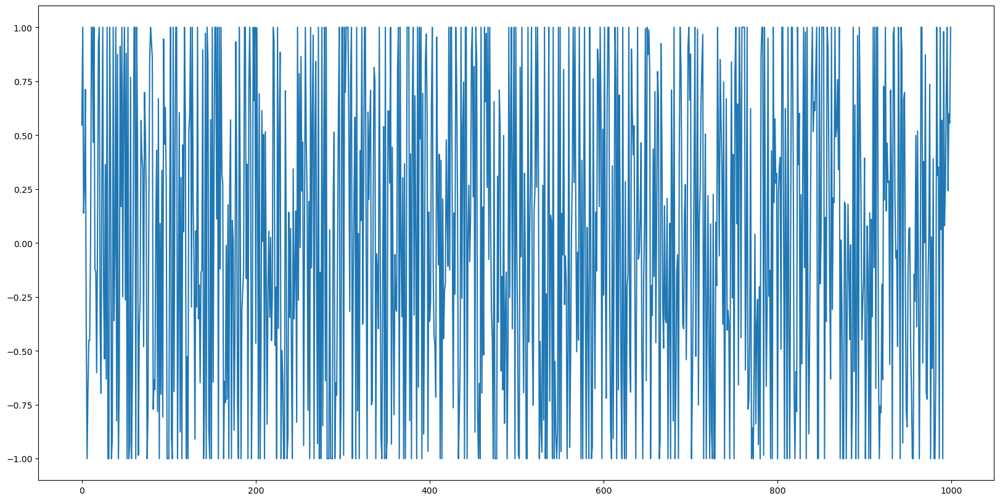

In [18]:
import matplotlib.pyplot as plt
plt.figure(figsize=(20,10))
plt.plot(t1[:1000])

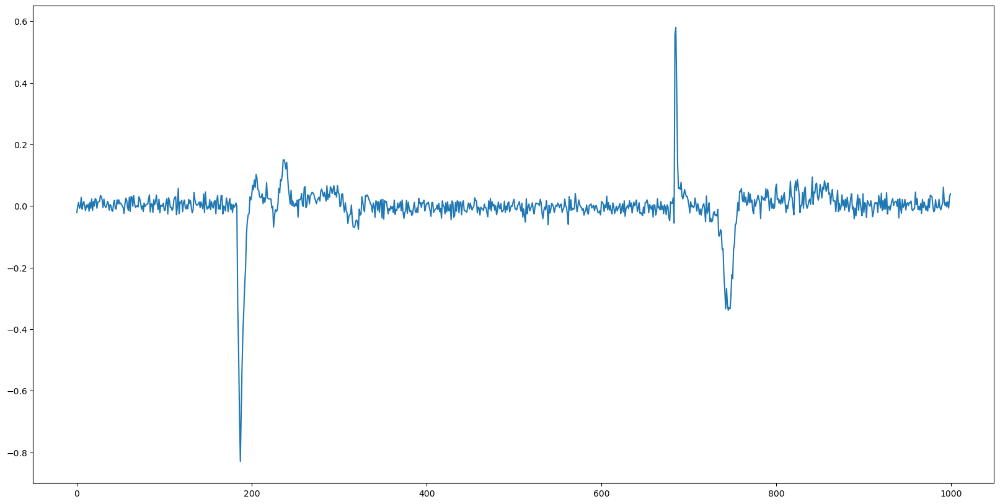

In [15]:
import matplotlib.pyplot as plt
plt.figure(figsize=(20,10))
plt.plot(t1[-1000:])

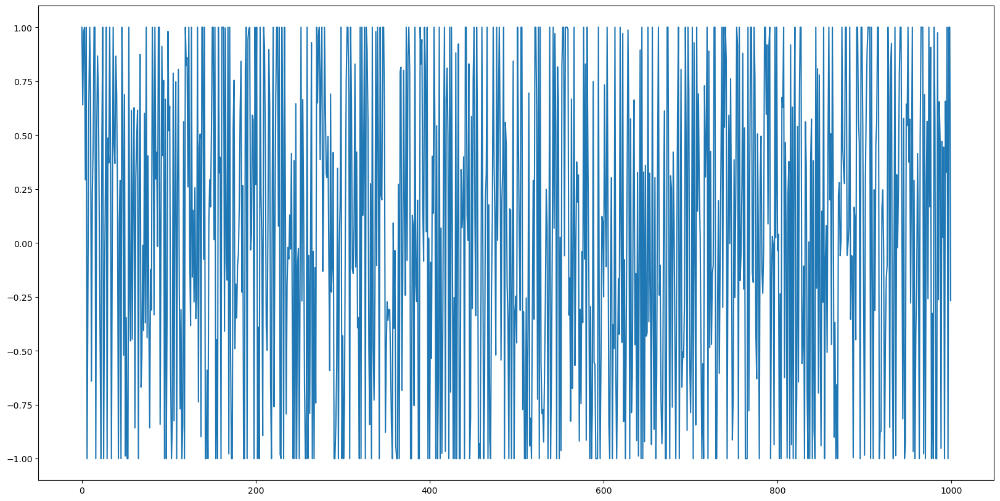

In [19]:
import matplotlib.pyplot as plt
plt.figure(figsize=(20,10))
plt.plot(t2[:1000])

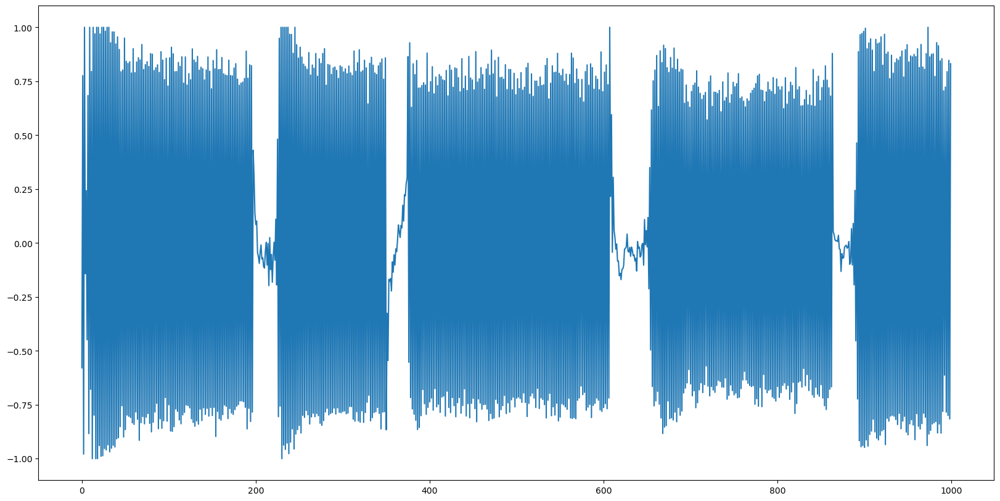

In [20]:
import matplotlib.pyplot as plt
plt.figure(figsize=(20,10))
plt.plot(t2[-1000:])

## Display the succesive random positions of the target

In [20]:
pos = np.array(env.target_pos)
pos.shape
X = np.array(pos)

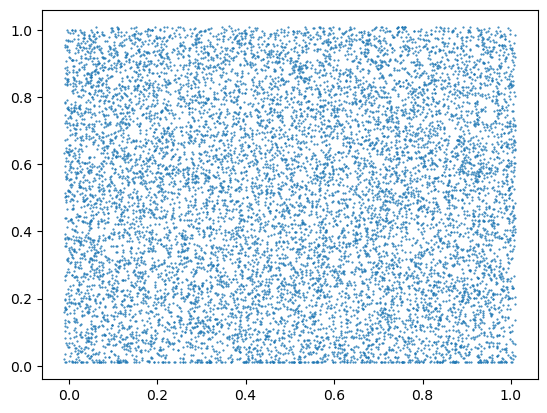

In [21]:
import matplotlib.pyplot as plt
plt.figure()
plt.plot(X[:,0], X[:,2],'.', markersize=1)

## Display the successive positions of the robot end effector

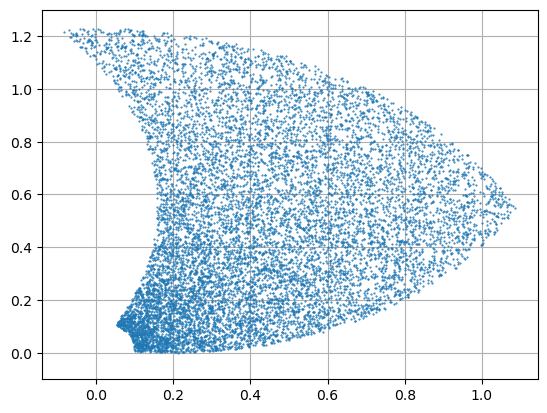

In [22]:
pos = np.array(env.ee_pos)
pos.shape
X = np.array(pos)
plt.figure()
plt.grid()
plt.ylim((-0.1,1.3))
plt.plot(X[:,0], X[:,1],'.', markersize=1)

## 2.5 Run the full training <a name="2.5"></a>

We prepare the set of random positions of the target :

In [18]:
import os, sys, time, shutil, yaml, pathlib, shutil
import pybullet as p
import pybullet_data
import numpy as np
from numpy.linalg import norm
import matplotlib.pyplot as plt
from math import pi
from utils.tools import welcome, plot_test, moving_average
from utils.RoboticArm_2DOF import RoboticArm_2DOF_PyBullet

In [19]:
if 'env' in dir(): env.close()

In [25]:
DT, SEED, T1_T2

(0.002, 1234567, (2000, 1000))

In [21]:
DT, SEED, T1_T2

(0.002, 1234567, (1000, 500))

In [20]:
DT, SEED, T1_T2

(0.002, 1234567, (600, 300))

In [21]:
DT, SEED, T1_T2

(0.004166666666666667, 1234567, (800, 400))

In [59]:
if 'env' in dir(): env.close()

URDF   = "./urdf/RoboticArm_2DOF_2.urdf"
TARGET = "./urdf/target.urdf"

env    = RoboticArm_2DOF_PyBullet(robot_urdf  = URDF, 
                                  target_urdf = TARGET, 
                                  dt = DT,
                                  init_robot_angles = (113, -140),
                                  t1_t2_conv = T1_T2,
                                  reward = 'reward_1',
                                  seed = SEED,
                                  headless = True, 
                                  max_episode_steps = 500,     # JLC 27/11/2023 was 400
                                  verbose=0)

#env.action_space.seed(1234)
#env.observation_space.seed(1234)

not connected...


[top](#top)

In [27]:
! tensorboard --logdir "./models/2DOF_RobotArm_PyBullet_PPO_22-09-26_17-56-23/PPO_1/"

TensorFlow installation not found - running with reduced feature set.

NOTE: Using experimental fast data loading logic. To disable, pass
    "--load_fast=false" and report issues on GitHub. More details:
    https://github.com/tensorflow/tensorboard/issues/4784

Serving TensorBoard on localhost; to expose to the network, use a proxy or pass --bind_all
TensorBoard 2.9.1 at http://localhost:6006/ (Press CTRL+C to quit)
^C


In [48]:
! tensorboard --logdir "./models/2DOF_RobotArm_PyBullet_PPO_23-11-20_22-43-13/PPO_1/"

TensorFlow installation not found - running with reduced feature set.

NOTE: Using experimental fast data loading logic. To disable, pass
    "--load_fast=false" and report issues on GitHub. More details:
    https://github.com/tensorflow/tensorboard/issues/4784

Serving TensorBoard on localhost; to expose to the network, use a proxy or pass --bind_all
TensorBoard 2.12.1 at http://localhost:6006/ (Press CTRL+C to quit)
^C


In [33]:
! tensorboard --logdir "./models/2DOF_RobotArm_PyBullet_PPO_23-11-23_17-59-40/PPO_1/"

TensorFlow installation not found - running with reduced feature set.

NOTE: Using experimental fast data loading logic. To disable, pass
    "--load_fast=false" and report issues on GitHub. More details:
    https://github.com/tensorflow/tensorboard/issues/4784

Serving TensorBoard on localhost; to expose to the network, use a proxy or pass --bind_all
TensorBoard 2.12.1 at http://localhost:6006/ (Press CTRL+C to quit)
^C


In [ ]:
# Visualiser pour chaque entrainement .zip comment le bras se positionne sur
# la target

from stable_baselines3 import PPO as agent

files = os.listdir(model_dir + "/ZIP")
files.sort()

epsilon = 1e-3
max_steps = 200

for f in files:
    print(f)
    model = agent.load(model_dir + "ZIP/" + f)

    verbose=1
    obs, _ = env.reset(options={"dt":DT, 
                             "target_initial_pos":(0.75, 0, 0.5),
                             "robot_initial_angle_deg":(113, -140),
                             "randomize":False,
                             "epsilon": epsilon})
    
    terminated, step_count, rewards, actions = False, 0, [], []
    while step_count < max_steps:
            action, _ = model.predict(obs, deterministic=True)
            obs, reward, terminated, _, info = env.step(action)
            rewards.append(float(reward))
            actions.append(action)
            step_count += 1
            #time.sleep(env.dt)
            if is_close_to(np.array(env.effector_pos), np.array(env.actual_target_pos), 1e-3): break
            if verbose and (step_count % 10 == 0) : print("\r", step_count, end="")
    if verbose: print(" ...done!")
    if step_count == max_steps+1: step_count -= 1    
    input("press ENTER for next file....")
    

In [33]:
list_files = get_files_by_date(model_dir + "ZIP")
print(list_files)

['rl_model_100000_steps.zip', 'rl_model_200000_steps.zip', 'rl_model_300000_steps.zip', 'rl_model_400000_steps.zip', 'rl_model_500000_steps.zip', 'rl_model_600000_steps.zip', 'rl_model_700000_steps.zip', 'rl_model_800000_steps.zip', 'rl_model_900000_steps.zip', 'rl_model_1000000_steps.zip', 'rl_model_1100000_steps.zip', 'rl_model_1200000_steps.zip', 'rl_model_1300000_steps.zip', 'rl_model_1400000_steps.zip', 'rl_model_1500000_steps.zip', 'rl_model_1600000_steps.zip', 'rl_model_1700000_steps.zip', 'rl_model_1800000_steps.zip', 'rl_model_1900000_steps.zip', 'rl_model_2000000_steps.zip', 'rl_model_2100000_steps.zip', 'rl_model_2200000_steps.zip', 'rl_model_2300000_steps.zip', 'rl_model_2400000_steps.zip', 'rl_model_2500000_steps.zip', 'rl_model_2600000_steps.zip', 'rl_model_2700000_steps.zip', 'rl_model_2800000_steps.zip', 'rl_model_2900000_steps.zip', 'rl_model_3000000_steps.zip', 'rl_model_3100000_steps.zip', 'rl_model_3200000_steps.zip', 'rl_model_3300000_steps.zip', 'rl_model_3400000_

#### Version 2022:

In [30]:
# on parcours les fichiers d'entrainement pour garder celui qui se positionne le mieux
# sur les 4 points définis.
error, err_mean, err_std, list_files, best_train = perf_trajectoire(env, model_dir, DT)
print(f"Best train: {best_train}, error: {err_mean*100:.2f} cm")    

rl_model_100000_steps.zip
	 e_mean, e_std:  79.26,  33.60 cm
rl_model_200000_steps.zip
	 e_mean, e_std:  55.57,  23.91 cm
rl_model_300000_steps.zip
	 e_mean, e_std:  24.75,  16.67 cm
rl_model_400000_steps.zip
	 e_mean, e_std:  10.90,   6.07 cm
rl_model_500000_steps.zip
	 e_mean, e_std:   8.06,   5.48 cm
rl_model_600000_steps.zip
	 e_mean, e_std:   5.48,   5.26 cm
rl_model_700000_steps.zip
	 e_mean, e_std:   6.71,   3.22 cm
rl_model_800000_steps.zip
	 e_mean, e_std:   9.22,   6.14 cm
rl_model_900000_steps.zip
	 e_mean, e_std:   3.78,   3.35 cm
rl_model_1000000_steps.zip
	 e_mean, e_std:   1.74,   1.61 cm
rl_model_1100000_steps.zip
	 e_mean, e_std:   5.67,   4.61 cm
rl_model_1200000_steps.zip
	 e_mean, e_std:   5.08,   3.93 cm
rl_model_1300000_steps.zip
	 e_mean, e_std:   4.24,   1.83 cm
rl_model_1400000_steps.zip
	 e_mean, e_std:   3.85,   1.61 cm
rl_model_1500000_steps.zip
	 e_mean, e_std:   3.65,   1.19 cm
rl_model_1600000_steps.zip
	 e_mean, e_std:   2.90,   1.59 cm
rl_model_1700000_

#### Version 2023:

<models/2DOF_RobotArm_PyBullet_PPO

In [27]:
training_dir

PosixPath('models/2DOF_RobotArm_PyBullet_PPO_23-12-05_10-26-40')

In [28]:
model_dir = training_dir

In [29]:
# on parcours les fichiers d'entrainement pour garder celui qui se positionne le mieux
# sur les 4 points définis.
error, err_mean, err_std, list_files, best_train = perf_trajectoire(env, model_dir, DT)
print(f"Best train: {best_train}, error: {err_mean*100:.2f} cm")    

>>> rl_model_100000_steps.zip     	 e_mean, e_std:  73.79,  29.96 cm
>>> rl_model_200000_steps.zip     	 e_mean, e_std:  19.07,   8.32 cm
>>> rl_model_300000_steps.zip     	 e_mean, e_std:  24.49,  27.92 cm
>>> rl_model_400000_steps.zip     	 e_mean, e_std:  26.07,  29.73 cm
>>> rl_model_500000_steps.zip     	 e_mean, e_std:  18.86,  28.31 cm
>>> rl_model_600000_steps.zip     	 e_mean, e_std:   1.67,   1.16 cm
>>> rl_model_700000_steps.zip     	 e_mean, e_std:   0.54,   0.74 cm
>>> rl_model_800000_steps.zip     	 e_mean, e_std:   0.34,   0.22 cm
>>> rl_model_900000_steps.zip     	 e_mean, e_std:   0.95,   0.60 cm
>>> rl_model_1000000_steps.zip    	 e_mean, e_std:   0.42,   0.26 cm
>>> rl_model_1100000_steps.zip    	 e_mean, e_std:   1.27,   0.51 cm
>>> rl_model_1200000_steps.zip    	 e_mean, e_std:   0.77,   0.47 cm
>>> rl_model_1300000_steps.zip    	 e_mean, e_std:   0.61,   0.22 cm
>>> rl_model_1400000_steps.zip    	 e_mean, e_std:   0.46,   0.34 cm
>>> rl_model_1500000_steps.zip    

In [31]:
error.mean(axis=1).argmin()

7

In [32]:
error.mean(axis=1)[error.mean(axis=1).argmin()]

0.0033500245700544507

In [33]:
list_files[error.mean(axis=1).argmin()]

'rl_model_800000_steps.zip'

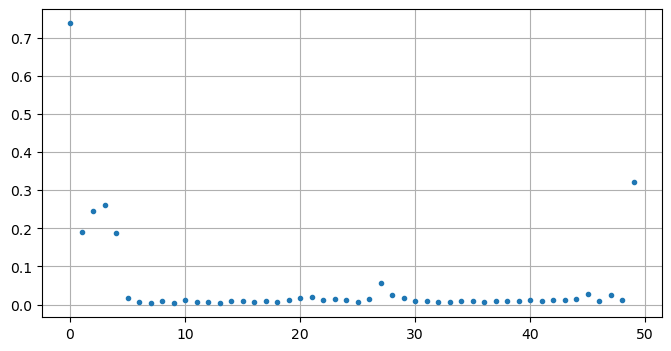

In [34]:
import matplotlib.pyplot as plt
plt.figure(figsize=(8,4))
plt.plot(error.mean(axis=1),'.')
plt.grid()

In [35]:
file = list_files[error.mean(axis=1).argmin()]
file

'rl_model_800000_steps.zip'

In [36]:
# Pour un fichier donné, on balaye plusieurs valeurs de numSubSteps, et pour chaque, 
# le bras parcours la trajetoire fermée définie par 4 points
file = list_files[error.mean(axis=1).argmin()]
error, err_mean, err_std, best_nSubSteps = perf_nbSubStep_trajectoire(env, model_dir, file, DT)
print(f"Best nSubStep: {best_nSubSteps}, error: {err_mean*100:.2f} cm")              

>>> nSubStep:    1	 e_mean:   0.34 cm, e_std:   0.22 cm
>>> nSubStep:    2	 e_mean:   0.34 cm, e_std:   0.22 cm
>>> nSubStep:    3	 e_mean:   0.34 cm, e_std:   0.22 cm
>>> nSubStep:    4	 e_mean:   0.34 cm, e_std:   0.22 cm
>>> nSubStep:    5	 e_mean:   0.34 cm, e_std:   0.22 cm
>>> nSubStep:    6	 e_mean:   0.34 cm, e_std:   0.22 cm
>>> nSubStep:    7	 e_mean:   0.34 cm, e_std:   0.22 cm
>>> nSubStep:    8	 e_mean:   0.34 cm, e_std:   0.22 cm
>>> nSubStep:    9	 e_mean:   0.34 cm, e_std:   0.22 cm
>>> nSubStep:   10	 e_mean:   0.34 cm, e_std:   0.22 cm
>>> nSubStep:   11	 e_mean:   0.34 cm, e_std:   0.22 cm
>>> nSubStep:   12	 e_mean:   0.34 cm, e_std:   0.22 cm
>>> nSubStep:   13	 e_mean:   0.34 cm, e_std:   0.22 cm
>>> nSubStep:   14	 e_mean:   0.34 cm, e_std:   0.22 cm
>>> nSubStep:   15	 e_mean:   0.34 cm, e_std:   0.22 cm
>>> nSubStep:   16	 e_mean:   0.34 cm, e_std:   0.22 cm
>>> nSubStep:   17	 e_mean:   0.34 cm, e_std:   0.22 cm
>>> nSubStep:   18	 e_mean:   0.34 cm, e_std:   

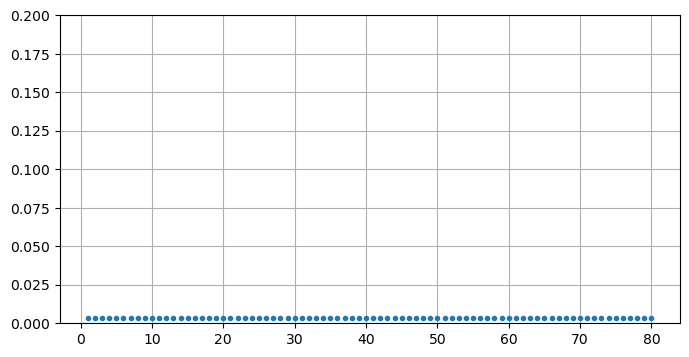

In [37]:
import matplotlib.pyplot as plt
plt.figure(figsize=(8,4))
plt.plot(range(1, 81, 1), error.mean(axis=1),'.')
plt.ylim((0,0.2))
plt.grid()

<models/2DOF_RobotArm_PyBullet_PPO

In [26]:
training_dir

PosixPath('models/2DOF_RobotArm_PyBullet_PPO_23-12-05_12-03-11')

In [27]:
model_dir = training_dir

In [28]:
# on parcours les fichiers d'entrainement pour garder celui qui se positionne le mieux
# sur les 4 points définis.
error, err_mean, err_std, list_files, best_train = perf_trajectoire(env, model_dir, DT)
print(f"Best train: {best_train}, error: {err_mean*100:.2f} cm")    

>>> rl_model_100000_steps.zip     	 e_mean, e_std:  71.89,  27.83 cm
>>> rl_model_200000_steps.zip     	 e_mean, e_std:  73.79,  29.96 cm
>>> rl_model_300000_steps.zip     	 e_mean, e_std:  20.05,  14.54 cm
>>> rl_model_400000_steps.zip     	 e_mean, e_std:  12.32,   8.23 cm
>>> rl_model_500000_steps.zip     	 e_mean, e_std:   8.70,   5.89 cm
>>> rl_model_600000_steps.zip     	 e_mean, e_std:   7.95,   3.40 cm
>>> rl_model_700000_steps.zip     	 e_mean, e_std:   5.35,   2.69 cm
>>> rl_model_800000_steps.zip     	 e_mean, e_std:   2.76,   2.19 cm
>>> rl_model_900000_steps.zip     	 e_mean, e_std:   1.75,   0.86 cm
>>> rl_model_1000000_steps.zip    	 e_mean, e_std:   2.98,   0.62 cm
>>> rl_model_1100000_steps.zip    	 e_mean, e_std:   2.72,   1.39 cm
>>> rl_model_1200000_steps.zip    	 e_mean, e_std:   3.07,   1.42 cm
>>> rl_model_1300000_steps.zip    	 e_mean, e_std:   2.84,   0.80 cm
>>> rl_model_1400000_steps.zip    	 e_mean, e_std:   2.37,   1.45 cm
>>> rl_model_1500000_steps.zip    

In [29]:
error.mean(axis=1).argmin()

47

In [30]:
error.mean(axis=1)[error.mean(axis=1).argmin()]

0.008359252732157985

In [31]:
list_files[error.mean(axis=1).argmin()]

'rl_model_4800000_steps.zip'

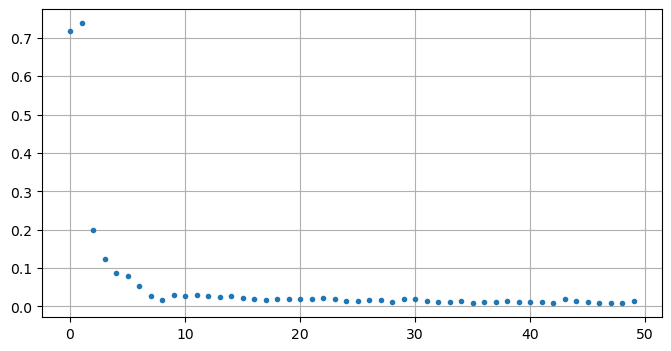

In [32]:
import matplotlib.pyplot as plt
plt.figure(figsize=(8,4))
plt.plot(error.mean(axis=1),'.')
plt.grid()

In [33]:
file = list_files[error.mean(axis=1).argmin()]
file

'rl_model_4800000_steps.zip'

In [34]:
# Pour un fichier donné, on balaye plusieurs valeurs de numSubSteps, et pour chaque, 
# le bras parcours la trajetoire fermée définie par 4 points
file = list_files[error.mean(axis=1).argmin()]
error, err_mean, err_std, best_nSubSteps = perf_nbSubStep_trajectoire(env, model_dir, file, DT)
print(f"Best nSubStep: {best_nSubSteps}, error: {err_mean*100:.2f} cm")              

>>> nSubStep:    1	 e_mean:   0.79 cm, e_std:   0.66 cm
>>> nSubStep:    2	 e_mean:   1.31 cm, e_std:   0.19 cm
>>> nSubStep:    3	 e_mean:   0.78 cm, e_std:   0.65 cm
>>> nSubStep:    4	 e_mean:   0.65 cm, e_std:   0.70 cm
>>> nSubStep:    5	 e_mean:   0.74 cm, e_std:   0.68 cm
>>> nSubStep:    6	 e_mean:   0.74 cm, e_std:   0.67 cm
>>> nSubStep:    7	 e_mean:   0.73 cm, e_std:   0.68 cm
>>> nSubStep:    8	 e_mean:   0.90 cm, e_std:   0.59 cm
>>> nSubStep:    9	 e_mean:   0.84 cm, e_std:   0.66 cm
>>> nSubStep:   10	 e_mean:   0.84 cm, e_std:   0.66 cm
>>> nSubStep:   11	 e_mean:   0.91 cm, e_std:   0.62 cm
>>> nSubStep:   12	 e_mean:   0.87 cm, e_std:   0.68 cm
>>> nSubStep:   13	 e_mean:   0.96 cm, e_std:   0.59 cm
>>> nSubStep:   14	 e_mean:   0.70 cm, e_std:   0.69 cm
>>> nSubStep:   15	 e_mean:   0.82 cm, e_std:   0.66 cm
>>> nSubStep:   16	 e_mean:   0.91 cm, e_std:   0.70 cm
>>> nSubStep:   17	 e_mean:   1.07 cm, e_std:   0.55 cm
>>> nSubStep:   18	 e_mean:   1.09 cm, e_std:   

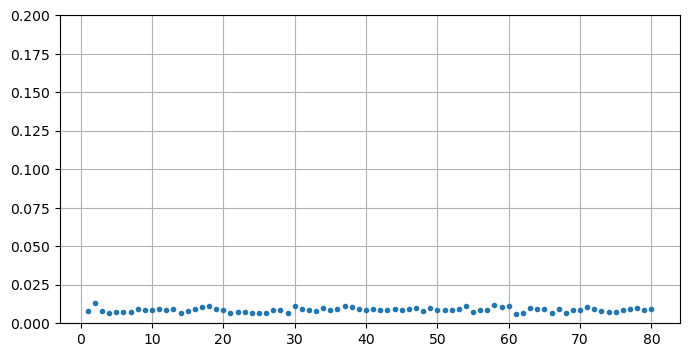

In [35]:
import matplotlib.pyplot as plt
plt.figure(figsize=(8,4))
plt.plot(range(1, 81, 1), error.mean(axis=1),'.')
plt.ylim((0,0.2))
plt.grid()

<models/2DOF_RobotArm_PyBullet_PPO

In [22]:
training_dir

PosixPath('models/2DOF_RobotArm_PyBullet_PPO_23-12-05_14-00-18')

In [23]:
model_dir = training_dir

In [24]:
# on parcours les fichiers d'entrainement pour garder celui qui se positionne le mieux
# sur les 4 points définis.
error, err_mean, err_std, list_files, best_train = perf_trajectoire(env, model_dir, DT)
print(f"Best train: {best_train}, error: {err_mean*100:.2f} cm")    

>>> rl_model_100000_steps.zip     	 e_mean, e_std:  75.15,  39.25 cm
>>> rl_model_200000_steps.zip     	 e_mean, e_std:  16.20,  10.26 cm
>>> rl_model_300000_steps.zip     	 e_mean, e_std:   9.53,   4.44 cm
>>> rl_model_400000_steps.zip     	 e_mean, e_std:   8.53,   2.90 cm
>>> rl_model_500000_steps.zip     	 e_mean, e_std:   8.66,   4.00 cm
>>> rl_model_600000_steps.zip     	 e_mean, e_std:   7.33,   2.44 cm
>>> rl_model_700000_steps.zip     	 e_mean, e_std:   6.98,   2.07 cm
>>> rl_model_800000_steps.zip     	 e_mean, e_std:   8.94,   3.75 cm
>>> rl_model_900000_steps.zip     	 e_mean, e_std:   9.96,   6.37 cm
>>> rl_model_1000000_steps.zip    	 e_mean, e_std:  10.84,   8.30 cm
>>> rl_model_1100000_steps.zip    	 e_mean, e_std:   9.57,   6.84 cm
>>> rl_model_1200000_steps.zip    	 e_mean, e_std:   9.37,   7.76 cm
>>> rl_model_1300000_steps.zip    	 e_mean, e_std:   9.26,   7.93 cm
>>> rl_model_1400000_steps.zip    	 e_mean, e_std:   8.88,   4.60 cm
>>> rl_model_1500000_steps.zip    

In [25]:
error.mean(axis=1).argmin()

24

In [26]:
error.mean(axis=1)[error.mean(axis=1).argmin()]

0.046034045118797336

In [27]:
list_files[error.mean(axis=1).argmin()]

'rl_model_2500000_steps.zip'

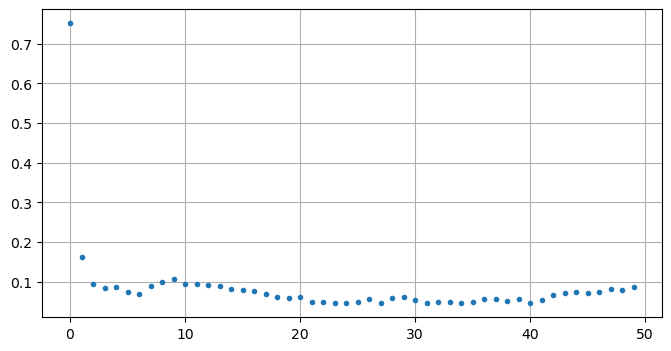

In [28]:
import matplotlib.pyplot as plt
plt.figure(figsize=(8,4))
plt.plot(error.mean(axis=1),'.')
plt.grid()

In [29]:
file = list_files[error.mean(axis=1).argmin()]
file

'rl_model_2500000_steps.zip'

In [30]:
# Pour un fichier donné, on balaye plusieurs valeurs de numSubSteps, et pour chaque, 
# le bras parcours la trajetoire fermée définie par 4 points
file = list_files[error.mean(axis=1).argmin()]
error, err_mean, err_std, best_nSubSteps = perf_nbSubStep_trajectoire(env, model_dir, file, DT)
print(f"Best nSubStep: {best_nSubSteps}, error: {err_mean*100:.2f} cm")              

>>> nSubStep:    1	 e_mean:   4.58 cm, e_std:   3.31 cm
>>> nSubStep:    2	 e_mean:   4.60 cm, e_std:   3.31 cm
>>> nSubStep:    3	 e_mean:   4.60 cm, e_std:   3.31 cm
>>> nSubStep:    4	 e_mean:   4.60 cm, e_std:   3.31 cm
>>> nSubStep:    5	 e_mean:   4.60 cm, e_std:   3.31 cm
>>> nSubStep:    6	 e_mean:   4.60 cm, e_std:   3.31 cm
>>> nSubStep:    7	 e_mean:   4.60 cm, e_std:   3.31 cm
>>> nSubStep:    8	 e_mean:   4.60 cm, e_std:   3.31 cm
>>> nSubStep:    9	 e_mean:   4.60 cm, e_std:   3.31 cm
>>> nSubStep:   10	 e_mean:   4.60 cm, e_std:   3.31 cm
>>> nSubStep:   11	 e_mean:   4.60 cm, e_std:   3.31 cm
>>> nSubStep:   12	 e_mean:   4.60 cm, e_std:   3.31 cm
>>> nSubStep:   13	 e_mean:   4.60 cm, e_std:   3.31 cm
>>> nSubStep:   14	 e_mean:   4.60 cm, e_std:   3.31 cm
>>> nSubStep:   15	 e_mean:   4.60 cm, e_std:   3.31 cm
>>> nSubStep:   16	 e_mean:   4.60 cm, e_std:   3.31 cm
>>> nSubStep:   17	 e_mean:   4.60 cm, e_std:   3.31 cm
>>> nSubStep:   18	 e_mean:   4.60 cm, e_std:   

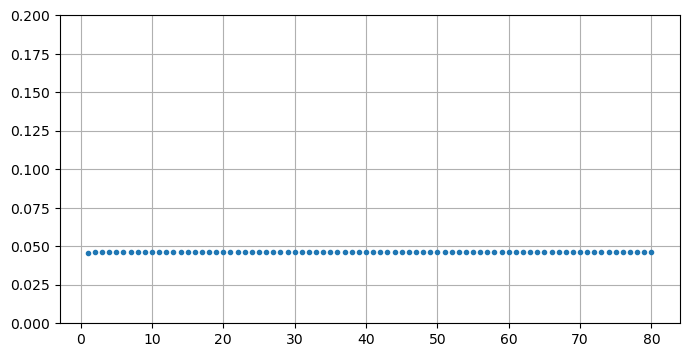

In [31]:
import matplotlib.pyplot as plt
plt.figure(figsize=(8,4))
plt.plot(range(1, 81, 1), error.mean(axis=1),'.')
plt.ylim((0,0.2))
plt.grid()

models/2DOF_RobotArm_PyBullet_PPO_23-11-27_08-19-06

    nb_steps   = 2048        # The number of steps to run per update (the size of the rollout buffer)
    nb_epochs  = 30
    batch_size = 256

    forces=[0.1, 0.1],

In [28]:
# on parcours les fichiers d'entrainement pour garder celui qui se positionne le mieux
# sur les 4 points définis.
error, err_mean, err_std, list_files, best_train = perf_trajectoire(env, model_dir, DT)
print(f"Best train: {best_train}, error: {err_mean*100:.2f} cm")    

rl_model_100000_steps.zip
	 e_mean, e_std:  21.68,  25.54 cm
rl_model_200000_steps.zip
	 e_mean, e_std:  10.56,   3.17 cm
rl_model_300000_steps.zip
	 e_mean, e_std:   6.38,   3.87 cm
rl_model_400000_steps.zip
	 e_mean, e_std:   3.32,   2.17 cm
rl_model_500000_steps.zip
	 e_mean, e_std:   4.04,   3.34 cm
rl_model_600000_steps.zip
	 e_mean, e_std:   2.80,   1.52 cm
rl_model_700000_steps.zip
	 e_mean, e_std:   6.80,   5.01 cm
rl_model_800000_steps.zip
	 e_mean, e_std:   2.03,   1.87 cm
rl_model_900000_steps.zip
	 e_mean, e_std:   2.93,   2.59 cm
rl_model_1000000_steps.zip
	 e_mean, e_std:   1.39,   0.69 cm
rl_model_1100000_steps.zip
	 e_mean, e_std:   0.73,   0.86 cm
rl_model_1200000_steps.zip
	 e_mean, e_std:   2.99,   1.31 cm
rl_model_1300000_steps.zip
	 e_mean, e_std:   3.61,   1.58 cm
rl_model_1400000_steps.zip
	 e_mean, e_std:   3.92,   1.21 cm
rl_model_1500000_steps.zip
	 e_mean, e_std:   1.49,   1.51 cm
rl_model_1600000_steps.zip
	 e_mean, e_std:   1.96,   1.13 cm
rl_model_1700000_

models/2DOF_RobotArm_PyBullet_PPO_23-11-28_14-33-15

    nb_steps   = 2048        # The number of steps to run per update (the size of the rollout buffer)
    nb_epochs  = 30
    batch_size = 512
    forces=[0.1, 0.1],

In [26]:
# on parcours les fichiers d'entrainement pour garder celui qui se positionne le mieux
# sur les 4 points définis.
error, err_mean, err_std, list_files, best_train = perf_trajectoire(env, model_dir, DT)
print(f"Best train: {best_train}, error: {err_mean*100:.2f} cm")    

rl_model_100000_steps.zip
	 e_mean, e_std:  50.88,  30.62 cm
rl_model_200000_steps.zip
	 e_mean, e_std:   8.79,   4.86 cm
rl_model_300000_steps.zip
	 e_mean, e_std:   7.81,   6.63 cm
rl_model_400000_steps.zip
	 e_mean, e_std:   6.47,   6.69 cm
rl_model_500000_steps.zip
	 e_mean, e_std:   4.25,   3.16 cm
rl_model_600000_steps.zip
	 e_mean, e_std:   5.45,   3.61 cm
rl_model_700000_steps.zip
	 e_mean, e_std:   4.63,   6.68 cm
rl_model_800000_steps.zip
	 e_mean, e_std:   9.17,   9.98 cm
rl_model_900000_steps.zip
	 e_mean, e_std:   5.60,   6.55 cm
rl_model_1000000_steps.zip
	 e_mean, e_std:   6.34,   7.02 cm
rl_model_1100000_steps.zip
	 e_mean, e_std:   7.69,   8.33 cm
rl_model_1200000_steps.zip
	 e_mean, e_std:   3.61,   3.25 cm
rl_model_1300000_steps.zip
	 e_mean, e_std:   2.66,   3.53 cm
rl_model_1400000_steps.zip
	 e_mean, e_std:   1.47,   2.47 cm
rl_model_1500000_steps.zip
	 e_mean, e_std:   0.08,   0.02 cm
rl_model_1600000_steps.zip
	 e_mean, e_std:   1.38,   2.66 cm
rl_model_1700000_

models/2DOF_RobotArm_PyBullet_PPO_23-11-28_20-28-22

    nb_steps   = 2048        # The number of steps to run per update (the size of the rollout buffer)
    nb_epochs  = 10
    batch_size = 256
    nb_max_step = 400
    forces=[10., 10.],

In [42]:
# on parcours les fichiers d'entrainement pour garder celui qui se positionne le mieux
# sur les 4 points définis.
error, err_mean, err_std, list_files, best_train = perf_trajectoire(env, model_dir, DT)
print(f"Best train: {best_train}, error: {err_mean*100:.2f} cm")    

rl_model_100000_steps.zip
	 e_mean, e_std:  55.43,  34.19 cm
rl_model_200000_steps.zip
	 e_mean, e_std:  40.31,  18.27 cm
rl_model_300000_steps.zip
	 e_mean, e_std:  40.96,  27.31 cm
rl_model_400000_steps.zip
	 e_mean, e_std:  25.54,   8.37 cm
rl_model_500000_steps.zip
	 e_mean, e_std:  25.92,   9.46 cm
rl_model_600000_steps.zip
	 e_mean, e_std:  21.73,  26.36 cm
rl_model_700000_steps.zip
	 e_mean, e_std:  10.29,   4.70 cm
rl_model_800000_steps.zip
	 e_mean, e_std:  10.58,   5.57 cm
rl_model_900000_steps.zip
	 e_mean, e_std:   3.66,   2.64 cm
rl_model_1000000_steps.zip
	 e_mean, e_std:   3.15,   1.53 cm
rl_model_1100000_steps.zip
	 e_mean, e_std:   2.90,   1.40 cm
rl_model_1200000_steps.zip
	 e_mean, e_std:   4.05,   2.30 cm
rl_model_1300000_steps.zip
	 e_mean, e_std:  23.26,  30.21 cm
rl_model_1400000_steps.zip
	 e_mean, e_std:  25.21,  31.34 cm
rl_model_1500000_steps.zip
	 e_mean, e_std:   6.28,   6.42 cm
rl_model_1600000_steps.zip
	 e_mean, e_std:   8.60,  10.28 cm
rl_model_1700000_

models/2DOF_RobotArm_PyBullet_PPO_23-11-28_20-28-22

    nb_steps   = 2048        # The number of steps to run per update (the size of the rollout buffer)
    nb_epochs  = 10
    batch_size = 256
    nb_max_step = 00
    torque1 *= 4900
    torque2 *= 2500
    forces=[10., 10.],

In [31]:
# on parcours les fichiers d'entrainement pour garder celui qui se positionne le mieux
# sur les 4 points définis.
error, err_mean, err_std, list_files, best_train = perf_trajectoire(env, model_dir, DT)
print(f"Best train: {best_train}, error: {err_mean*100:.2f} cm")    

rl_model_100000_steps.zip
	 e_mean, e_std:  36.82,  16.97 cm
rl_model_200000_steps.zip
	 e_mean, e_std:  39.77,  14.56 cm
rl_model_300000_steps.zip
	 e_mean, e_std:  32.10,  11.55 cm
rl_model_400000_steps.zip
	 e_mean, e_std:  18.55,  16.67 cm
rl_model_500000_steps.zip
	 e_mean, e_std:  20.98,  12.89 cm
rl_model_600000_steps.zip
	 e_mean, e_std:  22.76,  10.48 cm
rl_model_700000_steps.zip
	 e_mean, e_std:  15.25,   4.50 cm
rl_model_800000_steps.zip
	 e_mean, e_std:  10.96,   6.50 cm
rl_model_900000_steps.zip
	 e_mean, e_std:  11.58,   6.20 cm
rl_model_1000000_steps.zip
	 e_mean, e_std:   6.30,   3.67 cm
rl_model_1100000_steps.zip
	 e_mean, e_std:   5.11,   2.57 cm
rl_model_1200000_steps.zip
	 e_mean, e_std:  10.17,   7.37 cm
rl_model_1300000_steps.zip
	 e_mean, e_std:  13.36,   9.65 cm
rl_model_1400000_steps.zip
	 e_mean, e_std:  12.60,   9.96 cm
rl_model_1500000_steps.zip
	 e_mean, e_std:  11.28,   8.48 cm
rl_model_1600000_steps.zip
	 e_mean, e_std:   8.17,   4.77 cm
rl_model_1700000_

models/2DOF_RobotArm_PyBullet_PPO_23-11-28_20-28-22

    nb_steps   = 2048        # The number of steps to run per update (the size of the rollout buffer)
    nb_epochs  = 10
    batch_size = 256
    nb_max_step = 50
    torque1 *= 4500
    torque2 *= 2000
    forces=[20., 20.],

In [34]:
# on parcours les fichiers d'entrainement pour garder celui qui se positionne le mieux
# sur les 4 points définis.
error, err_mean, err_std, list_files, best_train = perf_trajectoire(env, model_dir, DT)
print(f"Best train: {best_train}, error: {err_mean*100:.2f} cm")    

rl_model_100000_steps.zip
	 e_mean, e_std:  57.55,  25.44 cm
rl_model_200000_steps.zip
	 e_mean, e_std:  48.94,   1.92 cm
rl_model_300000_steps.zip
	 e_mean, e_std:  33.58,  13.13 cm
rl_model_400000_steps.zip
	 e_mean, e_std:  12.34,  11.30 cm
rl_model_500000_steps.zip
	 e_mean, e_std:  12.66,   4.80 cm
rl_model_600000_steps.zip
	 e_mean, e_std:  13.92,   7.22 cm
rl_model_700000_steps.zip
	 e_mean, e_std:  13.25,   3.73 cm
rl_model_800000_steps.zip
	 e_mean, e_std:  14.35,   4.37 cm
rl_model_900000_steps.zip
	 e_mean, e_std:   8.38,   3.18 cm
rl_model_1000000_steps.zip
	 e_mean, e_std:   6.75,   2.32 cm
rl_model_1100000_steps.zip
	 e_mean, e_std:  11.12,   4.99 cm
rl_model_1200000_steps.zip
	 e_mean, e_std:  16.04,  17.56 cm
rl_model_1300000_steps.zip
	 e_mean, e_std:  22.38,  22.12 cm
rl_model_1400000_steps.zip
	 e_mean, e_std:  28.96,  29.44 cm
rl_model_1500000_steps.zip
	 e_mean, e_std:  19.21,  16.83 cm
rl_model_1600000_steps.zip
	 e_mean, e_std:  15.53,  13.10 cm
rl_model_1700000_

### 2DOF_RobotArm_PyBullet_PPO_23-11-30_00-24-57

    nb_steps   = 2048        # The number of steps to run per update (the size of the rollout buffer)
    nb_epochs  = 10
    batch_size = 256
    nb_max_step = 50
    torque1 *= 4500
    torque2 *= 2000
    forces=[5., 5.],

In [203]:
model_dir = "./models/2DOF_RobotArm_PyBullet_PPO_23-11-30_00-24-57/"

In [204]:
training_dir= "./models/2DOF_RobotArm_PyBullet_PPO_23-11-30_00-24-57/"

In [206]:
# on parcours les fichiers d'entrainement pour garder celui qui se positionne le mieux
# sur les 4 points définis.
error, err_mean, err_std, list_files, best_train = perf_trajectoire(env, model_dir, DT)
print(f"Best train: {best_train}, error: {err_mean*100:.2f} cm")    

rl_model_100000_steps.zip
	 e_mean, e_std:  44.74,  15.50 cm
rl_model_200000_steps.zip
	 e_mean, e_std:  37.50,  14.93 cm
rl_model_300000_steps.zip
	 e_mean, e_std:  32.52,   9.14 cm
rl_model_400000_steps.zip
	 e_mean, e_std:  32.11,  12.78 cm
rl_model_500000_steps.zip
	 e_mean, e_std:  20.72,   9.80 cm
rl_model_600000_steps.zip
	 e_mean, e_std:  30.83,  14.22 cm
rl_model_700000_steps.zip
	 e_mean, e_std:  18.47,   7.36 cm
rl_model_800000_steps.zip
	 e_mean, e_std:  17.91,   9.32 cm
rl_model_900000_steps.zip
	 e_mean, e_std:  17.42,   5.75 cm
rl_model_1000000_steps.zip
	 e_mean, e_std:  12.74,   7.77 cm
rl_model_1100000_steps.zip
	 e_mean, e_std:  10.16,   4.10 cm
rl_model_1200000_steps.zip
	 e_mean, e_std:   7.50,   2.22 cm
rl_model_1300000_steps.zip
	 e_mean, e_std:   8.88,   6.23 cm
rl_model_1400000_steps.zip
	 e_mean, e_std:   9.80,   5.50 cm
rl_model_1500000_steps.zip
	 e_mean, e_std:   7.62,   3.02 cm
rl_model_1600000_steps.zip
	 e_mean, e_std:   4.39,   1.97 cm
rl_model_1700000_

In [207]:
e_mean = error.mean(axis=1)
L = np.where(e_mean < 0.01)

for i in L[0].tolist():
    print(f"{list_files[i]} -> {e_mean[i]*100:.2f} cm,"
          f"max: {error[i].max()*100:.2f} cm,"
          f"min: {error[i].min()*100:.2f} cm," 
          f"std: {error[i].std()*100:.2f} cm")

rl_model_3000000_steps.zip -> 0.05 cm,max: 0.07 cm,min: 0.02 cm,std: 0.02 cm
rl_model_3100000_steps.zip -> 0.78 cm,max: 3.44 cm,min: 0.02 cm,std: 1.33 cm
rl_model_3600000_steps.zip -> 0.67 cm,max: 1.49 cm,min: 0.08 cm,std: 0.54 cm
rl_model_4300000_steps.zip -> 0.55 cm,max: 1.28 cm,min: 0.08 cm,std: 0.57 cm
rl_model_4600000_steps.zip -> 0.24 cm,max: 0.55 cm,min: 0.06 cm,std: 0.22 cm
rl_model_4700000_steps.zip -> 0.92 cm,max: 2.16 cm,min: 0.08 cm,std: 0.78 cm
rl_model_4800000_steps.zip -> 0.93 cm,max: 2.45 cm,min: 0.09 cm,std: 0.81 cm
rl_model_4900000_steps.zip -> 0.15 cm,max: 0.53 cm,min: 0.02 cm,std: 0.19 cm
rl_model_5000000_steps.zip -> 0.91 cm,max: 1.62 cm,min: 0.08 cm,std: 0.69 cm


In [208]:
error.mean(axis=1).argmin()

29

In [209]:
error.mean(axis=1)[error.mean(axis=1).argmin()]

0.0005236317573458656

In [210]:
list_files[error.mean(axis=1).argmin()]

'rl_model_3000000_steps.zip'

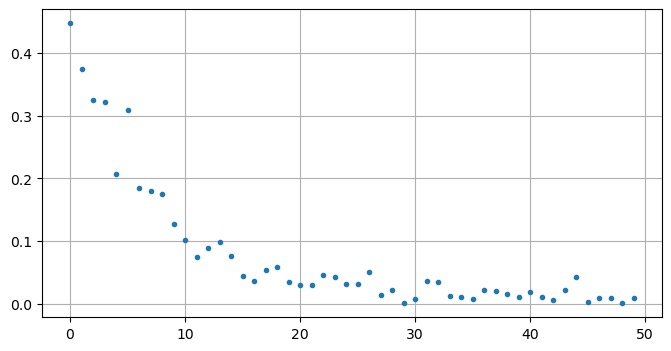

In [212]:
import matplotlib.pyplot as plt
plt.figure(figsize=(8,4))
plt.plot(error.mean(axis=1),'.')
plt.grid()

In [216]:
file = list_files[error.mean(axis=1).argmin()]

In [217]:
# Pour un fichier donné, on balaye plusieurs valeurs de numSubSteps, et pour chaque, 
# le bras parcours la trajetoire fermée définie par 4 points

error, err_mean, err_std, best_nSubSteps = perf_nbSubStep_trajectoire(env, model_dir, file, DT, max_steps=500)
print(f"Best nSubStep: {best_nSubSteps}, error: {err_mean*100:.2f} cm")              

>>> nSubStep:    1	 e_mean:   2.36 cm, e_std:   1.20 cm
>>> nSubStep:    2	 e_mean:   3.48 cm, e_std:   1.08 cm
>>> nSubStep:    3	 e_mean:   1.57 cm, e_std:   1.04 cm
>>> nSubStep:    4	 e_mean:   2.61 cm, e_std:   1.40 cm
>>> nSubStep:    5	 e_mean:   1.60 cm, e_std:   1.43 cm
>>> nSubStep:    6	 e_mean:   2.45 cm, e_std:   1.45 cm
>>> nSubStep:    7	 e_mean:   1.76 cm, e_std:   0.87 cm
>>> nSubStep:    8	 e_mean:   1.16 cm, e_std:   1.55 cm
>>> nSubStep:    9	 e_mean:   1.36 cm, e_std:   0.96 cm
>>> nSubStep:   10	 e_mean:   2.00 cm, e_std:   1.23 cm
>>> nSubStep:   11	 e_mean:   1.76 cm, e_std:   1.31 cm
>>> nSubStep:   12	 e_mean:   2.58 cm, e_std:   1.36 cm
>>> nSubStep:   13	 e_mean:   0.87 cm, e_std:   1.59 cm
>>> nSubStep:   14	 e_mean:   1.25 cm, e_std:   1.32 cm
>>> nSubStep:   15	 e_mean:   1.12 cm, e_std:   0.95 cm
>>> nSubStep:   16	 e_mean:   0.57 cm, e_std:   0.75 cm
>>> nSubStep:   17	 e_mean:   2.21 cm, e_std:   1.89 cm
>>> nSubStep:   18	 e_mean:   1.43 cm, e_std:   

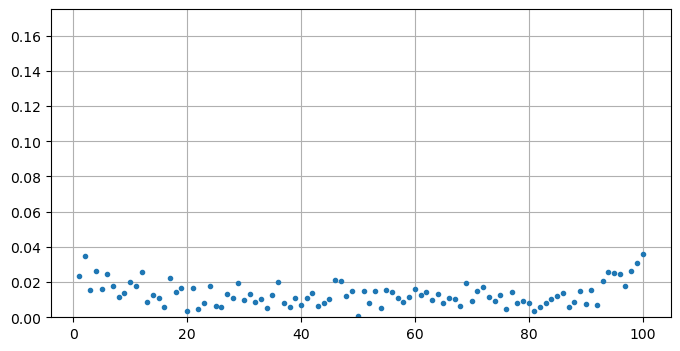

In [218]:
import matplotlib.pyplot as plt
plt.figure(figsize=(8,4))
plt.plot(range(1, 101, 1), error.mean(axis=1),'.')
plt.ylim((0,0.175))
plt.grid()

### 2DOF_RobotArm_PyBullet_PO_23-11-30_08-31-17

    nb_steps   = 2048        # The number of steps to run per update (the size of the rollout buffer)
    nb_epochs  = 10
    batch_size = 256
    torque1 *= 4600
    torque2 *= 2100
    nb_max_step = 50
    forces=[5., 5.],

In [234]:
model_dir = "./models/2DOF_RobotArm_PyBullet_PPO_23-11-30_08-31-17/"

In [235]:
training_dir= "./models/2DOF_RobotArm_PyBullet_PPO_23-11-30_08-31-17/"

In [236]:
# on parcours les fichiers d'entrainement pour garder celui qui se positionne le mieux
# sur les 4 points définis.
error, err_mean, err_std, list_files, best_train = perf_trajectoire(env, model_dir, DT, max_steps_nb=500, verbose=0)
print(f"Best train: {best_train}, error: {err_mean*100:.2f} cm")    

rl_model_100000_steps.zip
	 e_mean, e_std:  72.78,  29.86 cm
rl_model_200000_steps.zip
	 e_mean, e_std:  32.06,   9.83 cm
rl_model_300000_steps.zip
	 e_mean, e_std:  40.23,  24.35 cm
rl_model_400000_steps.zip
	 e_mean, e_std:  10.61,   6.45 cm
rl_model_500000_steps.zip
	 e_mean, e_std:  13.29,   4.76 cm
rl_model_600000_steps.zip
	 e_mean, e_std:   8.45,   5.28 cm
rl_model_700000_steps.zip
	 e_mean, e_std:  15.30,   9.57 cm
rl_model_800000_steps.zip
	 e_mean, e_std:  16.05,   8.34 cm
rl_model_900000_steps.zip
	 e_mean, e_std:  10.99,   5.16 cm
rl_model_1000000_steps.zip
	 e_mean, e_std:   8.17,  10.91 cm
rl_model_1100000_steps.zip
	 e_mean, e_std:  10.27,  10.76 cm
rl_model_1200000_steps.zip
	 e_mean, e_std:   7.07,   6.74 cm
rl_model_1300000_steps.zip
	 e_mean, e_std:  24.54,  29.02 cm
rl_model_1400000_steps.zip
	 e_mean, e_std:  22.21,  29.64 cm
rl_model_1500000_steps.zip
	 e_mean, e_std:  20.40,  28.86 cm
rl_model_1600000_steps.zip
	 e_mean, e_std:  17.94,  29.83 cm
rl_model_1700000_

In [237]:
e_mean = error.mean(axis=1)
L = np.where(e_mean < 0.01)

for i in L[0].tolist():
    print(f"{list_files[i]} -> {e_mean[i]*100:.2f} cm,"
          f"max: {error[i].max()*100:.2f} cm,"
          f"min: {error[i].min()*100:.2f} cm," 
          f"std: {error[i].std()*100:.2f} cm")

rl_model_2100000_steps.zip -> 0.87 cm,max: 1.26 cm,min: 0.63 cm,std: 0.22 cm
rl_model_2200000_steps.zip -> 0.48 cm,max: 0.95 cm,min: 0.08 cm,std: 0.37 cm
rl_model_2600000_steps.zip -> 0.78 cm,max: 2.52 cm,min: 0.02 cm,std: 0.98 cm


In [238]:
error.mean(axis=1).argmin()

21

In [239]:
error.mean(axis=1)[error.mean(axis=1).argmin()]

0.004776642399284318

In [240]:
list_files[error.mean(axis=1).argmin()]

'rl_model_2200000_steps.zip'

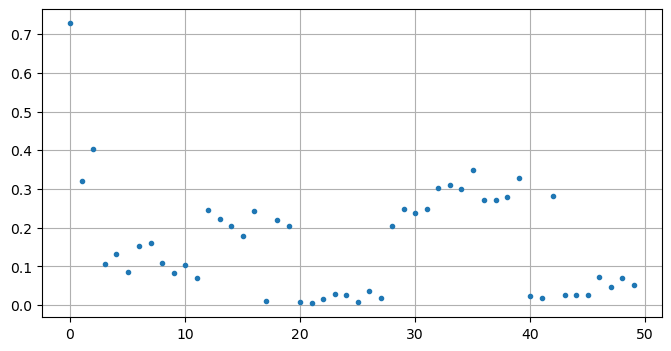

In [241]:
import matplotlib.pyplot as plt
plt.figure(figsize=(8,4))
plt.plot(error.mean(axis=1),'.')
plt.grid()

In [243]:
file = list_files[error.mean(axis=1).argmin()]
file

'rl_model_2200000_steps.zip'

In [245]:
# Pour un fichier donné, on balaye plusieurs valeurs de numSubSteps, et pour chaque, 
# le bras parcours la trajetoire fermée définie par 4 points

error, err_mean, err_std, best_nSubSteps = perf_nbSubStep_trajectoire(env, model_dir, file, DT, max_steps=500)
print(f"Best nSubStep: {best_nSubSteps}, error: {err_mean*100:.2f} cm")              

>>> nSubStep:    1	 e_mean:   0.85 cm, e_std:   0.71 cm
>>> nSubStep:    2	 e_mean:   0.77 cm, e_std:   0.60 cm
>>> nSubStep:    3	 e_mean:   1.17 cm, e_std:   0.46 cm
>>> nSubStep:    4	 e_mean:   1.13 cm, e_std:   0.37 cm
>>> nSubStep:    5	 e_mean:   0.93 cm, e_std:   0.59 cm
>>> nSubStep:    6	 e_mean:   2.46 cm, e_std:   2.24 cm
>>> nSubStep:    7	 e_mean:  15.31 cm, e_std:  27.42 cm
>>> nSubStep:    8	 e_mean:   1.24 cm, e_std:   0.37 cm
>>> nSubStep:    9	 e_mean:   1.02 cm, e_std:   0.57 cm
>>> nSubStep:   10	 e_mean:   1.39 cm, e_std:   0.92 cm
>>> nSubStep:   11	 e_mean:   1.08 cm, e_std:   0.67 cm
>>> nSubStep:   12	 e_mean:   2.44 cm, e_std:   2.93 cm
>>> nSubStep:   13	 e_mean:   3.60 cm, e_std:   4.15 cm
>>> nSubStep:   14	 e_mean:   3.24 cm, e_std:   4.41 cm
>>> nSubStep:   15	 e_mean:   1.22 cm, e_std:   0.35 cm
>>> nSubStep:   16	 e_mean:   1.01 cm, e_std:   0.52 cm
>>> nSubStep:   17	 e_mean:  17.50 cm, e_std:  29.41 cm
>>> nSubStep:   18	 e_mean:   0.93 cm, e_std:   

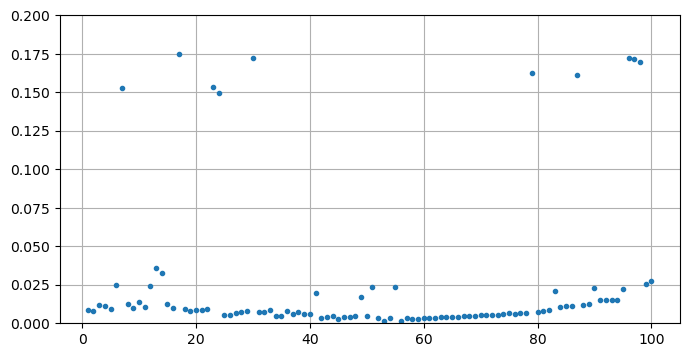

In [248]:
import matplotlib.pyplot as plt
plt.figure(figsize=(8,4))
plt.plot(range(1, 101, 1), error.mean(axis=1),'.')
plt.ylim((0,0.2))
plt.grid()

### models/2DOF_RobotArm_PyBullet_PPO_23-12-01_10-28-47

    nb_steps   = 2048        # The number of steps to run per update (the size of the rollout buffer)
    nb_epochs  = 10
    batch_size = 256
    torque1 *= 4600
    torque2 *= 2100
    nb_max_step = 50
    forces=[5., 5.],

In [39]:
model_dir = "./models/2DOF_RobotArm_PyBullet_PPO_23-12-01_10-28-47/"

In [40]:
training_dir = model_dir

In [42]:
! tensorboard --logdir "./models/2DOF_RobotArm_PyBullet_PPO_23-12-01_10-28-47/PPO_1/"

TensorFlow installation not found - running with reduced feature set.

NOTE: Using experimental fast data loading logic. To disable, pass
    "--load_fast=false" and report issues on GitHub. More details:
    https://github.com/tensorflow/tensorboard/issues/4784

Serving TensorBoard on localhost; to expose to the network, use a proxy or pass --bind_all
TensorBoard 2.12.1 at http://localhost:6006/ (Press CTRL+C to quit)
^C


In [14]:
# on parcours les fichiers d'entrainement pour garder celui qui se positionne le mieux
# sur les 4 points définis.
error, err_mean, err_std, list_files, best_train = perf_trajectoire(env, model_dir, DT)
print(f"Best train: {best_train}, error: {err_mean*100:.2f} cm")    

rl_model_100000_steps.zip
	 e_mean, e_std:  68.08,  31.11 cm
rl_model_200000_steps.zip
	 e_mean, e_std:  32.15,   9.94 cm
rl_model_300000_steps.zip
	 e_mean, e_std:  40.24,  24.29 cm
rl_model_400000_steps.zip
	 e_mean, e_std:  11.91,   6.54 cm
rl_model_500000_steps.zip
	 e_mean, e_std:  12.79,   4.62 cm
rl_model_600000_steps.zip
	 e_mean, e_std:   9.20,   6.67 cm
rl_model_700000_steps.zip
	 e_mean, e_std:  14.90,   9.72 cm
rl_model_800000_steps.zip
	 e_mean, e_std:  15.98,   8.38 cm
rl_model_900000_steps.zip
	 e_mean, e_std:  14.15,   5.59 cm
rl_model_1000000_steps.zip
	 e_mean, e_std:   9.38,  10.43 cm
rl_model_1100000_steps.zip
	 e_mean, e_std:  10.59,  10.04 cm
rl_model_1200000_steps.zip
	 e_mean, e_std:   7.13,   6.93 cm
rl_model_1300000_steps.zip
	 e_mean, e_std:  24.09,  29.21 cm
rl_model_1400000_steps.zip
	 e_mean, e_std:  22.57,  29.41 cm
rl_model_1500000_steps.zip
	 e_mean, e_std:  20.44,  28.84 cm
rl_model_1600000_steps.zip
	 e_mean, e_std:   2.06,   3.15 cm
rl_model_1700000_

In [16]:
e_mean = error.mean(axis=1)
L = np.where(e_mean < 0.01)

for i in L[0].tolist():
    print(f"{list_files[i]} -> {e_mean[i]*100:.2f} cm,"
          f"max: {error[i].max()*100:.2f} cm,"
          f"min: {error[i].min()*100:.2f} cm," 
          f"std: {error[i].std()*100:.2f} cm")

rl_model_2100000_steps.zip -> 0.78 cm,max: 1.19 cm,min: 0.28 cm,std: 0.31 cm
rl_model_2200000_steps.zip -> 0.40 cm,max: 0.82 cm,min: 0.08 cm,std: 0.30 cm
rl_model_2600000_steps.zip -> 0.84 cm,max: 2.80 cm,min: 0.06 cm,std: 1.07 cm


In [17]:
error.mean(axis=1).argmin()

21

In [18]:
error.mean(axis=1)[error.mean(axis=1).argmin()]

0.0040027024444449525

In [19]:
list_files[error.mean(axis=1).argmin()]

'rl_model_2200000_steps.zip'

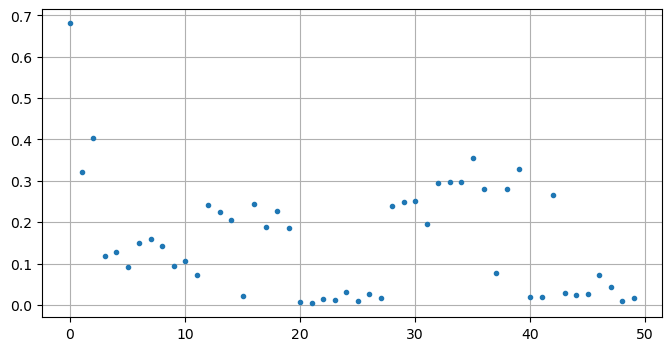

In [20]:
import matplotlib.pyplot as plt
plt.figure(figsize=(8,4))
plt.plot(error.mean(axis=1),'.')
plt.grid()

In [21]:
file = list_files[error.mean(axis=1).argmin()]
file

'rl_model_2200000_steps.zip'

In [22]:
# Pour un fichier donné, on balaye plusieurs valeurs de numSubSteps, et pour chaque, 
# le bras parcours la trajetoire fermée définie par 4 points
file = list_files[error.mean(axis=1).argmin()]
error, err_mean, err_std, best_nSubSteps = perf_nbSubStep_trajectoire(env, model_dir, file, DT)
print(f"Best nSubStep: {best_nSubSteps}, error: {err_mean*100:.2f} cm")              

>>> nSubStep:    1	 e_mean:  15.94 cm, e_std:  27.40 cm
>>> nSubStep:    2	 e_mean:   2.48 cm, e_std:   2.92 cm
>>> nSubStep:    3	 e_mean:   1.22 cm, e_std:   0.18 cm
>>> nSubStep:    4	 e_mean:   1.30 cm, e_std:   0.22 cm
>>> nSubStep:    5	 e_mean:  15.28 cm, e_std:  27.49 cm
>>> nSubStep:    6	 e_mean:   3.02 cm, e_std:   3.52 cm
>>> nSubStep:    7	 e_mean:   1.76 cm, e_std:   0.82 cm
>>> nSubStep:    8	 e_mean:  17.66 cm, e_std:  29.43 cm
>>> nSubStep:    9	 e_mean:  18.66 cm, e_std:  30.06 cm
>>> nSubStep:   10	 e_mean:   1.06 cm, e_std:   0.35 cm
>>> nSubStep:   11	 e_mean:   2.45 cm, e_std:   2.79 cm
>>> nSubStep:   12	 e_mean:   1.00 cm, e_std:   0.51 cm
>>> nSubStep:   13	 e_mean:   0.79 cm, e_std:   0.62 cm
>>> nSubStep:   14	 e_mean:   0.80 cm, e_std:   0.63 cm
>>> nSubStep:   15	 e_mean:  18.23 cm, e_std:  30.14 cm
>>> nSubStep:   16	 e_mean:   2.31 cm, e_std:   2.79 cm
>>> nSubStep:   17	 e_mean:   1.16 cm, e_std:   0.24 cm
>>> nSubStep:   18	 e_mean:   0.74 cm, e_std:   

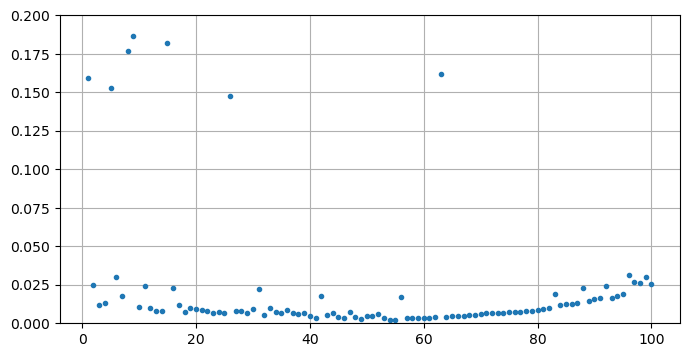

In [23]:
import matplotlib.pyplot as plt
plt.figure(figsize=(8,4))
plt.plot(range(1, 101, 1), error.mean(axis=1),'.')
plt.ylim((0,0.2))
plt.grid()

### models/2DOF_RobotArm_PyBullet_PPO_23-12-01_16-11-58/

    nb_steps   = 2048        # The number of steps to run per update (the size of the rollout buffer)
    nb_epochs  = 10
    batch_size = 256
    torque1 *= 4700
    torque2 *= 2100
    nb_max_step = 50
    forces=[5., 5.],

In [11]:
model_dir = "./models/2DOF_RobotArm_PyBullet_PPO_23-12-01_16-11-58/"

In [12]:
training_dir = model_dir

In [13]:
# on parcours les fichiers d'entrainement pour garder celui qui se positionne le mieux
# sur les 4 points définis.
error, err_mean, err_std, list_files, best_train = perf_trajectoire(env, model_dir, DT)
print(f"Best train: {best_train}, error: {err_mean*100:.2f} cm")    

rl_model_100000_steps.zip
	 e_mean, e_std:  73.79,  29.96 cm
rl_model_200000_steps.zip
	 e_mean, e_std:  33.13,  12.81 cm
rl_model_300000_steps.zip
	 e_mean, e_std:  23.83,   7.34 cm
rl_model_400000_steps.zip
	 e_mean, e_std:  17.94,   3.74 cm
rl_model_500000_steps.zip
	 e_mean, e_std:  11.02,   5.45 cm
rl_model_600000_steps.zip
	 e_mean, e_std:  17.42,   7.73 cm
rl_model_700000_steps.zip
	 e_mean, e_std:   6.07,   5.12 cm
rl_model_800000_steps.zip
	 e_mean, e_std:   6.71,   3.92 cm
rl_model_900000_steps.zip
	 e_mean, e_std:   9.00,   2.56 cm
rl_model_1000000_steps.zip
	 e_mean, e_std:   4.43,   4.65 cm
rl_model_1100000_steps.zip
	 e_mean, e_std:   5.31,   3.53 cm
rl_model_1200000_steps.zip
	 e_mean, e_std:   3.05,   1.84 cm
rl_model_1300000_steps.zip
	 e_mean, e_std:   4.98,   3.43 cm
rl_model_1400000_steps.zip
	 e_mean, e_std:   3.97,   2.17 cm
rl_model_1500000_steps.zip
	 e_mean, e_std:   4.17,   1.91 cm
rl_model_1600000_steps.zip
	 e_mean, e_std:   3.37,   2.74 cm
rl_model_1700000_

In [14]:
e_mean = error.mean(axis=1)
L = np.where(e_mean < 0.01)

for i in L[0].tolist():
    print(f"{list_files[i]} -> {e_mean[i]*100:.2f} cm,"
          f"max: {error[i].max()*100:.2f} cm,"
          f"min: {error[i].min()*100:.2f} cm," 
          f"std: {error[i].std()*100:.2f} cm")

rl_model_2900000_steps.zip -> 0.93 cm,max: 2.47 cm,min: 0.09 cm,std: 0.87 cm
rl_model_3900000_steps.zip -> 0.92 cm,max: 2.16 cm,min: 0.07 cm,std: 0.90 cm
rl_model_4000000_steps.zip -> 0.65 cm,max: 1.55 cm,min: 0.10 cm,std: 0.52 cm
rl_model_4100000_steps.zip -> 0.63 cm,max: 1.51 cm,min: 0.09 cm,std: 0.56 cm
rl_model_4500000_steps.zip -> 0.28 cm,max: 1.20 cm,min: 0.01 cm,std: 0.46 cm
rl_model_4600000_steps.zip -> 0.63 cm,max: 1.46 cm,min: 0.07 cm,std: 0.68 cm
rl_model_4800000_steps.zip -> 0.70 cm,max: 2.45 cm,min: 0.05 cm,std: 0.92 cm
rl_model_4900000_steps.zip -> 0.51 cm,max: 1.43 cm,min: 0.05 cm,std: 0.58 cm
rl_model_5000000_steps.zip -> 0.79 cm,max: 1.89 cm,min: 0.06 cm,std: 0.71 cm


In [15]:
error.mean(axis=1).argmin()

44

In [16]:
error.mean(axis=1)[error.mean(axis=1).argmin()]

0.0027998219807761552

In [17]:
list_files[error.mean(axis=1).argmin()]

'rl_model_4500000_steps.zip'

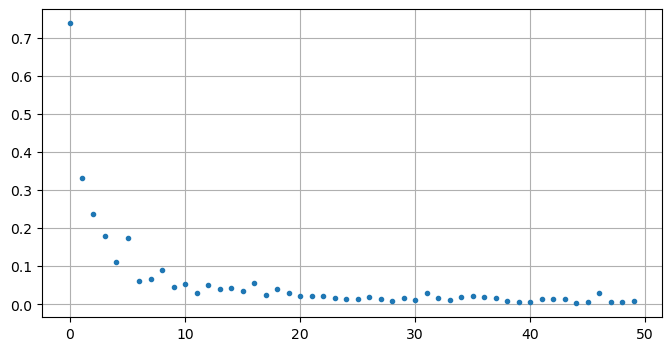

In [18]:
import matplotlib.pyplot as plt
plt.figure(figsize=(8,4))
plt.plot(error.mean(axis=1),'.')
plt.grid()

In [19]:
file = list_files[error.mean(axis=1).argmin()]
file

'rl_model_4500000_steps.zip'

In [20]:
# Pour un fichier donné, on balaye plusieurs valeurs de numSubSteps, et pour chaque, 
# le bras parcours la trajetoire fermée définie par 4 points
file = list_files[error.mean(axis=1).argmin()]
error, err_mean, err_std, best_nSubSteps = perf_nbSubStep_trajectoire(env, model_dir, file, DT)
print(f"Best nSubStep: {best_nSubSteps}, error: {err_mean*100:.2f} cm")              

>>> nSubStep:    1	 e_mean:   1.64 cm, e_std:   0.95 cm
>>> nSubStep:    2	 e_mean:   1.07 cm, e_std:   0.67 cm
>>> nSubStep:    3	 e_mean:   1.49 cm, e_std:   1.06 cm
>>> nSubStep:    4	 e_mean:   1.07 cm, e_std:   0.99 cm
>>> nSubStep:    5	 e_mean:   2.42 cm, e_std:   2.59 cm
>>> nSubStep:    6	 e_mean:   0.68 cm, e_std:   0.58 cm
>>> nSubStep:    7	 e_mean:   1.74 cm, e_std:   1.29 cm
>>> nSubStep:    8	 e_mean:   1.77 cm, e_std:   1.67 cm
>>> nSubStep:    9	 e_mean:   1.10 cm, e_std:   0.90 cm
>>> nSubStep:   10	 e_mean:   0.91 cm, e_std:   0.63 cm
>>> nSubStep:   11	 e_mean:   1.53 cm, e_std:   0.69 cm
>>> nSubStep:   12	 e_mean:   0.84 cm, e_std:   0.55 cm
>>> nSubStep:   13	 e_mean:   1.55 cm, e_std:   1.68 cm
>>> nSubStep:   14	 e_mean:   0.69 cm, e_std:   1.00 cm
>>> nSubStep:   15	 e_mean:   3.02 cm, e_std:   2.99 cm
>>> nSubStep:   16	 e_mean:   2.03 cm, e_std:   1.82 cm
>>> nSubStep:   17	 e_mean:   0.96 cm, e_std:   1.13 cm
>>> nSubStep:   18	 e_mean:   0.59 cm, e_std:   

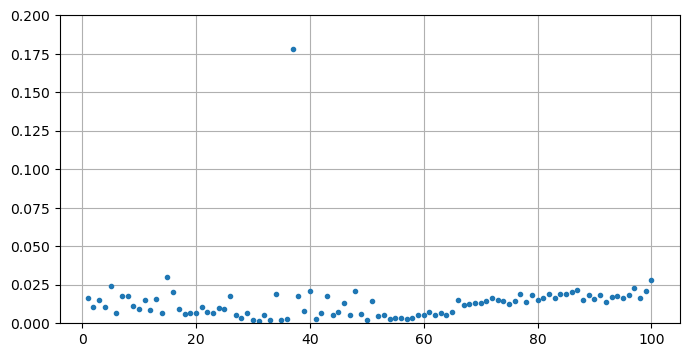

In [21]:
import matplotlib.pyplot as plt
plt.figure(figsize=(8,4))
plt.plot(range(1, 101, 1), error.mean(axis=1),'.')
plt.ylim((0,0.2))
plt.grid()

### 2DOF_RobotArm_PyBullet_PPO_23-12-02_11-52-06

    nb_steps   = 2048        # The number of steps to run per update (the size of the rollout buffer)
    nb_epochs  = 20
    batch_size = 256
    torque1 *= 4600
    torque2 *= 2100
    nb_max_step = 50
    forces=[5., 5.],

In [28]:
model_dir = "./models/2DOF_RobotArm_PyBullet_PPO_23-12-02_11-52-06/"

In [29]:
training_dir = model_dir

In [30]:
# on parcours les fichiers d'entrainement pour garder celui qui se positionne le mieux
# sur les 4 points définis.
error, err_mean, err_std, list_files, best_train = perf_trajectoire(env, model_dir, DT)
print(f"Best train: {best_train}, error: {err_mean*100:.2f} cm")    

rl_model_100000_steps.zip
	 e_mean, e_std:  42.36,   9.71 cm
rl_model_200000_steps.zip
	 e_mean, e_std:   9.98,   1.45 cm
rl_model_300000_steps.zip
	 e_mean, e_std:   7.96,   3.03 cm
rl_model_400000_steps.zip
	 e_mean, e_std:   4.49,   3.70 cm
rl_model_500000_steps.zip
	 e_mean, e_std:   5.88,   3.71 cm
rl_model_600000_steps.zip
	 e_mean, e_std:   4.26,   2.23 cm
rl_model_700000_steps.zip
	 e_mean, e_std:   4.36,   2.81 cm
rl_model_800000_steps.zip
	 e_mean, e_std:   3.51,   1.16 cm
rl_model_900000_steps.zip
	 e_mean, e_std:   2.63,   0.56 cm
rl_model_1000000_steps.zip
	 e_mean, e_std:   2.54,   1.01 cm
rl_model_1100000_steps.zip
	 e_mean, e_std:   8.35,  10.81 cm
rl_model_1200000_steps.zip
	 e_mean, e_std:   7.33,  11.39 cm
rl_model_1300000_steps.zip
	 e_mean, e_std:   3.09,   1.85 cm
rl_model_1400000_steps.zip
	 e_mean, e_std:   3.35,   2.30 cm
rl_model_1500000_steps.zip
	 e_mean, e_std:   3.44,   3.15 cm
rl_model_1600000_steps.zip
	 e_mean, e_std:   3.53,   0.90 cm
rl_model_1700000_

In [31]:
e_mean = error.mean(axis=1)
L = np.where(e_mean < 0.01)

for i in L[0].tolist():
    print(f"{list_files[i]} -> {e_mean[i]*100:.2f} cm,"
          f"max: {error[i].max()*100:.2f} cm,"
          f"min: {error[i].min()*100:.2f} cm," 
          f"std: {error[i].std()*100:.2f} cm")

In [32]:
error.mean(axis=1).argmin()

40

In [33]:
error.mean(axis=1)[error.mean(axis=1).argmin()]

0.015103526369828457

In [34]:
list_files[error.mean(axis=1).argmin()]

'rl_model_4100000_steps.zip'

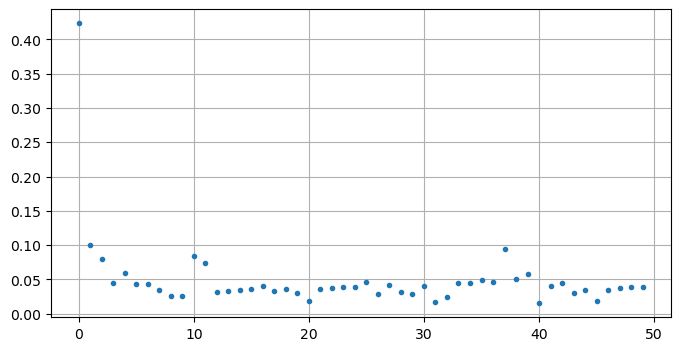

In [35]:
import matplotlib.pyplot as plt
plt.figure(figsize=(8,4))
plt.plot(error.mean(axis=1),'.')
plt.grid()

In [36]:
file = list_files[error.mean(axis=1).argmin()]
file

'rl_model_4100000_steps.zip'

In [37]:
# Pour un fichier donné, on balaye plusieurs valeurs de numSubSteps, et pour chaque, 
# le bras parcours la trajetoire fermée définie par 4 points
file = list_files[error.mean(axis=1).argmin()]
error, err_mean, err_std, best_nSubSteps = perf_nbSubStep_trajectoire(env, model_dir, file, DT)
print(f"Best nSubStep: {best_nSubSteps}, error: {err_mean*100:.2f} cm")              

>>> nSubStep:    1	 e_mean:   2.01 cm, e_std:   1.79 cm
>>> nSubStep:    2	 e_mean:   4.32 cm, e_std:   3.81 cm
>>> nSubStep:    3	 e_mean:   1.84 cm, e_std:   1.34 cm
>>> nSubStep:    4	 e_mean:   2.53 cm, e_std:   1.80 cm
>>> nSubStep:    5	 e_mean:   2.43 cm, e_std:   2.21 cm
>>> nSubStep:    6	 e_mean:   2.76 cm, e_std:   2.67 cm
>>> nSubStep:    7	 e_mean:   2.02 cm, e_std:   1.12 cm
>>> nSubStep:    8	 e_mean:   2.67 cm, e_std:   0.67 cm
>>> nSubStep:    9	 e_mean:   2.25 cm, e_std:   1.25 cm
>>> nSubStep:   10	 e_mean:   1.58 cm, e_std:   1.03 cm
>>> nSubStep:   11	 e_mean:   1.54 cm, e_std:   0.91 cm
>>> nSubStep:   12	 e_mean:   1.83 cm, e_std:   1.01 cm
>>> nSubStep:   13	 e_mean:   3.38 cm, e_std:   1.88 cm
>>> nSubStep:   14	 e_mean:   4.06 cm, e_std:   3.51 cm
>>> nSubStep:   15	 e_mean:   1.88 cm, e_std:   0.42 cm
>>> nSubStep:   16	 e_mean:   1.65 cm, e_std:   1.79 cm
>>> nSubStep:   17	 e_mean:   2.17 cm, e_std:   1.45 cm
>>> nSubStep:   18	 e_mean:   1.73 cm, e_std:   

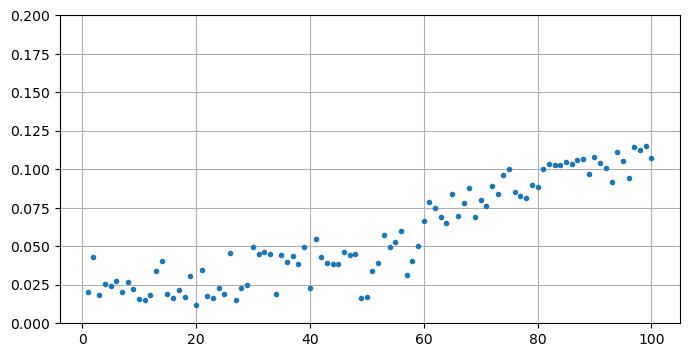

In [38]:
import matplotlib.pyplot as plt
plt.figure(figsize=(8,4))
plt.plot(range(1, 101, 1), error.mean(axis=1),'.')
plt.ylim((0,0.2))
plt.grid()

### 2DOF_RobotArm_PyBullet_PPO_23-12-03_08-13-12

    nb_steps   = 2048        # The number of steps to run per update (the size of the rollout buffer)
    nb_epochs  = 10
    batch_size = 512
    torque1 *= 4600
    torque2 *= 2100
    nb_max_step = 50
    forces=[5., 5.],

In [21]:
model_dir = pathlib.Path("./models/2DOF_RobotArm_PyBullet_PPO_23-12-03_08-13-12/")

In [22]:
training_dir = model_dir

In [25]:
# on parcours les fichiers d'entrainement pour garder celui qui se positionne le mieux
# sur les 4 points définis.
error, err_mean, err_std, list_files, best_train = perf_trajectoire(env, model_dir, DT)
print(f"Best train: {best_train}, error: {err_mean*100:.2f} cm")    

rl_model_100000_steps.zip
[RoboticArm_2DOF_PyBullet.reset] last #steps : 387
	 e_mean, e_std:  73.79,  29.96 cm
rl_model_200000_steps.zip
[RoboticArm_2DOF_PyBullet.reset] last #steps : 2500
	 e_mean, e_std:  36.56,  10.84 cm
rl_model_300000_steps.zip
[RoboticArm_2DOF_PyBullet.reset] last #steps : 2500
	 e_mean, e_std:  73.79,  29.96 cm
rl_model_400000_steps.zip
[RoboticArm_2DOF_PyBullet.reset] last #steps : 2500
	 e_mean, e_std:  41.25,   8.77 cm
rl_model_500000_steps.zip
[RoboticArm_2DOF_PyBullet.reset] last #steps : 2500
	 e_mean, e_std:  18.10,  10.12 cm
rl_model_600000_steps.zip
[RoboticArm_2DOF_PyBullet.reset] last #steps : 2500
	 e_mean, e_std:  12.56,   7.61 cm
rl_model_700000_steps.zip
[RoboticArm_2DOF_PyBullet.reset] last #steps : 2500
	 e_mean, e_std:  14.00,   7.33 cm
rl_model_800000_steps.zip
[RoboticArm_2DOF_PyBullet.reset] last #steps : 2500
	 e_mean, e_std:  14.35,   6.80 cm
rl_model_900000_steps.zip
[RoboticArm_2DOF_PyBullet.reset] last #steps : 2500
	 e_mean, e_std:   

In [26]:
e_mean = error.mean(axis=1)
L = np.where(e_mean < 0.01)

for i in L[0].tolist():
    print(f"{list_files[i]} -> {e_mean[i]*100:.2f} cm,"
          f"max: {error[i].max()*100:.2f} cm,"
          f"min: {error[i].min()*100:.2f} cm," 
          f"std: {error[i].std()*100:.2f} cm")

rl_model_4100000_steps.zip -> 0.76 cm,max: 1.20 cm,min: 0.09 cm,std: 0.39 cm
rl_model_4200000_steps.zip -> 0.37 cm,max: 0.56 cm,min: 0.09 cm,std: 0.23 cm
rl_model_4700000_steps.zip -> 0.49 cm,max: 0.88 cm,min: 0.06 cm,std: 0.36 cm
rl_model_4900000_steps.zip -> 0.38 cm,max: 1.05 cm,min: 0.03 cm,std: 0.37 cm
rl_model_5000000_steps.zip -> 0.32 cm,max: 0.90 cm,min: 0.07 cm,std: 0.33 cm


In [27]:
error.mean(axis=1).argmin()

49

In [28]:
error.mean(axis=1)[error.mean(axis=1).argmin()]

0.0032175679852758376

In [29]:
list_files[error.mean(axis=1).argmin()]

'rl_model_5000000_steps.zip'

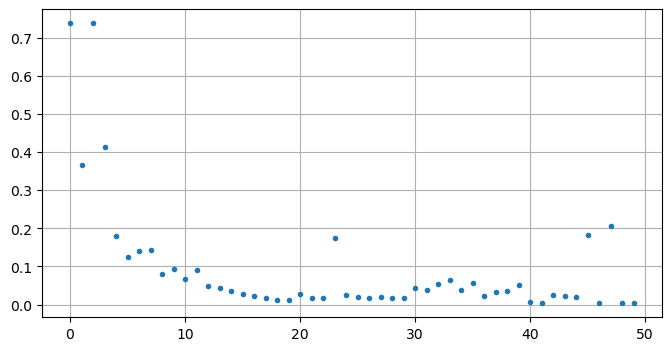

In [30]:
import matplotlib.pyplot as plt
plt.figure(figsize=(8,4))
plt.plot(error.mean(axis=1),'.')
plt.grid()

In [31]:
file = list_files[error.mean(axis=1).argmin()]
file

'rl_model_5000000_steps.zip'

In [32]:
# Pour un fichier donné, on balaye plusieurs valeurs de numSubSteps, et pour chaque, 
# le bras parcours la trajetoire fermée définie par 4 points
file = list_files[error.mean(axis=1).argmin()]
error, err_mean, err_std, best_nSubSteps = perf_nbSubStep_trajectoire(env, model_dir, file, DT)
print(f"Best nSubStep: {best_nSubSteps}, error: {err_mean*100:.2f} cm")              

>>> nSubStep:    1[RoboticArm_2DOF_PyBullet.reset] last #steps : 1475
	 e_mean:   1.10 cm, e_std:   0.62 cm
>>> nSubStep:    2[RoboticArm_2DOF_PyBullet.reset] last #steps : 1500
 step: 1028 done by close_to
	 e_mean:   0.86 cm, e_std:   0.96 cm
>>> nSubStep:    3[RoboticArm_2DOF_PyBullet.reset] last #steps : 1328
 step: 1009 done by close_to
	 e_mean:   0.96 cm, e_std:   0.74 cm
>>> nSubStep:    4[RoboticArm_2DOF_PyBullet.reset] last #steps : 1309
 step: 1026 done by close_to
	 e_mean:   0.81 cm, e_std:   0.68 cm
>>> nSubStep:    5[RoboticArm_2DOF_PyBullet.reset] last #steps : 1326
 step: 1062 done by close_to
	 e_mean:   0.76 cm, e_std:   0.68 cm
>>> nSubStep:    6[RoboticArm_2DOF_PyBullet.reset] last #steps : 1362
 step: 1065 done by close_to
	 e_mean:   0.78 cm, e_std:   0.66 cm
>>> nSubStep:    7[RoboticArm_2DOF_PyBullet.reset] last #steps : 1365
 step: 1035 done by close_to
	 e_mean:   0.78 cm, e_std:   0.65 cm
>>> nSubStep:    8[RoboticArm_2DOF_PyBullet.reset] last #steps : 1335


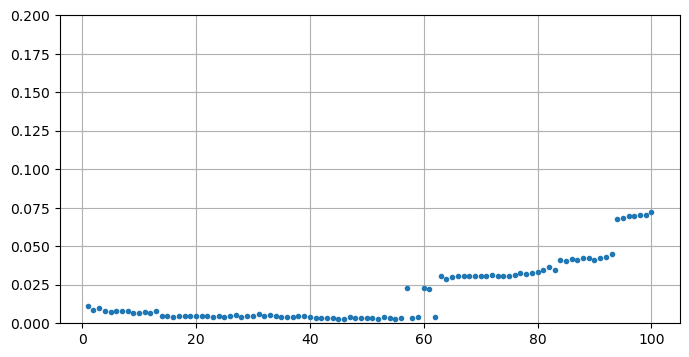

In [33]:
import matplotlib.pyplot as plt
plt.figure(figsize=(8,4))
plt.plot(range(1, 101, 1), error.mean(axis=1),'.')
plt.ylim((0,0.2))
plt.grid()

## 2DOF_RobotArm_PyBullet_PPO_23-12-04_18-34-31

    nb_steps   = 2048        # The number of steps to run per update (the size of the rollout buffer)
    nb_epochs  = 10
    batch_size = 256
    torque1 *= 4600
    torque2 *= 2100
    nb_max_step = 50
    forces=[5., 5.],

    new urdf

In [27]:
model_dir = pathlib.Path("./models/2DOF_RobotArm_PyBullet_PPO_23-12-04_18-34-31/")

In [28]:
training_dir = model_dir

In [30]:
# on parcours les fichiers d'entrainement pour garder celui qui se positionne le mieux
# sur les 4 points définis.
error, err_mean, err_std, list_files, best_train = perf_trajectoire(env, model_dir, DT)
print(f"Best train: {best_train}, error: {err_mean*100:.2f} cm")    

>>> rl_model_100000_steps.zip     	 e_mean, e_std:  72.75,  29.26 cm
>>> rl_model_200000_steps.zip     	 e_mean, e_std:  76.21,  25.73 cm
>>> rl_model_300000_steps.zip     	 e_mean, e_std:  28.64,  20.49 cm
>>> rl_model_400000_steps.zip     	 e_mean, e_std:  27.22,  11.05 cm
>>> rl_model_500000_steps.zip     	 e_mean, e_std:  20.62,   6.09 cm
>>> rl_model_600000_steps.zip     	 e_mean, e_std:  16.22,   6.22 cm
>>> rl_model_700000_steps.zip     	 e_mean, e_std:   6.86,   3.73 cm
>>> rl_model_800000_steps.zip     	 e_mean, e_std:   8.79,   5.28 cm
>>> rl_model_900000_steps.zip     	 e_mean, e_std:   5.39,   0.96 cm
>>> rl_model_1000000_steps.zip    	 e_mean, e_std:   4.00,   1.10 cm
>>> rl_model_1100000_steps.zip    	 e_mean, e_std:   2.56,   1.25 cm
>>> rl_model_1200000_steps.zip    	 e_mean, e_std:   2.01,   1.70 cm
>>> rl_model_1300000_steps.zip    	 e_mean, e_std:   4.03,   3.38 cm
>>> rl_model_1400000_steps.zip    	 e_mean, e_std:   3.43,   1.33 cm
>>> rl_model_1500000_steps.zip    

In [31]:
e_mean = error.mean(axis=1)
L = np.where(e_mean < 0.01)

for i in L[0].tolist():
    print(f"{list_files[i]} -> {e_mean[i]*100:.2f} cm,"
          f"max: {error[i].max()*100:.2f} cm,"
          f"min: {error[i].min()*100:.2f} cm," 
          f"std: {error[i].std()*100:.2f} cm")

In [32]:
error.mean(axis=1).argmin()

18

In [33]:
error.mean(axis=1)[error.mean(axis=1).argmin()]

0.018334987909794015

In [34]:
list_files[error.mean(axis=1).argmin()]

'rl_model_1900000_steps.zip'

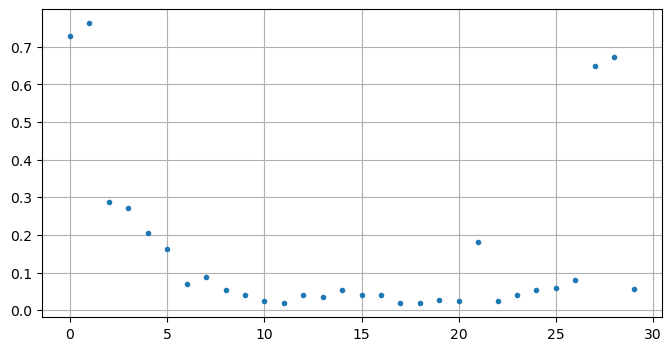

In [35]:
import matplotlib.pyplot as plt
plt.figure(figsize=(8,4))
plt.plot(error.mean(axis=1),'.')
plt.grid()

In [36]:
file = list_files[error.mean(axis=1).argmin()]
file

'rl_model_1900000_steps.zip'

In [37]:
# Pour un fichier donné, on balaye plusieurs valeurs de numSubSteps, et pour chaque, 
# le bras parcours la trajetoire fermée définie par 4 points
file = list_files[error.mean(axis=1).argmin()]
error, err_mean, err_std, best_nSubSteps = perf_nbSubStep_trajectoire(env, model_dir, file, DT)
print(f"Best nSubStep: {best_nSubSteps}, error: {err_mean*100:.2f} cm")              

>>> nSubStep:    1	 e_mean:   3.39 cm, e_std:   3.15 cm
>>> nSubStep:    2	 e_mean:   4.58 cm, e_std:   4.68 cm
>>> nSubStep:    3	 e_mean:   2.96 cm, e_std:   2.86 cm
>>> nSubStep:    4	 e_mean:   4.45 cm, e_std:   4.37 cm
>>> nSubStep:    5	 e_mean:   3.08 cm, e_std:   3.12 cm
>>> nSubStep:    6	 e_mean:   3.83 cm, e_std:   4.07 cm
>>> nSubStep:    7	 e_mean:   1.43 cm, e_std:   1.19 cm
>>> nSubStep:    8	 e_mean:   4.90 cm, e_std:   5.22 cm
>>> nSubStep:    9	 e_mean:   4.50 cm, e_std:   4.72 cm
>>> nSubStep:   10	 e_mean:   4.06 cm, e_std:   4.05 cm
>>> nSubStep:   11	 e_mean:   3.29 cm, e_std:   3.07 cm
>>> nSubStep:   12	 e_mean:   2.61 cm, e_std:   2.27 cm
>>> nSubStep:   13	 e_mean:   4.40 cm, e_std:   3.92 cm
>>> nSubStep:   14	 e_mean:   2.50 cm, e_std:   2.35 cm
>>> nSubStep:   15	 e_mean:   3.34 cm, e_std:   2.97 cm
>>> nSubStep:   16	 e_mean:   2.60 cm, e_std:   2.26 cm
>>> nSubStep:   17	 e_mean:   3.51 cm, e_std:   3.46 cm
>>> nSubStep:   18	 e_mean:   3.87 cm, e_std:   

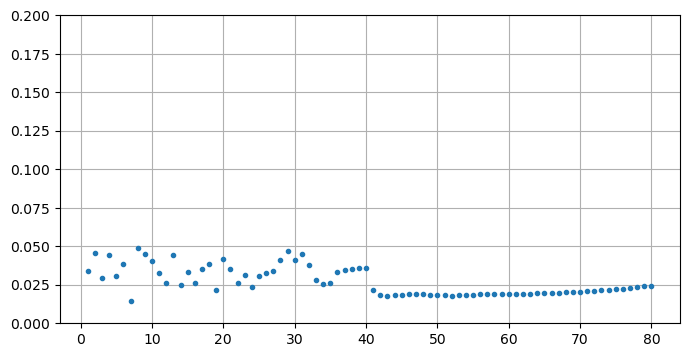

In [39]:
import matplotlib.pyplot as plt
plt.figure(figsize=(8,4))
plt.plot(range(1, 81, 1), error.mean(axis=1),'.')
plt.ylim((0,0.2))
plt.grid()

## 2DOF_RobotArm_PyBullet_PPO_23-12-05_15-23-48

In [60]:
DT, SEED, T1_T2

(0.004166666666666667, 1234567, (800, 400))

In [61]:
training_dir

PosixPath('models/2DOF_RobotArm_PyBullet_PPO_23-12-05_15-23-48')

In [62]:
model_dir = training_dir

In [63]:
# on parcours les fichiers d'entrainement pour garder celui qui se positionne le mieux
# sur les 4 points définis.
error, err_mean, err_std, list_files, best_train = perf_trajectoire(env, model_dir, DT)
print(f"Best train: {best_train}, error: {err_mean*100:.2f} cm")    

>>> rl_model_100000_steps.zip     	 e_mean, e_std:  10.33,   5.57 cm
>>> rl_model_200000_steps.zip     	 e_mean, e_std:   1.95,   0.83 cm
>>> rl_model_300000_steps.zip     	 e_mean, e_std:   0.53,   0.39 cm
>>> rl_model_400000_steps.zip     	 e_mean, e_std:   0.71,   0.29 cm
>>> rl_model_500000_steps.zip     	 e_mean, e_std:   0.84,   0.16 cm
>>> rl_model_600000_steps.zip     	 e_mean, e_std:   0.43,   0.32 cm
>>> rl_model_700000_steps.zip     	 e_mean, e_std:   3.36,   5.77 cm
>>> rl_model_800000_steps.zip     	 e_mean, e_std:  10.50,  19.75 cm
>>> rl_model_900000_steps.zip     	 e_mean, e_std:   4.75,   8.64 cm
>>> rl_model_1000000_steps.zip    	 e_mean, e_std:   2.65,   4.49 cm
>>> rl_model_1100000_steps.zip    	 e_mean, e_std:   5.17,   8.40 cm
>>> rl_model_1200000_steps.zip    	 e_mean, e_std:   0.64,   0.51 cm
>>> rl_model_1300000_steps.zip    	 e_mean, e_std:   0.38,   0.15 cm
>>> rl_model_1400000_steps.zip    	 e_mean, e_std:   0.56,   0.30 cm
>>> rl_model_1500000_steps.zip    

In [64]:
error.mean(axis=1).argmin()

43

In [65]:
error.mean(axis=1)[error.mean(axis=1).argmin()]

0.0021989143977967536

In [66]:
list_files[error.mean(axis=1).argmin()]

'rl_model_4400000_steps.zip'

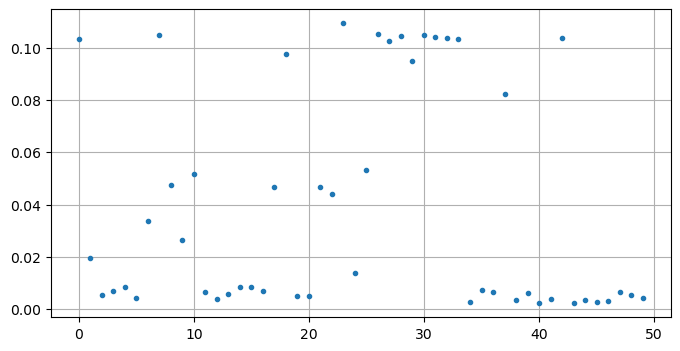

In [67]:
import matplotlib.pyplot as plt
plt.figure(figsize=(8,4))
plt.plot(error.mean(axis=1),'.')
plt.grid()

In [68]:
file = list_files[error.mean(axis=1).argmin()]
file

'rl_model_4400000_steps.zip'

In [69]:
# Pour un fichier donné, on balaye plusieurs valeurs de numSubSteps, et pour chaque, 
# le bras parcours la trajetoire fermée définie par 4 points
file = list_files[error.mean(axis=1).argmin()]
error, err_mean, err_std, best_nSubSteps = perf_nbSubStep_trajectoire(env, model_dir, file, DT)
print(f"Best nSubStep: {best_nSubSteps}, error: {err_mean*100:.2f} cm")              

>>> nSubStep:    1	 e_mean:   0.45 cm, e_std:   0.29 cm
>>> nSubStep:    2	 e_mean:   0.27 cm, e_std:   0.35 cm
>>> nSubStep:    3	 e_mean:   0.25 cm, e_std:   0.32 cm
>>> nSubStep:    4	 e_mean:   0.19 cm, e_std:   0.24 cm
>>> nSubStep:    5	 e_mean:   0.20 cm, e_std:   0.24 cm
>>> nSubStep:    6	 e_mean:   0.21 cm, e_std:   0.24 cm
>>> nSubStep:    7	 e_mean:   0.21 cm, e_std:   0.25 cm
>>> nSubStep:    8	 e_mean:   0.21 cm, e_std:   0.25 cm
>>> nSubStep:    9	 e_mean:   0.21 cm, e_std:   0.25 cm
>>> nSubStep:   10	 e_mean:   0.22 cm, e_std:   0.25 cm
>>> nSubStep:   11	 e_mean:   0.22 cm, e_std:   0.25 cm
>>> nSubStep:   12	 e_mean:   0.22 cm, e_std:   0.25 cm
>>> nSubStep:   13	 e_mean:   0.22 cm, e_std:   0.25 cm
>>> nSubStep:   14	 e_mean:   0.21 cm, e_std:   0.26 cm
>>> nSubStep:   15	 e_mean:   0.21 cm, e_std:   0.26 cm
>>> nSubStep:   16	 e_mean:   0.22 cm, e_std:   0.26 cm
>>> nSubStep:   17	 e_mean:   0.21 cm, e_std:   0.26 cm
>>> nSubStep:   18	 e_mean:   0.22 cm, e_std:   

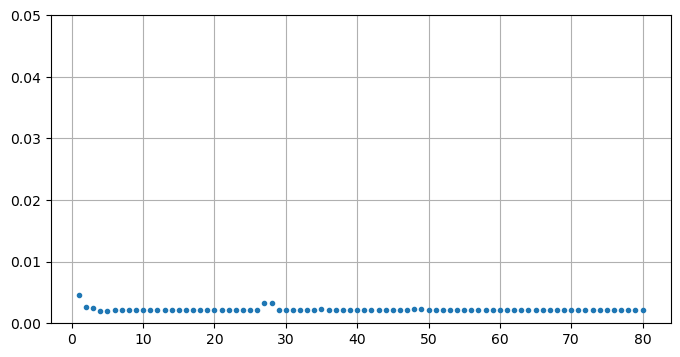

In [71]:
import matplotlib.pyplot as plt
plt.figure(figsize=(8,4))
plt.plot(range(1, 81, 1), error.mean(axis=1),'.')
plt.ylim((0,0.05))
plt.grid()

## perf pour un fichier donné

In [74]:
file = 

In [72]:
from stable_baselines3 import PPO as agent
model = agent.load(model_dir / "ZIP" / file)
model_dir / "ZIP" / file

PosixPath('models/2DOF_RobotArm_PyBullet_PPO_23-12-05_15-23-48/ZIP/rl_model_4400000_steps.zip')

In [73]:
try:
    env.close()
except:    
    del env

In [74]:
DT, SEED, T1_T2

(0.004166666666666667, 1234567, (800, 400))

In [75]:
URDF   = "./urdf/RoboticArm_2DOF_2.urdf"
TARGET = "./urdf/target.urdf"
SEED = 1234567

env    = RoboticArm_2DOF_PyBullet(robot_urdf  = URDF, 
                                  target_urdf = TARGET, 
                                  dt = DT,
                                  init_robot_angles = (113, -140),
                                  reward = 'reward_1',
                                  t1_t2_conv = T1_T2,
                                  seed = SEED,
                                  headless = False, 
                                  max_episode_steps = 500,
                                  verbose=0)

#env.action_space.seed(1234)
#env.observation_space.seed(1234)


################################################################################
# Welcome to this practical session with Pybullet & URDF.
# Pybullet windows shortcuts:
#    G: close/open the tabs
#    W: switch between solid/wireframe rendering
#    J: show/hide links & joints frames as RGB lines (with wireframe rendering activated)
#    K: show/hide joint axes as a black line         (with wireframe rendering activated)
#    A: show/hide collision boxes                    (with wireframe rendering activated)
#    CTRL+left_clic  : rotate the robot
#    CRTL+midlle_clic: translate the robot
#    Mouse_wheel: zoom/unzoom
################################################################################

startThreads creating 1 threads.
starting thread 0
started thread 0 
argc=2
argv[0] = --unused
argv[1] = --start_demo_name=Physics Server
ExampleBrowserThreadFunc started
X11 functions dynamically loaded using dlopen/dlsym OK!
X11 functions dynamically loaded using dlopen/dlsym OK!
Creat

In [76]:
# le bras doit atteindre la cible:

verbose=1
obs, _ = env.reset(options={"dt":DT, 
                         "target_initial_pos":(0.75,0,0.5),
                         "robot_initial_angle_deg":(113, -140),
                         "randomize":False})
max_steps = 500 # JLC 27/11/2023 was 300
terminated, step_count, rewards, actions = False, 0, [], []
time.sleep(1)
while step_count < max_steps:
        action, _ = model.predict(obs, deterministic=True)
        obs, reward, terminated, _, info = env.step(action)
        rewards.append(float(reward))
        actions.append(action)
        step_count += 1
        time.sleep(env.dt)
        if is_close_to(np.array(env.effector_pos), np.array(env.actual_target_pos), 5e-3): break
        if verbose and (step_count % 10 == 0) : print("\r", step_count, end="")
if verbose: print(" ...done!")
if step_count == max_steps+1: step_count -= 1

 50 ...done!


In [77]:
# Le bras parcours la trajetoire fermée définie par 4 points

verbose=1
q1_q2 = (113, -140)
epsilon = 1.e-3
max_steps = 256

env._max_episode_steps = None
obs, _ = env.reset(options={"dt": DT, 
                         "target_initial_pos": (0.5,0,0),
                         "robot_initial_angle_deg": q1_q2,
                         "randomize": False,
                         "epsilon": epsilon})

for target_pos in ((0.5,0.,0.02), (1,0,0.5), (0.5,0,1), (0,0,0.5), (0.5,0,0.02)):
    if verbose: print(target_pos)
    t0 = time.time()
    env.set_target_position(np.array(target_pos))    
    terminated, printDone, step_count, rewards, actions = False, False, 0, [], []
    while step_count < max_steps:
        action, _ = model.predict(obs, deterministic=True)
        actions.append(action)
        if not terminated:
            obs, reward, terminated, _, info = env.step(action)
            rewards.append(float(reward))
        step_count += 1
        time.sleep(env.dt)
        if verbose: 
            if not terminated: 
                print("\r", step_count, end="")
            elif not printDone: 
                print("...done!", end="")
                printDone = True
    t1 = time.time()
    if verbose:
        if not terminated: print("...not done!", end="")
        print(f" in {t1 - t0:.1f} sec.")


(0.5, 0.0, 0.02)
 171...done! in 1.3 sec.
(1, 0, 0.5)
 256...not done! in 1.3 sec.
(0.5, 0, 1)
 72...done! in 1.2 sec.
(0, 0, 0.5)
 135...done! in 1.2 sec.
(0.5, 0, 0.02)
 185...done! in 1.2 sec.


In [38]:
try:
    env.close()
except:    
    del env

numActiveThreads = 0
stopping threads
Thread with taskId 0 exiting
Thread TERMINATED
destroy semaphore
semaphore destroyed
destroy main semaphore
main semaphore destroyed
finished
numActiveThreads = 0
btShutDownExampleBrowser stopping threads
Thread with taskId 0 exiting
Thread TERMINATED
destroy semaphore
semaphore destroyed
destroy main semaphore
main semaphore destroyed


In [39]:
URDF   = "./urdf/RoboticArm_2DOF_2.urdf"
TARGET = "./urdf/target.urdf"
SEED = 1234567

env    = RoboticArm_2DOF_PyBullet(robot_urdf  = URDF, 
                                  target_urdf = TARGET, 
                                  dt = DT,
                                  init_robot_angles = (113, -140),
                                  t1_t2_conv = T1_T2,
                                  reward = 'reward_1',
                                  seed = SEED,
                                  headless = True, 
                                  max_episode_steps = 500,            #JLC 27/11/2023 was:400,
                                  verbose=0)

#env.action_space.seed(1234)
#env.observation_space.seed(1234)

In [57]:
# pour un fichier model donné et un nbSubSteps donné,
# regarder les nb_pts_per_line et max_tries optimaux:

from stable_baselines3 import PPO as agent

results, err_mean = {}, 1e20
p1, p2, p3, p4 = (0.5, 0.02), (1, 0.5), (0.5, 1), (0, 0.5)
trajectory = ((p2, p3), (p3, p4), (p4, p1), (p1, p2))

epsilon = 1.e-3
nbSubSteps = 56

model = agent.load(os.path.join(model_dir, "ZIP", file))
env._max_episode_steps = None

for nb_pts_per_line in range(20, 105, 5):
    pts, dl = sample_traj4pts(trajectory, nb_pts_per_line)
    for max_step_nb in range(20, 65, 5):
        print(f"\n>>> nb_pts:{nb_pts_per_line:3d}, max_step_nb:{max_step_nb:3d}")
        err = test_training(model, env, DT, pts, max_step_nb, epsilon, nbSubSteps)
        e_mean = err.mean()
        results[(nb_pts_per_line, max_step_nb)] = (file, e_mean, err)
        if e_mean < err_mean:
            n = nb_pts_per_line
            m = max_step_nb
            best_train = file
            err_mean = e_mean
            
print(f"best train for nbSubSteps {nbSubSteps}, error: {err_mean}, (nb_pts, max_step_nb): {n, m}")


>>> nb_pts: 20, max_step_nb: 20

e_av: 4.84 cm, e_std:2.06 cm, abs(e)_max: 14.53 cm

>>> nb_pts: 20, max_step_nb: 25

e_av: 3.58 cm, e_std:1.39 cm, abs(e)_max: 7.98 cm

>>> nb_pts: 20, max_step_nb: 30

e_av: 2.99 cm, e_std:1.29 cm, abs(e)_max: 6.67 cm

>>> nb_pts: 20, max_step_nb: 35

e_av: 2.64 cm, e_std:1.25 cm, abs(e)_max: 6.01 cm

>>> nb_pts: 20, max_step_nb: 40

e_av: 2.41 cm, e_std:1.28 cm, abs(e)_max: 6.26 cm

>>> nb_pts: 20, max_step_nb: 45

e_av: 2.26 cm, e_std:1.22 cm, abs(e)_max: 5.78 cm

>>> nb_pts: 20, max_step_nb: 50

e_av: 2.05 cm, e_std:1.17 cm, abs(e)_max: 5.58 cm

>>> nb_pts: 20, max_step_nb: 55

e_av: 1.93 cm, e_std:1.17 cm, abs(e)_max: 5.69 cm

>>> nb_pts: 20, max_step_nb: 60

e_av: 1.85 cm, e_std:1.15 cm, abs(e)_max: 5.56 cm

>>> nb_pts: 25, max_step_nb: 20

e_av: 3.49 cm, e_std:1.29 cm, abs(e)_max: 7.50 cm

>>> nb_pts: 25, max_step_nb: 25

e_av: 2.88 cm, e_std:1.18 cm, abs(e)_max: 6.83 cm

>>> nb_pts: 25, max_step_nb: 30

e_av: 2.40 cm, e_std:1.11 cm, abs(e)_max:

In [78]:
try:
    env.close()
except:    
    del env

numActiveThreads = 0
stopping threads
Thread with taskId 0 exiting
Thread TERMINATED
destroy semaphore
semaphore destroyed
destroy main semaphore
main semaphore destroyed
finished
numActiveThreads = 0
btShutDownExampleBrowser stopping threads
Thread with taskId 0 exiting
Thread TERMINATED
destroy semaphore
semaphore destroyed
destroy main semaphore
main semaphore destroyed


In [79]:
if 'env' in dir(): env.close()
SEED = 1234567
URDF   = "./urdf/RoboticArm_2DOF_2.urdf"
TARGET = "./urdf/target.urdf"

env    = RoboticArm_2DOF_PyBullet(robot_urdf  = URDF, 
                                  target_urdf = TARGET, 
                                  dt = DT,
                                  init_robot_angles = (113, -140),
                                  t1_t2_conv = T1_T2,
                                  reward = 'reward_1',
                                  seed = SEED,
                                  headless = False, 
                                  max_episode_steps = 256,
                                  verbose=0)

#env.action_space.seed(1234)
#env.observation_space.seed(1234)

not connected...
startThreads creating 1 threads.
starting thread 0
started thread 0 
argc=2
argv[0] = --unused
argv[1] = --start_demo_name=Physics Server
ExampleBrowserThreadFunc started
X11 functions dynamically loaded using dlopen/dlsym OK!
X11 functions dynamically loaded using dlopen/dlsym OK!

################################################################################
# Welcome to this practical session with Pybullet & URDF.
# Pybullet windows shortcuts:
#    G: close/open the tabs
#    W: switch between solid/wireframe rendering
#    J: show/hide links & joints frames as RGB lines (with wireframe rendering activated)
#    K: show/hide joint axes as a black line         (with wireframe rendering activated)
#    A: show/hide collision boxes                    (with wireframe rendering activated)
#    CTRL+left_clic  : rotate the robot
#    CRTL+midlle_clic: translate the robot
#    Mouse_wheel: zoom/unzoom
######################################################################

In [80]:
print(model_dir, file)

models/2DOF_RobotArm_PyBullet_PPO_23-12-05_15-23-48 rl_model_4400000_steps.zip


In [81]:
best_nSubSteps

4

In [82]:
DT, SEED, T1_T2

(0.004166666666666667, 1234567, (800, 400))

In [91]:
from stable_baselines3 import PPO as agent

results, err_mean = {}, 1e20

epsilon = 1.e-3
nbSubSteps      = 50 #best_nSubSteps # 50 # JLC 27/11/2023, was: 56
nb_pts_per_line = 100    # JLC 27/11/2023 was 100
max_step_nb     = 60

p1, p2, p3, p4 = (0.5, 0.02), (1, 0.5), (0.5, 1), (0, 0.5)
trajectory = ((p2, p3), (p3, p4), (p4, p1), (p1, p2))
pts, dl = sample_traj4pts(trajectory, nb_pts_per_line)

model = agent.load(os.path.join(model_dir, "ZIP", file))

err = test_training(model, env, DT, pts, max_step_nb, epsilon, nbSubSteps)


e_av: 0.58 cm, e_std:0.23 cm, abs(e)_max: 1.46 cm


In [90]:
from stable_baselines3 import PPO as agent

results, err_mean = {}, 1e20

epsilon = 1.e-3
nbSubSteps      = 4 #best_nSubSteps # 50 # JLC 27/11/2023, was: 56
nb_pts_per_line = 100    # JLC 27/11/2023 was 100
max_step_nb     = 60

p1, p2, p3, p4 = (0.5, 0.02), (1, 0.5), (0.5, 1), (0, 0.5)
trajectory = ((p2, p3), (p3, p4), (p4, p1), (p1, p2))
pts, dl = sample_traj4pts(trajectory, nb_pts_per_line)

model = agent.load(os.path.join(model_dir, "ZIP", file))

err = test_training(model, env, DT, pts, max_step_nb, epsilon, nbSubSteps)


e_av: 0.59 cm, e_std:0.24 cm, abs(e)_max: 1.56 cm


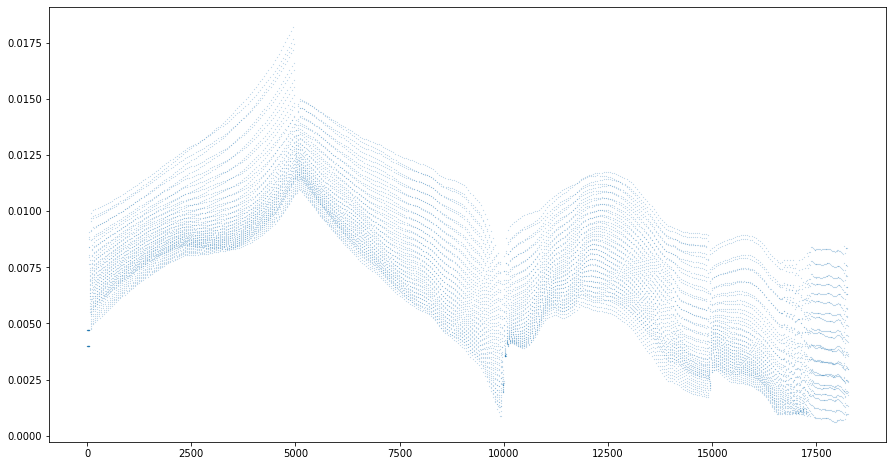

In [28]:
import matplotlib.pyplot as plt
plt.figure(figsize=(15,8))
plt.plot(err,'.', markersize=0.2)

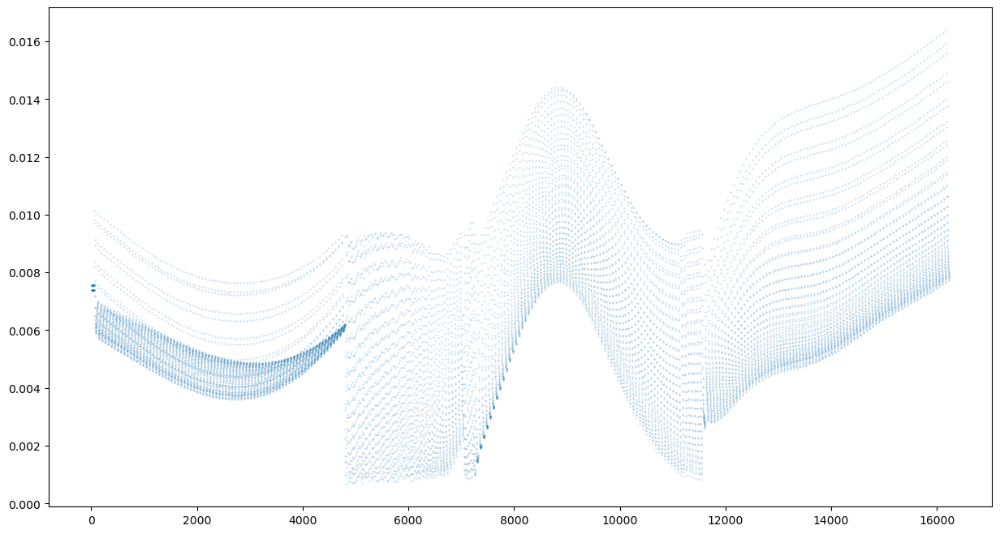

In [84]:
import matplotlib.pyplot as plt
plt.figure(figsize=(15,8))
plt.plot(err,'.', markersize=0.3)

In [85]:
t1=np.array(env.torque1)
t2=np.array(env.torque2)

(-1.0, 1.0)

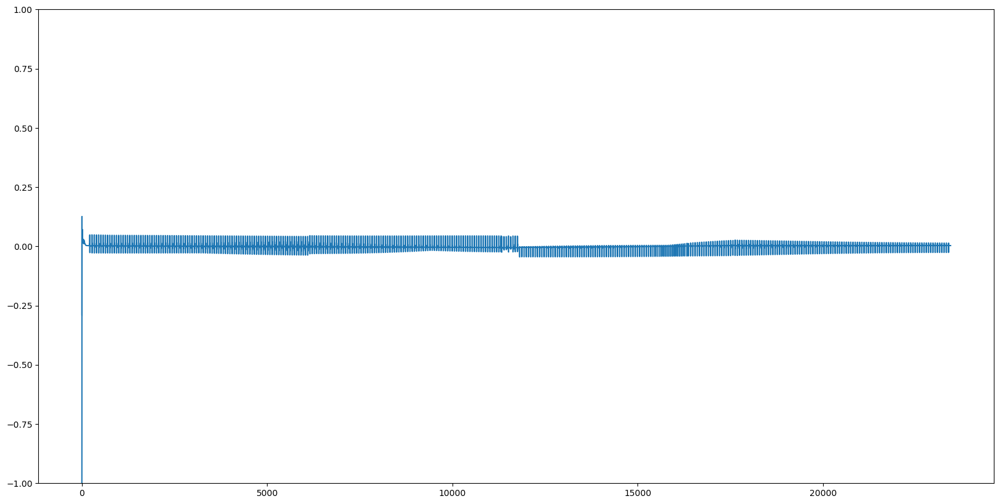

In [55]:
import matplotlib.pyplot as plt
plt.figure(figsize=(20,10))
plt.plot(t1)
plt.ylim((-1,1))

(-1.0, 1.0)

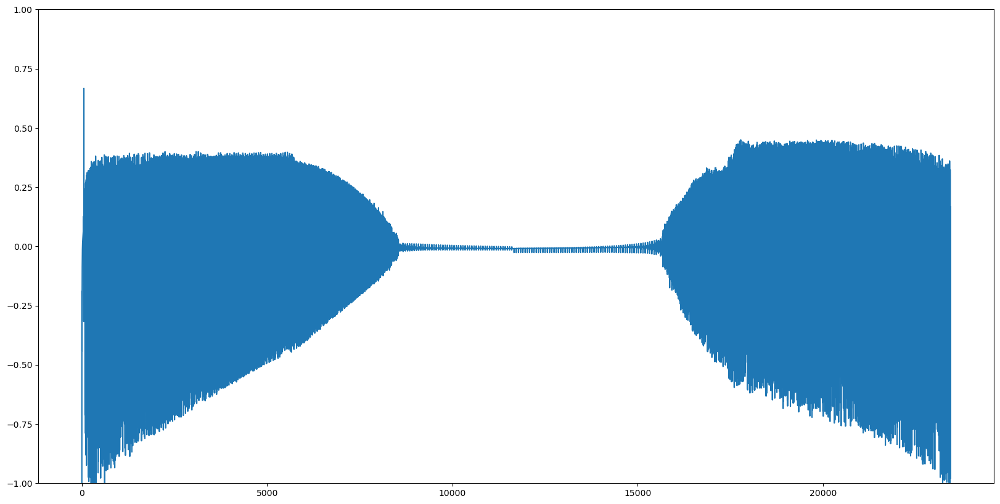

In [57]:
import matplotlib.pyplot as plt
plt.figure(figsize=(20,10))
plt.plot(t1)
plt.ylim((-1,1))

(-1.0, 1.0)

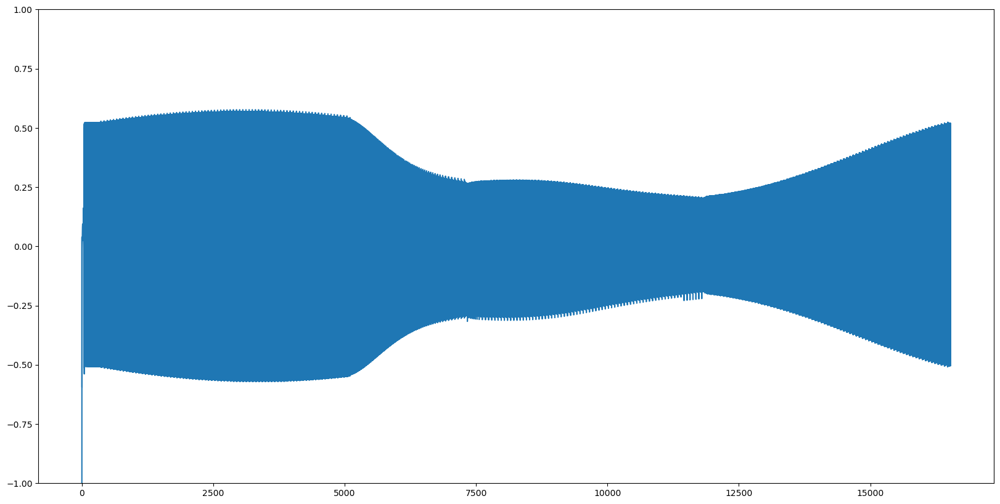

In [86]:
import matplotlib.pyplot as plt
plt.figure(figsize=(20,10))
plt.plot(t1)
plt.ylim((-1,1))

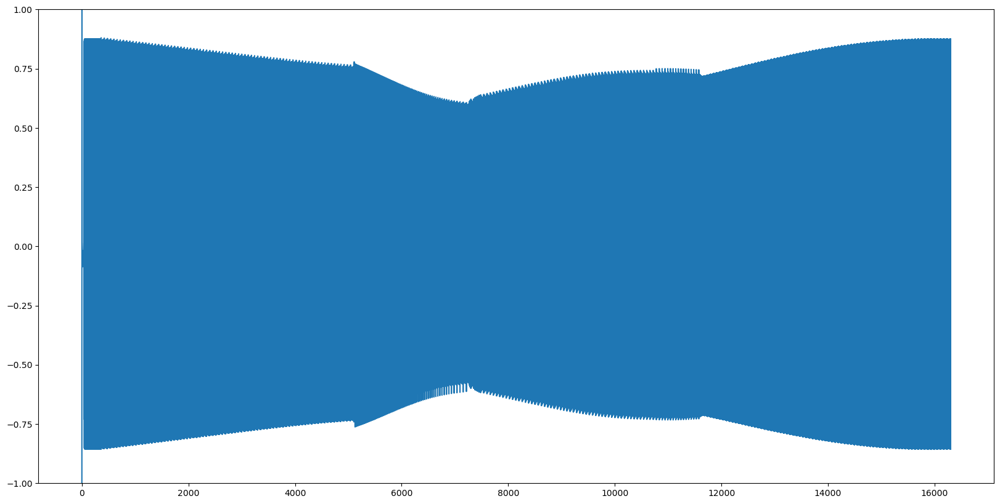

In [48]:
import matplotlib.pyplot as plt
plt.figure(figsize=(20,10))
plt.ylim((-1,1))
plt.plot(t2)

In [59]:
env.close()

numActiveThreads = 0
stopping threads
Thread with taskId 0 exiting
Thread TERMINATED
destroy semaphore
semaphore destroyed
destroy main semaphore
main semaphore destroyed
finished
numActiveThreads = 0
btShutDownExampleBrowser stopping threads
Thread with taskId 0 exiting
Thread TERMINATED
destroy semaphore
semaphore destroyed
destroy main semaphore
main semaphore destroyed


# enregistrer le notebook !!!!

In [49]:
training_dir

PosixPath('models/2DOF_RobotArm_PyBullet_PPO_23-12-05_15-23-48')

In [92]:
# copy precious files in experiment_dir
for f in ('./2-train_the_robot_with_DRL.ipynb', 'rewards.py', './utils/RoboticArm_2DOF.py', 
             './utils/perf.py', './utils/tools.py', './urdf/RoboticArm_2DOF_2.urdf'):
    base = os.path.basename(f)
    shutil.copyfile(f, os.path.join(training_dir, base))

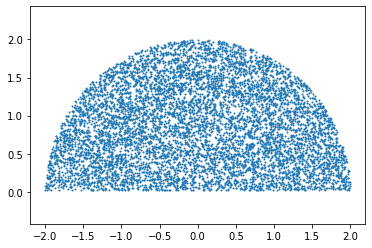

In [131]:
points = []
for _ in range(10000):
    x = np.random.uniform(-2., 2.)
    y = np.random.uniform(0.02, 2.)
    if x**2 + y**2 <= 4: points.append((x,y))
points = np.array(points)

fig, axe = plt.subplots(1,1)
axe.axis('equal')
axe.scatter(points[:,0], points[:,1], 1)

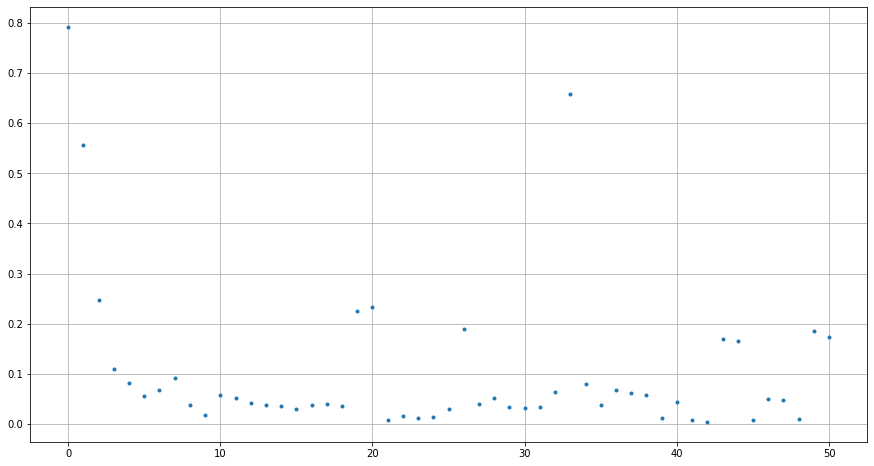

In [36]:
import matplotlib.pyplot as plt
plt.figure(figsize=(15,8))
plt.plot(error.mean(axis=1),'.')
plt.grid()

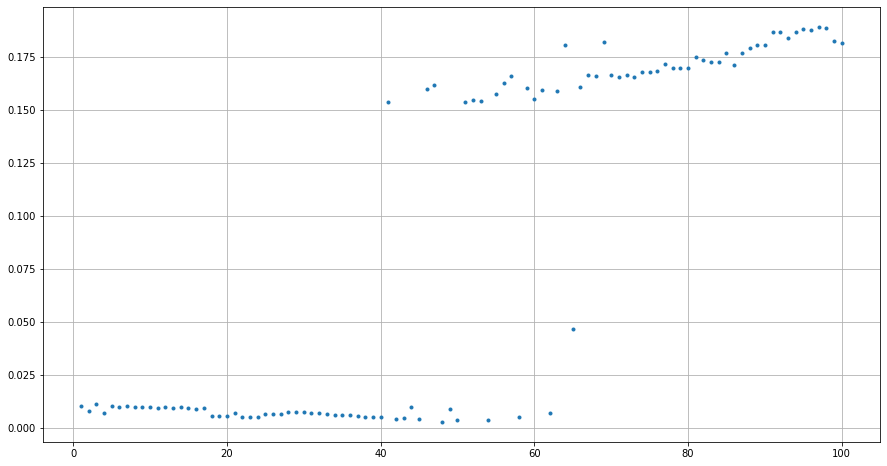

In [24]:
import matplotlib.pyplot as plt
plt.figure(figsize=(15,8))
plt.plot(range(1, 101, 1), error.mean(axis=1),'.')
plt.grid()